# New Hip Xander Section

In [1]:
# %load_ext autoreload
# %autoreload 2

# login to wandb if haven't already
# !pip install wandb
# !wandb login --help

from utils_DL import train_net
from params import get_params, ModelStyles, KDecayOptions
import wandb
from pytorch_lightning.loggers import WandbLogger


wandb_logger = WandbLogger(project="Foundational-SDM", entity="kreiman-sdm")
params = get_params(ModelStyles.FREY_PAPER)
params.logger = wandb_logger
train_net(params)
wandb.finish()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Currently logged in as: xanderdavies (use `wandb login --relogin` to force relogin)
wandb: wandb version 0.12.5 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade



  | Name | Type | Params
------------------------------
------------------------------
1.6 M     Trainable params
0         Non-trainable params
1.6 M     Total params
6.279     Total estimated model params size (MB)


/Users/xanderdavies/opt/anaconda3/lib/python3.8/site-packages/pytorch_lightning/trainer/data_loading.py:105: UserWarning: The dataloader, val dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 16 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(
/Users/xanderdavies/opt/anaconda3/lib/python3.8/site-packages/pytorch_lightning/trainer/data_loading.py:105: UserWarning: The dataloader, train dataloader, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 16 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  rank_zero_warn(


Epoch 20:  77%|███████▋  | 420/548 [00:15<00:04, 26.69it/s, loss=0.000229, v_num=mxc0]

/Users/xanderdavies/opt/anaconda3/lib/python3.8/site-packages/pytorch_lightning/trainer/trainer.py:1051: UserWarning: Detected KeyboardInterrupt, attempting graceful shutdown...
  rank_zero_warn("Detected KeyboardInterrupt, attempting graceful shutdown...")


cosine_sims,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
epoch,▁▁▁▁▂▂▂▂▂▂▃▃▃▃▃▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇████
inhib_amount,▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
k,████▇▇▇▇▇▇▆▆▆▆▆▆▅▅▅▅▅▅▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▁▁▁
trainer/global_step,▁▁▁▁▂▂▂▂▂▃▃▃▃▃▃▄▄▄▄▄▅▅▅▅▅▅▆▆▆▆▆▆▇▇▇▇▇███
training_loss,█▄▃▂▂▁▁▁▁▁▁▁▁▂▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▂▁▁
valid_loss,▆█▃▂▃▂▁▂▁▂▂▂▁▂▁▁▁▂▁▁
cosine_sims,0
epoch,20
inhib_amount,0
k,802


Epoch 20:  77%|███████▋  | 420/548 [00:29<00:08, 14.45it/s, loss=0.000229, v_num=mxc0]

# Original Code

In [5]:
%load_ext autoreload
%autoreload 2
from utils_DL import *
import torch
import torchvision
import torchvision.transforms as transforms
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import binom, norm
from scipy.sparse import csc_matrix, coo_matrix, csr_matrix

import pandas as pd
import time
import copy
import torch.nn as nn
import torch.nn.functional as F
import random 
import torch.optim as optim
from types import SimpleNamespace
np.random.seed(27)
random.seed(27)
torch.manual_seed(27)
import warnings
import os
warnings.filterwarnings('ignore')

#if GPU
#torch.cuda.manual_seed(manualSeed)
#torch.cuda.manual_seed_all(manualSeed)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# SDM

In [9]:
# login to wandb
# !pip install wandb
# !wandb login --help

params = dict(print_every = 250, # how many minibatches. works within an epoch.
              batch_size = 128,

            # Training Data/Details
            reconstruction = False, # Classification or Reconstruction Objective
            recon_classification = False, # train classifier on recon latent space too
            alpha_recon_class = 3, # used in the k-sparse autoencoder. 
            img_dim = 28,
            input_size = 784,
            nneurons = [1000], # number of neurons. 
            latent_input = 50, # if there is a latent layer first in the network. 
            classification_output_size = 10,
            epochs_to_train_for = 200,
            lr=0.001,
            use_bias = False, 
            all_positive_weights = True,
            numpy_init = False, 
            Frey_paper_rep_WT =False, # Sparse k-Autoencoder. uses weight transpose for the decoder. 

            # Norms
            l2_loss_weight = None,
            l1_loss_weight = None,
            gradient_clip = 1000,

            # Top-K operation
            use_top_k = True,
            k_function = "Linear",  
            k_transition_epochs_to_train_for = 100,
            k_max = 100, # what k starts out as. should probably be 1000?
            k_min = 10,
            top_k_gaba_excite=False, # excitation to increase number of active neurons. Scalar addition.
            max_top_k_excite = 0.5, # starting excitation that then linearly decreases.
              
            # GABA switch
            use_inhib_neuron = False, 
            inhib_bias_term = False, 
            use_gaba_switch = True,
            gaba_switch_epoch = 3, # if switch_unique is false. 
            gaba_switch_unique = False, # each neuron needs to be active a certain number of times for the switch to happen for it. 
            gaba_switch_n_act = 10, # number of times each neuron must be active if switch_unique is true. 
            
            # Interneuron learning top-k
            gaba_unique_efferent_weights = False, # have unique weights for each of the connections with the neurons. 
            gaba_excite_coefficient = 1.0, # assuming switch is binary and excitatory gaba isnt weaker
            clamp_inhib = True,
            inhib_ceiling = 0.9,
            inhib_baseline = 0.0,
            inhib_loss_weight = 0.0, # 0.38 it flips.
            
            # Network deviations from MLP
            norm_addresses = False, # L2 norm of neuron addresses and inputs.
            norm_values = False, # also means no betas. for the output weights.
            learn_addresses = True,
            first_layer_rep = False, # learn represenations via an additional first layer
            train_first_layer = True, # allow this first layer to be learnt rather than Echo State. If this first layer exists. 

            act_func = nn.ReLU,
            positive_activations = True,
            max_epochs_to_train_for = 15, # TODO: note this
            )

params = SimpleNamespace(**params)

if params.reconstruction: 
    params.output_size = params.input_size
else: 
    params.output_size = params.classification_output_size

assert params.use_top_k + params.use_inhib_neuron < 2, "Cant have both gaba switch and top k active!"

train_net(params)

# # ensuring that the input is all positive for the positive weights of my network!!
# if params.all_positive_weights:
#     transform = transforms.Compose([transforms.ToTensor()])
# else: 
#     transform = transforms.Compose(
#         [transforms.ToTensor(), transforms.Normalize((0.5,), (0.5,))])

# trainset = torchvision.datasets.MNIST(root='./data', train=True,
#                                         download=True, transform=transform)
# trainloader = torch.utils.data.DataLoader(trainset, batch_size=params.batch_size,
#                                           shuffle=True, num_workers=4)

# testset = torchvision.datasets.MNIST(root='./data', train=False,
#                                        download=True, transform=transform)
    
# testloader = torch.utils.data.DataLoader(testset, batch_size=params.batch_size,
#                                          shuffle=True, num_workers=3)

# losses, net, inhib_neuron_dict = train_net(params, trainloader, testloader)

cosine_sims,▁
inhib_amount,▁
k,▁
cosine_sims,0
inhib_amount,0
k,100


GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs

  | Name | Type | Params
------------------------------
------------------------------
794 K     Trainable params
0         Non-trainable params
794 K     Total params
3.176     Total estimated model params size (MB)


Epoch 14: 100%|██████████| 1095/1095 [00:31<00:00, 34.84it/s, loss=0.109, v_num=beap]


wandb: ERROR Control-C detected -- Run data was not synced


In [18]:
%load_ext tensorboard
%tensorboard -logdir lightning_logs/

ERROR: Failed to launch TensorBoard (exited with 2).
Contents of stderr:
TensorFlow installation not found - running with reduced feature set.
usage: tensorboard [-h] [--helpfull] [--logdir PATH] [--logdir_spec PATH_SPEC]
                   [--host ADDR] [--bind_all] [--port PORT]
                   [--purge_orphaned_data BOOL] [--db URI] [--db_import]
                   [--inspect] [--version_tb] [--tag TAG] [--event_file PATH]
                   [--path_prefix PATH] [--window_title TEXT]
                   [--max_reload_threads COUNT] [--reload_interval SECONDS]
                   [--reload_task TYPE] [--reload_multifile BOOL]
                   [--reload_multifile_inactive_secs SECONDS]
                   [--generic_data TYPE]
                   [--samples_per_plugin SAMPLES_PER_PLUGIN]
                   [--whatif-use-unsafe-custom-prediction YOUR_CUSTOM_PREDICT_FUNCTION.py]
                   [--whatif-data-dir PATH]
                   {serve,dev} ...
tensorboard: error: invalid c

In [43]:
train_log_reg_classifier(trainloader, testloader, net, params)

Latents and Labels dimensions: (60000, 1000) (60000,)
Latents and Labels dimensions: (10000, 1000) (10000,)
Logistic regression accuracy: Train= 0.901 | Test= 0.902


(0.9014, 0.9021)

# Plotting Manifold Learning and Receptive Fields

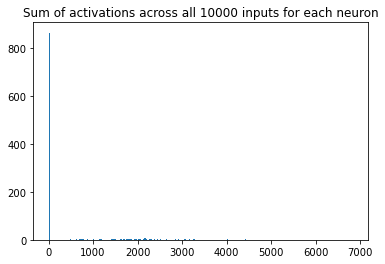

[863.   0.   0.   0.   0.] [  0.       34.19459  68.38918 102.58377 136.77837]
fraction of neurons that are never activated: 0.863 mask approach 0.863


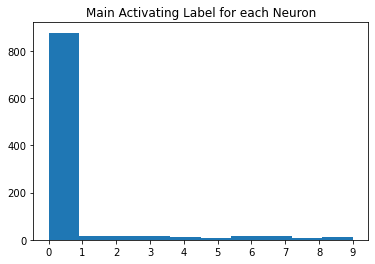

Neuron addresses should be 1000x784!!! (1000, 784) (1000, 784)
Euclidian distance


,0,1,2,3,4,5,6,7,8,9
0,0.000000,0.081122,0.101788,0.083359,0.135083,0.204340,0.115546,0.084051,0.166865,0.129584
1,0.081122,0.000000,0.143415,0.120878,0.175099,0.239656,0.151065,0.117929,0.201630,0.165081
2,0.101788,0.143415,0.000000,0.145707,0.208525,0.272706,0.172085,0.140467,0.239461,0.193355
3,0.083359,0.120878,0.145707,0.000000,0.174898,0.247393,0.168199,0.129717,0.208548,0.175833
4,0.135083,0.175099,0.208525,0.174898,0.000000,0.300763,0.203919,0.179599,0.286072,0.254725
5,0.204340,0.239656,0.272706,0.247393,0.300763,0.000000,0.273695,0.252506,0.329440,0.323059
6,0.115546,0.151065,0.172085,0.168199,0.203919,0.273695,0.000000,0.147768,0.261064,0.212680
7,0.084051,0.117929,0.140467,0.129717,0.179599,0.252506,0.147768,0.000000,0.217401,0.173160
8,0.166865,0.201630,0.239461,0.208548,0.286072,0.329440,0.261064,0.217401,0.000000,0.287011
9,0.129584,0.165081,0.193355,0.175833,0.254725,0.323059,0.212680,0.173160,0.287011,0.000000


cosine similarity


,0,1,2,3,4,5,6,7,8,9
0,1.000000,0.036580,0.091557,0.067788,0.058762,0.037544,0.071517,0.055170,0.055062,0.050706
1,0.036580,1.000000,-0.016507,-0.010976,-0.017399,0.002994,0.016212,0.010826,0.015338,0.004056
2,0.091557,-0.016507,1.000000,0.002210,-0.049887,-0.024143,0.043711,0.036180,-0.038527,-0.006165
3,0.067788,-0.010976,0.002210,1.000000,0.013452,-0.010426,-0.063530,-0.045112,0.004173,-0.031740
4,0.058762,-0.017399,-0.049887,0.013452,1.000000,-0.009958,0.034053,-0.016447,-0.092355,-0.140654
5,0.037544,0.002994,-0.024143,-0.010426,-0.009958,1.000000,0.020278,-0.036120,0.001853,-0.112696
6,0.071517,0.016212,0.043711,-0.063530,0.034053,0.020278,1.000000,0.066477,-0.074890,-0.039944
7,0.055170,0.010826,0.036180,-0.045112,-0.016447,-0.036120,0.066477,1.000000,-0.044037,-0.017633
8,0.055062,0.015338,-0.038527,0.004173,-0.092355,0.001853,-0.074890,-0.044037,1.000000,-0.124774
9,0.050706,0.004056,-0.006165,-0.031740,-0.140654,-0.112696,-0.039944,-0.017633,-0.124774,1.000000


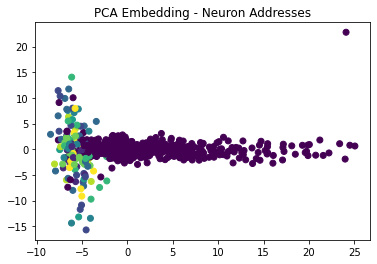

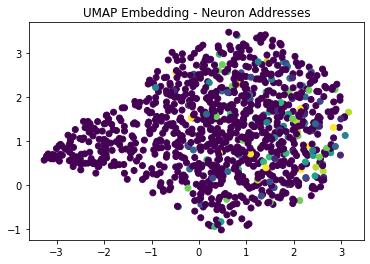

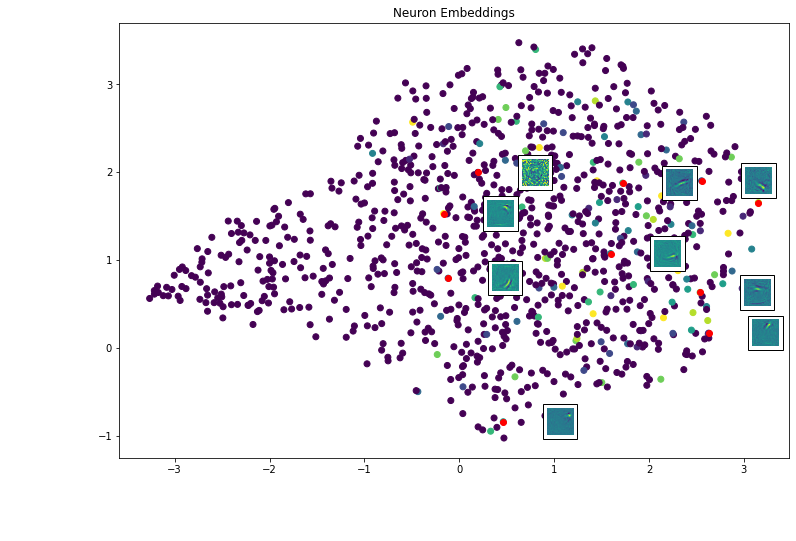

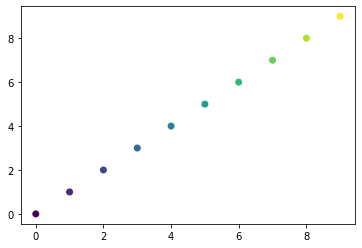

Totally random, not most active.


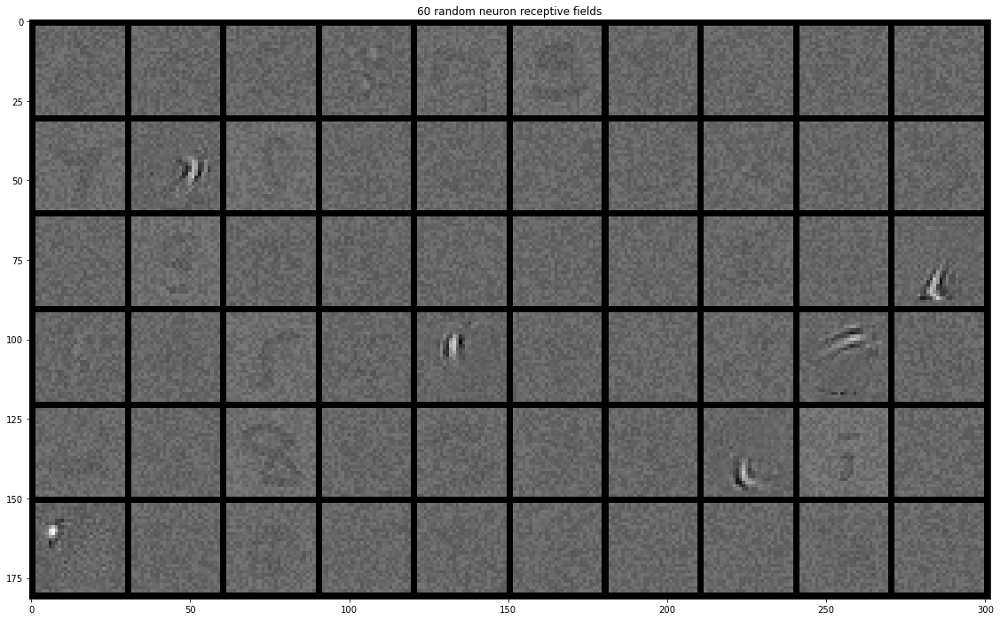

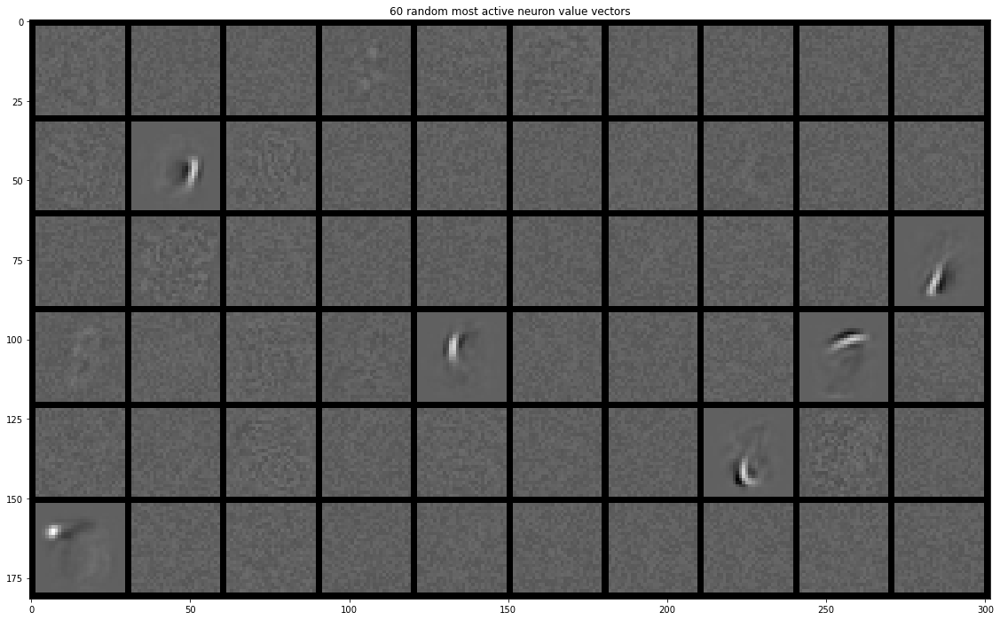

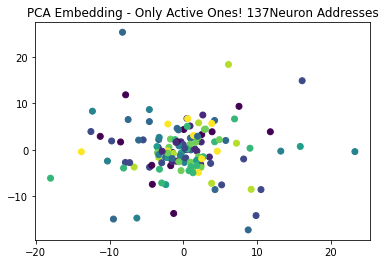

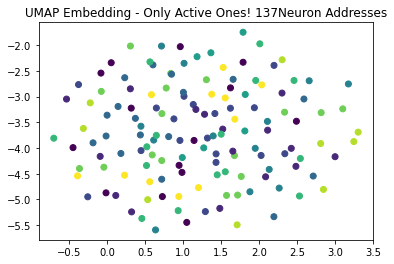

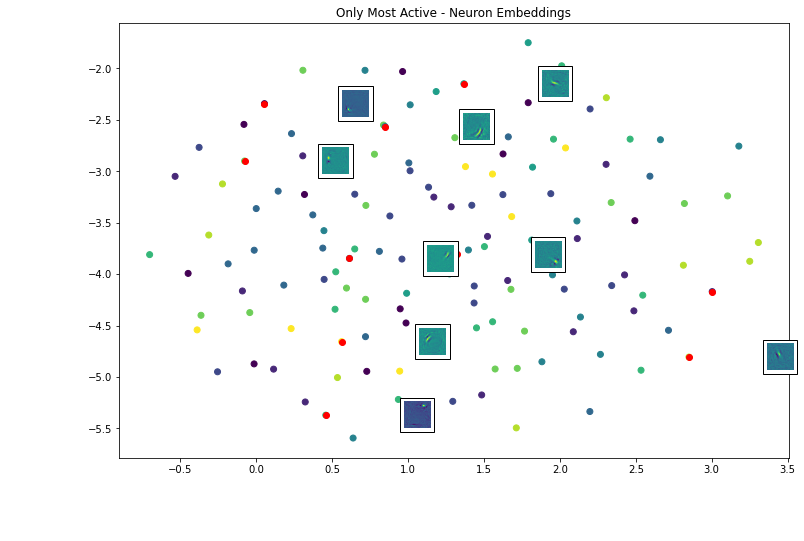

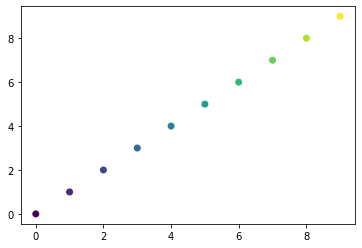

Giving some random plots from the most active neurons


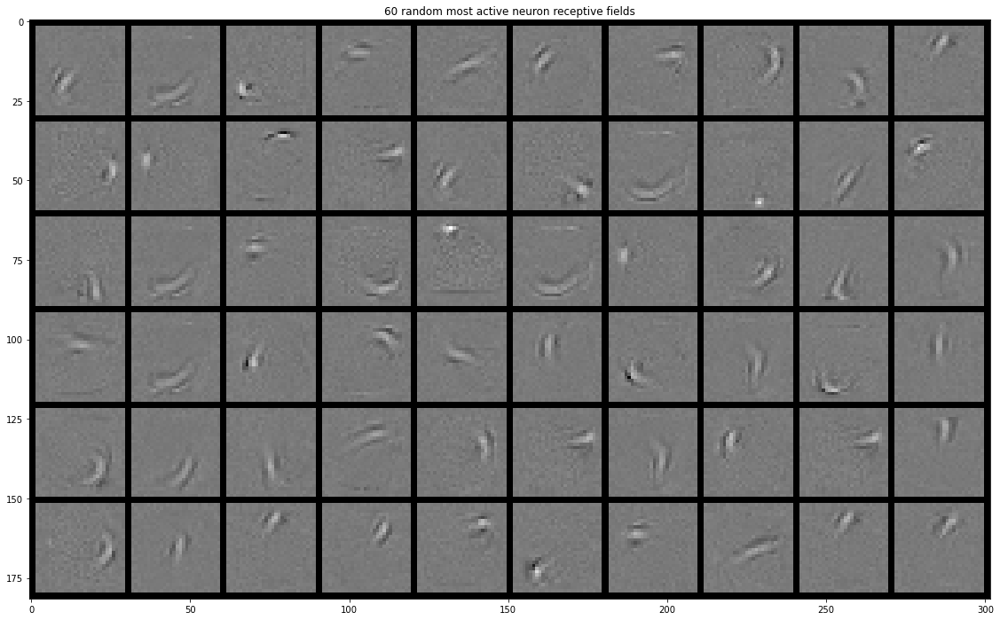

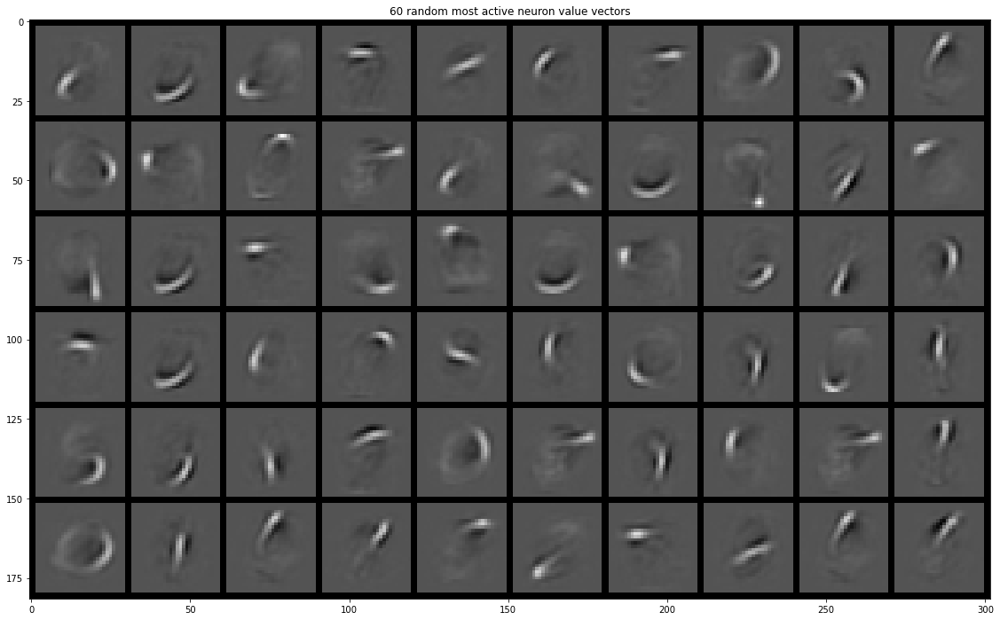

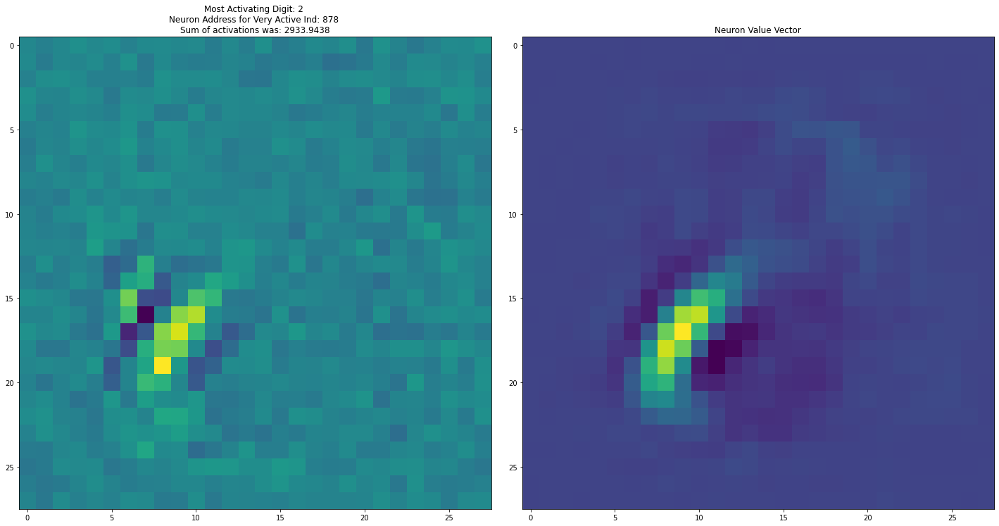

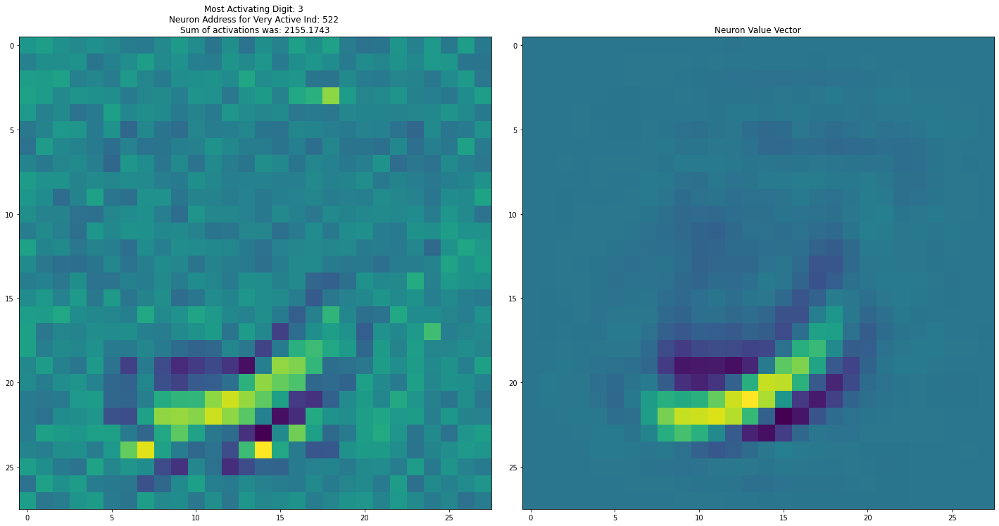

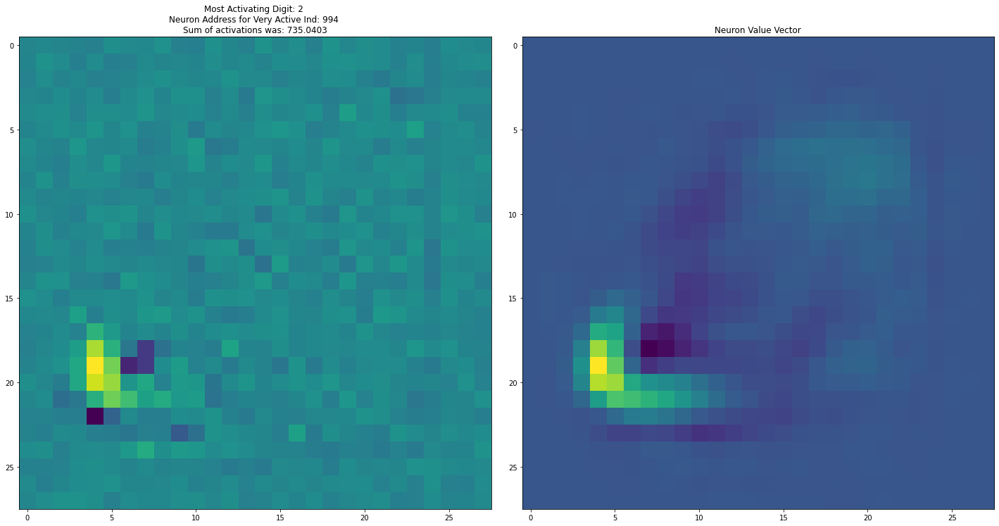

...

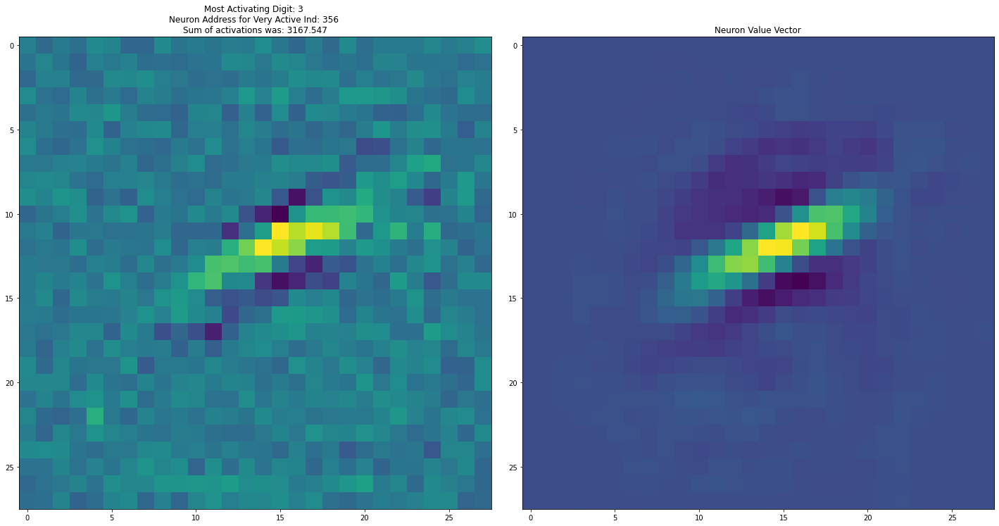

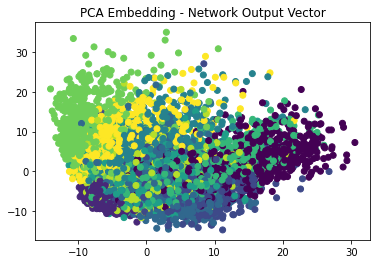

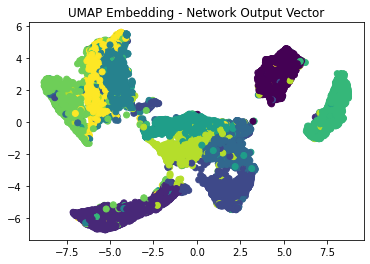

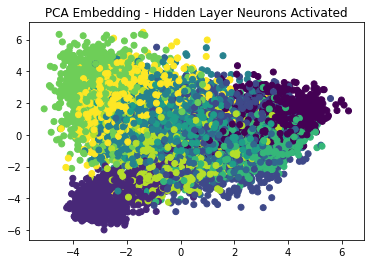

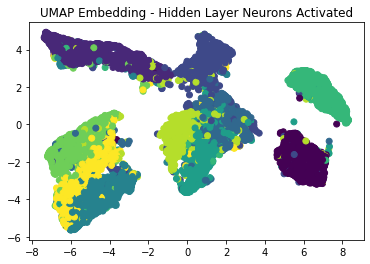

In [5]:
analyze_training(testloader, net, params)

Min top k= 8
lowest cosine sims for the top k values 10000 10000 [0.714666, 0.74376523, 0.73647183, 0.7491327, 0.7290404, 0.6939485, 0.814319, 0.82385856, 0.6618053, 0.7481008]


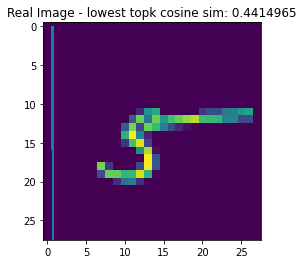

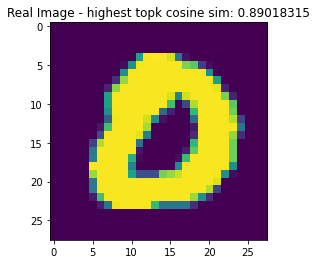

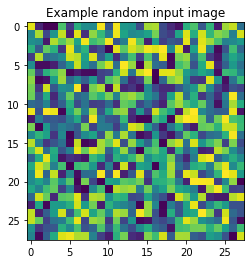

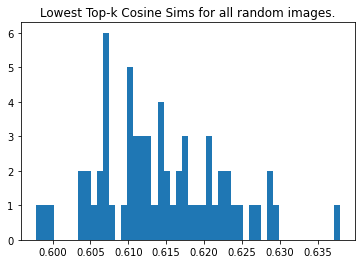

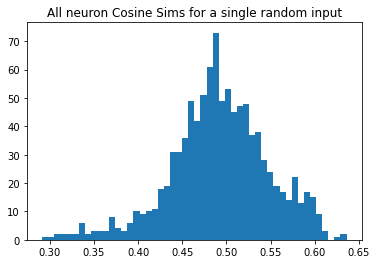

lowest top-k cosine sim tensor(0.9213)


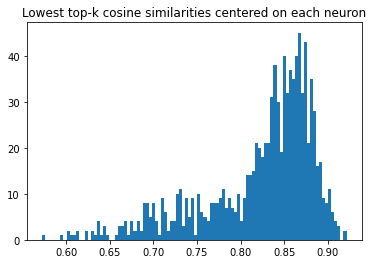

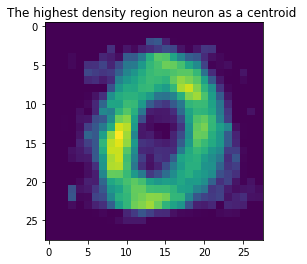

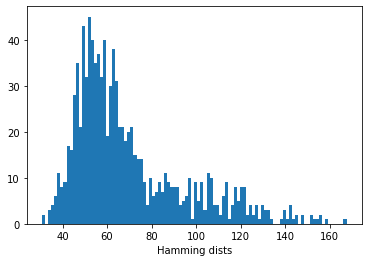

Smallest hamming distance 30.833323


In [27]:
min_hamm_dist = density_analysis(testloader, params, net)

MSE: 0.5266660699934032
-870.7939760994439
learned softmax beta vs attention beta: 459.0478662401111 0.03571428571428571


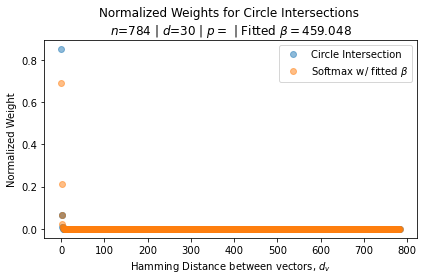

459.0478662401111

In [29]:
hamm_dist=int(min_hamm_dist)
beta_val = fit_beta_to_cosine(hamm_dist, params)

# Evaluating a bunch of different top-ks

Total number of training runs= 40
==================== K= 1 ===================
length of net parameters 2
[epoch, batch], [1,   250] loss: 0.000
mean actives 1000.0 1.0 % | max 1000 1.0 %
(128, 1000) shape of cosine sims


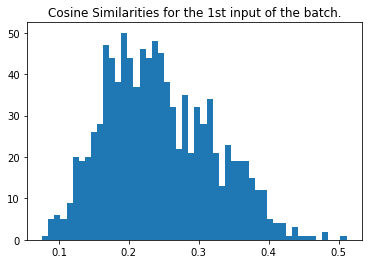

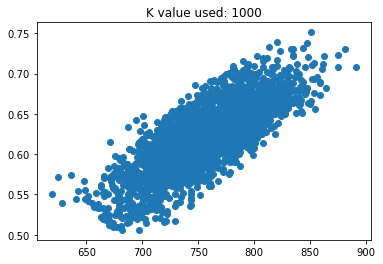

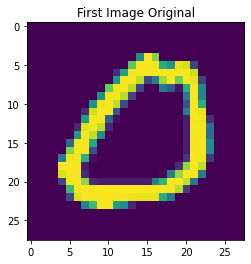

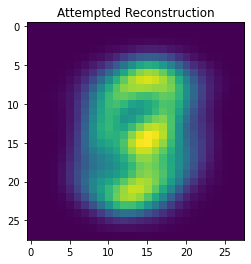

MSE loss for this input is:  0.001027219985820809
train loss: 0.000919319863896817 test loss: 0.0009380296105518937
[epoch, batch], [2,   250] loss: 0.000
mean actives 960.0 0.96 % | max 960 0.96 %
(128, 1000) shape of cosine sims


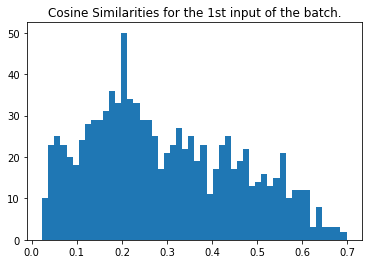

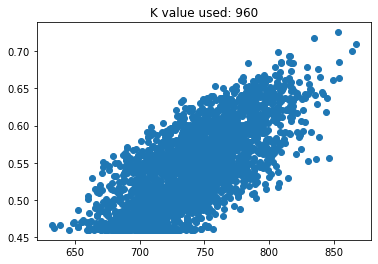

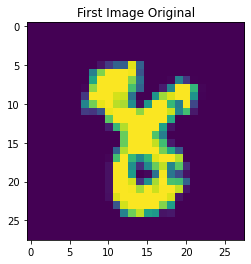

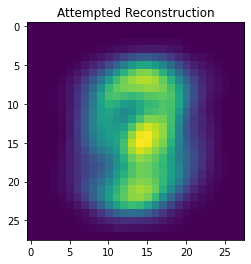

MSE loss for this input is:  0.0007942695246667278
train loss: 0.0007577000069431961 test loss: 0.0007485807873308659
[epoch, batch], [3,   250] loss: 0.000
mean actives 920.0 0.92 % | max 920 0.92 %
(128, 1000) shape of cosine sims


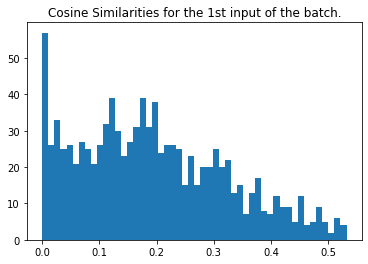

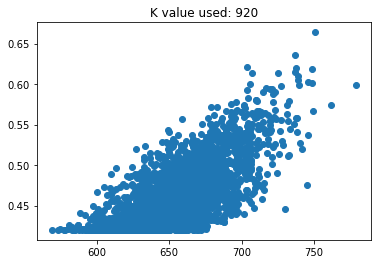

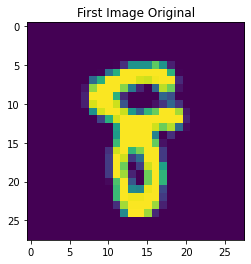

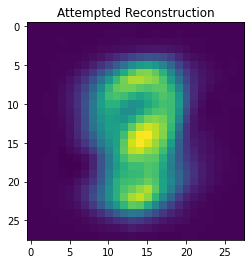

MSE loss for this input is:  0.0014352860803506812
train loss: 0.0006855744286440313 test loss: 0.0006515202694572508
[epoch, batch], [4,   250] loss: 0.000
mean actives 880.0 0.88 % | max 880 0.88 %
(128, 1000) shape of cosine sims


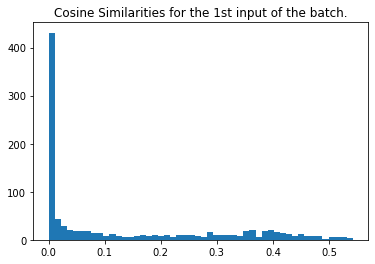

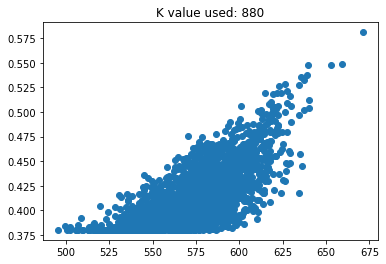

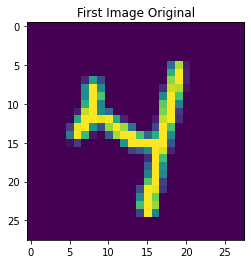

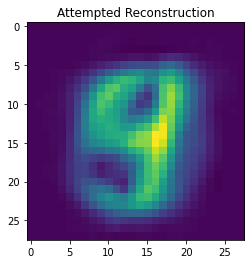

MSE loss for this input is:  0.0015312317682772266
train loss: 0.0005602765013463795 test loss: 0.0005368763231672347
[epoch, batch], [5,   250] loss: 0.000
mean actives 840.0 0.84 % | max 840 0.84 %
(128, 1000) shape of cosine sims


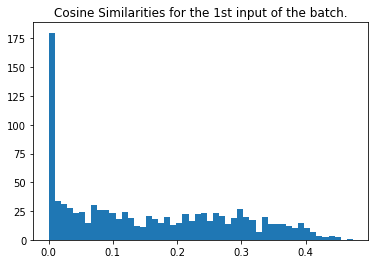

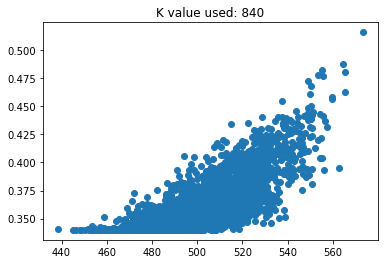

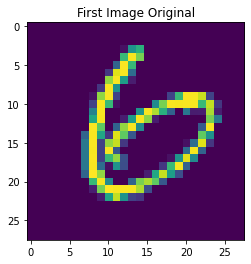

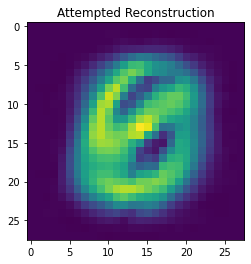

MSE loss for this input is:  0.0012017633689909565
train loss: 0.0005262945196591318 test loss: 0.0004798805748578161
[epoch, batch], [6,   250] loss: 0.000
mean actives 800.0 0.8 % | max 800 0.8 %
(128, 1000) shape of cosine sims


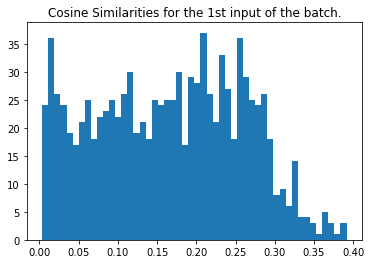

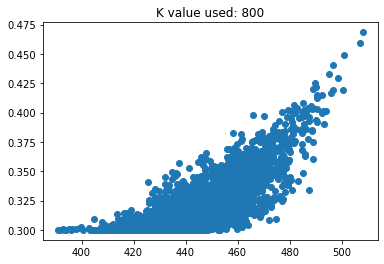

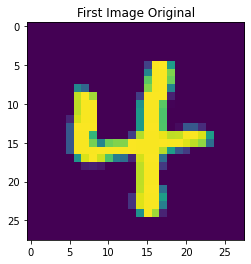

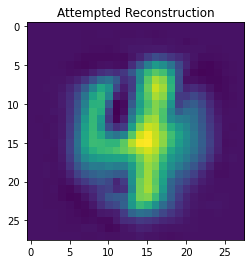

MSE loss for this input is:  0.000977108901252552
train loss: 0.00047226945753209293 test loss: 0.0004170832398813218
[epoch, batch], [7,   250] loss: 0.000
mean actives 760.0 0.76 % | max 760 0.76 %
(128, 1000) shape of cosine sims


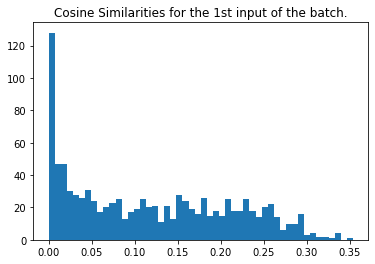

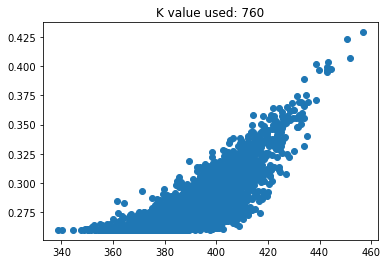

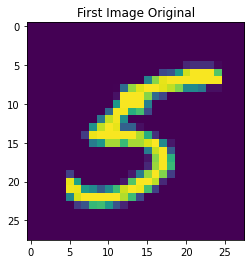

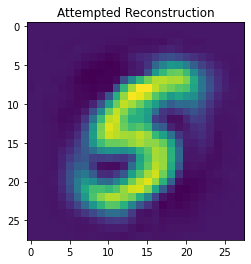

MSE loss for this input is:  0.001168358614858316
train loss: 0.00042761454824358225 test loss: 0.0003691344172693789
[epoch, batch], [8,   250] loss: 0.000
mean actives 720.0 0.72 % | max 720 0.72 %
(128, 1000) shape of cosine sims


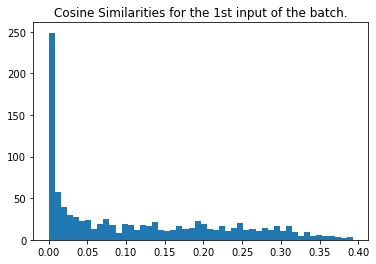

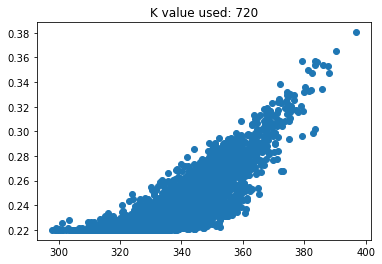

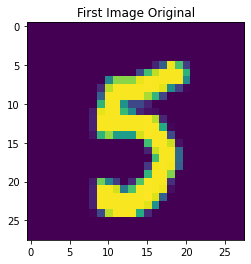

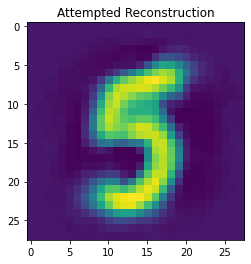

MSE loss for this input is:  0.0008473533908931576
train loss: 0.0003675749176181853 test loss: 0.0003293101617600769
[epoch, batch], [9,   250] loss: 0.000
mean actives 680.0 0.68 % | max 680 0.68 %
(128, 1000) shape of cosine sims


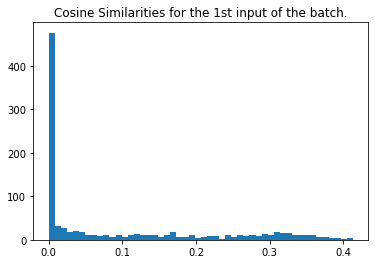

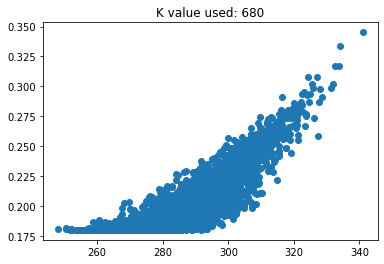

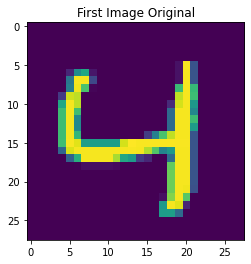

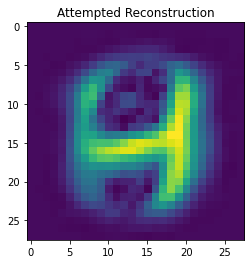

MSE loss for this input is:  0.0019669587514838396
train loss: 0.00031109305564314127 test loss: 0.0002794788160827011
[epoch, batch], [10,   250] loss: 0.000
mean actives 640.0 0.64 % | max 640 0.64 %
(128, 1000) shape of cosine sims


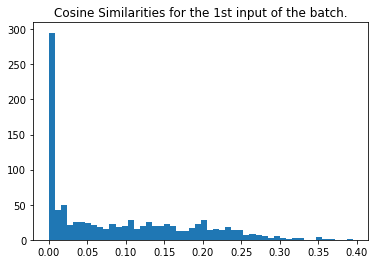

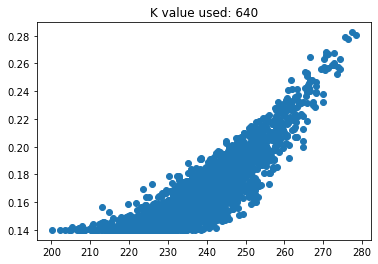

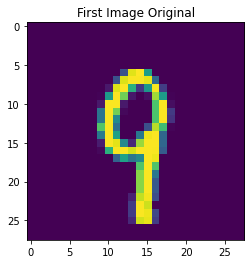

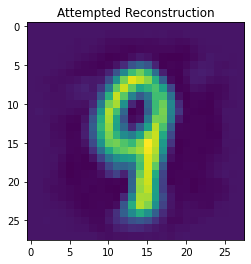

MSE loss for this input is:  0.001601431746872104
train loss: 0.00023618667910341173 test loss: 0.00022575751063413918
[epoch, batch], [11,   250] loss: 0.000
mean actives 600.0 0.6 % | max 600 0.6 %
(128, 1000) shape of cosine sims


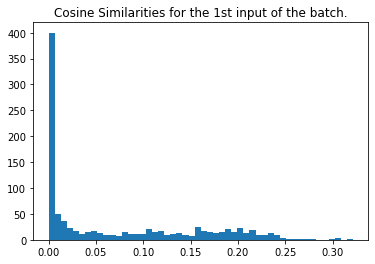

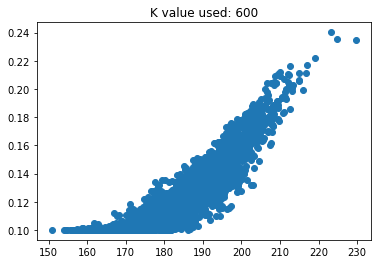

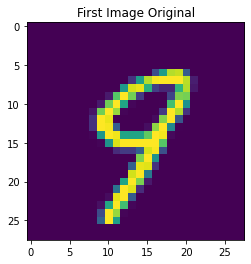

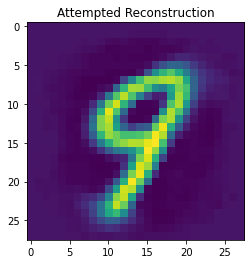

MSE loss for this input is:  0.0017782259656458485
train loss: 0.00020345873781479895 test loss: 0.00016541137301828712
[epoch, batch], [12,   250] loss: 0.000
mean actives 560.0 0.56 % | max 560 0.56 %
(128, 1000) shape of cosine sims


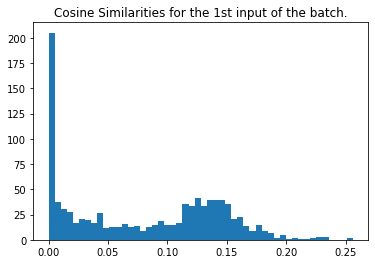

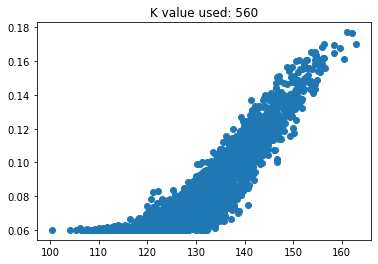

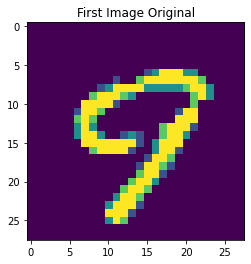

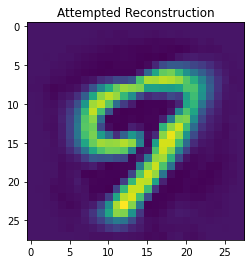

MSE loss for this input is:  0.0009627189411192524
train loss: 0.00013597050565294921 test loss: 0.0001055066823028028
[epoch, batch], [13,   250] loss: 0.000
mean actives 520.0 0.52 % | max 520 0.52 %
(128, 1000) shape of cosine sims


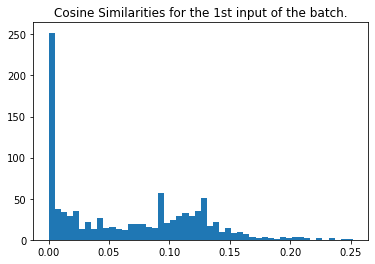

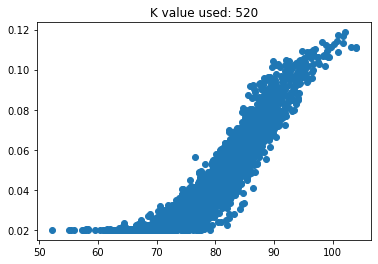

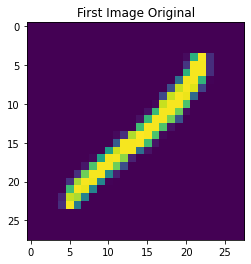

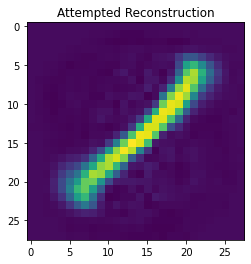

MSE loss for this input is:  0.0019864363937961813
train loss: 8.030284516280517e-05 test loss: 7.345664198510349e-05
[epoch, batch], [14,   250] loss: 0.000
mean actives 480.0 0.48 % | max 480 0.48 %
(128, 1000) shape of cosine sims


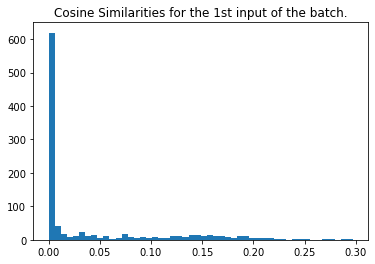

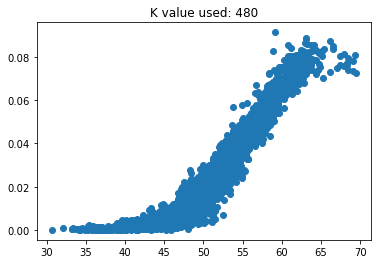

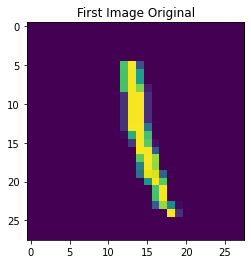

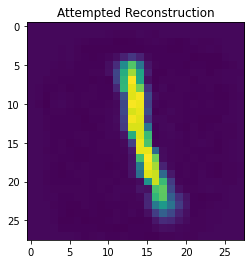

MSE loss for this input is:  0.0022332040326935904
train loss: 4.8788340791361406e-05 test loss: 5.092282299301587e-05
[epoch, batch], [15,   250] loss: 0.000
mean actives 440.0 0.44 % | max 440 0.44 %
(128, 1000) shape of cosine sims


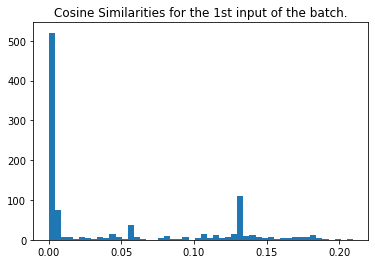

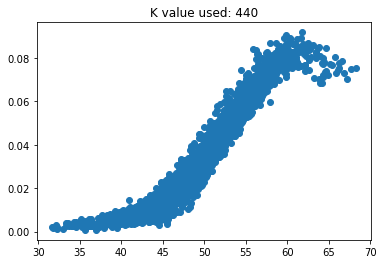

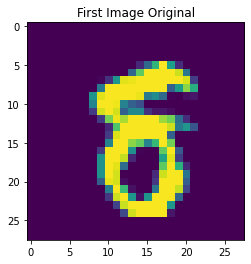

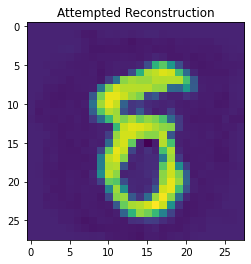

MSE loss for this input is:  0.0015955162899834768
train loss: 5.380095535656437e-05 test loss: 5.646268982673064e-05
[epoch, batch], [16,   250] loss: 0.000
mean actives 400.0 0.4 % | max 400 0.4 %
(128, 1000) shape of cosine sims


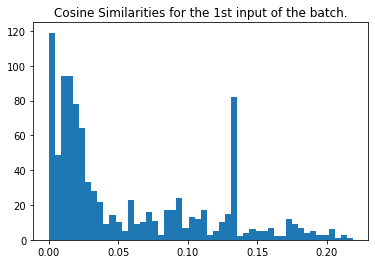

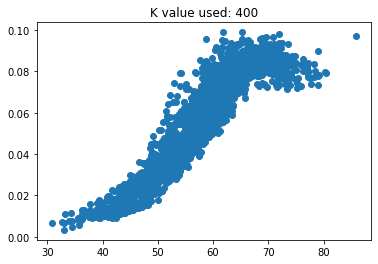

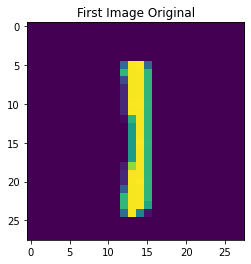

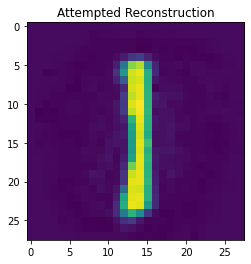

MSE loss for this input is:  0.001169875188141453
train loss: 5.878459705854766e-05 test loss: 5.943801807006821e-05
[epoch, batch], [17,   250] loss: 0.000
mean actives 360.0 0.36 % | max 360 0.36 %
(128, 1000) shape of cosine sims


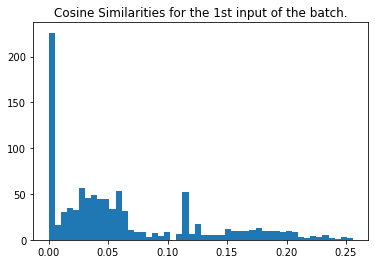

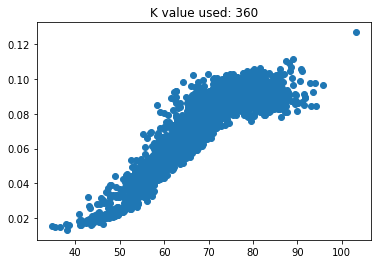

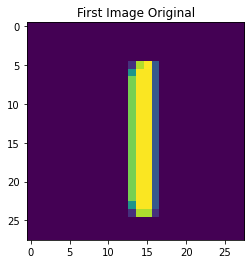

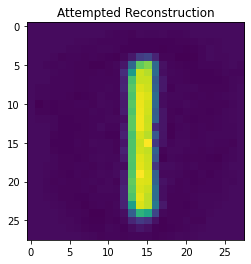

MSE loss for this input is:  0.00228922145099056
train loss: 6.704580300720409e-05 test loss: 7.427165110129863e-05
[epoch, batch], [18,   250] loss: 0.000
mean actives 320.0 0.32 % | max 320 0.32 %
(128, 1000) shape of cosine sims


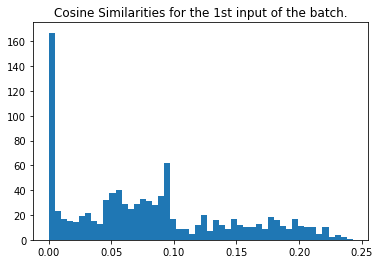

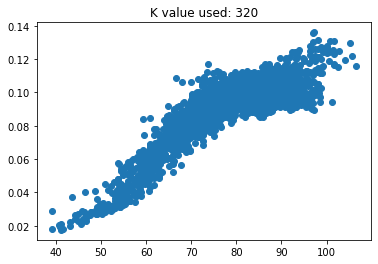

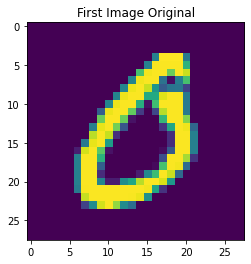

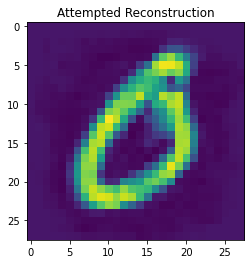

MSE loss for this input is:  0.0010244019937758542
train loss: 7.032035500742495e-05 test loss: 7.973146421136335e-05
[epoch, batch], [19,   250] loss: 0.000
mean actives 280.0 0.28 % | max 280 0.28 %
(128, 1000) shape of cosine sims


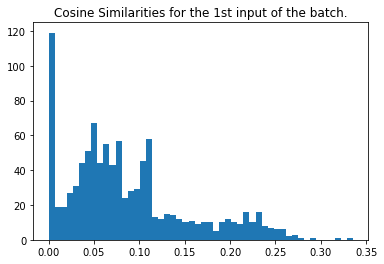

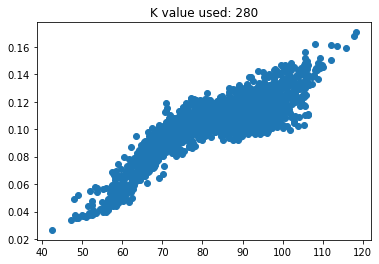

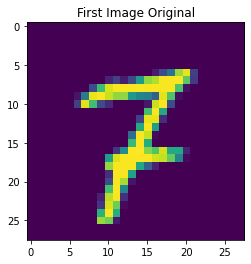

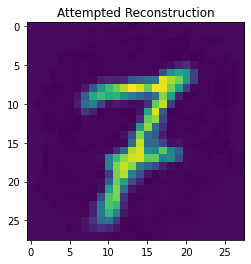

MSE loss for this input is:  0.0014309539478652331
train loss: 6.851277430541813e-05 test loss: 7.254253432620317e-05
[epoch, batch], [20,   250] loss: 0.000
mean actives 240.0 0.24 % | max 240 0.24 %
(128, 1000) shape of cosine sims


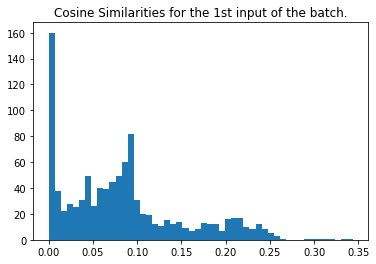

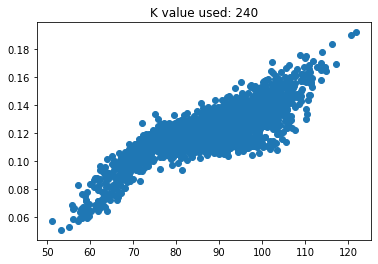

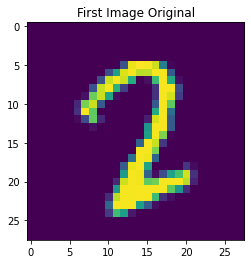

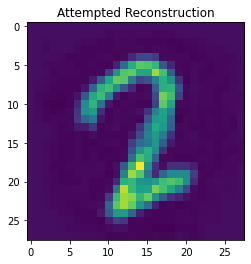

MSE loss for this input is:  0.0014106486828959718
train loss: 7.276778342202306e-05 test loss: 6.589556141989306e-05
[epoch, batch], [21,   250] loss: 0.000
mean actives 200.0 0.2 % | max 200 0.2 %
(128, 1000) shape of cosine sims


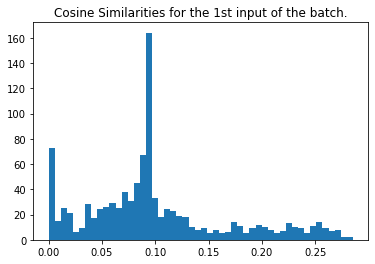

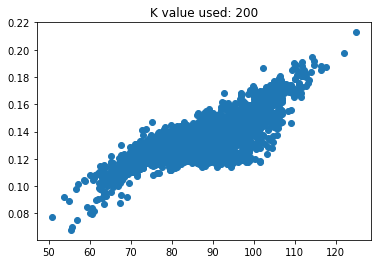

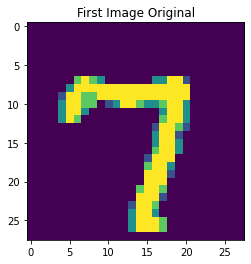

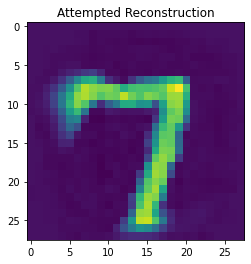

MSE loss for this input is:  0.0014457868374123865
train loss: 6.178639887366444e-05 test loss: 6.666339322691783e-05
[epoch, batch], [22,   250] loss: 0.000
mean actives 160.0 0.16 % | max 160 0.16 %
(128, 1000) shape of cosine sims


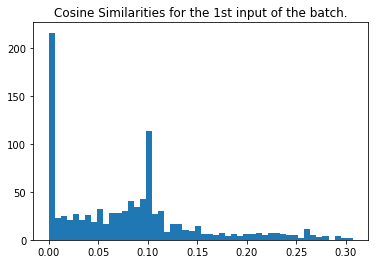

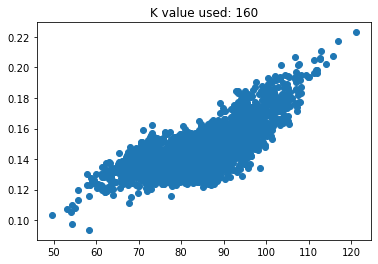

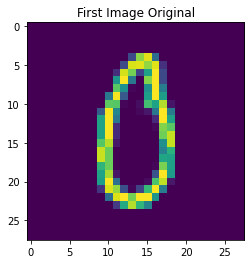

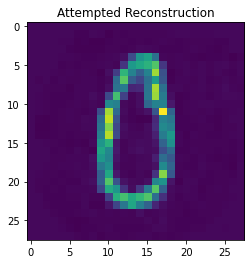

MSE loss for this input is:  0.0014776514500987772
train loss: 6.264691182877868e-05 test loss: 6.496838614111766e-05
[epoch, batch], [23,   250] loss: 0.000
mean actives 120.0 0.12 % | max 120 0.12 %
(128, 1000) shape of cosine sims


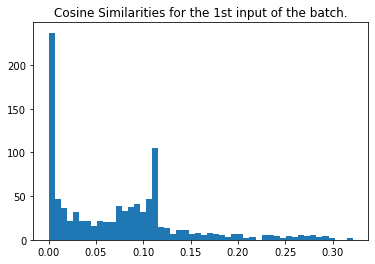

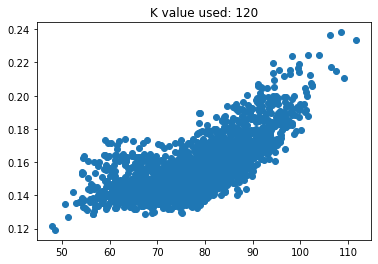

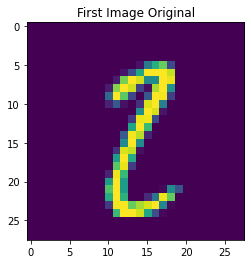

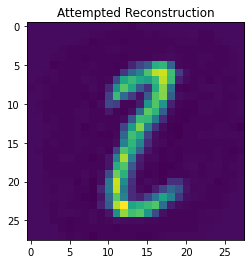

MSE loss for this input is:  0.0020909336756686774
train loss: 7.455868762917817e-05 test loss: 6.72118112561293e-05
[epoch, batch], [24,   250] loss: 0.000
mean actives 80.0 0.08 % | max 80 0.08 %
(128, 1000) shape of cosine sims


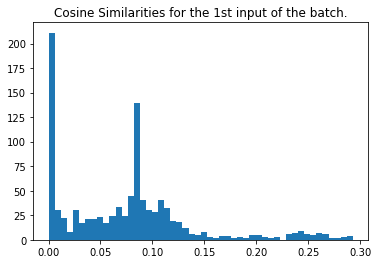

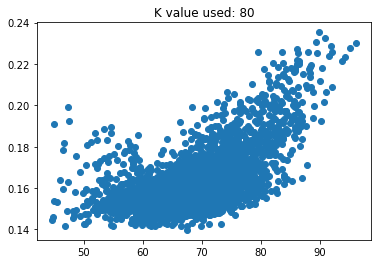

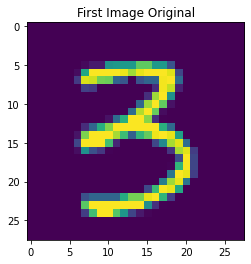

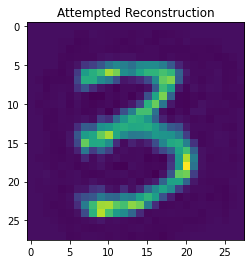

MSE loss for this input is:  0.0009156449564865657
train loss: 8.653680561110377e-05 test loss: 8.919697575038299e-05
[epoch, batch], [25,   250] loss: 0.000
mean actives 40.0 0.04 % | max 40 0.04 %
(128, 1000) shape of cosine sims


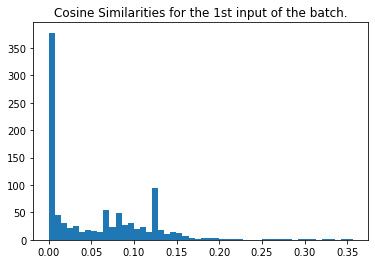

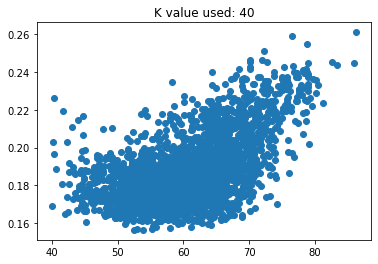

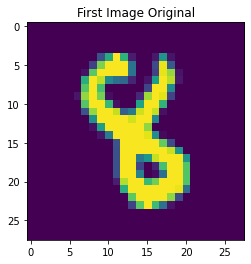

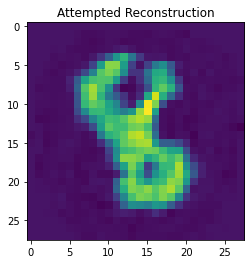

MSE loss for this input is:  0.001049953683906672
train loss: 0.00013314769603312016 test loss: 0.0001319090079050511
[epoch, batch], [26,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


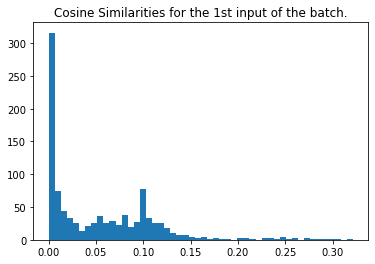

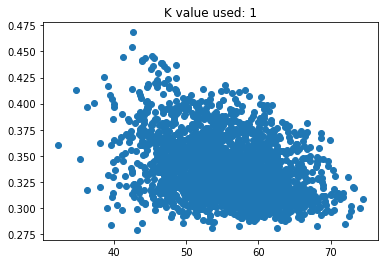

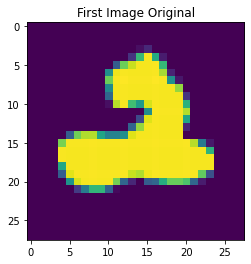

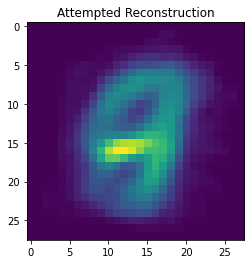

MSE loss for this input is:  0.0011076812385296334
train loss: 0.0007525508408434689 test loss: 0.0007399251335300505
[epoch, batch], [27,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


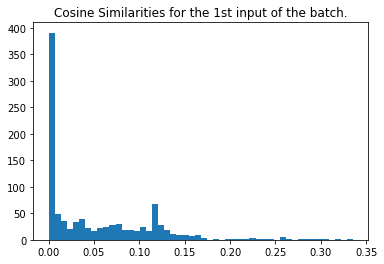

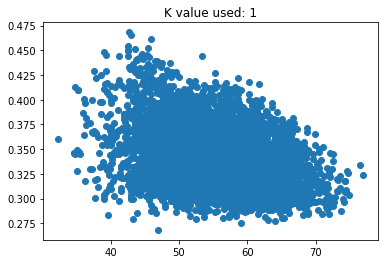

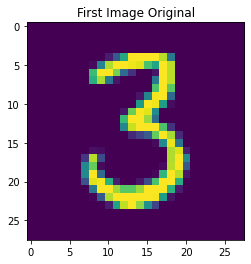

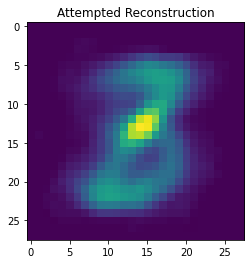

MSE loss for this input is:  0.0007613305838740602
train loss: 0.0007332651875913143 test loss: 0.0007395706488750875
[epoch, batch], [28,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


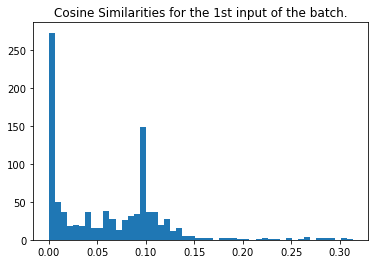

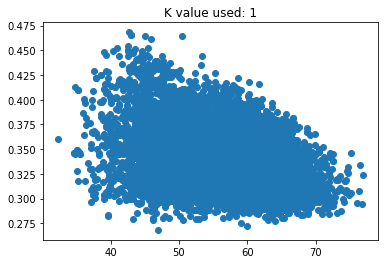

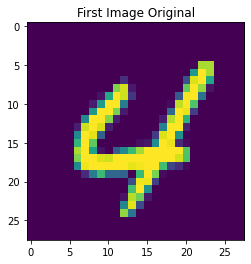

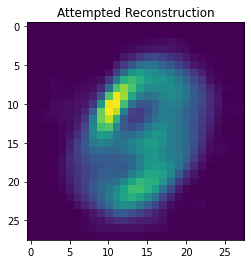

MSE loss for this input is:  0.0008036659232207707
train loss: 0.0007051717839203775 test loss: 0.0007205436704680324
[epoch, batch], [29,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


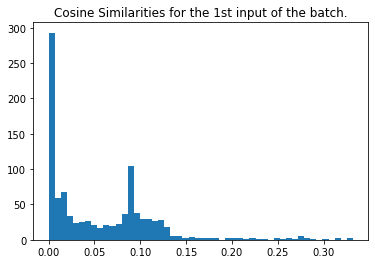

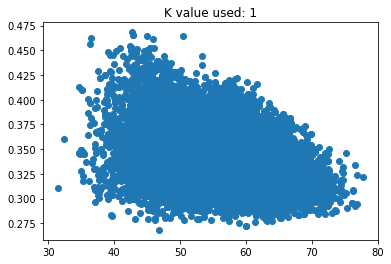

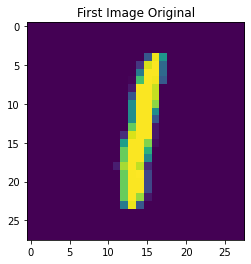

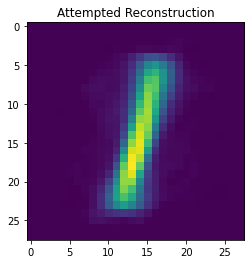

MSE loss for this input is:  0.0016629746069713514
train loss: 0.0007306494517251849 test loss: 0.0007517611375078559
[epoch, batch], [30,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


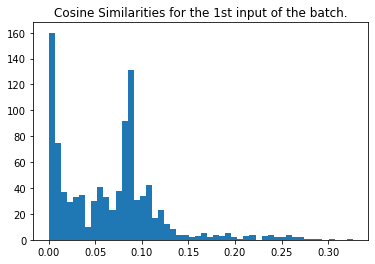

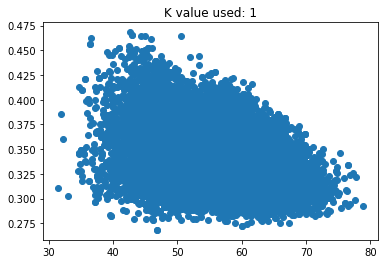

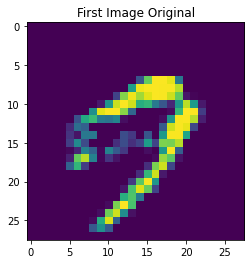

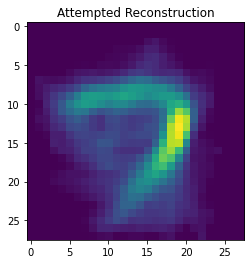

MSE loss for this input is:  0.0010603419219960971
train loss: 0.0007216727244667709 test loss: 0.0007126408163458109
[epoch, batch], [31,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


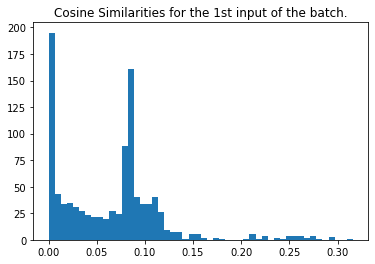

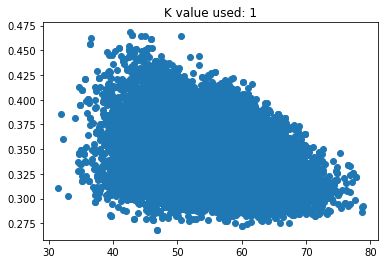

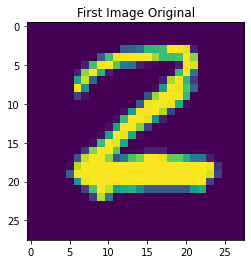

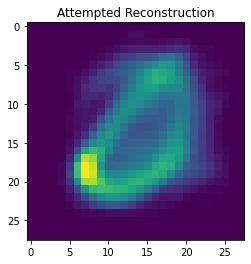

MSE loss for this input is:  0.0009682579916350696
train loss: 0.000720265437848866 test loss: 0.0007307042833417654
[epoch, batch], [32,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


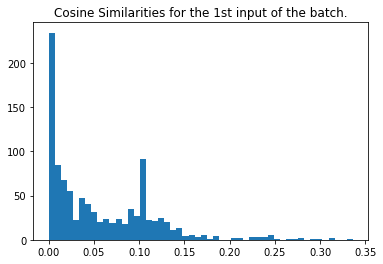

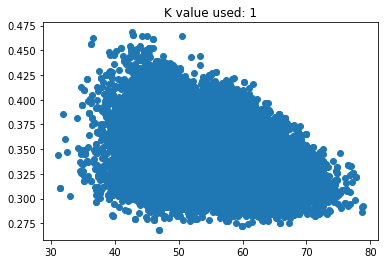

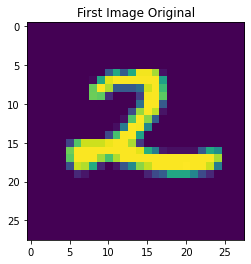

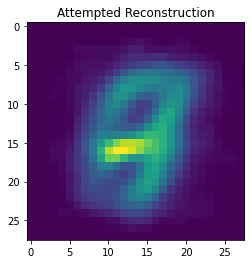

MSE loss for this input is:  0.0010996099029268538
train loss: 0.0007595908246003091 test loss: 0.0007432550773955882
[epoch, batch], [33,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


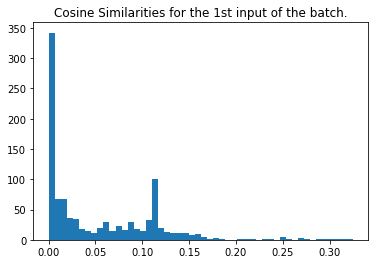

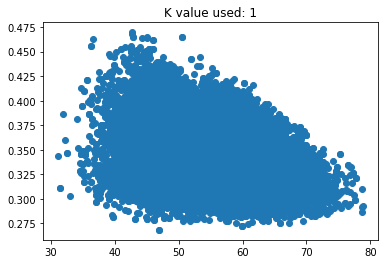

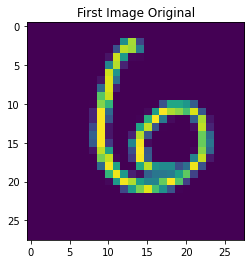

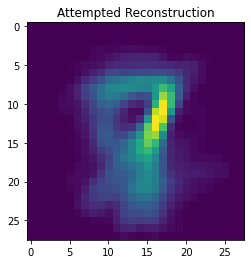

MSE loss for this input is:  0.0009962281554329153
train loss: 0.0007335025002248585 test loss: 0.0007726898184046149
[epoch, batch], [34,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


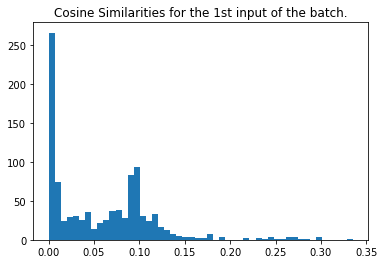

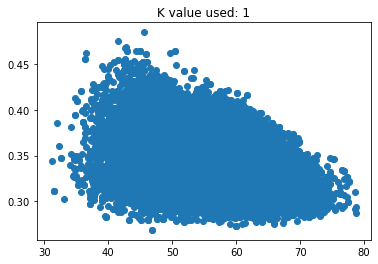

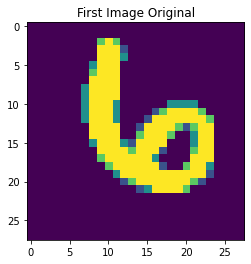

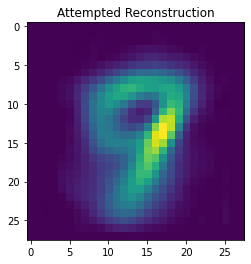

MSE loss for this input is:  0.0009439786782070082
train loss: 0.0007436826126649976 test loss: 0.0007627771119587123
[epoch, batch], [35,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


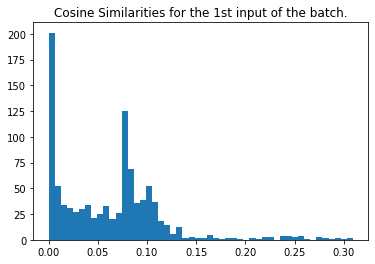

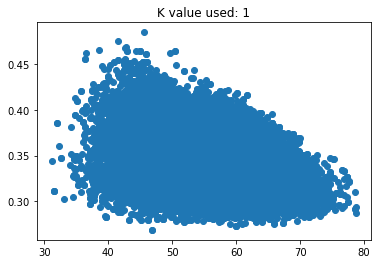

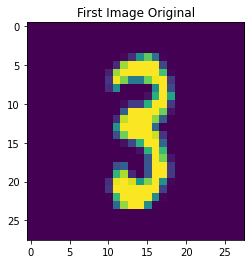

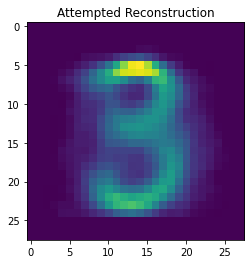

MSE loss for this input is:  0.0006985258387059582
train loss: 0.0007372055551968515 test loss: 0.0006829113699495792
[epoch, batch], [36,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


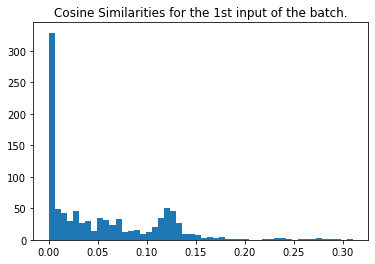

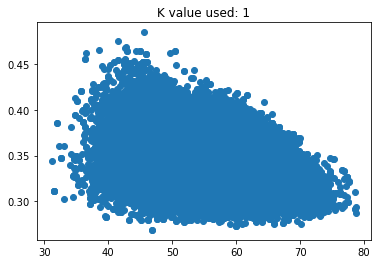

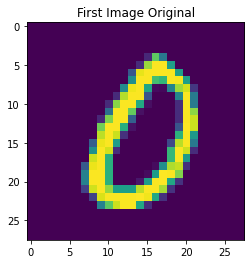

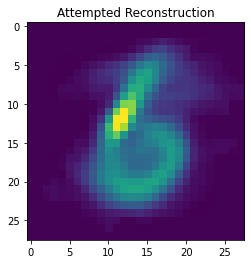

MSE loss for this input is:  0.0007438904472759791
train loss: 0.0007282368023879826 test loss: 0.0007275213720276952
[epoch, batch], [37,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


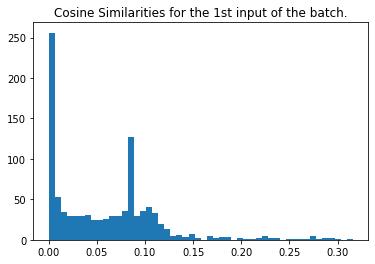

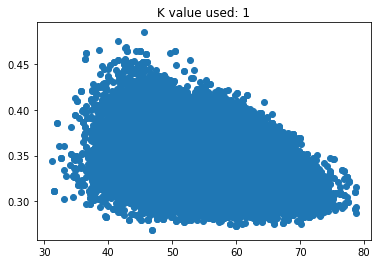

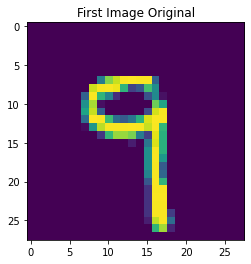

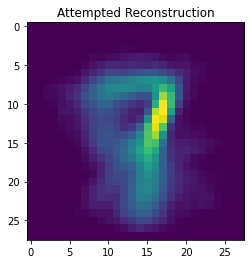

MSE loss for this input is:  0.0013906198496721229
train loss: 0.0007415921427309513 test loss: 0.0007462706998921931
[epoch, batch], [38,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


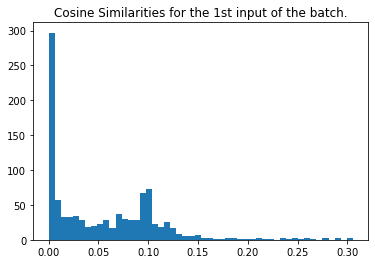

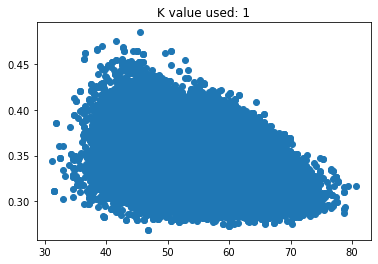

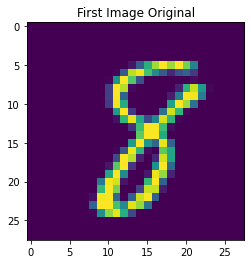

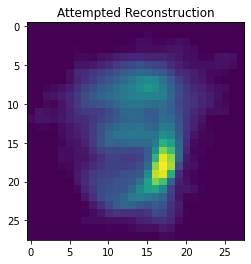

MSE loss for this input is:  0.0011806779217963315
train loss: 0.0007379578892141581 test loss: 0.0007512592128477991
[epoch, batch], [39,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


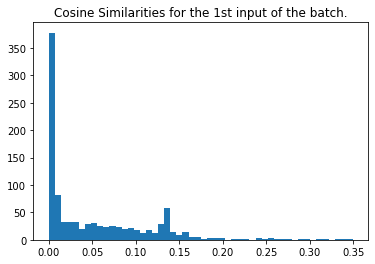

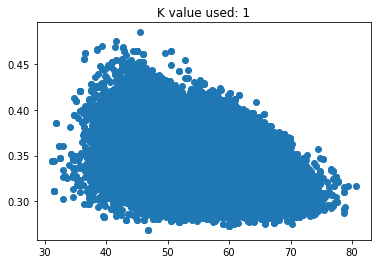

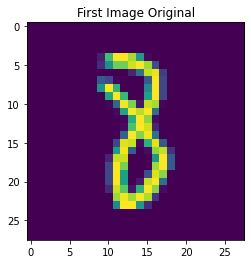

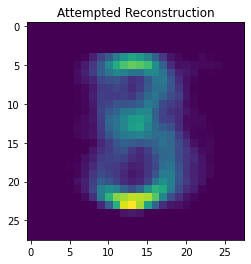

MSE loss for this input is:  0.0014275358039505628
train loss: 0.0007245445740409195 test loss: 0.0007596967043355107
[epoch, batch], [40,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


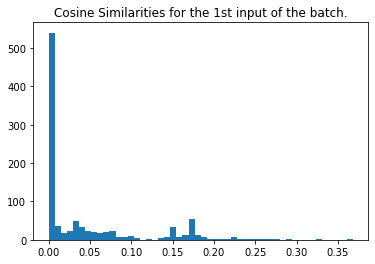

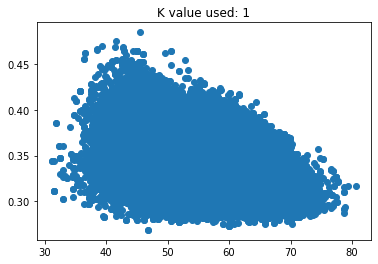

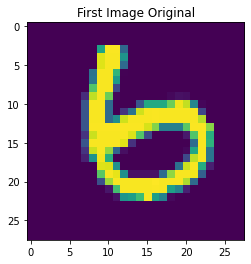

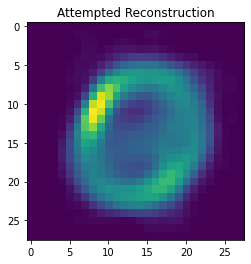

MSE loss for this input is:  0.001749735705706538
train loss: 0.0007250910275615752 test loss: 0.000686786079313606
Finished Training


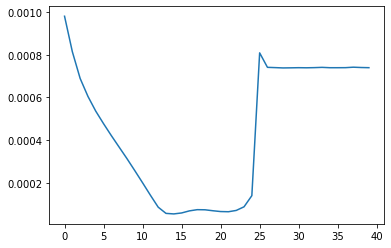

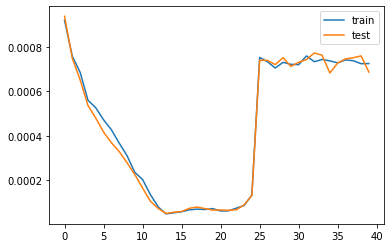

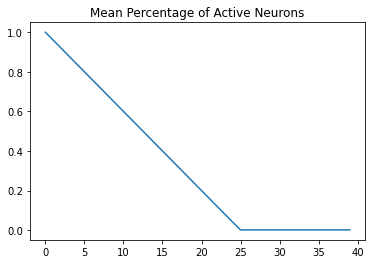

Latents and Labels dimensions: (60000, 1000) (60000,)
Latents and Labels dimensions: (10000, 1000) (10000,)
Logistic regression accuracy: Train= 0.347 | Test= 0.345


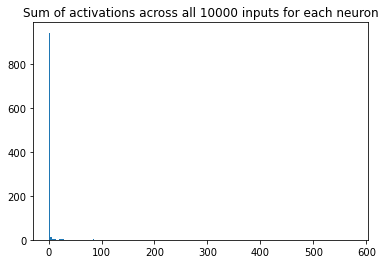

[944.  13.   4.   3.   2.   1.   0.   4.   4.   3.   0.   1.   1.   1.
   1.   0.   0.   1.   1.   0.   1.   1.   0.   1.   1.   0.   0.   1.
   1.   2.   0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   1.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   1.   0.   0.   0.   0.   0.   0.   0.   1.   1.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.   1.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0. 

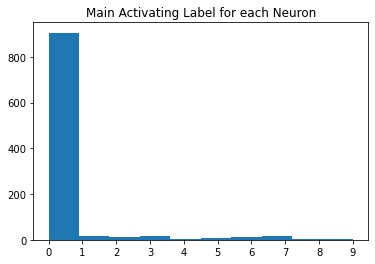

Neuron addresses should be 1000x784!!! (1000, 784) (1000, 784)
Euclidian distance


,0,1,2,3,4,5,6,7,8,9
0,0.000000,0.094938,0.120673,0.091348,0.284624,0.154177,0.103431,0.091996,0.354260,0.269000
1,0.094938,0.000000,0.170377,0.129311,0.327077,0.206319,0.156693,0.145450,0.418263,0.314282
2,0.120673,0.170377,0.000000,0.147695,0.350366,0.228118,0.174442,0.174290,0.422898,0.336856
3,0.091348,0.129311,0.147695,0.000000,0.321107,0.194313,0.152265,0.133626,0.391951,0.304245
4,0.284624,0.327077,0.350366,0.321107,0.000000,0.371203,0.338005,0.326480,0.612933,0.487230
5,0.154177,0.206319,0.228118,0.194313,0.371203,0.000000,0.203918,0.200250,0.437370,0.382764
6,0.103431,0.156693,0.174442,0.152265,0.338005,0.203918,0.000000,0.163525,0.413378,0.347958
7,0.091996,0.145450,0.174290,0.133626,0.326480,0.200250,0.163525,0.000000,0.397240,0.314906
8,0.354260,0.418263,0.422898,0.391951,0.612933,0.437370,0.413378,0.397240,0.000000,0.572733
9,0.269000,0.314282,0.336856,0.304245,0.487230,0.382764,0.347958,0.314906,0.572733,0.000000


cosine similarity


,0,1,2,3,4,5,6,7,8,9
0,1.000000,0.697174,0.477198,0.649261,0.437753,0.562824,0.553007,0.642723,0.345344,0.374922
1,0.697174,1.000000,0.402588,0.513837,0.320544,0.383966,0.423483,0.453504,0.231527,0.304262
2,0.477198,0.402588,1.000000,0.466453,0.279658,0.336587,0.382240,0.370395,0.235277,0.264477
3,0.649261,0.513837,0.466453,1.000000,0.324378,0.406984,0.421045,0.480468,0.278505,0.317612
4,0.437753,0.320544,0.279658,0.324378,1.000000,0.295270,0.290945,0.311491,0.140923,0.221628
5,0.562824,0.383966,0.336587,0.406984,0.295270,1.000000,0.386579,0.388548,0.263838,0.232264
6,0.553007,0.423483,0.382240,0.421045,0.290945,0.386579,1.000000,0.378693,0.238387,0.216587
7,0.642723,0.453504,0.370395,0.480468,0.311491,0.388548,0.378693,1.000000,0.266907,0.290782
8,0.345344,0.231527,0.235277,0.278505,0.140923,0.263838,0.238387,0.266907,1.000000,0.169366
9,0.374922,0.304262,0.264477,0.317612,0.221628,0.232264,0.216587,0.290782,0.169366,1.000000


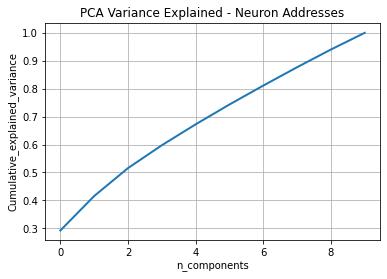

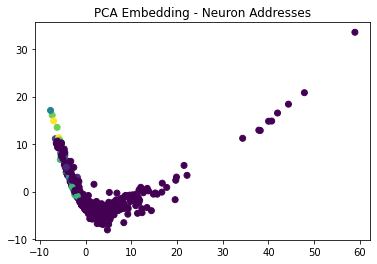

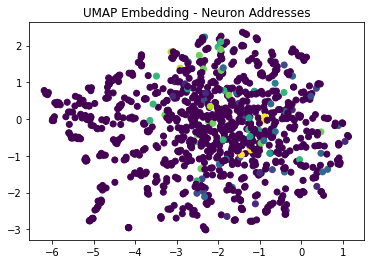

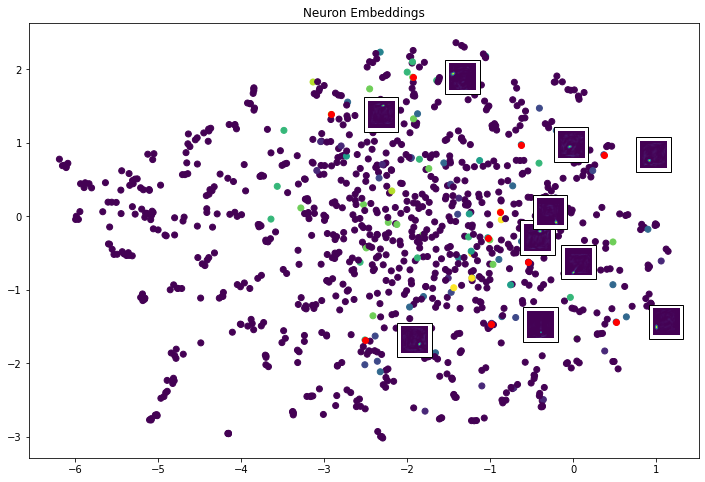

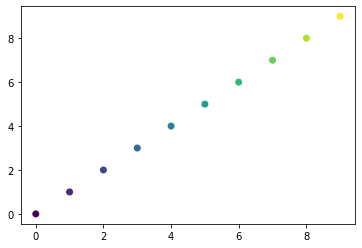

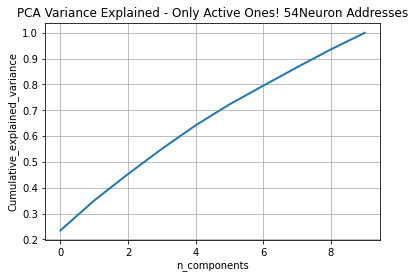

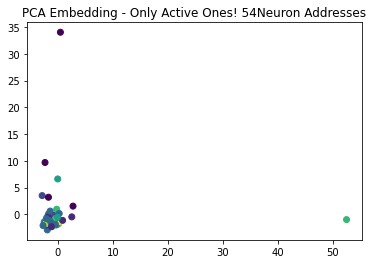

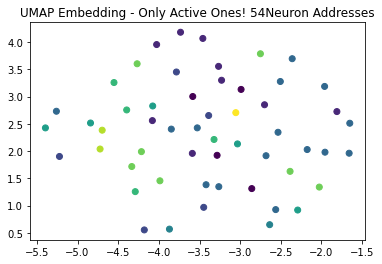

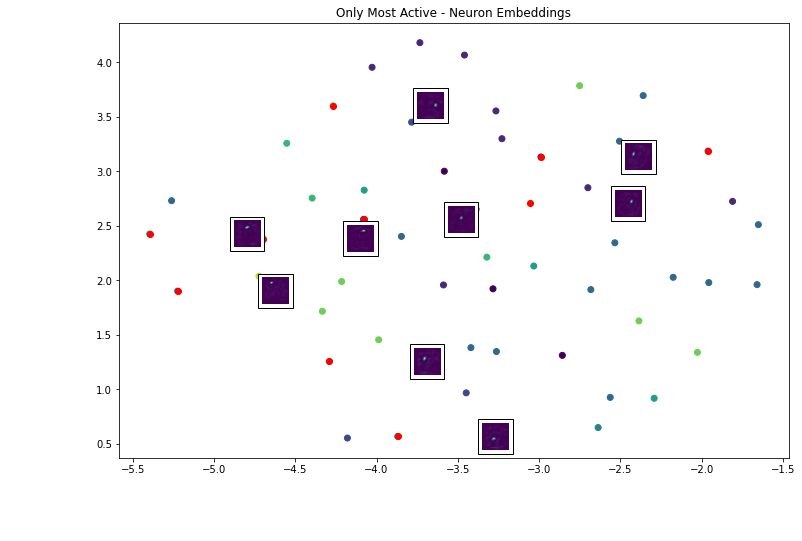

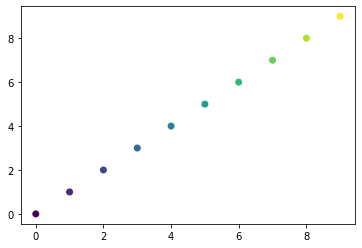

Giving some random plots from the most active neurons


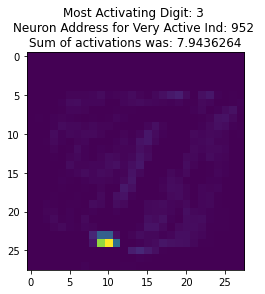

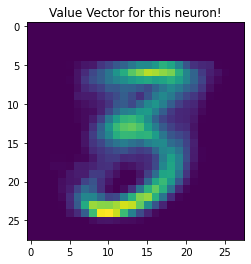

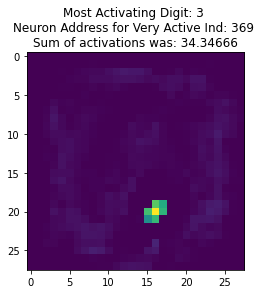

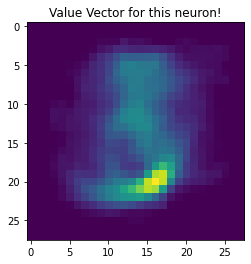

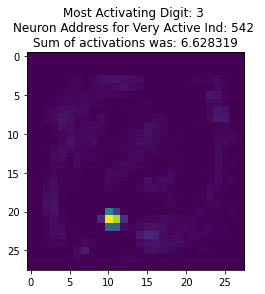

...

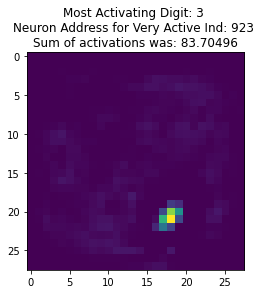

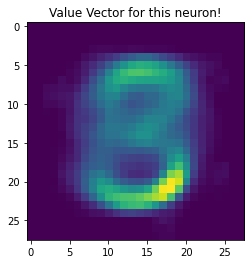

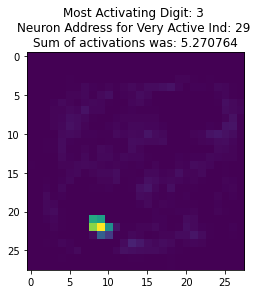

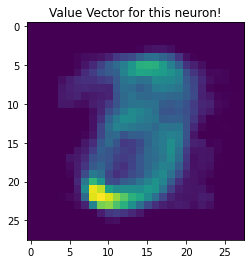

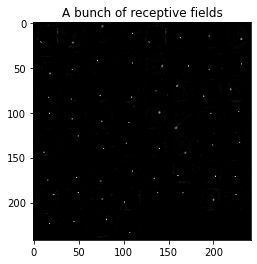

length of net parameters 2
[epoch, batch], [1,   250] loss: 0.000
mean actives 1000.0 1.0 % | max 1000 1.0 %
(128, 1000) shape of cosine sims


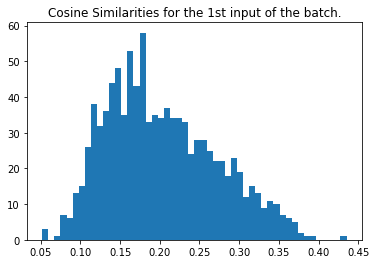

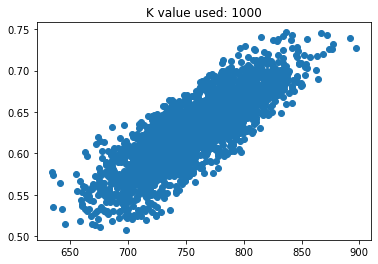

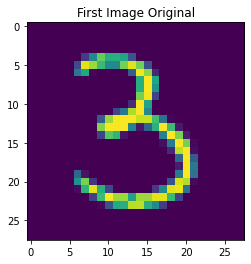

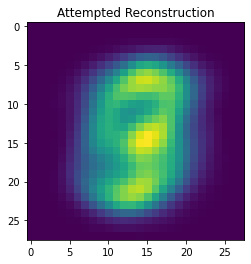

MSE loss for this input is:  0.0014002373328014296
train loss: 0.0009390858467668295 test loss: 0.0009031911613419652
[epoch, batch], [2,   250] loss: 0.000
mean actives 960.0 0.96 % | max 960 0.96 %
(128, 1000) shape of cosine sims


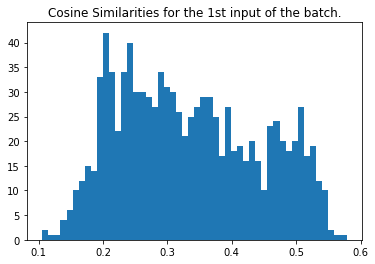

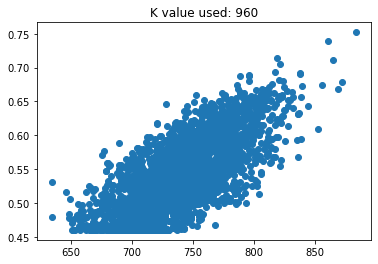

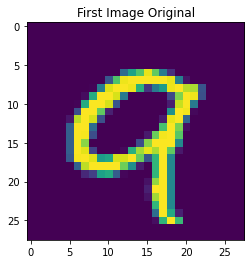

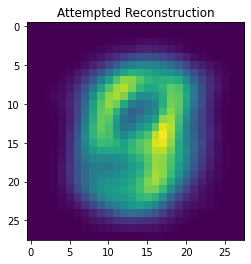

MSE loss for this input is:  0.000725152997338042
train loss: 0.0007431901758536696 test loss: 0.0007659606635570526
[epoch, batch], [3,   250] loss: 0.000
mean actives 920.0 0.92 % | max 920 0.92 %
(128, 1000) shape of cosine sims


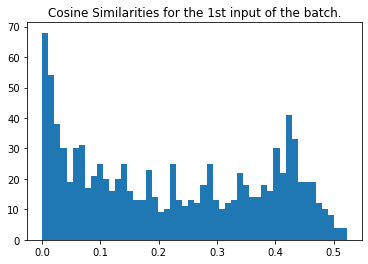

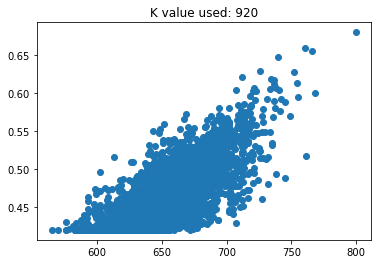

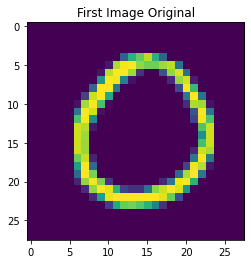

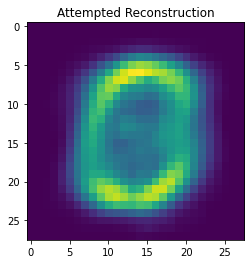

MSE loss for this input is:  0.0008285311715943473
train loss: 0.0006488602957688272 test loss: 0.0006777367671020329
[epoch, batch], [4,   250] loss: 0.000
mean actives 880.0 0.88 % | max 880 0.88 %
(128, 1000) shape of cosine sims


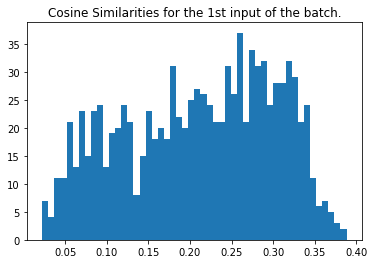

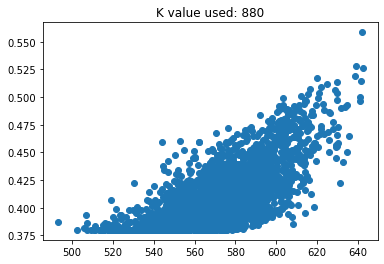

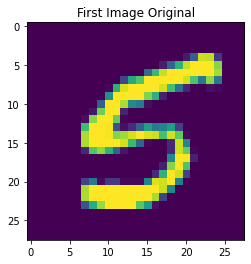

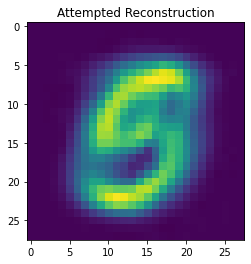

MSE loss for this input is:  0.0006643586925097875
train loss: 0.0005806617555208504 test loss: 0.0005563045851886272
[epoch, batch], [5,   250] loss: 0.000
mean actives 840.0 0.84 % | max 840 0.84 %
(128, 1000) shape of cosine sims


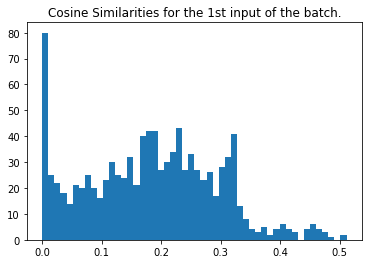

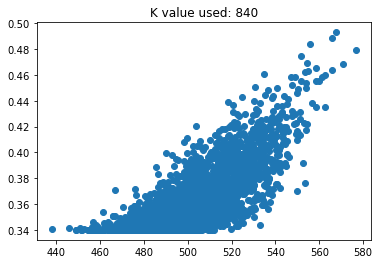

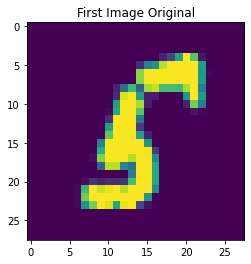

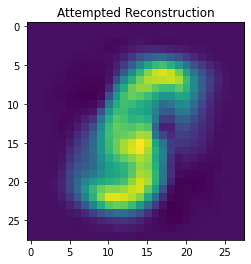

MSE loss for this input is:  0.0010626769947762393
train loss: 0.0005266274092718959 test loss: 0.0005054821958765388
[epoch, batch], [6,   250] loss: 0.000
mean actives 800.0 0.8 % | max 800 0.8 %
(128, 1000) shape of cosine sims


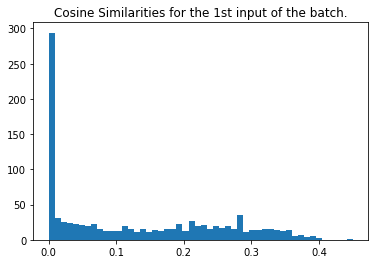

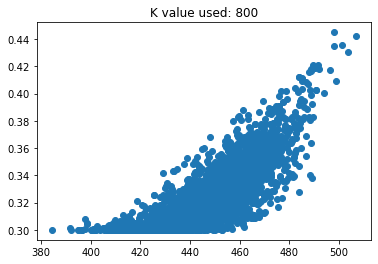

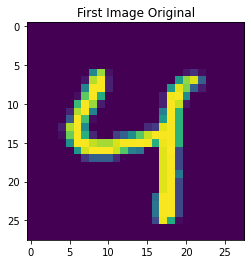

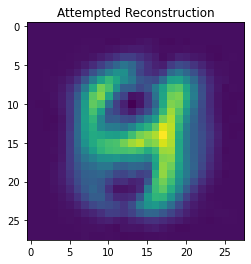

MSE loss for this input is:  0.0012536675346140958
train loss: 0.0004423491773195565 test loss: 0.00042285420931875706
[epoch, batch], [7,   250] loss: 0.000
mean actives 760.0 0.76 % | max 760 0.76 %
(128, 1000) shape of cosine sims


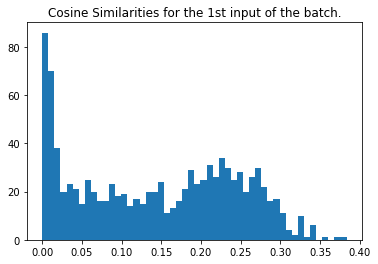

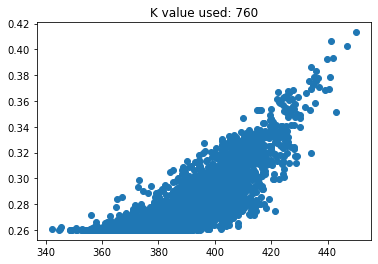

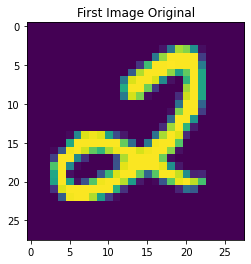

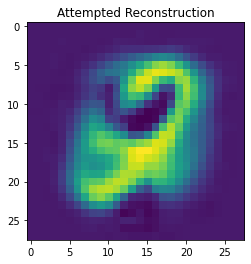

MSE loss for this input is:  0.001295205585810603
train loss: 0.0004248162149451673 test loss: 0.00036050021299161017
[epoch, batch], [8,   250] loss: 0.000
mean actives 720.0 0.72 % | max 720 0.72 %
(128, 1000) shape of cosine sims


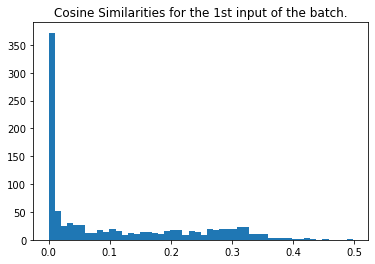

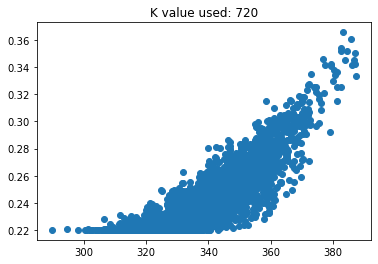

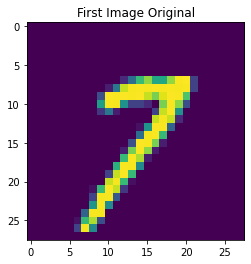

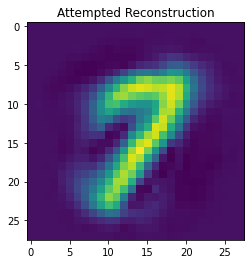

MSE loss for this input is:  0.0014727264642715454
train loss: 0.0003768110182136297 test loss: 0.00033916288521140814
[epoch, batch], [9,   250] loss: 0.000
mean actives 680.0 0.68 % | max 680 0.68 %
(128, 1000) shape of cosine sims


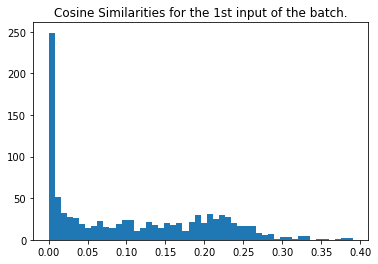

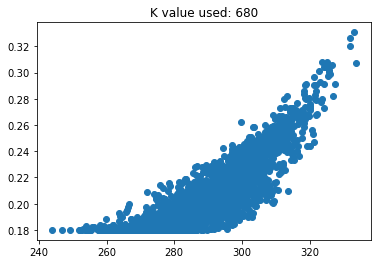

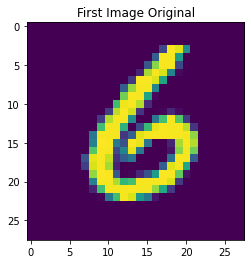

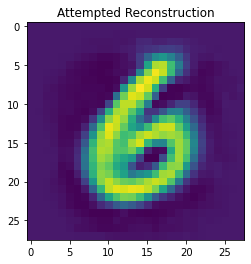

MSE loss for this input is:  0.0011566851516159214
train loss: 0.00029953024932183325 test loss: 0.0002649007656145841
[epoch, batch], [10,   250] loss: 0.000
mean actives 640.0 0.64 % | max 640 0.64 %
(128, 1000) shape of cosine sims


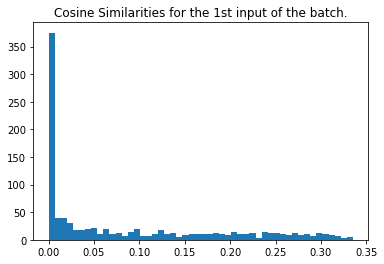

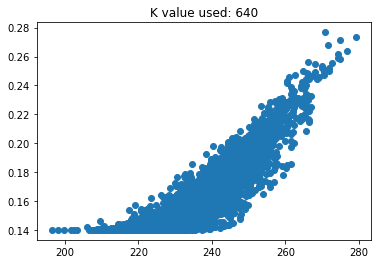

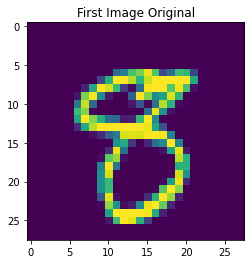

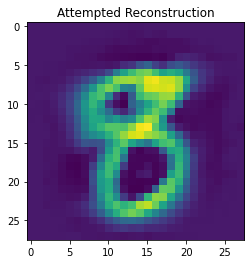

MSE loss for this input is:  0.001469100768468818
train loss: 0.00026596165844239295 test loss: 0.00021399637626018375
[epoch, batch], [11,   250] loss: 0.000
mean actives 600.0 0.6 % | max 600 0.6 %
(128, 1000) shape of cosine sims


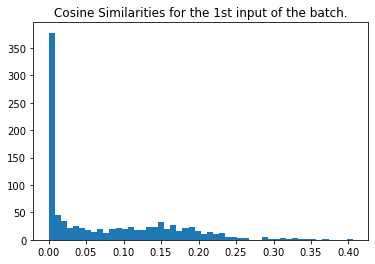

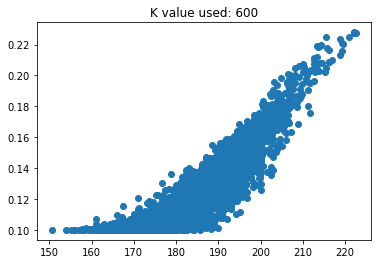

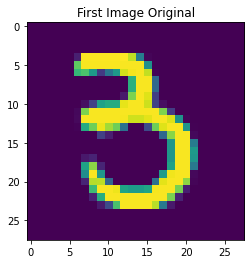

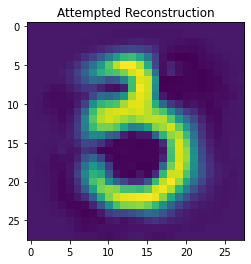

MSE loss for this input is:  0.0015802403189698045
train loss: 0.0001997202489292249 test loss: 0.000161783755174838
[epoch, batch], [12,   250] loss: 0.000
mean actives 560.0 0.56 % | max 560 0.56 %
(128, 1000) shape of cosine sims


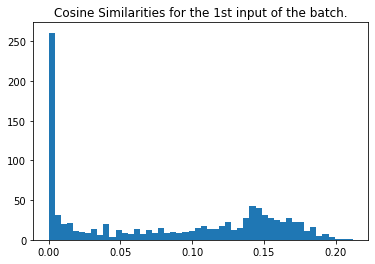

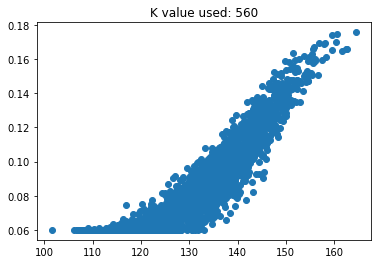

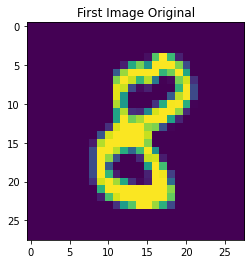

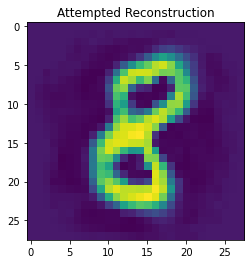

MSE loss for this input is:  0.0008155523362208386
train loss: 0.0001402329799020663 test loss: 0.00012004011659882963
[epoch, batch], [13,   250] loss: 0.000
mean actives 520.0 0.52 % | max 520 0.52 %
(128, 1000) shape of cosine sims


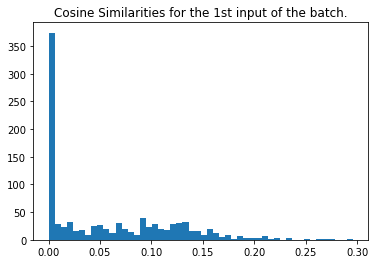

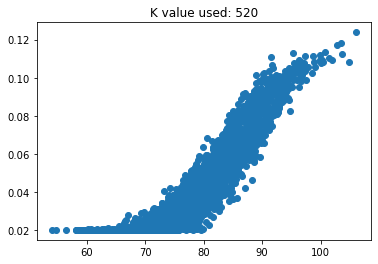

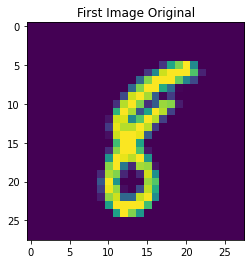

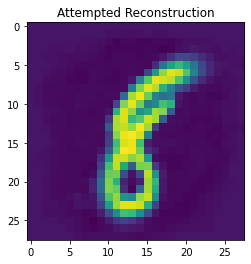

MSE loss for this input is:  0.001883152644244992
train loss: 7.695004023844376e-05 test loss: 7.066718535497785e-05
[epoch, batch], [14,   250] loss: 0.000
mean actives 480.0 0.48 % | max 480 0.48 %
(128, 1000) shape of cosine sims


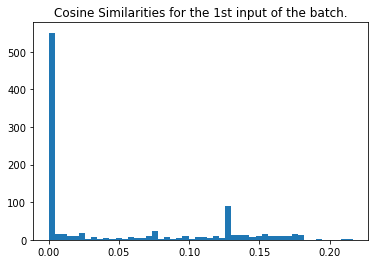

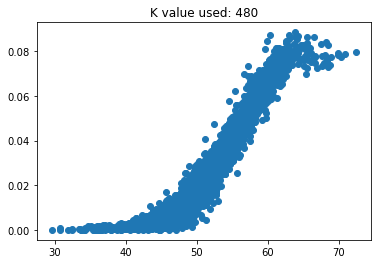

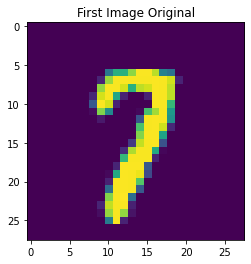

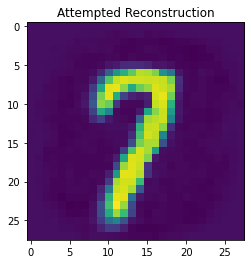

MSE loss for this input is:  0.0009910791960297798
train loss: 5.110081474413164e-05 test loss: 5.111835343996063e-05
[epoch, batch], [15,   250] loss: 0.000
mean actives 440.0 0.44 % | max 440 0.44 %
(128, 1000) shape of cosine sims


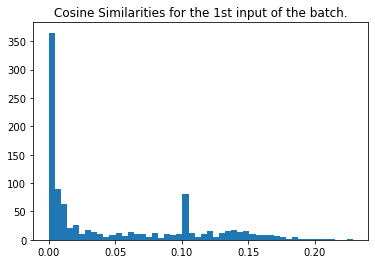

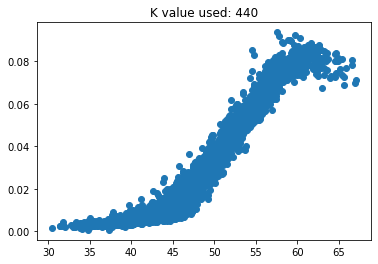

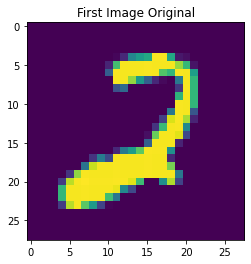

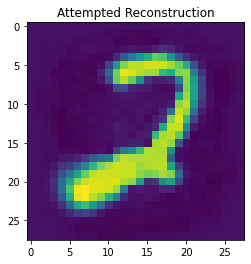

MSE loss for this input is:  0.0012813966189111983
train loss: 5.5305346904788166e-05 test loss: 5.5780401453375816e-05
[epoch, batch], [16,   250] loss: 0.000
mean actives 400.0 0.4 % | max 400 0.4 %
(128, 1000) shape of cosine sims


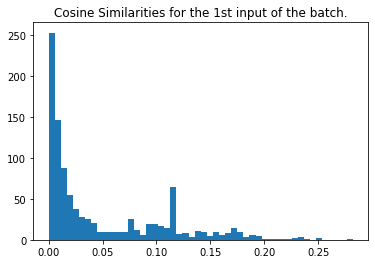

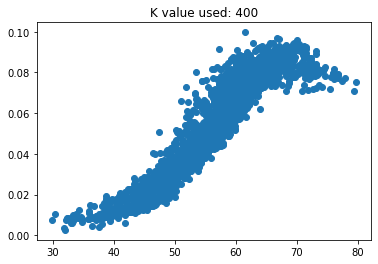

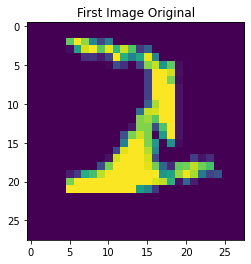

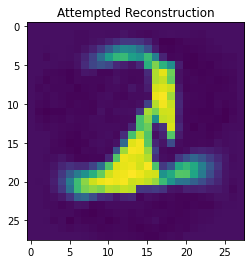

MSE loss for this input is:  0.0011365155176240572
train loss: 6.027148265275173e-05 test loss: 5.7655117416288704e-05
[epoch, batch], [17,   250] loss: 0.000
mean actives 360.0 0.36 % | max 360 0.36 %
(128, 1000) shape of cosine sims


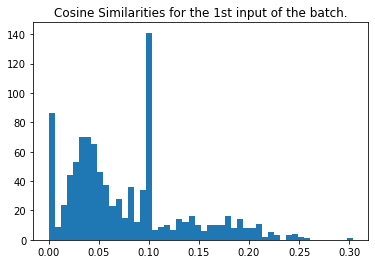

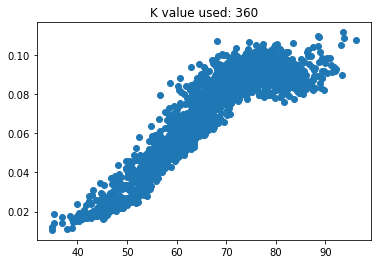

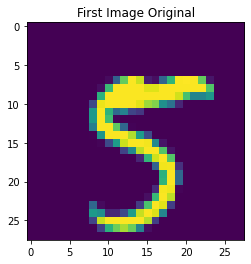

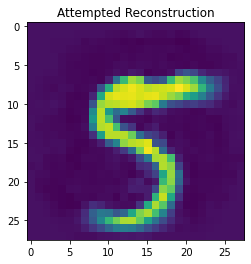

MSE loss for this input is:  0.0015000891016454113
train loss: 7.170912431320176e-05 test loss: 7.14515772415325e-05
[epoch, batch], [18,   250] loss: 0.000
mean actives 320.0 0.32 % | max 320 0.32 %
(128, 1000) shape of cosine sims


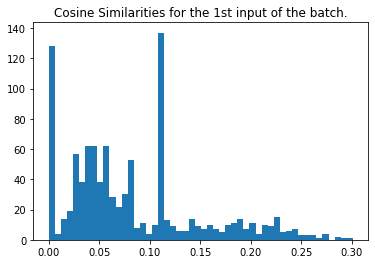

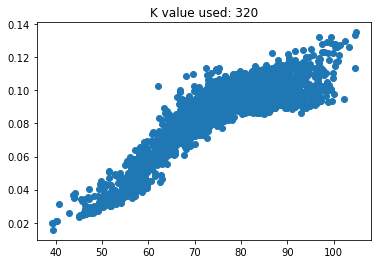

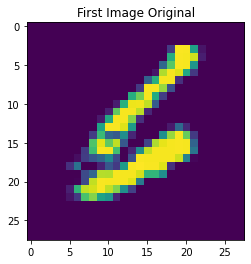

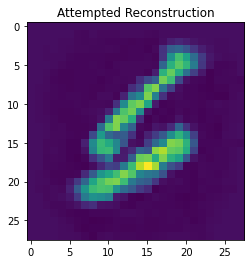

MSE loss for this input is:  0.0009883175394972976
train loss: 7.072187872836366e-05 test loss: 7.541979721281677e-05
[epoch, batch], [19,   250] loss: 0.000
mean actives 280.0 0.28 % | max 280 0.28 %
(128, 1000) shape of cosine sims


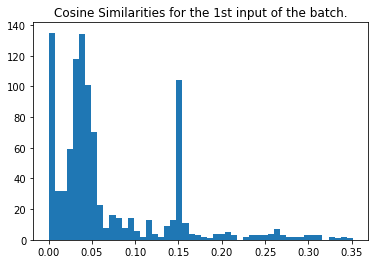

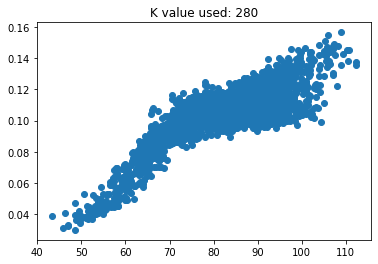

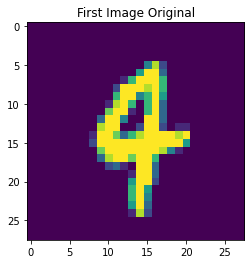

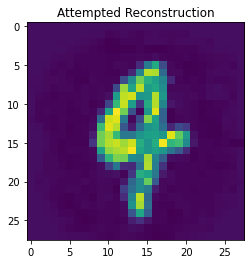

MSE loss for this input is:  0.0011009795933353658
train loss: 7.3016963142436e-05 test loss: 7.287537300726399e-05
[epoch, batch], [20,   250] loss: 0.000
mean actives 240.0 0.24 % | max 240 0.24 %
(128, 1000) shape of cosine sims


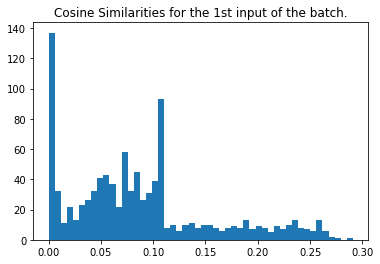

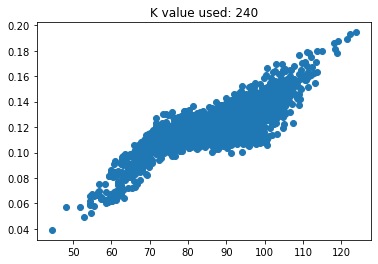

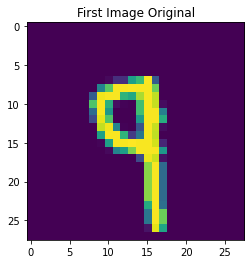

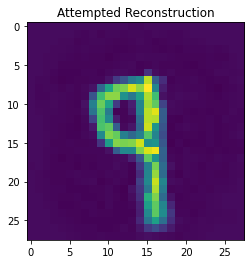

MSE loss for this input is:  0.0015059148474615446
train loss: 6.880566070321947e-05 test loss: 7.007231761235744e-05
[epoch, batch], [21,   250] loss: 0.000
mean actives 200.0 0.2 % | max 200 0.2 %
(128, 1000) shape of cosine sims


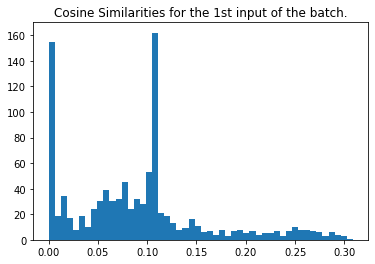

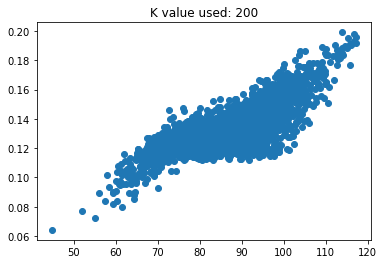

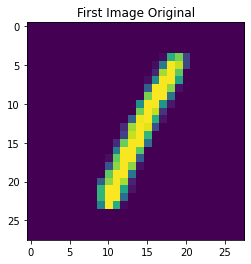

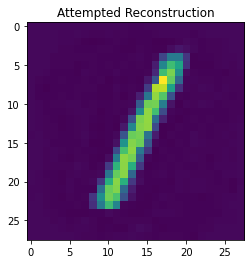

MSE loss for this input is:  0.0019356894249818763
train loss: 6.342790584312752e-05 test loss: 6.52681992505677e-05
[epoch, batch], [22,   250] loss: 0.000
mean actives 160.0 0.16 % | max 160 0.16 %
(128, 1000) shape of cosine sims


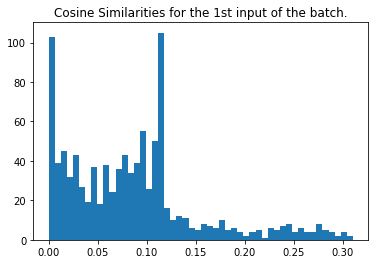

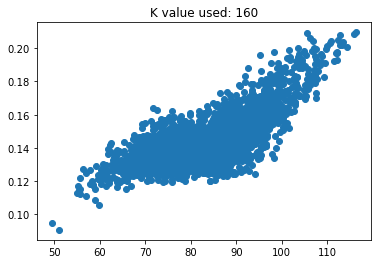

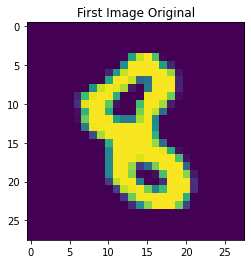

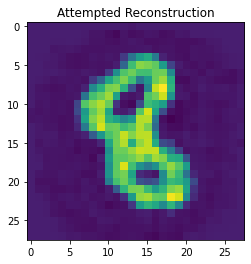

MSE loss for this input is:  0.0014389826326954122
train loss: 6.33194504189305e-05 test loss: 6.65708867018111e-05
[epoch, batch], [23,   250] loss: 0.000
mean actives 120.0 0.12 % | max 120 0.12 %
(128, 1000) shape of cosine sims


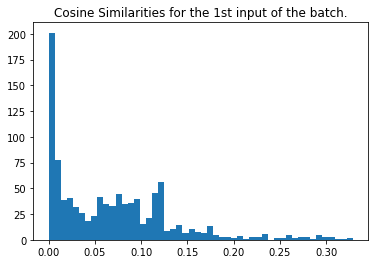

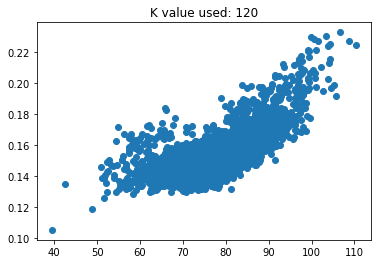

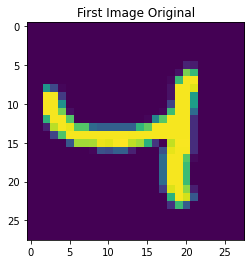

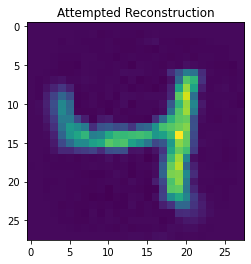

MSE loss for this input is:  0.002021746215771656
train loss: 6.896214472362772e-05 test loss: 7.0204034273047e-05
[epoch, batch], [24,   250] loss: 0.000
mean actives 80.0 0.08 % | max 80 0.08 %
(128, 1000) shape of cosine sims


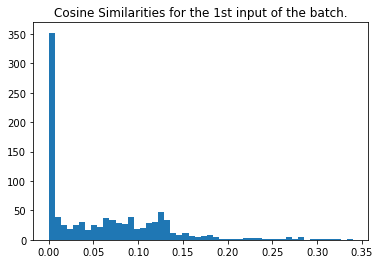

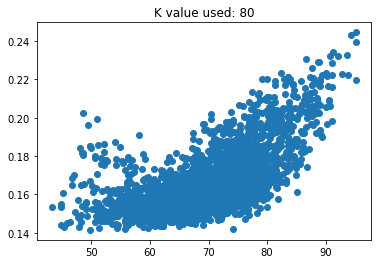

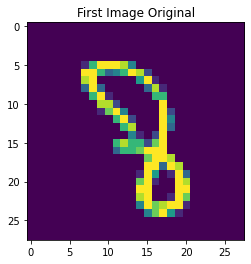

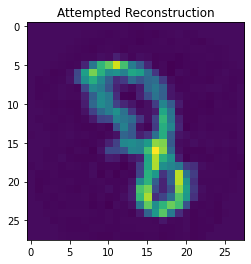

MSE loss for this input is:  0.0016287508971837101
train loss: 9.097502334043384e-05 test loss: 9.104680793825537e-05
[epoch, batch], [25,   250] loss: 0.000
mean actives 40.0 0.04 % | max 40 0.04 %
(128, 1000) shape of cosine sims


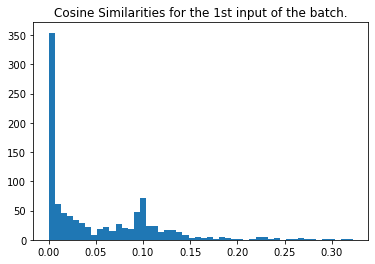

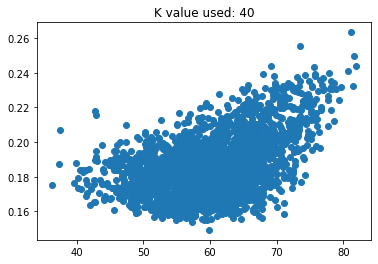

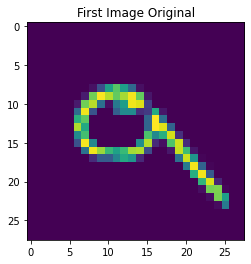

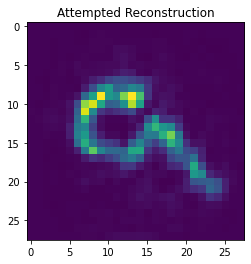

MSE loss for this input is:  0.001919796880410642
train loss: 0.00013342275633476675 test loss: 0.00013251513883005828
[epoch, batch], [26,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


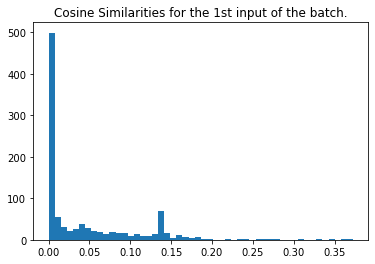

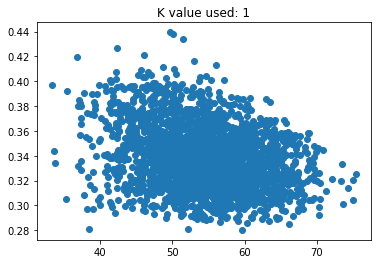

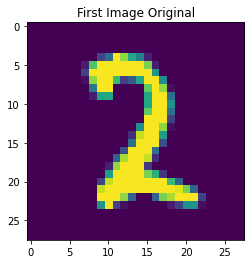

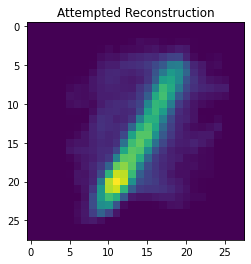

MSE loss for this input is:  0.00034728710900764075
train loss: 0.0007590199820697308 test loss: 0.000786751217674464
[epoch, batch], [27,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


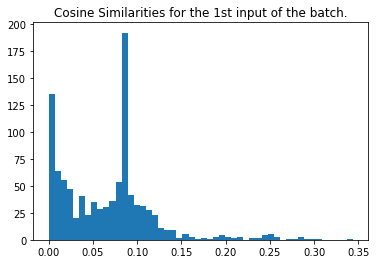

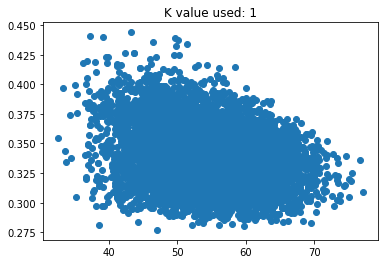

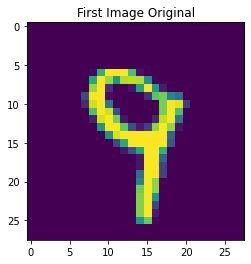

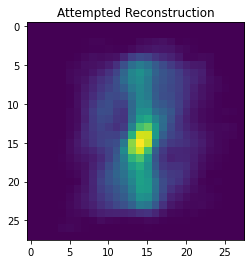

MSE loss for this input is:  0.0008553926433835711
train loss: 0.0007601488032378256 test loss: 0.0007582389516755939
[epoch, batch], [28,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


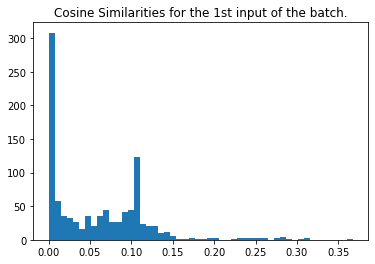

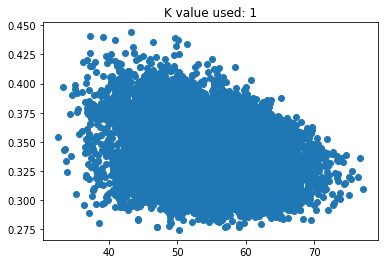

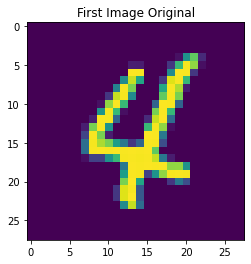

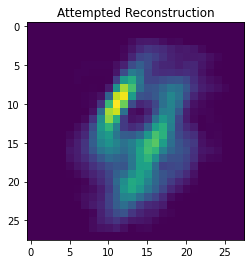

MSE loss for this input is:  0.0009273359057854633
train loss: 0.0007769015501253307 test loss: 0.0007494245655834675
[epoch, batch], [29,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


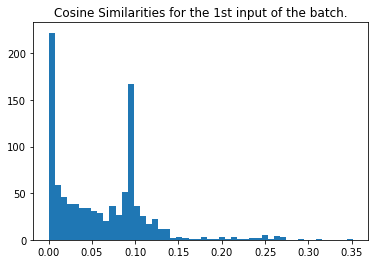

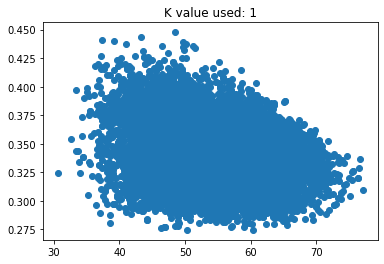

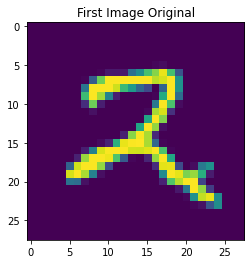

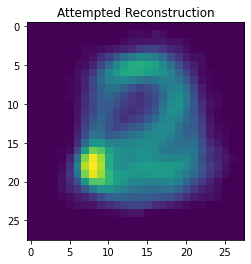

MSE loss for this input is:  0.001103940971043645
train loss: 0.0007960892980918288 test loss: 0.0007302030571736395
[epoch, batch], [30,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


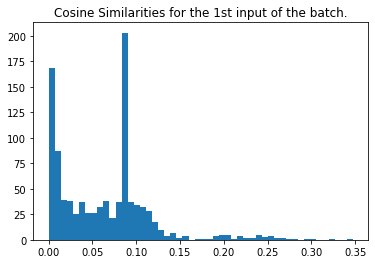

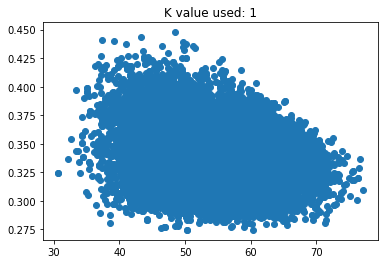

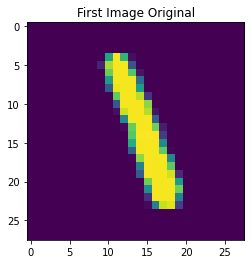

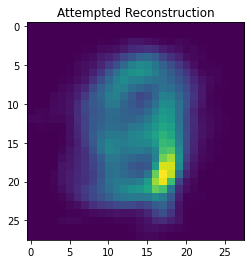

MSE loss for this input is:  0.000677843939284889
train loss: 0.0007356281275860965 test loss: 0.0007763134781271219
[epoch, batch], [31,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


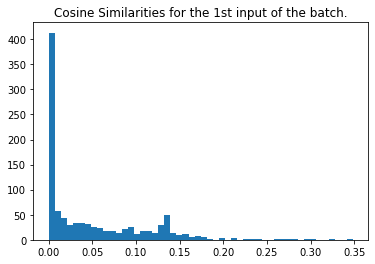

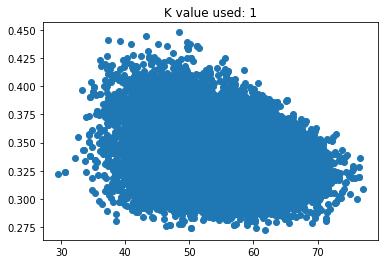

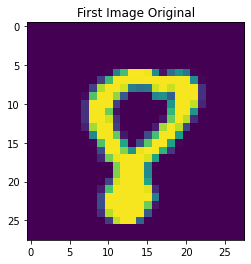

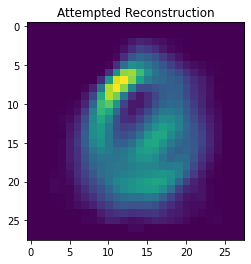

MSE loss for this input is:  0.001145074562150605
train loss: 0.0007596880313940346 test loss: 0.0007524656248278916
[epoch, batch], [32,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


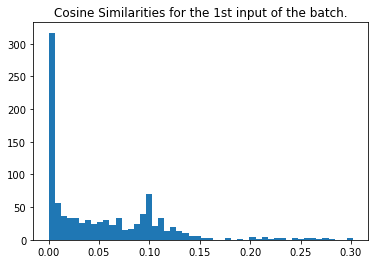

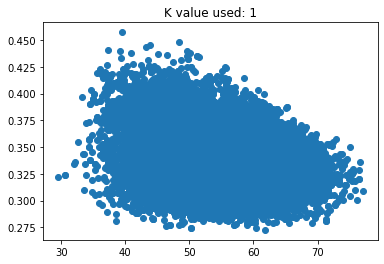

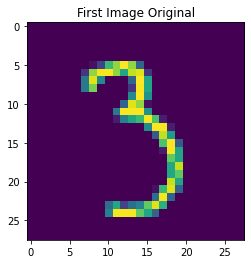

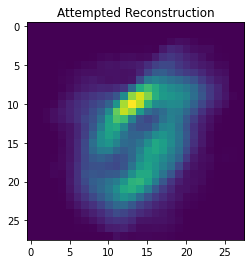

MSE loss for this input is:  0.0011224535350896874
train loss: 0.000747770769521594 test loss: 0.0007703783921897411
[epoch, batch], [33,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


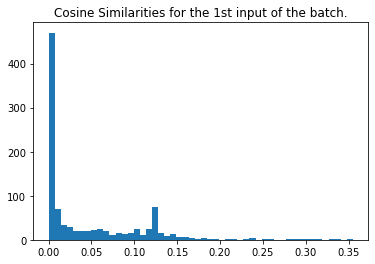

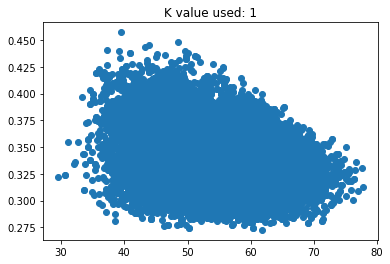

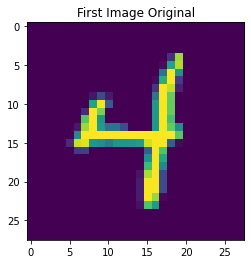

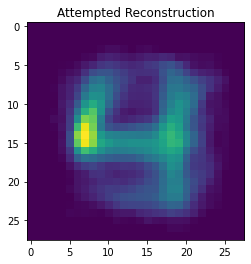

MSE loss for this input is:  0.0016081213038794848
train loss: 0.0007367266225628555 test loss: 0.0007486725226044655
[epoch, batch], [34,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


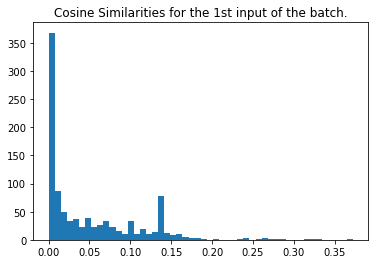

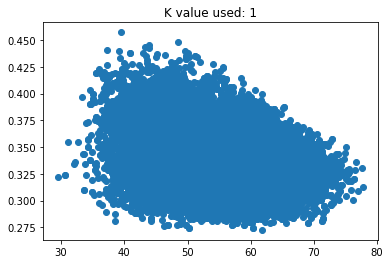

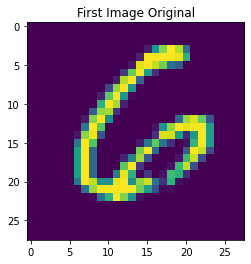

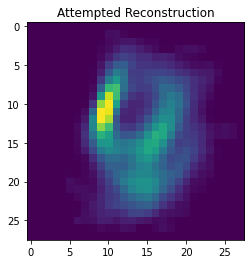

MSE loss for this input is:  0.0012899042696368937
train loss: 0.0007788789225742221 test loss: 0.0007490506395697594
[epoch, batch], [35,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


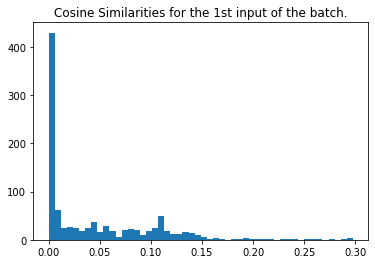

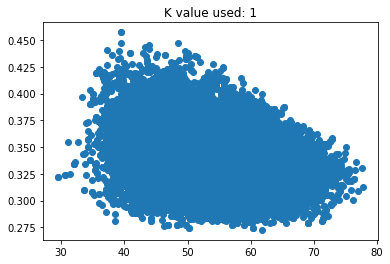

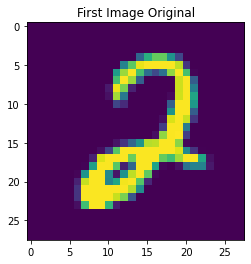

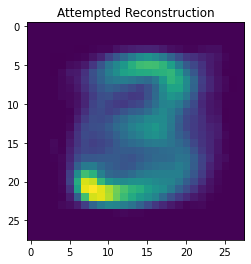

MSE loss for this input is:  0.0010328546014367317
train loss: 0.0007710718200542033 test loss: 0.0007466398528777063
[epoch, batch], [36,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


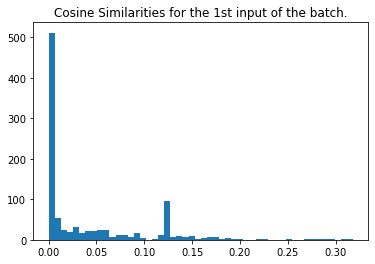

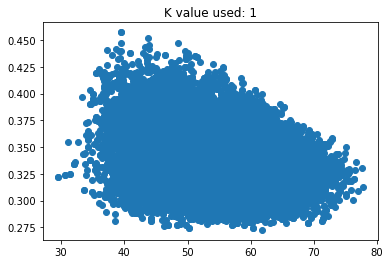

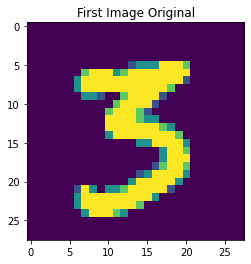

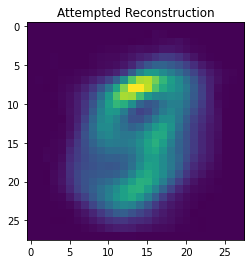

MSE loss for this input is:  0.0014829783111202474
train loss: 0.0007586139836348593 test loss: 0.0007649274775758386
[epoch, batch], [37,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


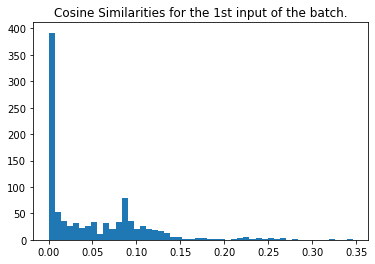

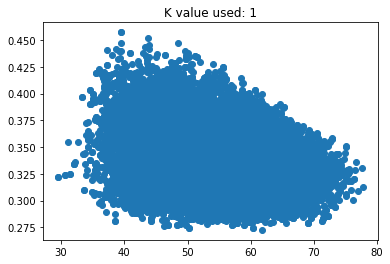

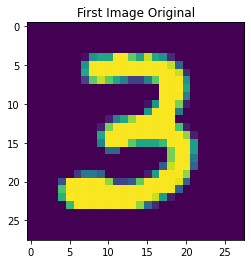

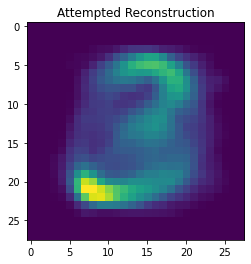

MSE loss for this input is:  0.001032692589321915
train loss: 0.0007616368820890784 test loss: 0.0007392219849862158
[epoch, batch], [38,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


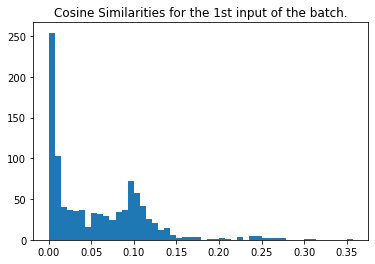

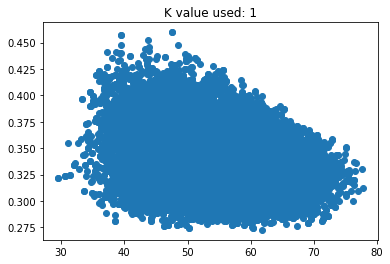

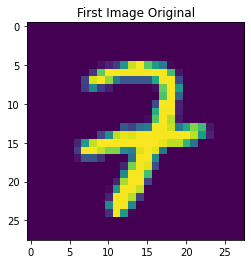

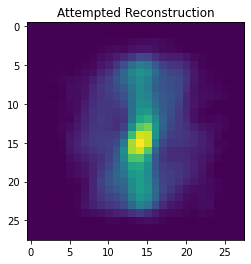

MSE loss for this input is:  0.001041777279912209
train loss: 0.0007575348718091846 test loss: 0.0007482689688913524
[epoch, batch], [39,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


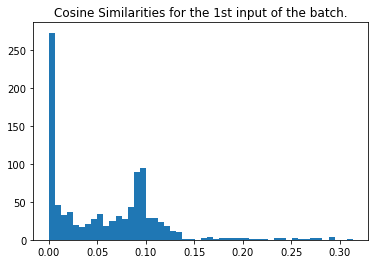

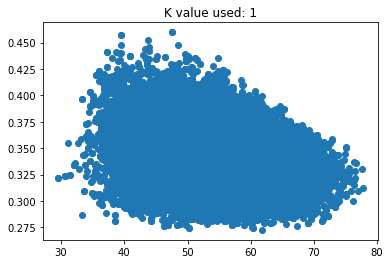

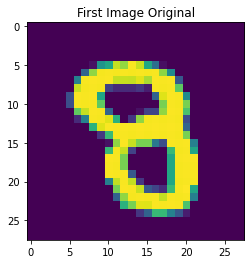

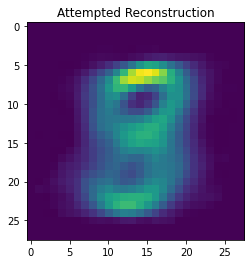

MSE loss for this input is:  0.0006791450539413764
train loss: 0.0007454529404640198 test loss: 0.0007781711174175143
[epoch, batch], [40,   250] loss: 0.000
mean actives 1.0 0.001 % | max 1 0.001 %
(128, 1000) shape of cosine sims


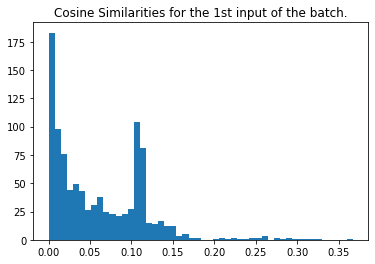

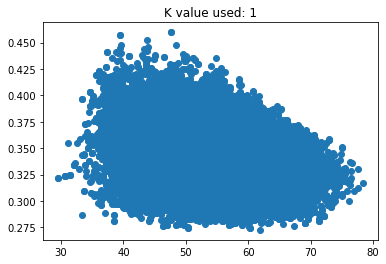

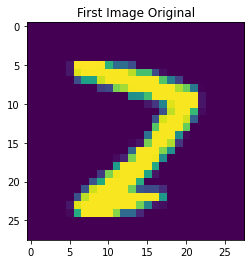

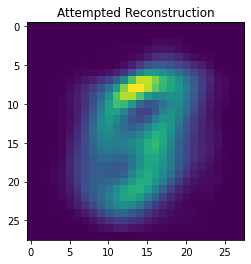

MSE loss for this input is:  0.0006916332153641448
train loss: 0.0007794777629896998 test loss: 0.0007288295309990644
Finished Training


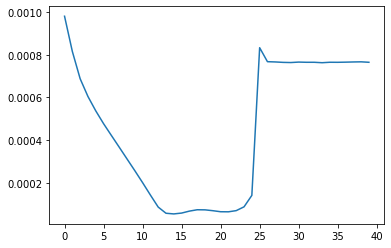

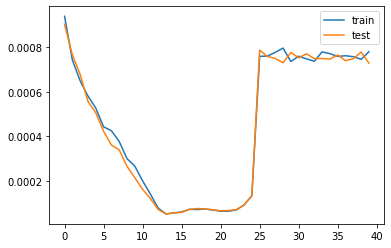

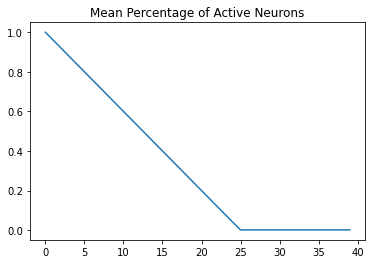

Latents and Labels dimensions: (60000, 1000) (60000,)
Latents and Labels dimensions: (10000, 1000) (10000,)
Logistic regression accuracy: Train= 0.309 | Test= 0.304


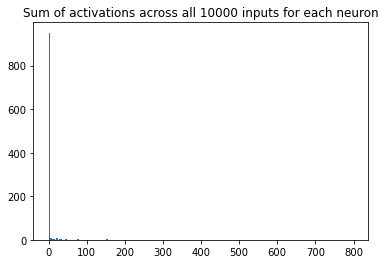

[951.   7.   5.   5.   1.   7.   0.   2.   3.   1.   0.   2.   1.   1.
   0.   1.   1.   0.   0.   2.   1.   0.   1.   0.   0.   0.   0.   0.
   0.   0.   1.   0.   0.   0.   0.   0.   0.   0.   2.   0.   1.   0.
   0.   0.   1.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   1.   0.   0.   1.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0. 

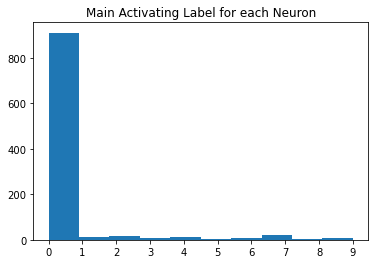

Neuron addresses should be 1000x784!!! (1000, 784) (1000, 784)
Euclidian distance


,0,1,2,3,4,5,6,7,8,9
0,0.000000,0.130758,0.106513,0.173601,0.101346,0.340993,0.133446,0.078582,0.278049,0.217307
1,0.130758,0.000000,0.177100,0.245385,0.190533,0.417902,0.224563,0.160845,0.364999,0.314760
2,0.106513,0.177100,0.000000,0.211715,0.156457,0.382648,0.186544,0.151079,0.324027,0.285236
3,0.173601,0.245385,0.211715,0.000000,0.212192,0.440000,0.275159,0.211063,0.379381,0.367283
4,0.101346,0.190533,0.156457,0.212192,0.000000,0.381621,0.194774,0.124033,0.333638,0.271267
5,0.340993,0.417902,0.382648,0.440000,0.381621,0.000000,0.425160,0.372753,0.554602,0.522099
6,0.133446,0.224563,0.186544,0.275159,0.194774,0.425160,0.000000,0.177111,0.370212,0.294115
7,0.078582,0.160845,0.151079,0.211063,0.124033,0.372753,0.177111,0.000000,0.322226,0.244869
8,0.278049,0.364999,0.324027,0.379381,0.333638,0.554602,0.370212,0.322226,0.000000,0.449769
9,0.217307,0.314760,0.285236,0.367283,0.271267,0.522099,0.294115,0.244869,0.449769,0.000000


cosine similarity


,0,1,2,3,4,5,6,7,8,9
0,1.000000,0.639521,0.550062,0.496840,0.618588,0.360985,0.491282,0.679967,0.397669,0.542124
1,0.639521,1.000000,0.436289,0.362934,0.393000,0.258594,0.336353,0.454978,0.262380,0.287892
2,0.550062,0.436289,1.000000,0.398811,0.431795,0.287292,0.382018,0.404067,0.304941,0.304473
3,0.496840,0.362934,0.398811,1.000000,0.397410,0.258693,0.264332,0.365682,0.279369,0.225077
4,0.618588,0.393000,0.431795,0.397410,1.000000,0.289554,0.354598,0.511473,0.281795,0.341146
5,0.360985,0.258594,0.287292,0.258693,0.289554,1.000000,0.229962,0.283787,0.195390,0.186079
6,0.491282,0.336353,0.382018,0.264332,0.354598,0.229962,1.000000,0.370033,0.234819,0.320211
7,0.679967,0.454978,0.404067,0.365682,0.511473,0.283787,0.370033,1.000000,0.278868,0.384146
8,0.397669,0.262380,0.304941,0.279369,0.281795,0.195390,0.234819,0.278868,1.000000,0.220643
9,0.542124,0.287892,0.304473,0.225077,0.341146,0.186079,0.320211,0.384146,0.220643,1.000000


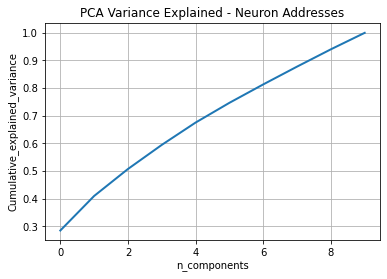

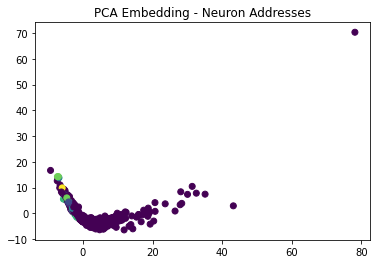

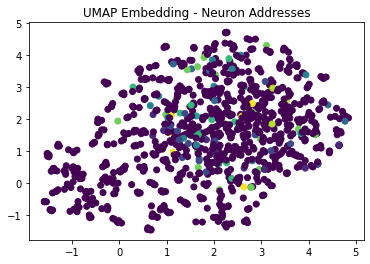

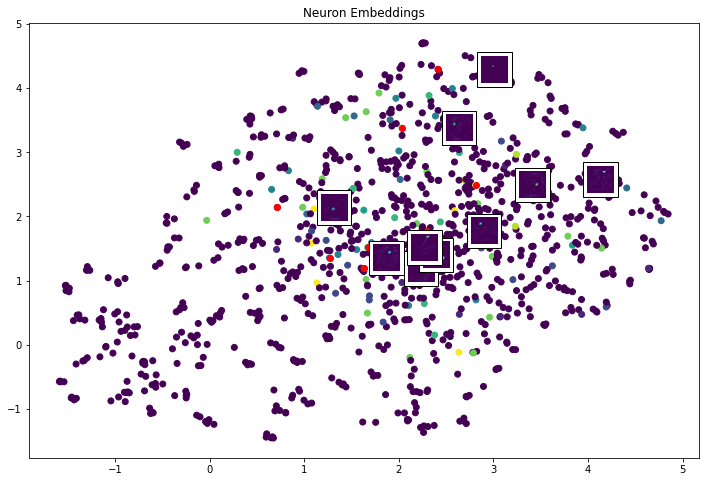

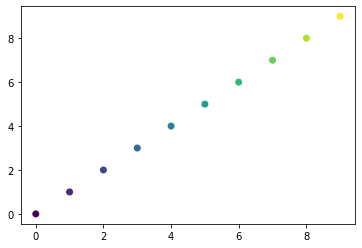

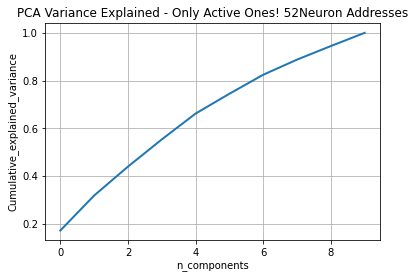

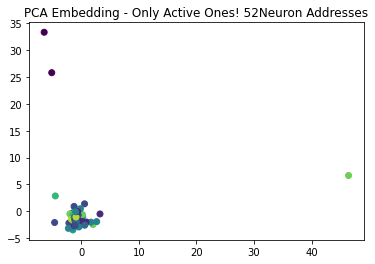

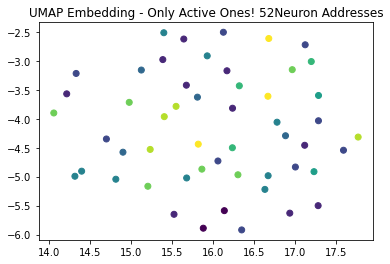

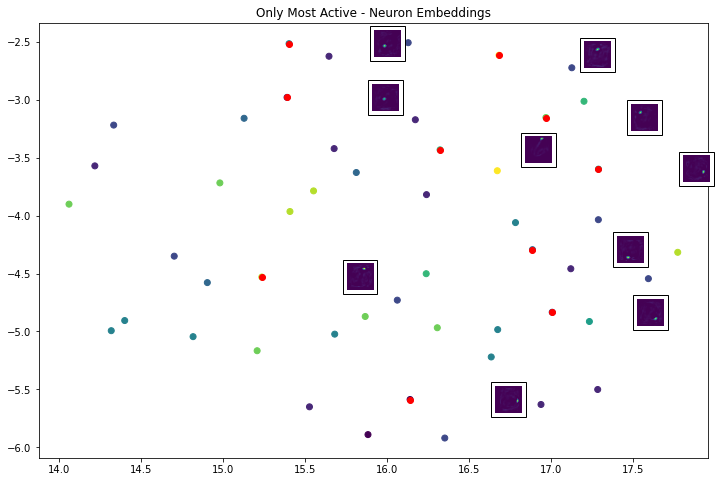

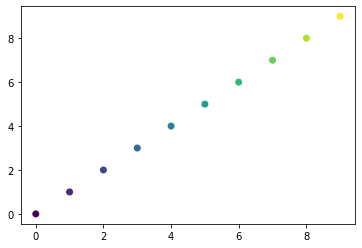

Giving some random plots from the most active neurons


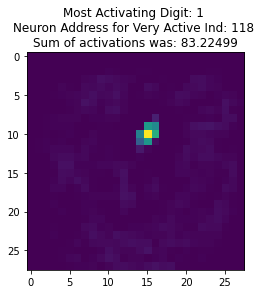

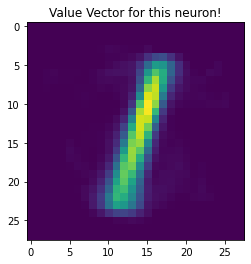

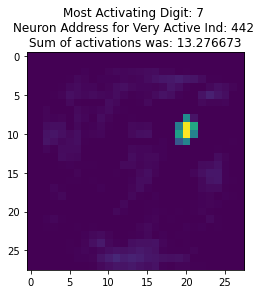

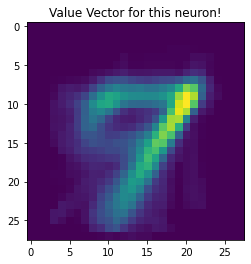

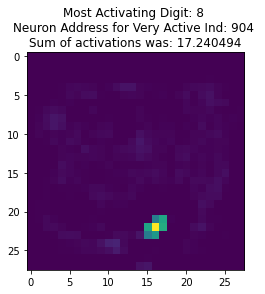

...

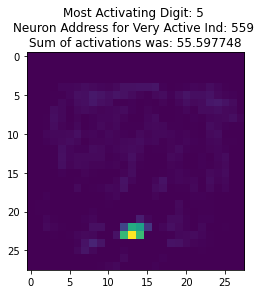

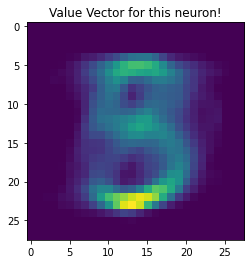

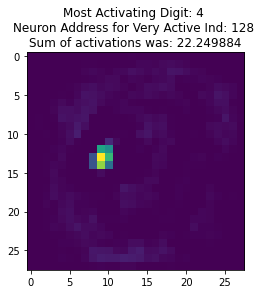

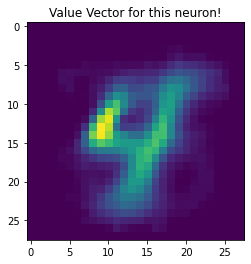

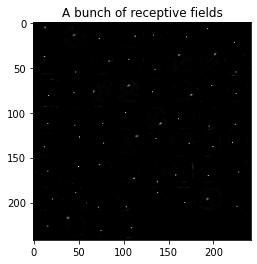

==================== K= 11 ===================
length of net parameters 2
[epoch, batch], [1,   250] loss: 0.000
mean actives 1000.0 1.0 % | max 1000 1.0 %
(128, 1000) shape of cosine sims


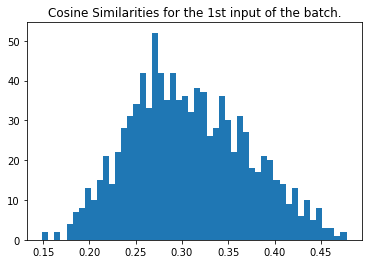

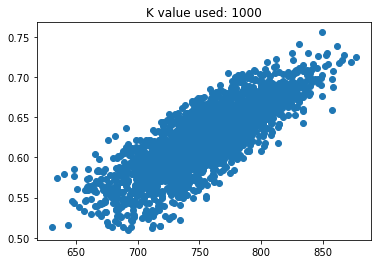

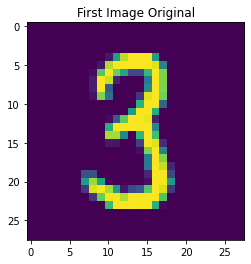

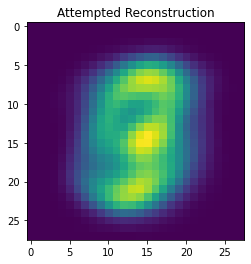

MSE loss for this input is:  0.0006716241489867775
train loss: 0.0009199902415275574 test loss: 0.0008987386245280504
[epoch, batch], [2,   250] loss: 0.000
mean actives 960.0 0.96 % | max 960 0.96 %
(128, 1000) shape of cosine sims


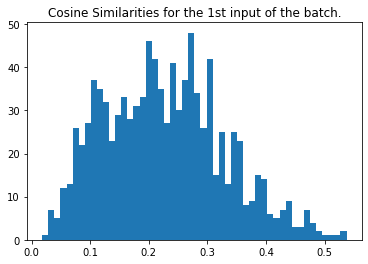

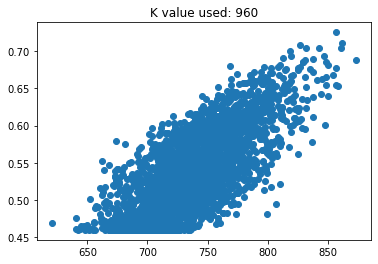

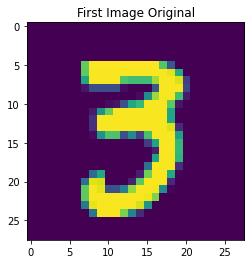

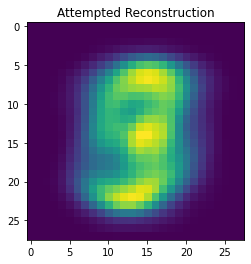

MSE loss for this input is:  0.0011523410829962517
train loss: 0.0007535876939073205 test loss: 0.0007452296558767557
[epoch, batch], [3,   250] loss: 0.000
mean actives 920.0 0.92 % | max 920 0.92 %
(128, 1000) shape of cosine sims


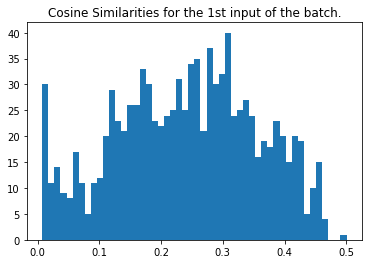

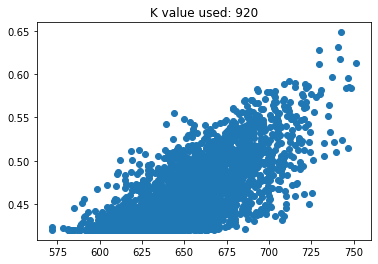

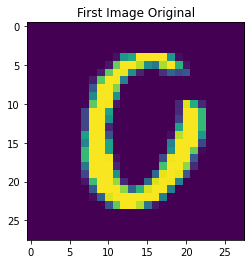

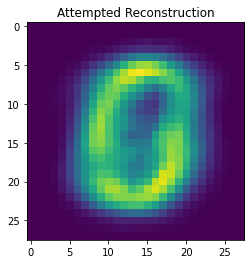

MSE loss for this input is:  0.000877094207977762
train loss: 0.0006748159066773951 test loss: 0.0006351922056637704
[epoch, batch], [4,   250] loss: 0.000
mean actives 881.0 0.881 % | max 881 0.881 %
(128, 1000) shape of cosine sims


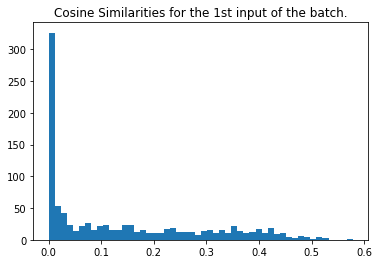

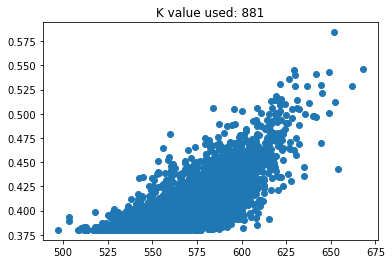

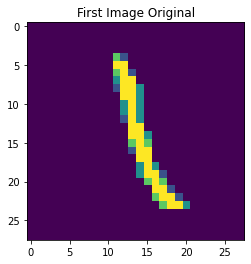

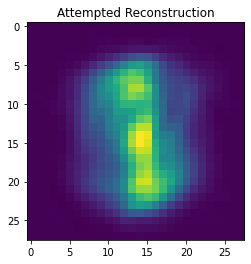

MSE loss for this input is:  0.0009425290841229108
train loss: 0.0005915729561820626 test loss: 0.0005495839286595583
[epoch, batch], [5,   250] loss: 0.000
mean actives 841.0 0.841 % | max 841 0.841 %
(128, 1000) shape of cosine sims


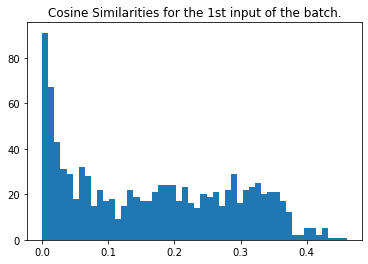

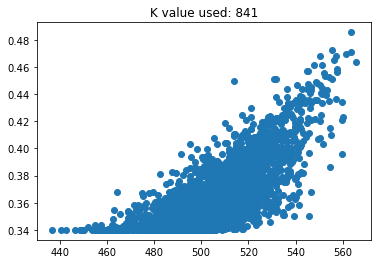

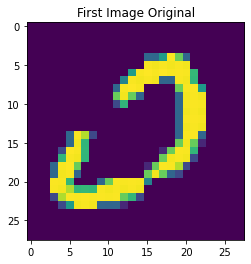

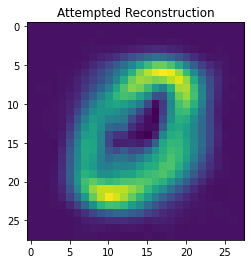

MSE loss for this input is:  0.0010579046698249116
train loss: 0.0005344291566871107 test loss: 0.0004858521278947592
[epoch, batch], [6,   250] loss: 0.000
mean actives 802.0 0.802 % | max 802 0.802 %
(128, 1000) shape of cosine sims


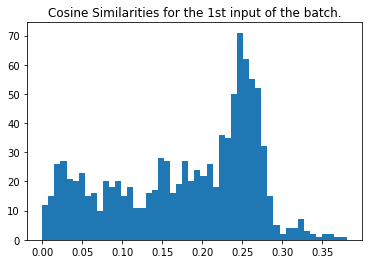

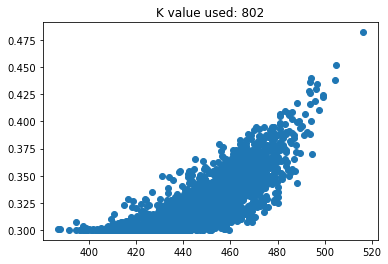

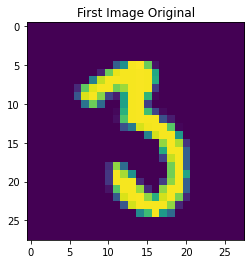

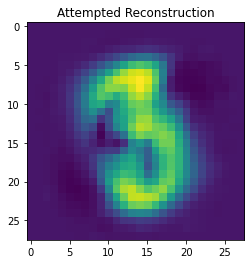

MSE loss for this input is:  0.0006607442486042879
train loss: 0.00046494114212691784 test loss: 0.00044444442028179765
[epoch, batch], [7,   250] loss: 0.000
mean actives 762.0 0.762 % | max 762 0.762 %
(128, 1000) shape of cosine sims


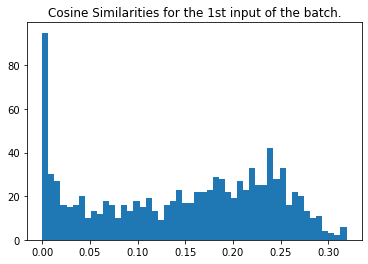

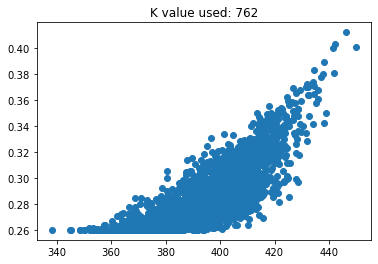

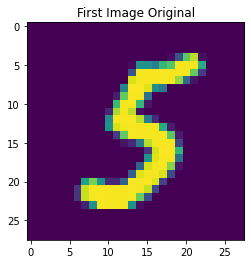

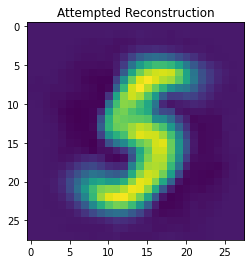

MSE loss for this input is:  0.0008636674254524464
train loss: 0.00042949055205099285 test loss: 0.0003610895073506981
[epoch, batch], [8,   250] loss: 0.000
mean actives 723.0 0.723 % | max 723 0.723 %
(128, 1000) shape of cosine sims


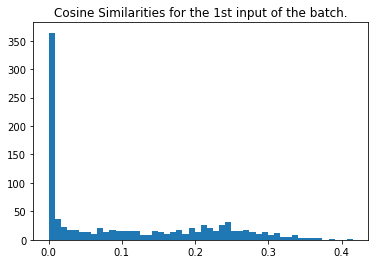

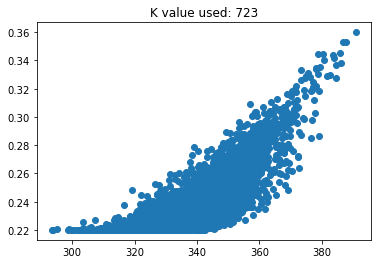

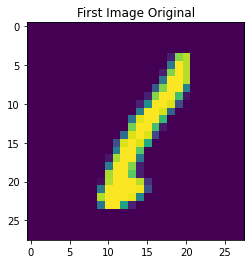

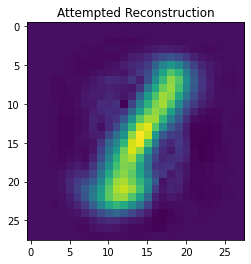

MSE loss for this input is:  0.0018792572070141227
train loss: 0.0003695598861668259 test loss: 0.00031268910970538855
[epoch, batch], [9,   250] loss: 0.000
mean actives 683.0 0.683 % | max 683 0.683 %
(128, 1000) shape of cosine sims


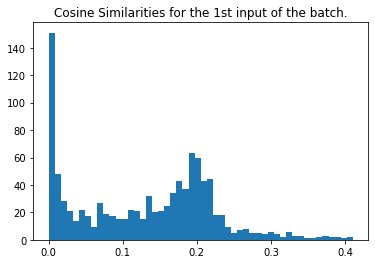

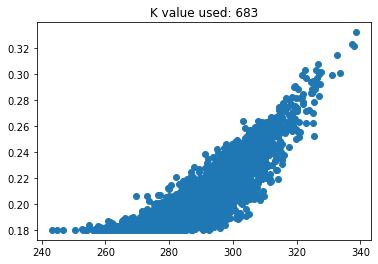

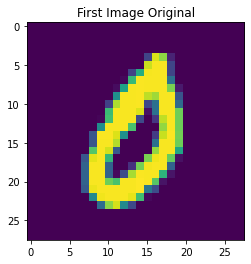

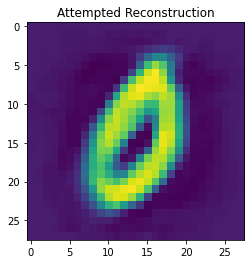

MSE loss for this input is:  0.0007477493158408574
train loss: 0.00032262009335681796 test loss: 0.0002680736070033163
[epoch, batch], [10,   250] loss: 0.000
mean actives 643.0 0.643 % | max 643 0.643 %
(128, 1000) shape of cosine sims


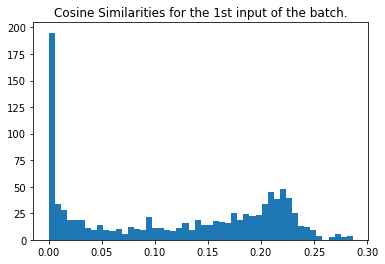

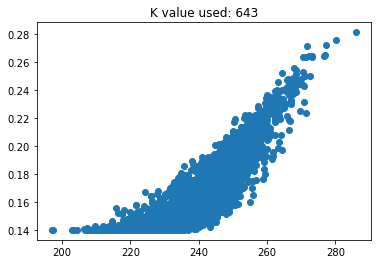

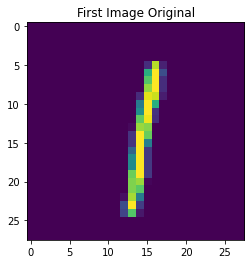

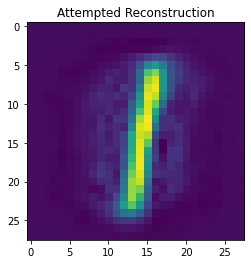

MSE loss for this input is:  0.0008862822183540889
train loss: 0.0002455000358168036 test loss: 0.00022348780476022512
[epoch, batch], [11,   250] loss: 0.000
mean actives 604.0 0.604 % | max 604 0.604 %
(128, 1000) shape of cosine sims


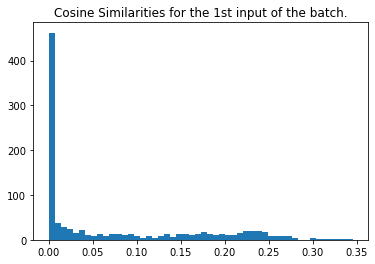

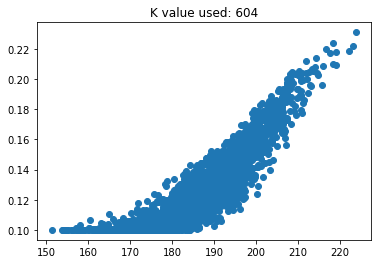

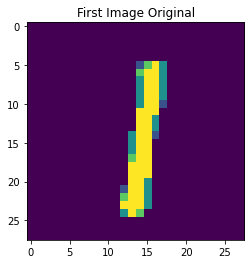

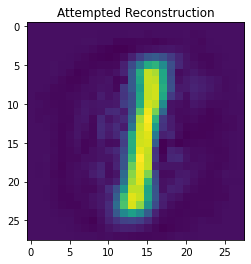

MSE loss for this input is:  0.0012597516939348104
train loss: 0.00020198500715196133 test loss: 0.00016971553850453347
[epoch, batch], [12,   250] loss: 0.000
mean actives 564.0 0.564 % | max 564 0.564 %
(128, 1000) shape of cosine sims


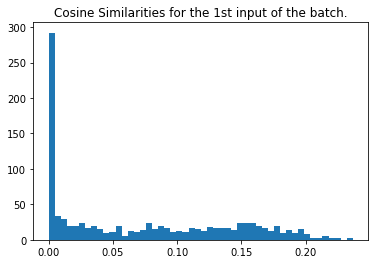

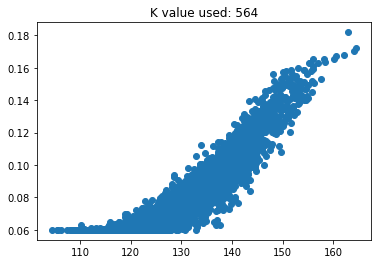

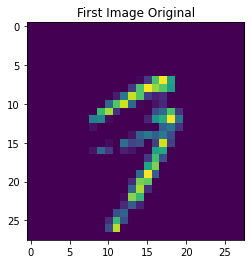

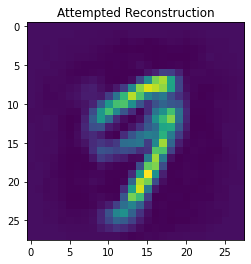

MSE loss for this input is:  0.0015668266890000325
train loss: 0.0001479252678109333 test loss: 0.00012158663594163954
[epoch, batch], [13,   250] loss: 0.000
mean actives 525.0 0.525 % | max 525 0.525 %
(128, 1000) shape of cosine sims


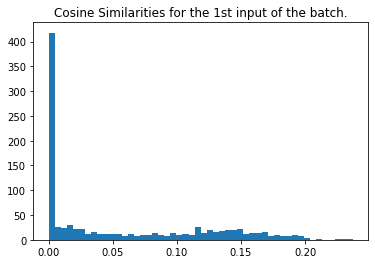

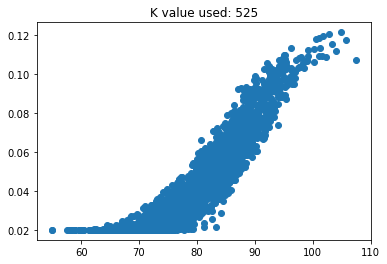

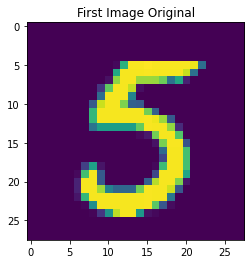

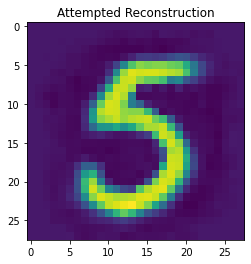

MSE loss for this input is:  0.001113869934057703
train loss: 7.647317397641018e-05 test loss: 7.049930718494579e-05
[epoch, batch], [14,   250] loss: 0.000
mean actives 485.0 0.485 % | max 485 0.485 %
(128, 1000) shape of cosine sims


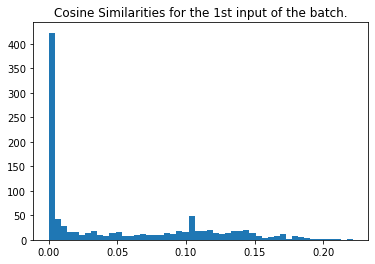

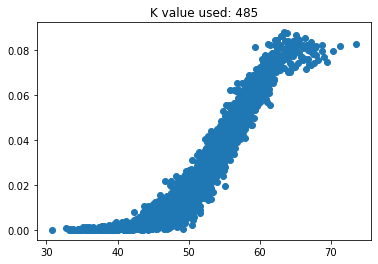

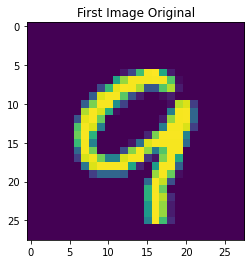

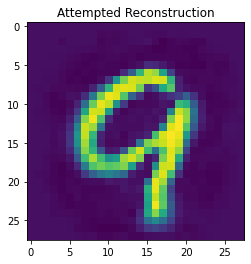

MSE loss for this input is:  0.001411725976029221
train loss: 5.836812488269061e-05 test loss: 4.669562986236997e-05
[epoch, batch], [15,   250] loss: 0.000
mean actives 446.0 0.446 % | max 446 0.446 %
(128, 1000) shape of cosine sims


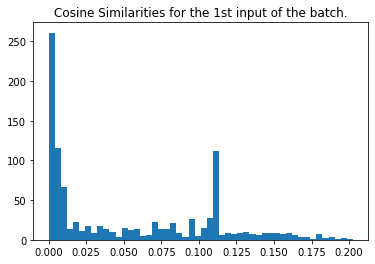

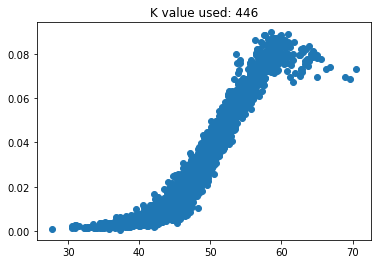

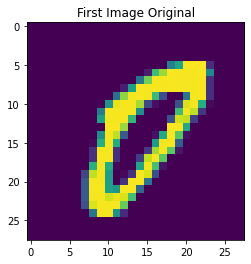

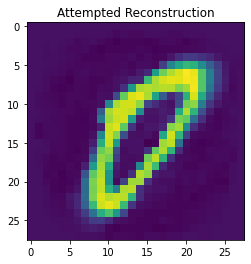

MSE loss for this input is:  0.001362247430548376
train loss: 4.6815523091936484e-05 test loss: 5.110536585561931e-05
[epoch, batch], [16,   250] loss: 0.000
mean actives 406.0 0.406 % | max 406 0.406 %
(128, 1000) shape of cosine sims


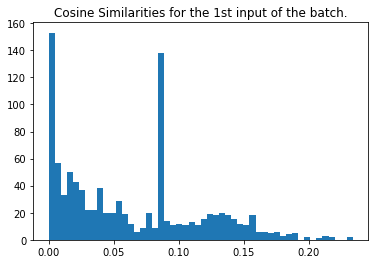

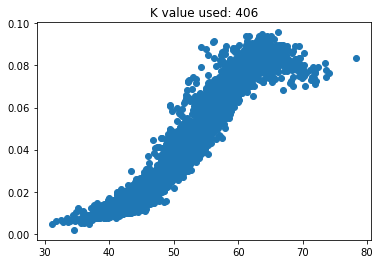

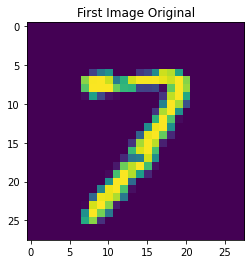

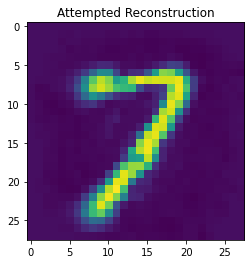

MSE loss for this input is:  0.0013808326757684046
train loss: 5.648568185279146e-05 test loss: 5.999946370138787e-05
[epoch, batch], [17,   250] loss: 0.000
mean actives 367.0 0.367 % | max 367 0.367 %
(128, 1000) shape of cosine sims


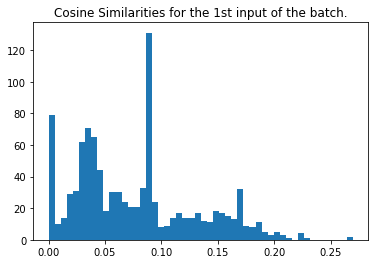

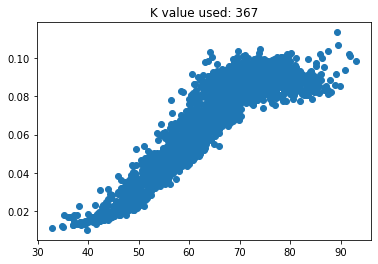

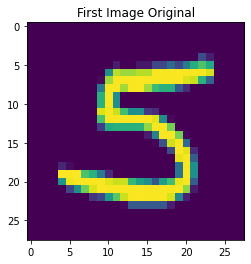

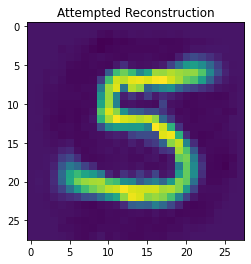

MSE loss for this input is:  0.0012926311821353678
train loss: 7.162561087170616e-05 test loss: 7.088239362929016e-05
[epoch, batch], [18,   250] loss: 0.000
mean actives 327.0 0.327 % | max 327 0.327 %
(128, 1000) shape of cosine sims


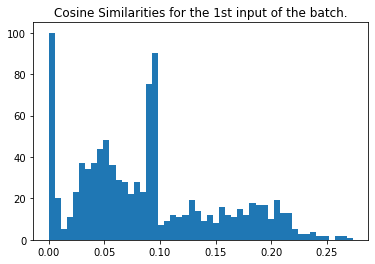

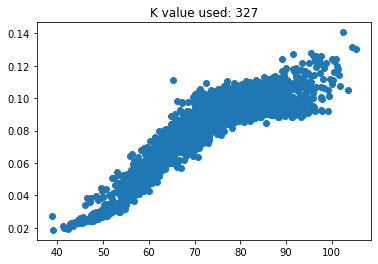

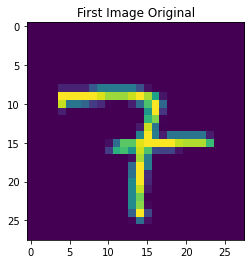

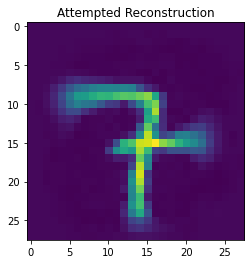

MSE loss for this input is:  0.0015132393763989819
train loss: 7.170910248532891e-05 test loss: 7.238030229927972e-05
[epoch, batch], [19,   250] loss: 0.000
mean actives 287.0 0.287 % | max 287 0.287 %
(128, 1000) shape of cosine sims


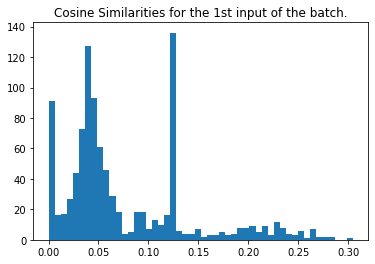

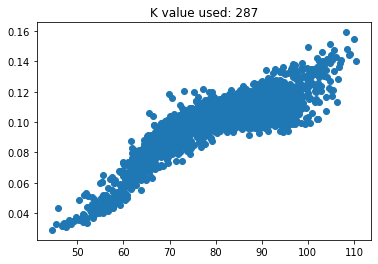

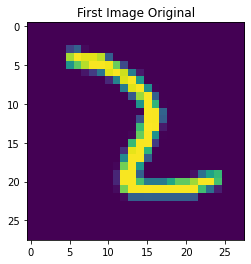

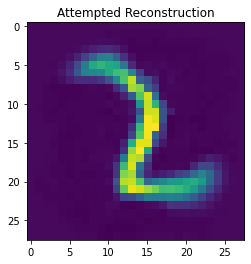

MSE loss for this input is:  0.000849112868309021
train loss: 7.276966789504513e-05 test loss: 7.132070459192619e-05
[epoch, batch], [20,   250] loss: 0.000
mean actives 248.0 0.248 % | max 248 0.248 %
(128, 1000) shape of cosine sims


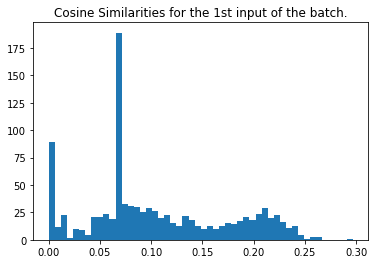

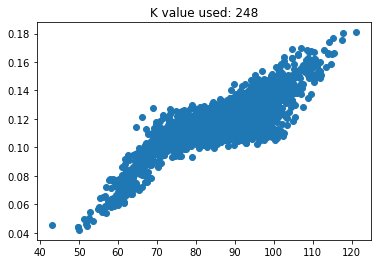

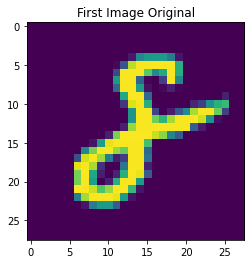

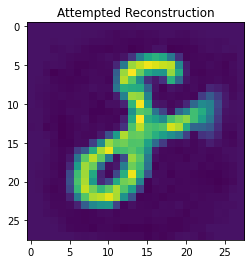

MSE loss for this input is:  0.0011685056497856062
train loss: 6.476380076492205e-05 test loss: 6.582790229003876e-05
[epoch, batch], [21,   250] loss: 0.000
mean actives 208.0 0.208 % | max 208 0.208 %
(128, 1000) shape of cosine sims


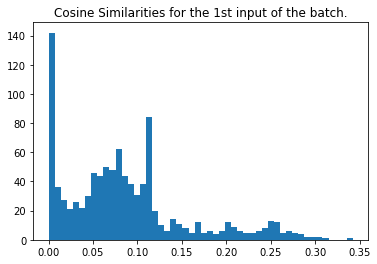

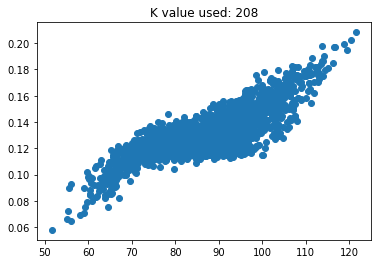

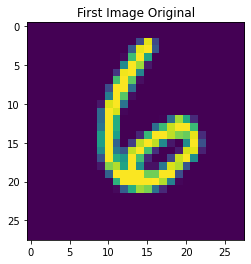

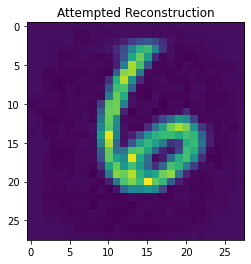

MSE loss for this input is:  0.0015703351521978574
train loss: 6.285098061198369e-05 test loss: 6.184189260238782e-05
[epoch, batch], [22,   250] loss: 0.000
mean actives 169.0 0.169 % | max 169 0.169 %
(128, 1000) shape of cosine sims


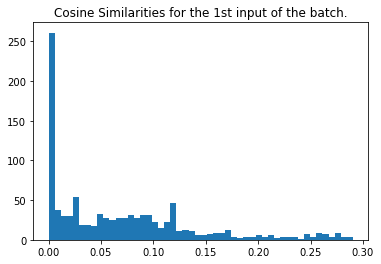

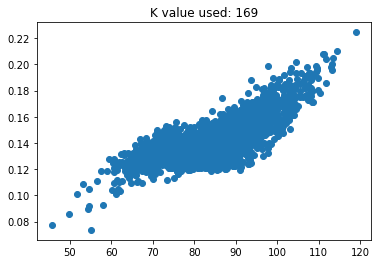

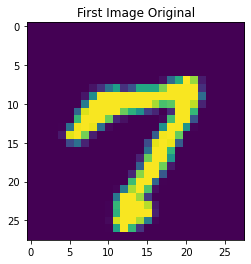

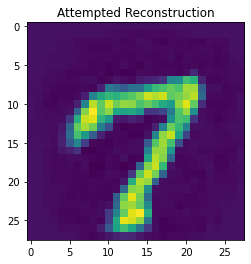

MSE loss for this input is:  0.0013489571152901162
train loss: 6.174828013172373e-05 test loss: 6.527821824420244e-05
[epoch, batch], [23,   250] loss: 0.000
mean actives 129.0 0.129 % | max 129 0.129 %
(128, 1000) shape of cosine sims


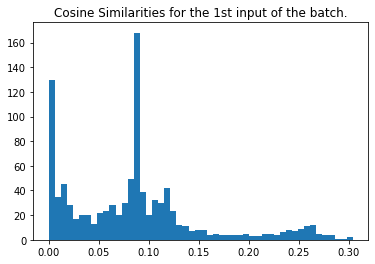

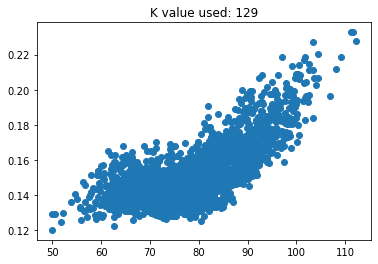

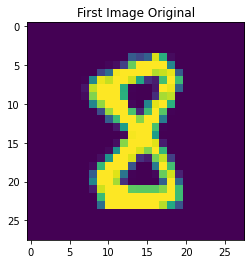

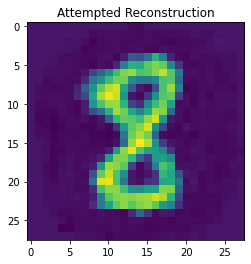

MSE loss for this input is:  0.0011796556717279007
train loss: 6.629110430367291e-05 test loss: 7.152784382924438e-05
[epoch, batch], [24,   250] loss: 0.000
mean actives 90.0 0.09 % | max 90 0.09 %
(128, 1000) shape of cosine sims


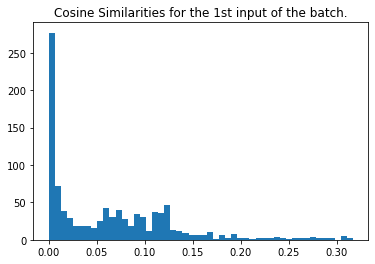

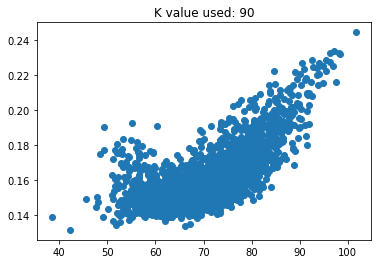

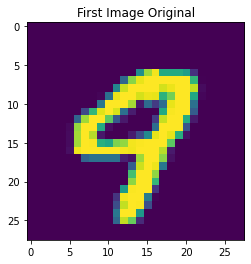

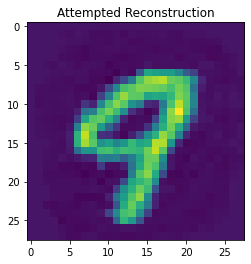

MSE loss for this input is:  0.001308015718752024
train loss: 7.948978600325063e-05 test loss: 8.14144077594392e-05
[epoch, batch], [25,   250] loss: 0.000
mean actives 50.0 0.05 % | max 50 0.05 %
(128, 1000) shape of cosine sims


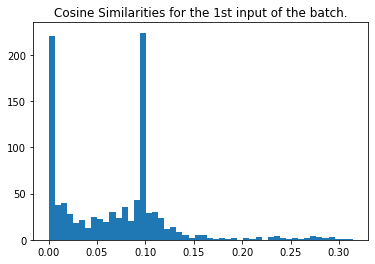

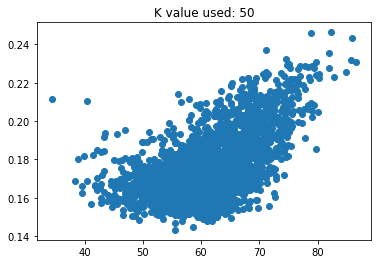

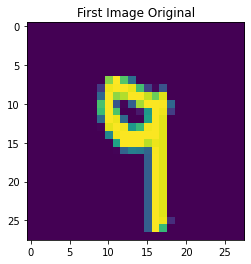

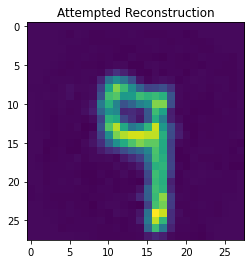

MSE loss for this input is:  0.0009641921793927952
train loss: 0.00011270781396888196 test loss: 0.00011518687824718654
[epoch, batch], [26,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


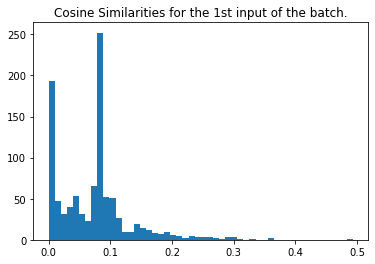

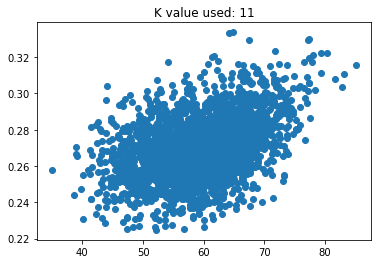

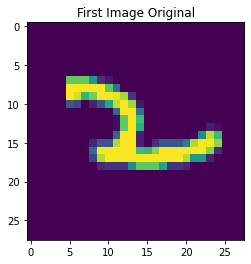

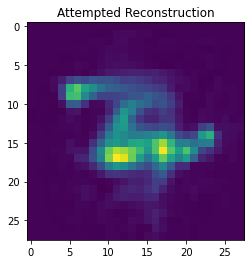

MSE loss for this input is:  0.000907204056880912
train loss: 0.0002893417840823531 test loss: 0.0002955417148768902
[epoch, batch], [27,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


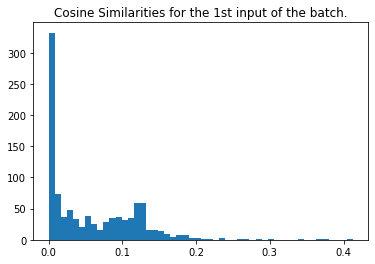

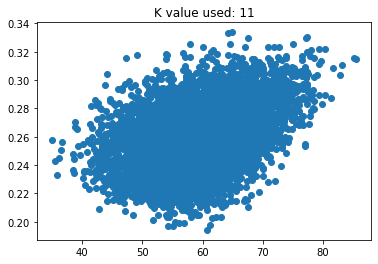

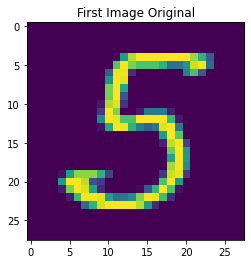

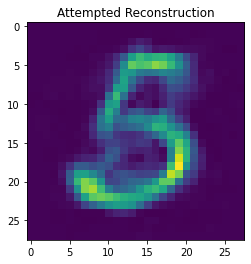

MSE loss for this input is:  0.0012737222167910362
train loss: 0.0002743818040471524 test loss: 0.0002779286587610841
[epoch, batch], [28,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


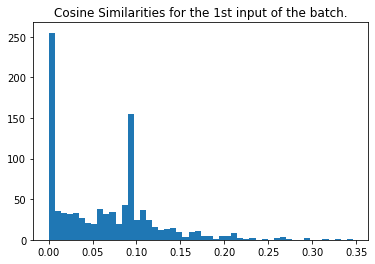

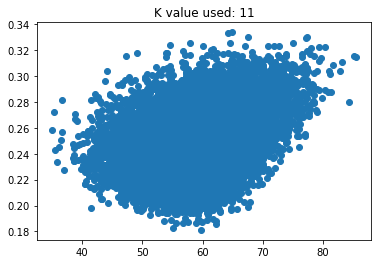

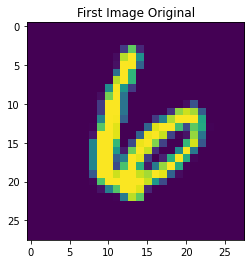

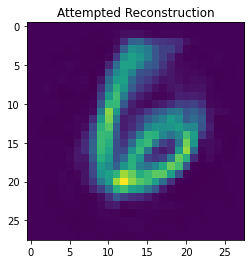

MSE loss for this input is:  0.00116190177445509
train loss: 0.00024304153339471668 test loss: 0.00025025117793120444
[epoch, batch], [29,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


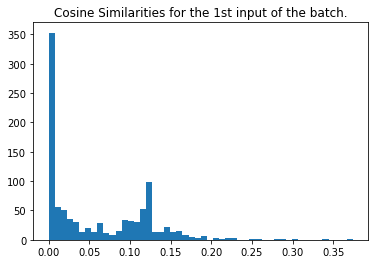

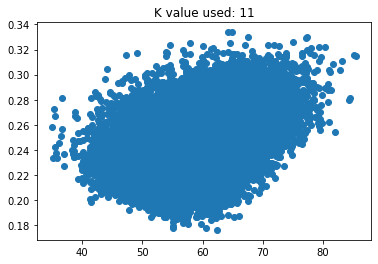

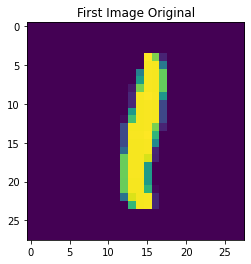

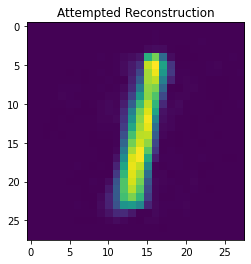

MSE loss for this input is:  0.00045889566595457037
train loss: 0.00024810535251162946 test loss: 0.0002464548160787672
[epoch, batch], [30,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


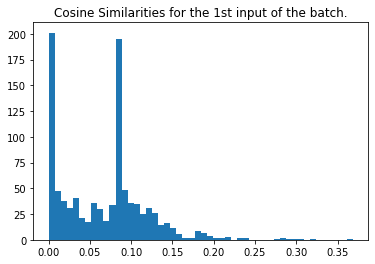

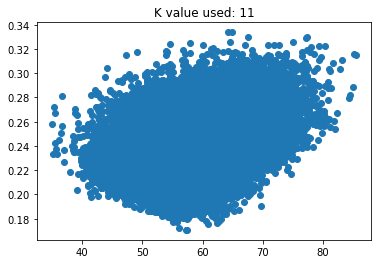

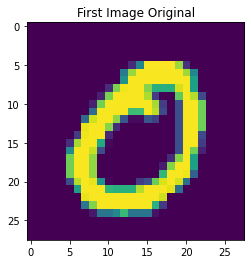

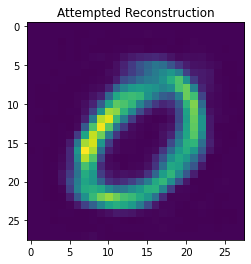

MSE loss for this input is:  0.0007758151207651411
train loss: 0.00025364922476001084 test loss: 0.0002522056456655264
[epoch, batch], [31,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


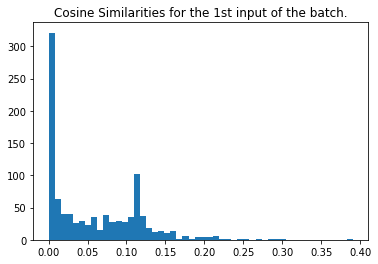

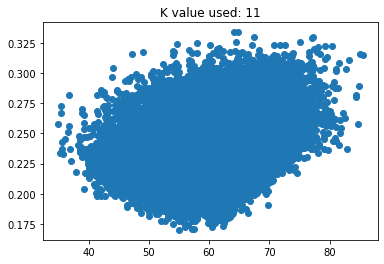

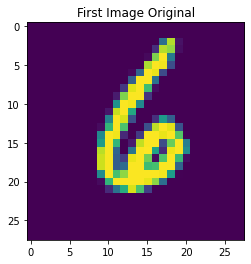

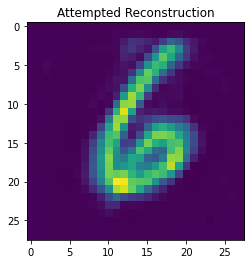

MSE loss for this input is:  0.0010024398109134362
train loss: 0.00024383733398281038 test loss: 0.0002281061460962519
[epoch, batch], [32,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


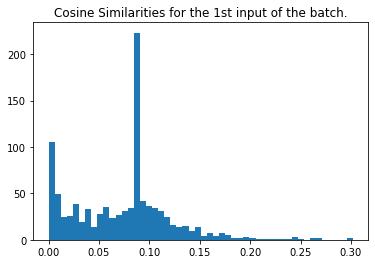

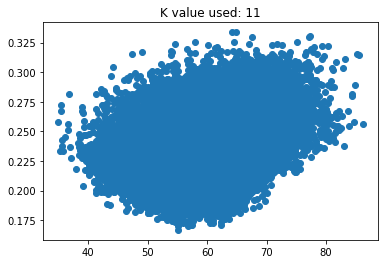

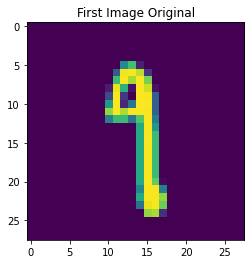

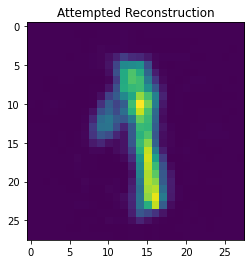

MSE loss for this input is:  0.0010138233857495444
train loss: 0.0002354000898776576 test loss: 0.00023891005548648536
[epoch, batch], [33,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


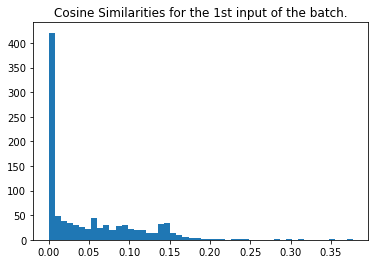

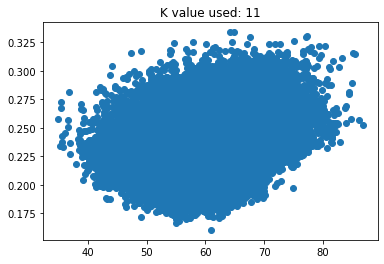

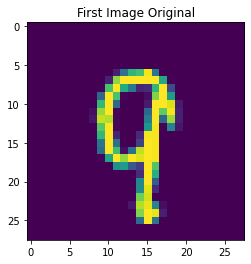

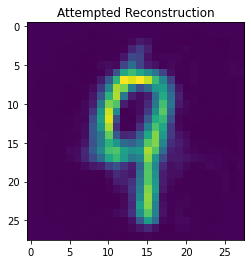

MSE loss for this input is:  0.0013017420257840837
train loss: 0.000234692168305628 test loss: 0.00024421524722129107
[epoch, batch], [34,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


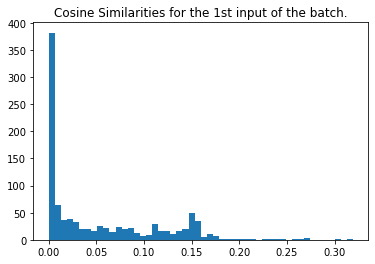

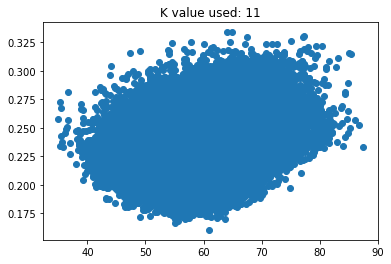

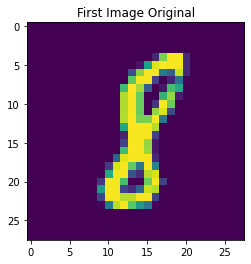

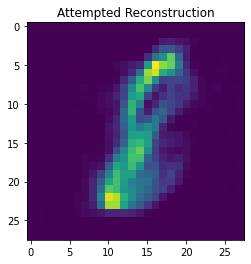

MSE loss for this input is:  0.000796043295033124
train loss: 0.00024324312107637525 test loss: 0.00023418630007654428
[epoch, batch], [35,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


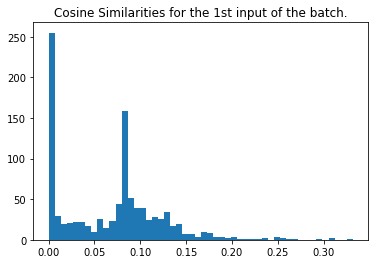

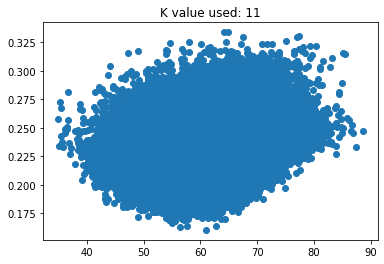

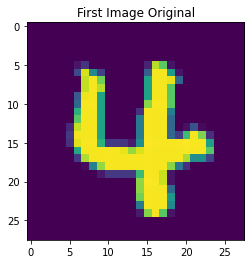

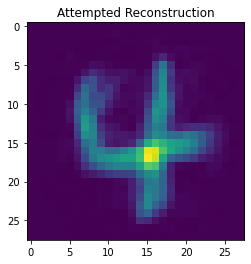

MSE loss for this input is:  0.001613278322073878
train loss: 0.0002467044978402555 test loss: 0.00023769881227053702
[epoch, batch], [36,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


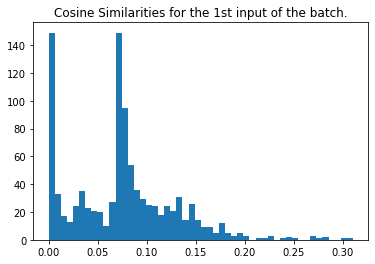

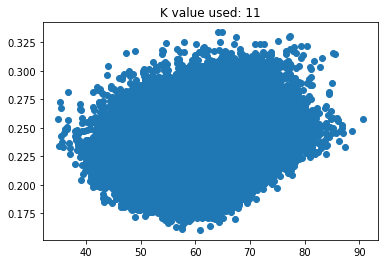

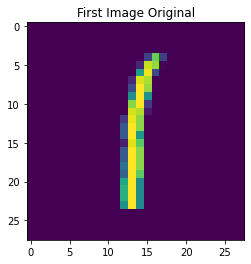

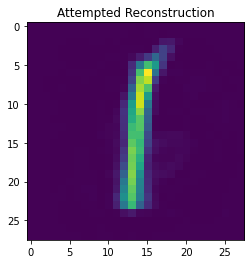

MSE loss for this input is:  0.0016320439017548853
train loss: 0.00023254472762346268 test loss: 0.0002265219809487462
[epoch, batch], [37,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


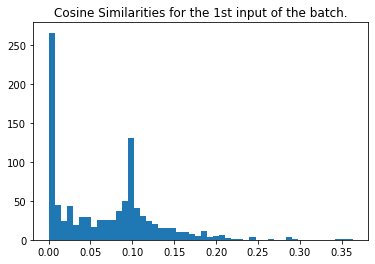

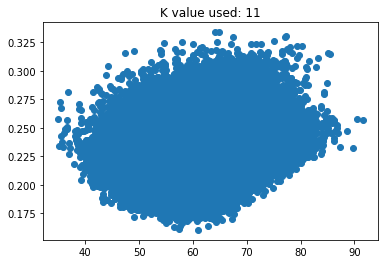

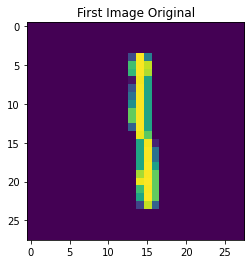

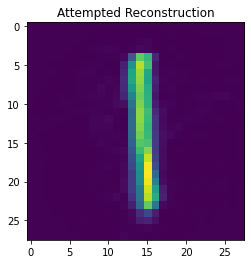

MSE loss for this input is:  0.0018961420472787351
train loss: 0.00023326172959059477 test loss: 0.00022693315986543894
[epoch, batch], [38,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


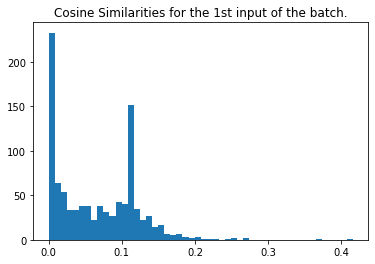

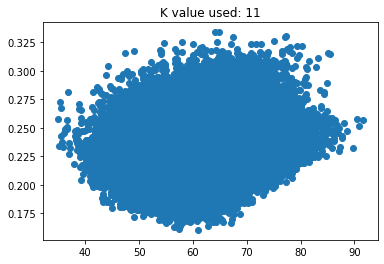

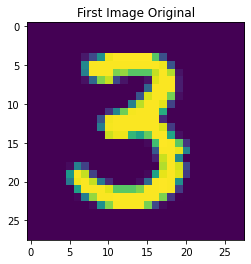

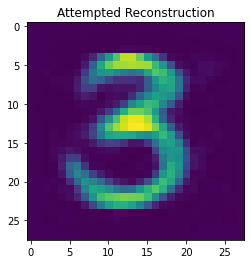

MSE loss for this input is:  0.0016399469910835733
train loss: 0.0002267907839268446 test loss: 0.00022231826733332127
[epoch, batch], [39,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


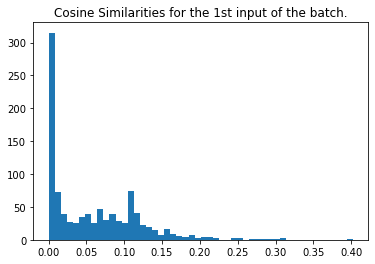

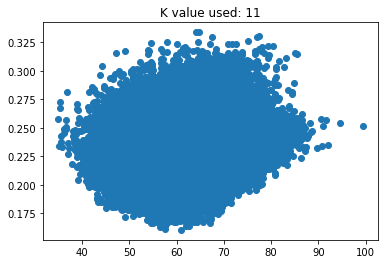

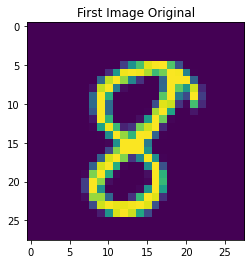

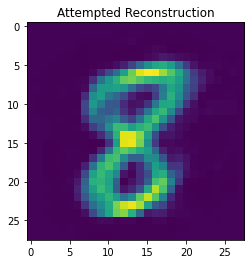

MSE loss for this input is:  0.0016888197587460888
train loss: 0.0002312299475306645 test loss: 0.00021881003340240568
[epoch, batch], [40,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


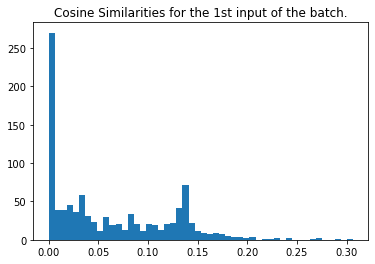

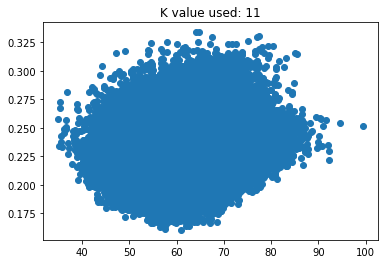

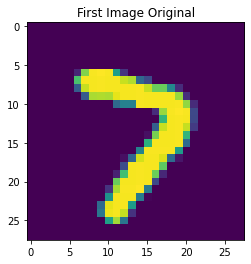

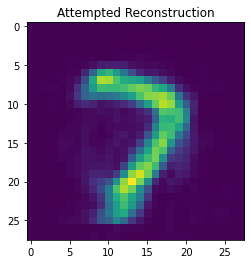

MSE loss for this input is:  0.0015898249587234185
train loss: 0.00023064961715135723 test loss: 0.0002333854208700359
Finished Training


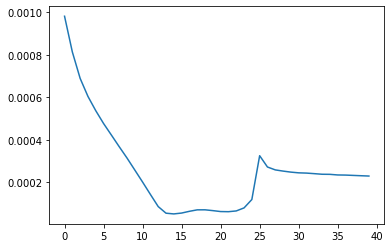

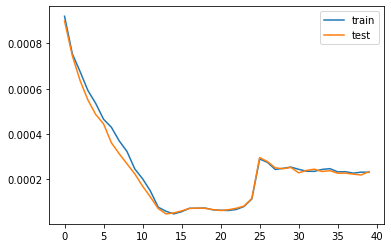

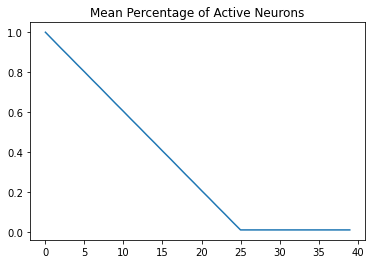

Latents and Labels dimensions: (60000, 1000) (60000,)
Latents and Labels dimensions: (10000, 1000) (10000,)
Logistic regression accuracy: Train= 0.886 | Test= 0.895


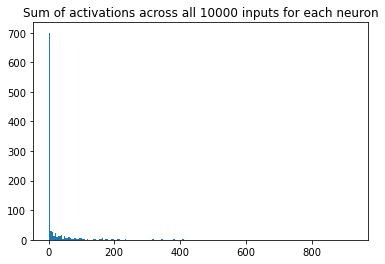

[700.  29.  28.  14.  23.   9.  13.  14.  17.   4.  13.   6.   7.   9.
   6.   4.   3.   5.   2.   4.   5.   6.   3.   3.   1.   2.   1.   1.
   1.   2.   2.   1.   0.   2.   3.   7.   0.   2.   3.   0.   1.   2.
   3.   0.   1.   2.   2.   0.   0.   1.   2.   0.   1.   1.   0.   0.
   0.   0.   0.   1.   1.   1.   1.   1.   0.   0.   0.   0.   4.   0.
   0.   0.   0.   1.   2.   0.   0.   1.   0.   0.   1.   0.   2.   1.
   0.   0.   0.   0.   2.   0.   0.   0.   0.   0.   1.   0.   0.   0.
   1.   0.   0.   0.   1.   1.   0.   1.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.   0.   1.   0.   0.
   0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0. 

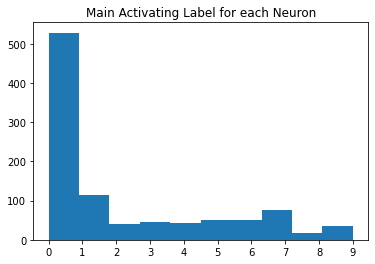

Neuron addresses should be 1000x784!!! (1000, 784) (1000, 784)
Euclidian distance


,0,1,2,3,4,5,6,7,8,9
0,0.000000,0.029253,0.082548,0.076391,0.068491,0.056237,0.062292,0.049298,0.128952,0.070428
1,0.029253,0.000000,0.069290,0.060418,0.070561,0.054617,0.063807,0.051697,0.109217,0.065207
2,0.082548,0.069290,0.000000,0.055890,0.071709,0.075355,0.069643,0.075760,0.115913,0.086418
3,0.076391,0.060418,0.055890,0.000000,0.075565,0.074642,0.084511,0.063763,0.097638,0.082389
4,0.068491,0.070561,0.071709,0.075565,0.000000,0.066331,0.068345,0.053058,0.109204,0.068838
5,0.056237,0.054617,0.075355,0.074642,0.066331,0.000000,0.074887,0.058035,0.094484,0.074546
6,0.062292,0.063807,0.069643,0.084511,0.068345,0.074887,0.000000,0.075530,0.117448,0.089351
7,0.049298,0.051697,0.075760,0.063763,0.053058,0.058035,0.075530,0.000000,0.106036,0.054318
8,0.128952,0.109217,0.115913,0.097638,0.109204,0.094484,0.117448,0.106036,0.000000,0.117665
9,0.070428,0.065207,0.086418,0.082389,0.068838,0.074546,0.089351,0.054318,0.117665,0.000000


cosine similarity


,0,1,2,3,4,5,6,7,8,9
0,1.000000,0.557841,0.519134,0.539690,0.574829,0.575503,0.577946,0.634472,0.558528,0.581698
1,0.557841,1.000000,0.593043,0.633491,0.520900,0.575173,0.537041,0.577394,0.585651,0.577692
2,0.519134,0.593043,1.000000,0.731003,0.643858,0.600368,0.642965,0.590460,0.586336,0.576100
3,0.539690,0.633491,0.731003,1.000000,0.612564,0.588902,0.550619,0.643116,0.651371,0.583526
4,0.574829,0.520900,0.643858,0.612564,1.000000,0.618261,0.621787,0.689039,0.600613,0.639359
5,0.575503,0.575173,0.600368,0.588902,0.618261,1.000000,0.547309,0.620364,0.653899,0.578565
6,0.577946,0.537041,0.642965,0.550619,0.621787,0.547309,1.000000,0.531117,0.560183,0.513564
7,0.634472,0.577394,0.590460,0.643116,0.689039,0.620364,0.531117,1.000000,0.600749,0.688384
8,0.558528,0.585651,0.586336,0.651371,0.600613,0.653899,0.560183,0.600749,1.000000,0.569561
9,0.581698,0.577692,0.576100,0.583526,0.639359,0.578565,0.513564,0.688384,0.569561,1.000000


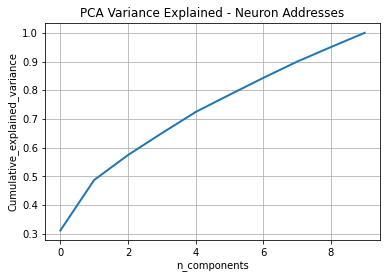

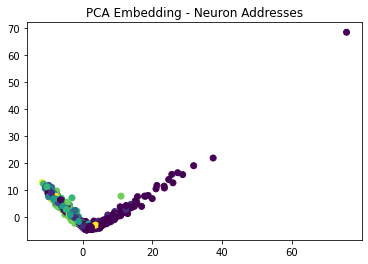

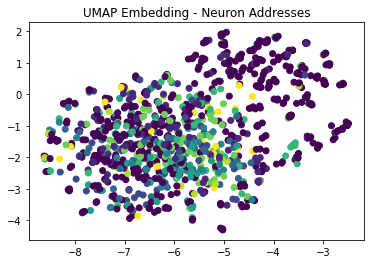

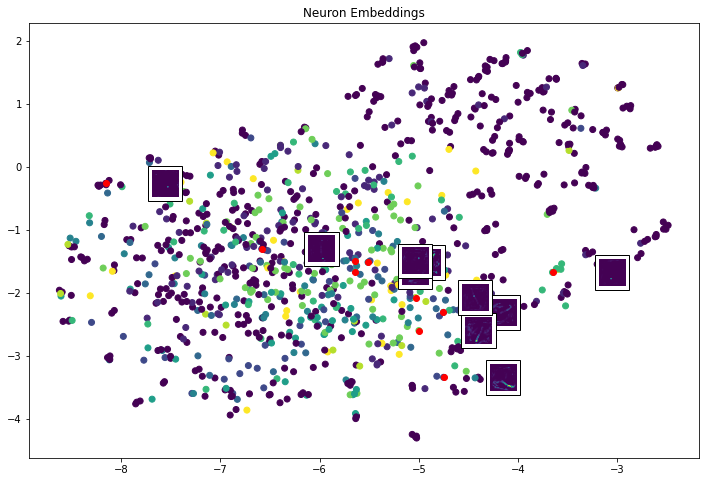

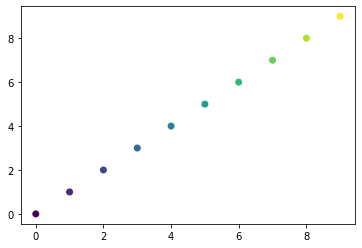

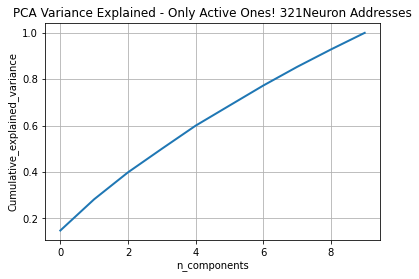

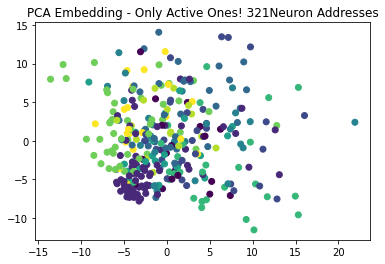

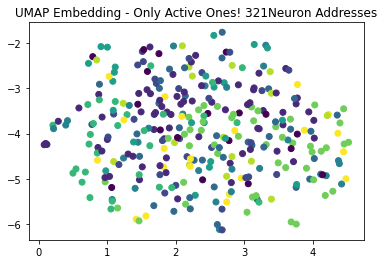

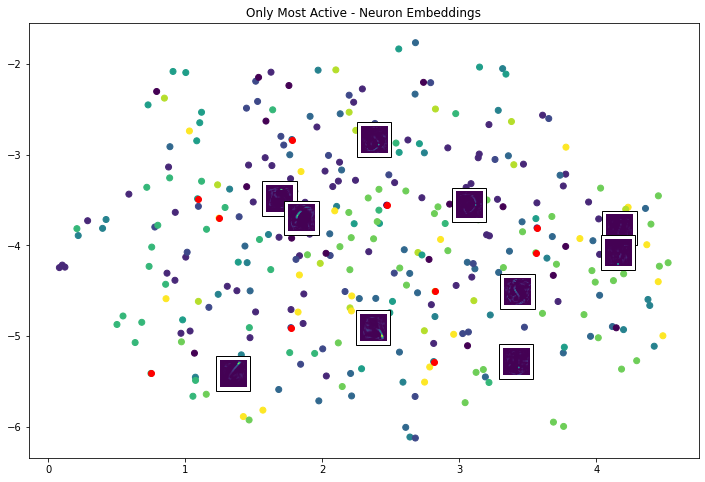

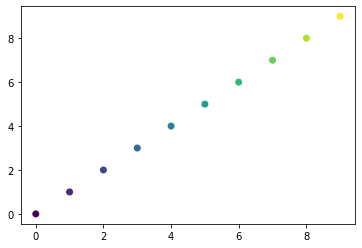

Giving some random plots from the most active neurons


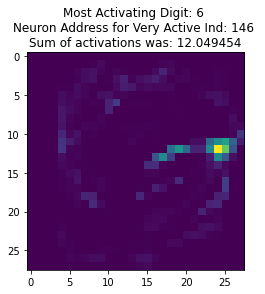

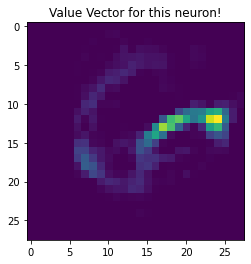

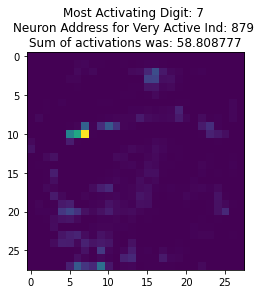

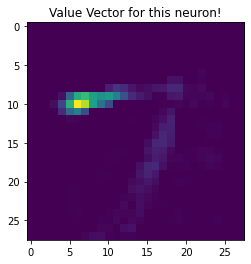

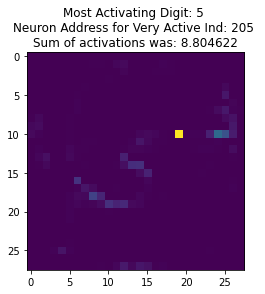

...

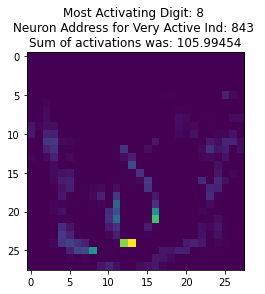

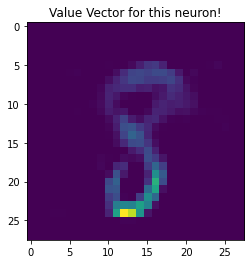

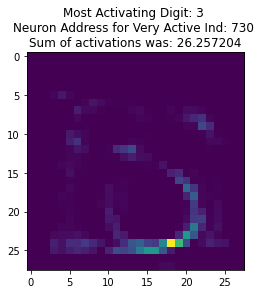

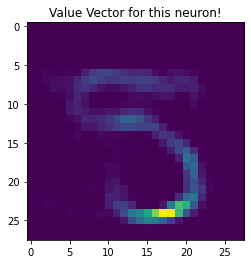

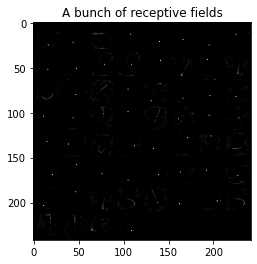

length of net parameters 2
[epoch, batch], [1,   250] loss: 0.000
mean actives 1000.0 1.0 % | max 1000 1.0 %
(128, 1000) shape of cosine sims


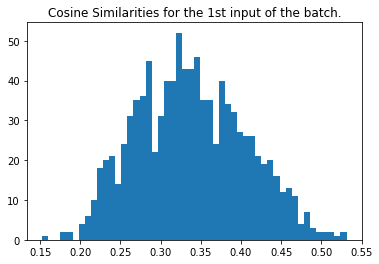

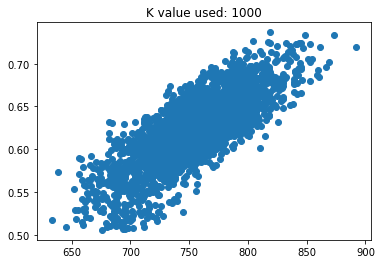

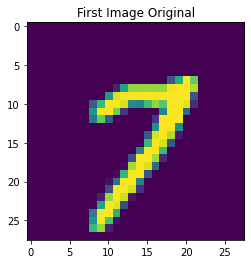

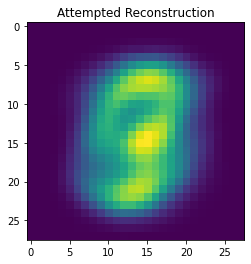

MSE loss for this input is:  0.0004232790777269675
train loss: 0.0009446043986827135 test loss: 0.0009242724045179784
[epoch, batch], [2,   250] loss: 0.000
mean actives 960.0 0.96 % | max 960 0.96 %
(128, 1000) shape of cosine sims


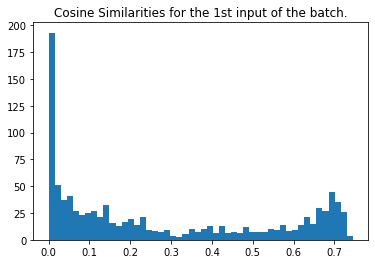

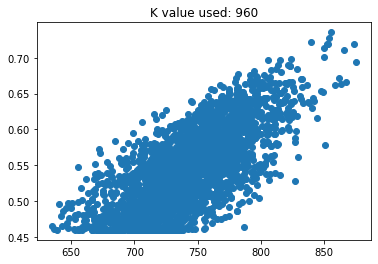

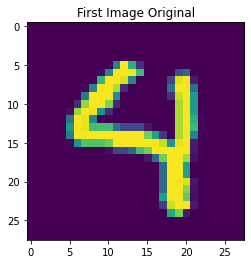

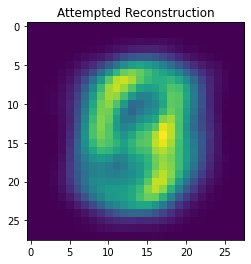

MSE loss for this input is:  0.001122272972549711
train loss: 0.0007659763214178383 test loss: 0.0007342515746131539
[epoch, batch], [3,   250] loss: 0.000
mean actives 920.0 0.92 % | max 920 0.92 %
(128, 1000) shape of cosine sims


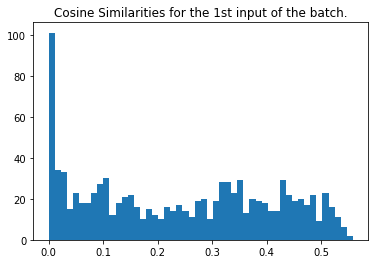

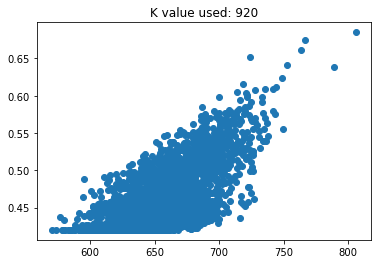

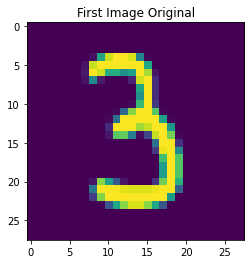

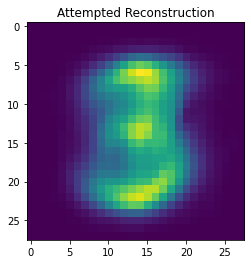

MSE loss for this input is:  0.000965908549878062
train loss: 0.0006747576408088207 test loss: 0.0006651112926192582
[epoch, batch], [4,   250] loss: 0.000
mean actives 881.0 0.881 % | max 881 0.881 %
(128, 1000) shape of cosine sims


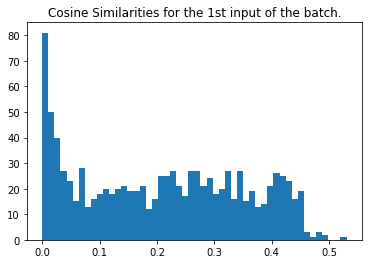

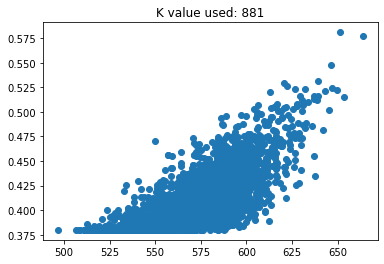

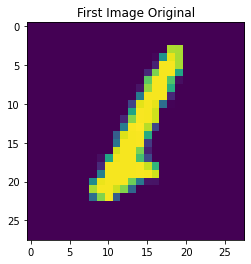

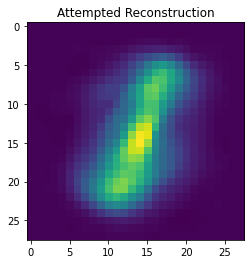

MSE loss for this input is:  0.0008901679242143825
train loss: 0.0006007581832818687 test loss: 0.0005495493533089757
[epoch, batch], [5,   250] loss: 0.000
mean actives 841.0 0.841 % | max 841 0.841 %
(128, 1000) shape of cosine sims


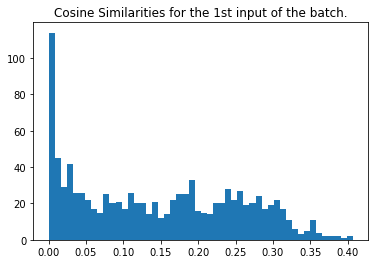

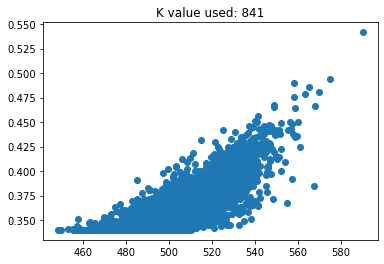

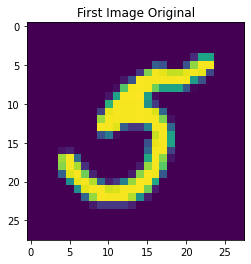

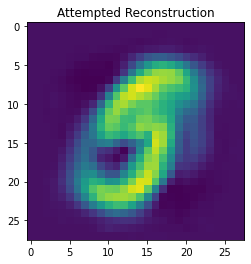

MSE loss for this input is:  0.00139951584290485
train loss: 0.0005347478436306119 test loss: 0.0005040451069362462
[epoch, batch], [6,   250] loss: 0.000
mean actives 802.0 0.802 % | max 802 0.802 %
(128, 1000) shape of cosine sims


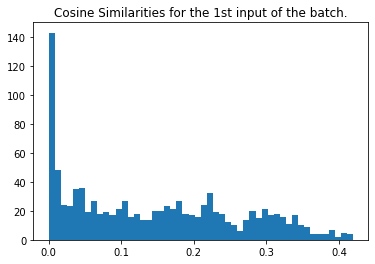

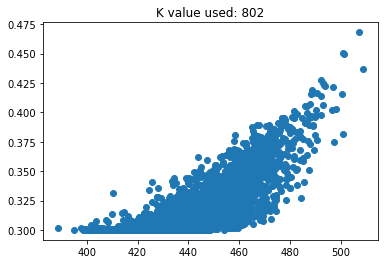

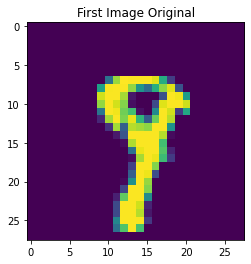

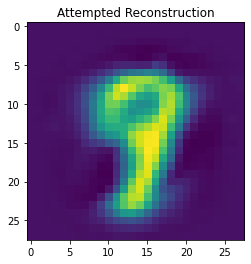

MSE loss for this input is:  0.0008668752045047527
train loss: 0.00048067606985569 test loss: 0.00042680001934058964
[epoch, batch], [7,   250] loss: 0.000
mean actives 762.0 0.762 % | max 762 0.762 %
(128, 1000) shape of cosine sims


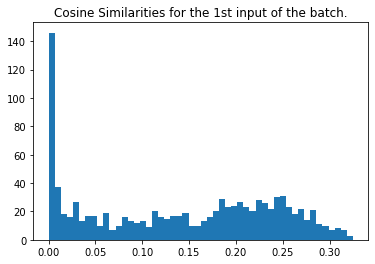

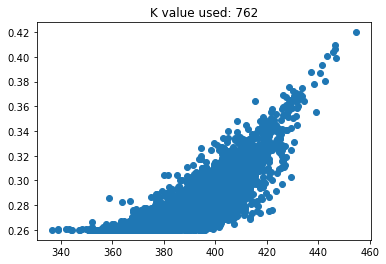

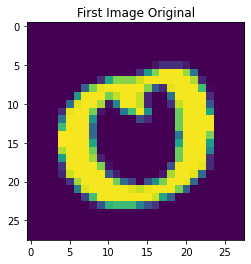

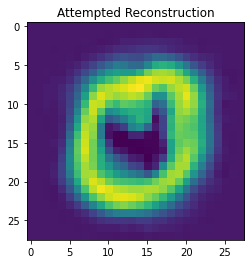

MSE loss for this input is:  0.0010930753636116885
train loss: 0.0004211422346998006 test loss: 0.0003516450524330139
[epoch, batch], [8,   250] loss: 0.000
mean actives 723.0 0.723 % | max 723 0.723 %
(128, 1000) shape of cosine sims


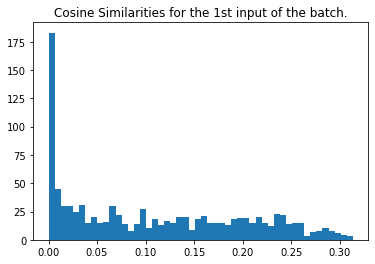

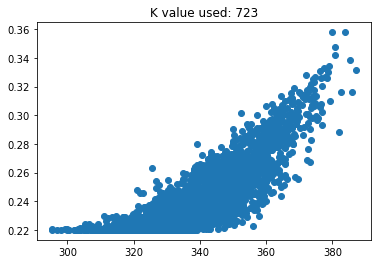

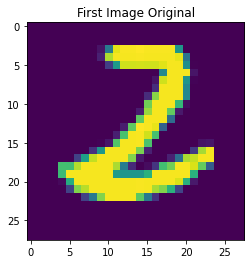

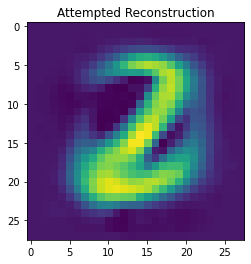

MSE loss for this input is:  0.0012023137236128049
train loss: 0.00035732623655349016 test loss: 0.0003040991723537445
[epoch, batch], [9,   250] loss: 0.000
mean actives 683.0 0.683 % | max 683 0.683 %
(128, 1000) shape of cosine sims


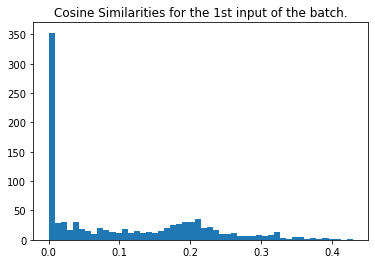

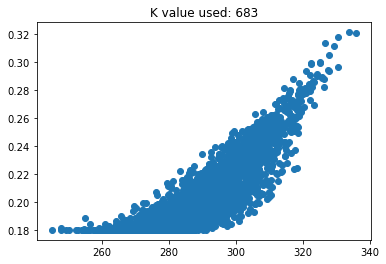

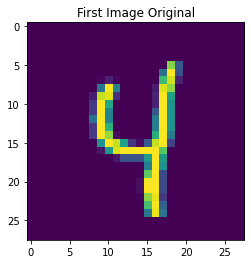

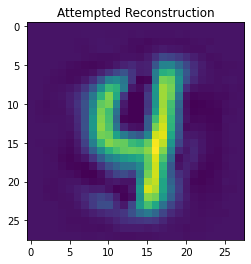

MSE loss for this input is:  0.0012186114885369126
train loss: 0.00030669261468574405 test loss: 0.0002791928418446332
[epoch, batch], [10,   250] loss: 0.000
mean actives 643.0 0.643 % | max 643 0.643 %
(128, 1000) shape of cosine sims


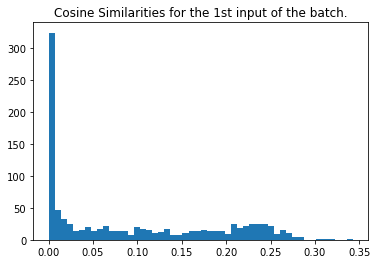

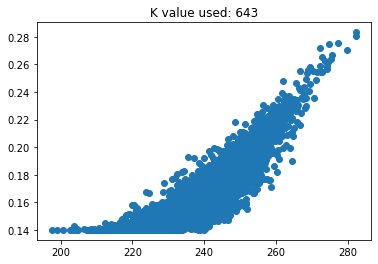

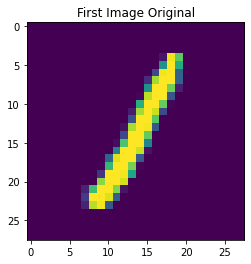

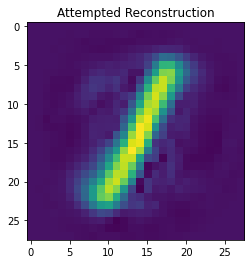

MSE loss for this input is:  0.0014271483737595227
train loss: 0.0002668623928911984 test loss: 0.0002187259087804705
[epoch, batch], [11,   250] loss: 0.000
mean actives 604.0 0.604 % | max 604 0.604 %
(128, 1000) shape of cosine sims


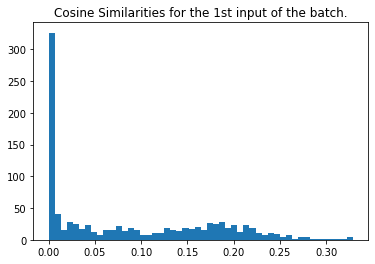

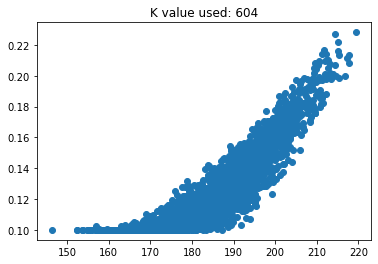

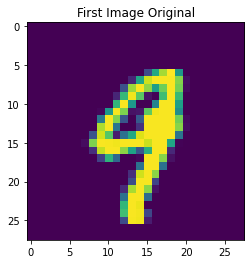

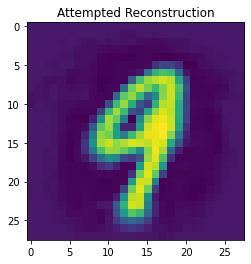

MSE loss for this input is:  0.0012448002793350999
train loss: 0.00018964099581353366 test loss: 0.00015998835442587733
[epoch, batch], [12,   250] loss: 0.000
mean actives 564.0 0.564 % | max 564 0.564 %
(128, 1000) shape of cosine sims


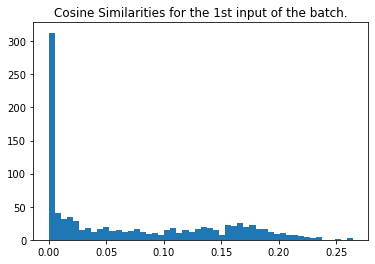

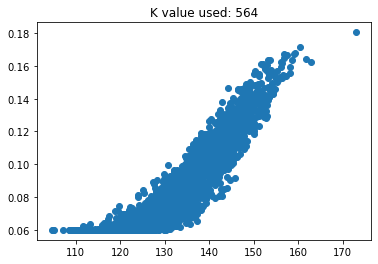

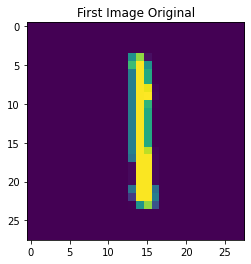

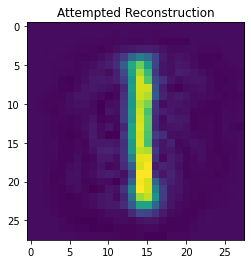

MSE loss for this input is:  0.0014763442533356802
train loss: 0.00014261779142543674 test loss: 0.00011834144970634952
[epoch, batch], [13,   250] loss: 0.000
mean actives 525.0 0.525 % | max 525 0.525 %
(128, 1000) shape of cosine sims


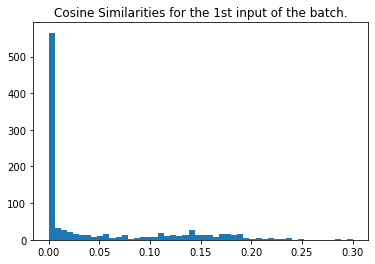

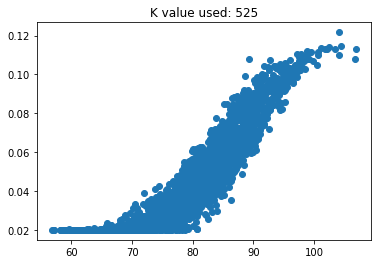

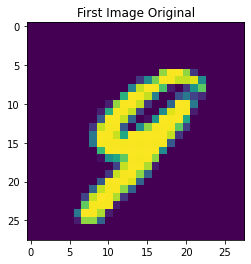

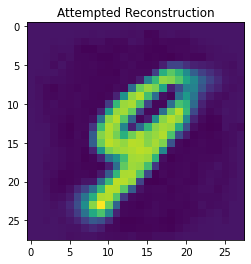

MSE loss for this input is:  0.0016845020712638388
train loss: 8.434351912001148e-05 test loss: 6.477158603956923e-05
[epoch, batch], [14,   250] loss: 0.000
mean actives 485.0 0.485 % | max 485 0.485 %
(128, 1000) shape of cosine sims


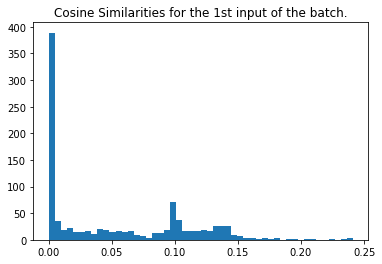

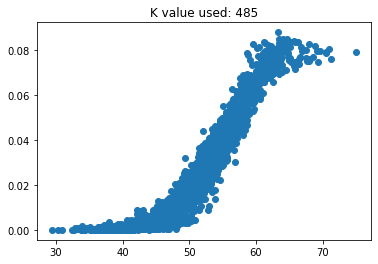

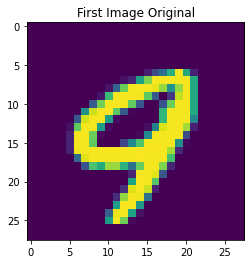

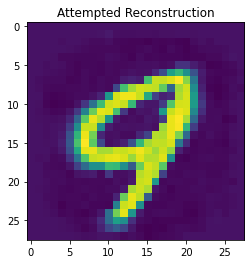

MSE loss for this input is:  0.0007786116733842967
train loss: 5.5135849834186956e-05 test loss: 5.0342459871899337e-05
[epoch, batch], [15,   250] loss: 0.000
mean actives 446.0 0.446 % | max 446 0.446 %
(128, 1000) shape of cosine sims


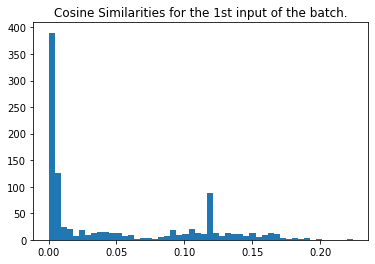

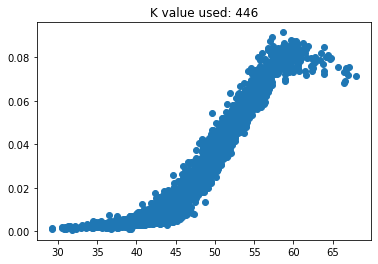

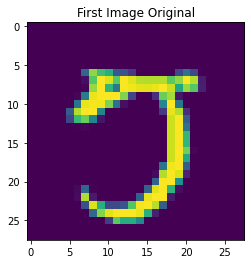

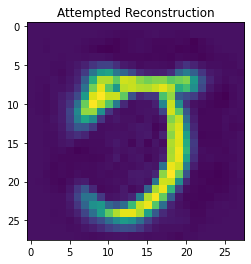

MSE loss for this input is:  0.001296317242846197
train loss: 5.023129051551223e-05 test loss: 5.303404395817779e-05
[epoch, batch], [16,   250] loss: 0.000
mean actives 406.0 0.406 % | max 406 0.406 %
(128, 1000) shape of cosine sims


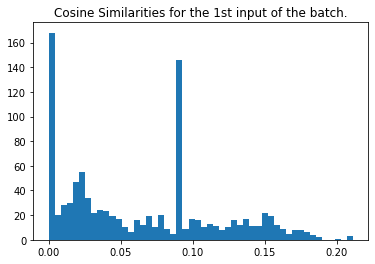

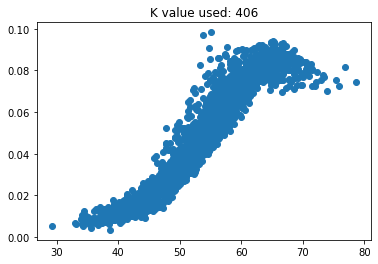

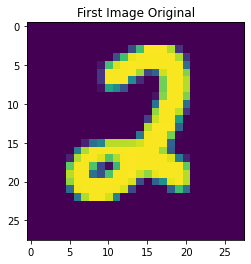

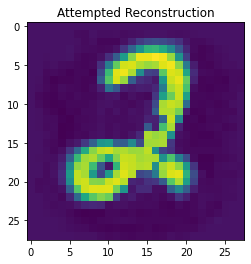

MSE loss for this input is:  0.001307760726432411
train loss: 5.55767874175217e-05 test loss: 5.992232036078349e-05
[epoch, batch], [17,   250] loss: 0.000
mean actives 367.0 0.367 % | max 367 0.367 %
(128, 1000) shape of cosine sims


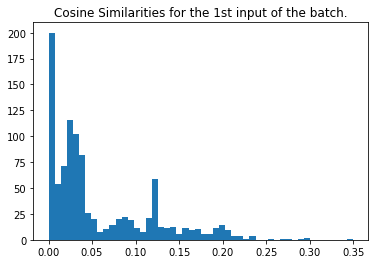

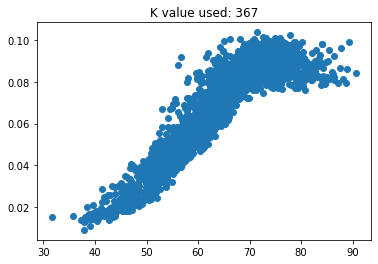

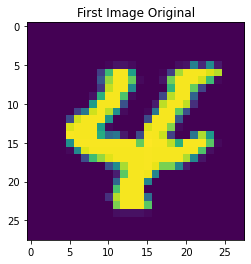

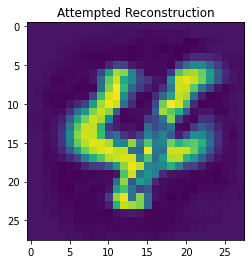

MSE loss for this input is:  0.001542660502754912
train loss: 6.610628042835742e-05 test loss: 7.240894046844915e-05
[epoch, batch], [18,   250] loss: 0.000
mean actives 327.0 0.327 % | max 327 0.327 %
(128, 1000) shape of cosine sims


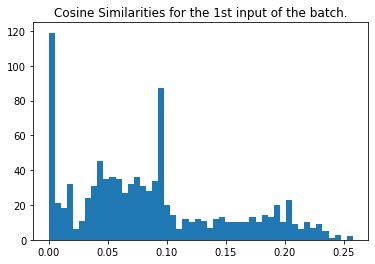

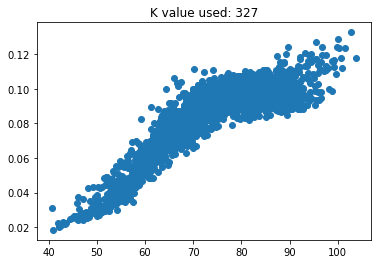

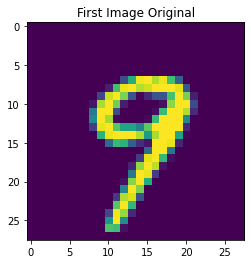

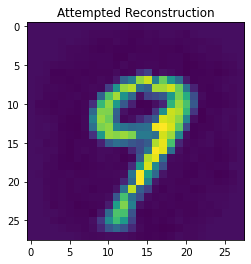

MSE loss for this input is:  0.001000945133214094
train loss: 7.04043559380807e-05 test loss: 7.343736797338352e-05
[epoch, batch], [19,   250] loss: 0.000
mean actives 287.0 0.287 % | max 287 0.287 %
(128, 1000) shape of cosine sims


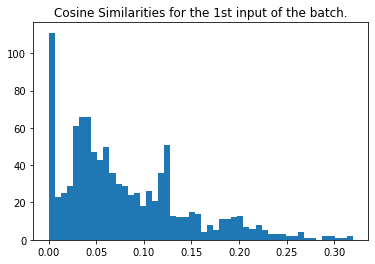

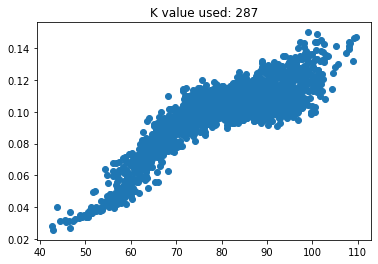

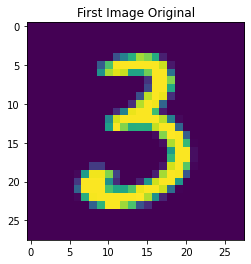

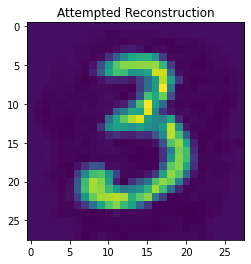

MSE loss for this input is:  0.0016692919390542166
train loss: 7.557080971309915e-05 test loss: 7.439355977112427e-05
[epoch, batch], [20,   250] loss: 0.000
mean actives 248.0 0.248 % | max 248 0.248 %
(128, 1000) shape of cosine sims


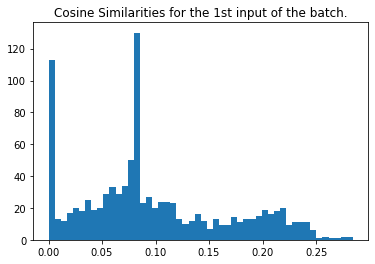

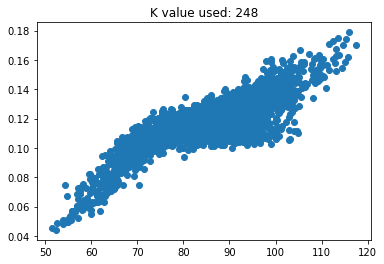

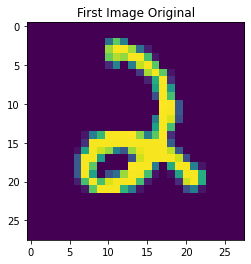

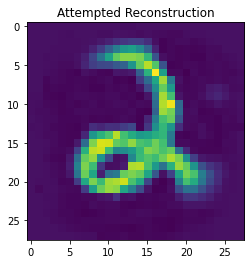

MSE loss for this input is:  0.0010666489905240585
train loss: 7.034457667032257e-05 test loss: 6.959023448871449e-05
[epoch, batch], [21,   250] loss: 0.000
mean actives 208.0 0.208 % | max 208 0.208 %
(128, 1000) shape of cosine sims


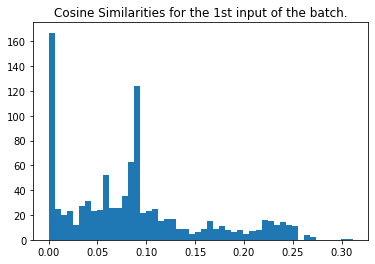

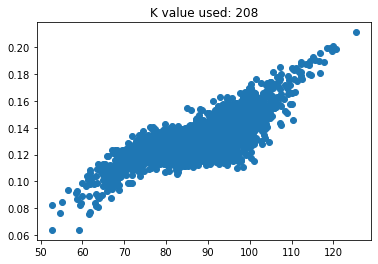

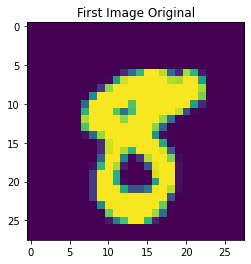

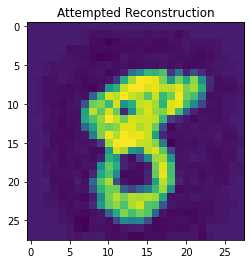

MSE loss for this input is:  0.001571837128425131
train loss: 6.761917029507458e-05 test loss: 7.441704656230286e-05
[epoch, batch], [22,   250] loss: 0.000
mean actives 169.0 0.169 % | max 169 0.169 %
(128, 1000) shape of cosine sims


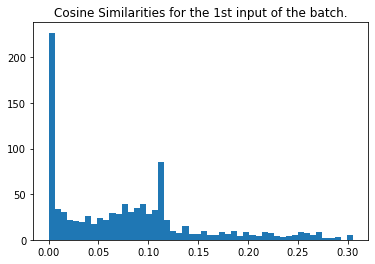

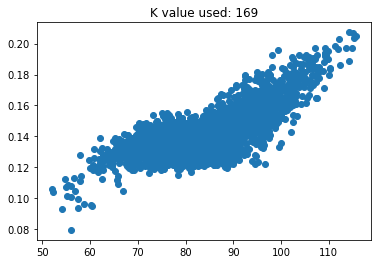

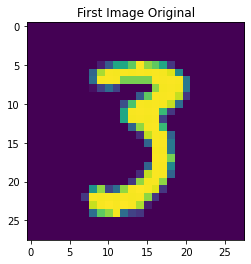

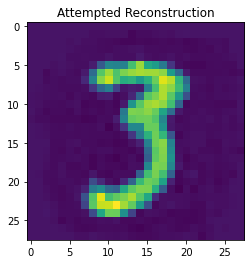

MSE loss for this input is:  0.0014005387011839419
train loss: 6.3637453422416e-05 test loss: 6.703077087877318e-05
[epoch, batch], [23,   250] loss: 0.000
mean actives 129.0 0.129 % | max 129 0.129 %
(128, 1000) shape of cosine sims


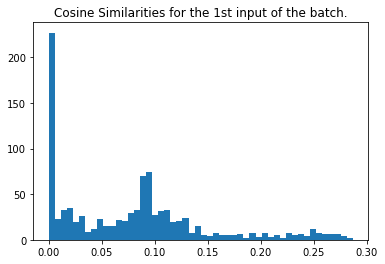

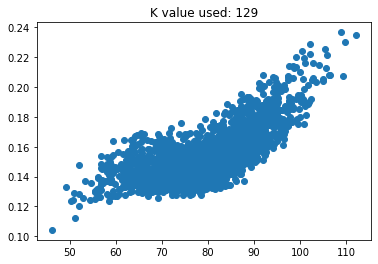

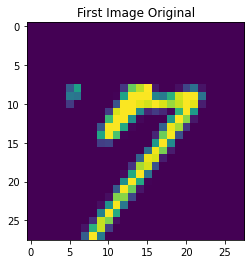

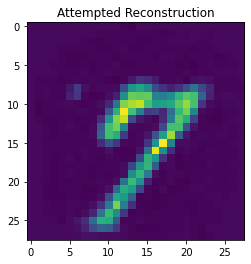

MSE loss for this input is:  0.001625919524504214
train loss: 6.553471030201763e-05 test loss: 7.010786794126034e-05
[epoch, batch], [24,   250] loss: 0.000
mean actives 90.0 0.09 % | max 90 0.09 %
(128, 1000) shape of cosine sims


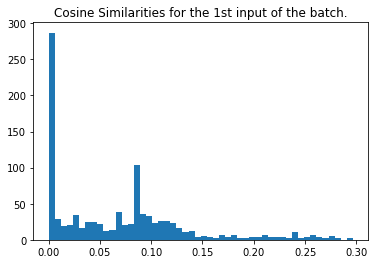

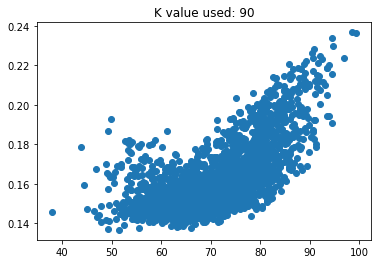

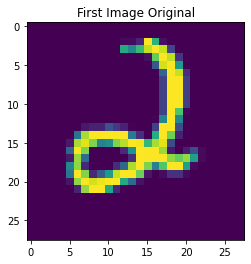

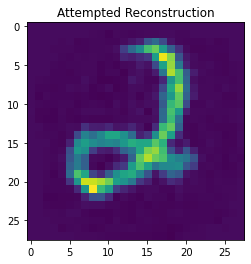

MSE loss for this input is:  0.001964927784034184
train loss: 8.325797534780577e-05 test loss: 8.309257827932015e-05
[epoch, batch], [25,   250] loss: 0.000
mean actives 50.0 0.05 % | max 50 0.05 %
(128, 1000) shape of cosine sims


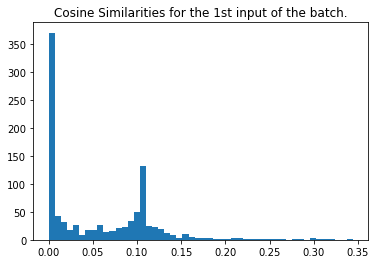

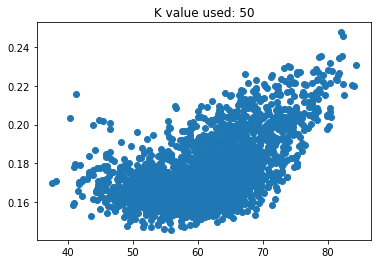

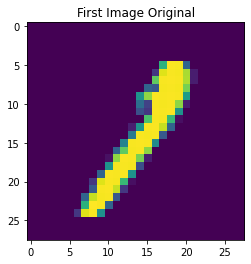

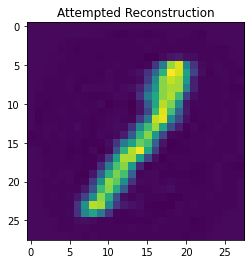

MSE loss for this input is:  0.00030050574972921486
train loss: 0.00010695088712964207 test loss: 0.00011000511585734785
[epoch, batch], [26,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


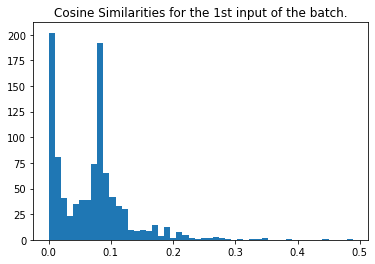

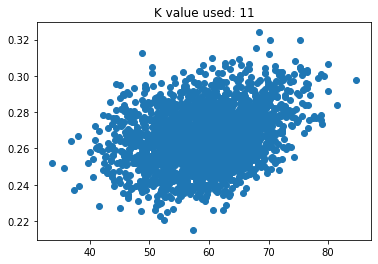

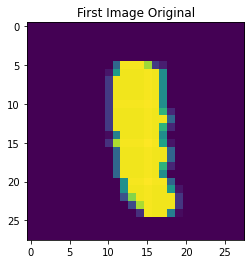

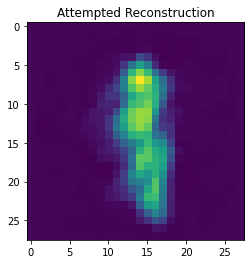

MSE loss for this input is:  0.0013709161050465641
train loss: 0.00028303239378146827 test loss: 0.00028448065859265625
[epoch, batch], [27,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


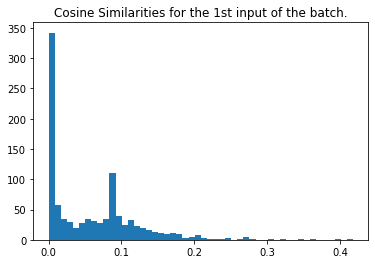

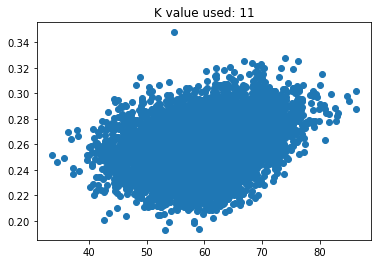

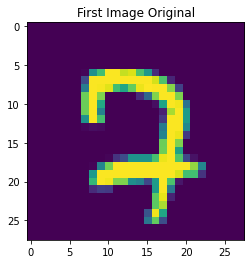

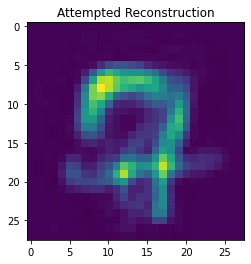

MSE loss for this input is:  0.0009298997418004639
train loss: 0.0002670816029421985 test loss: 0.0002549942582845688
[epoch, batch], [28,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


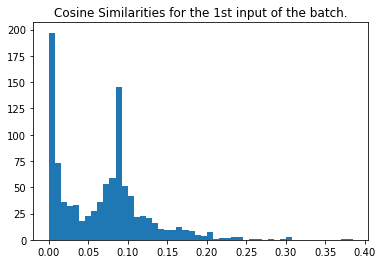

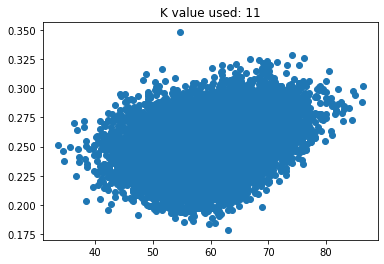

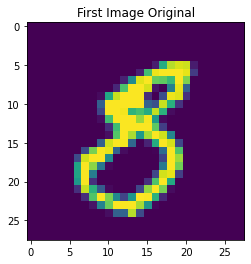

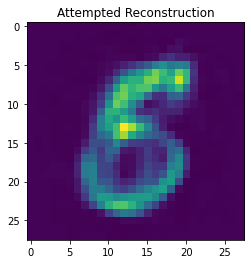

MSE loss for this input is:  0.0011453281099698981
train loss: 0.00025794218527153134 test loss: 0.0002652171824593097
[epoch, batch], [29,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


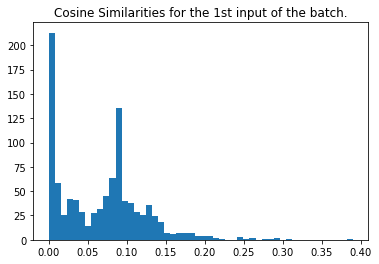

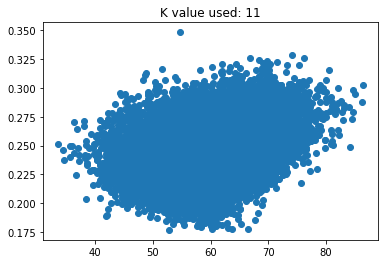

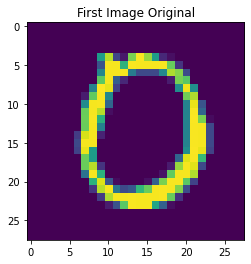

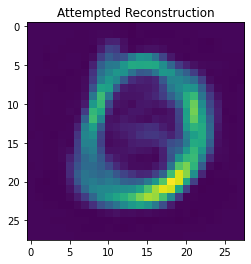

MSE loss for this input is:  0.0012277738020128133
train loss: 0.00025902429479174316 test loss: 0.00023630393843632191
[epoch, batch], [30,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


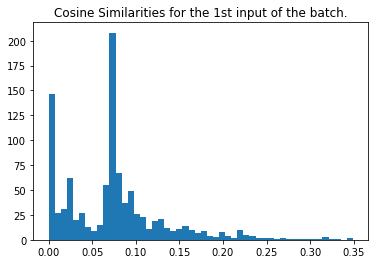

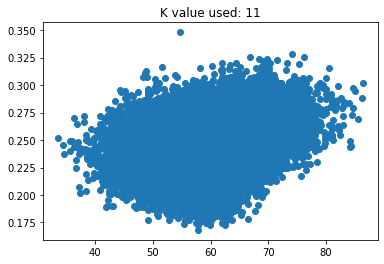

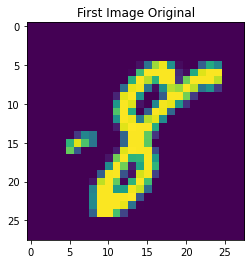

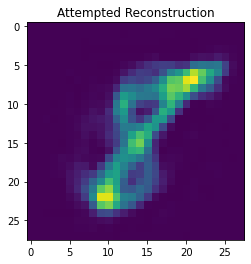

MSE loss for this input is:  0.0014492311343854787
train loss: 0.00025404684129171073 test loss: 0.0002486117009539157
[epoch, batch], [31,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


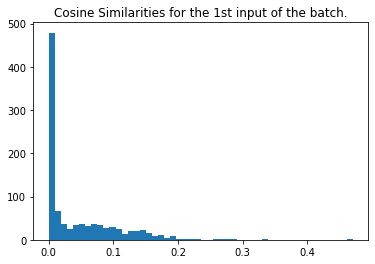

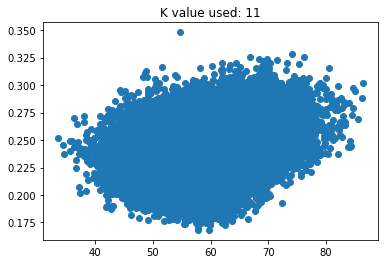

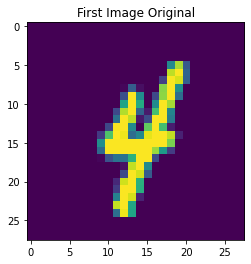

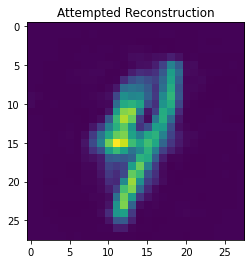

MSE loss for this input is:  0.0020050570672872116
train loss: 0.0002712428104132414 test loss: 0.00022561821970157325
[epoch, batch], [32,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


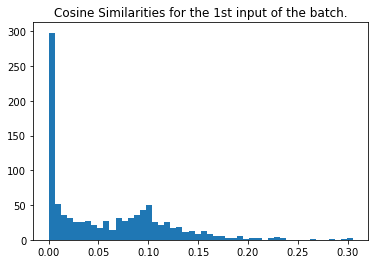

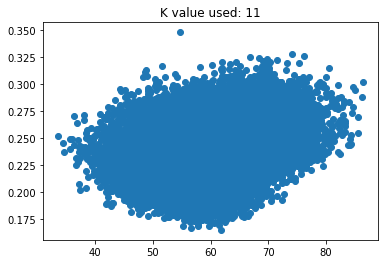

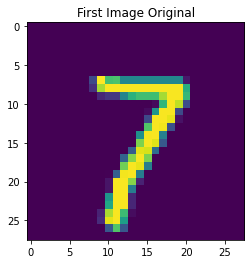

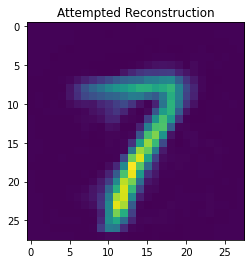

MSE loss for this input is:  0.0018241543854985917
train loss: 0.0002494641812518239 test loss: 0.00024521423620171845
[epoch, batch], [33,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


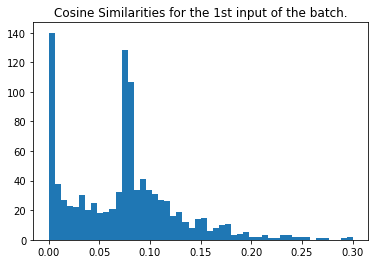

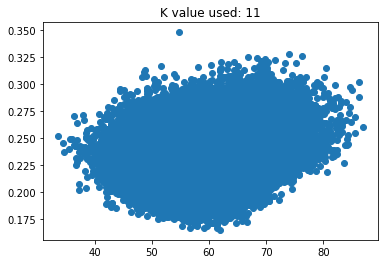

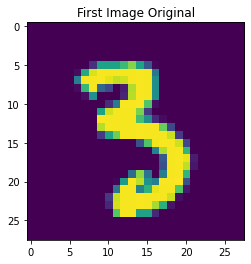

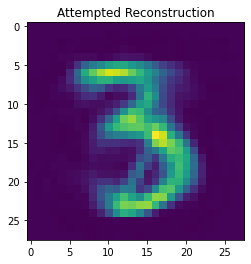

MSE loss for this input is:  0.001241165384346125
train loss: 0.0002421769022475928 test loss: 0.00022639965754933655
[epoch, batch], [34,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


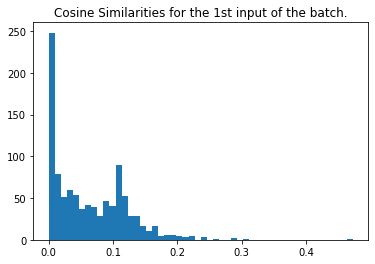

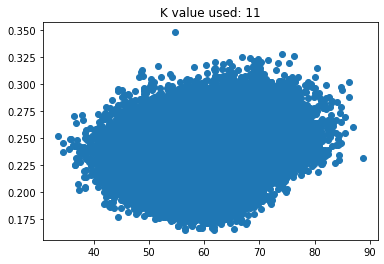

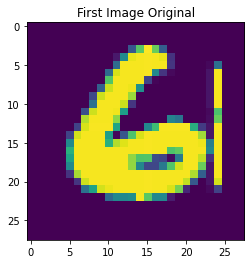

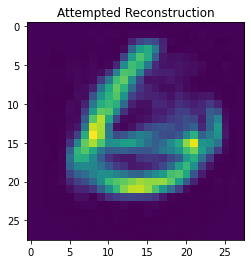

MSE loss for this input is:  0.001474373954899457
train loss: 0.00022787174384575337 test loss: 0.0002388666762271896
[epoch, batch], [35,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


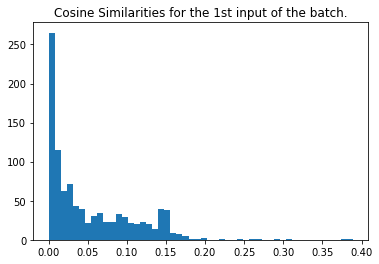

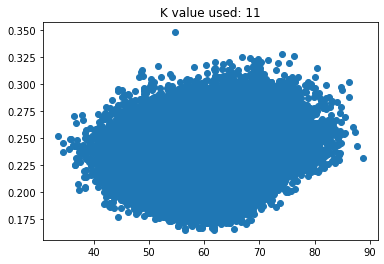

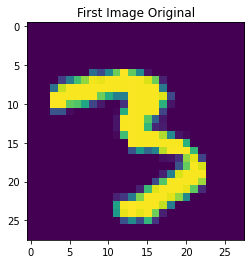

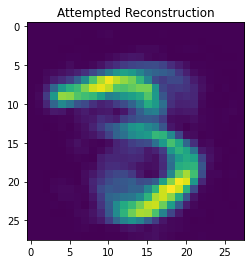

MSE loss for this input is:  0.0017729752830096654
train loss: 0.00025266618467867374 test loss: 0.00022709867334924638
[epoch, batch], [36,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


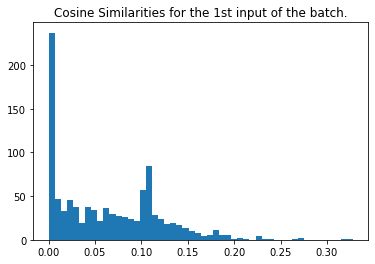

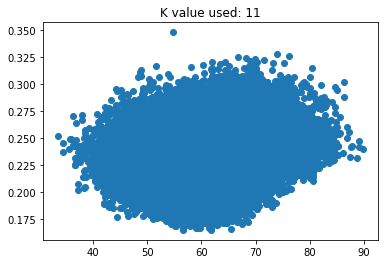

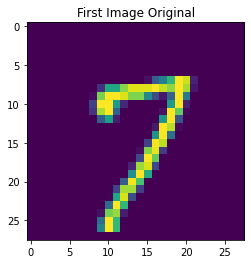

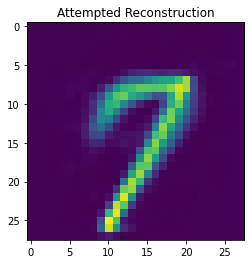

MSE loss for this input is:  0.0014985267605100358
train loss: 0.0002458974195178598 test loss: 0.00022103158698882908
[epoch, batch], [37,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


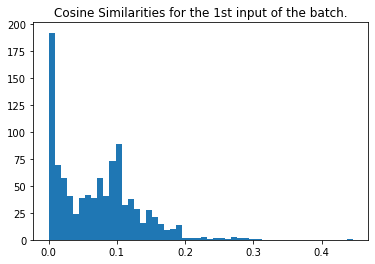

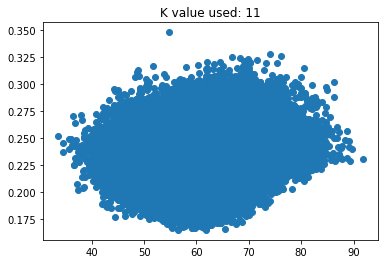

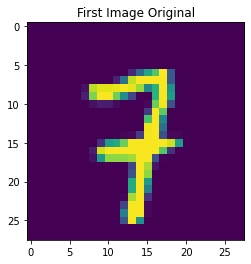

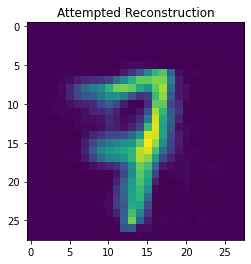

MSE loss for this input is:  0.0012883014824925636
train loss: 0.00022171932505443692 test loss: 0.0002173149841837585
[epoch, batch], [38,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


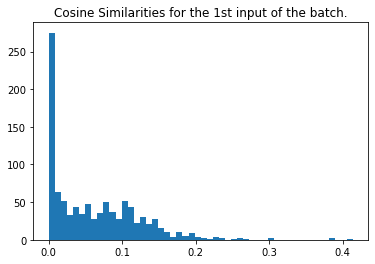

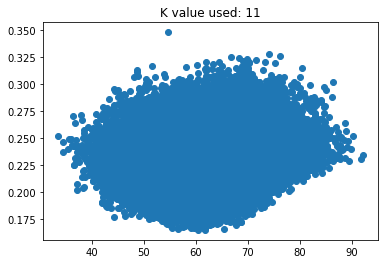

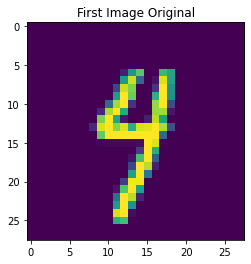

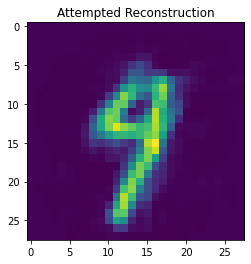

MSE loss for this input is:  0.001766449182617421
train loss: 0.00024313533504027873 test loss: 0.00022945425007492304
[epoch, batch], [39,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


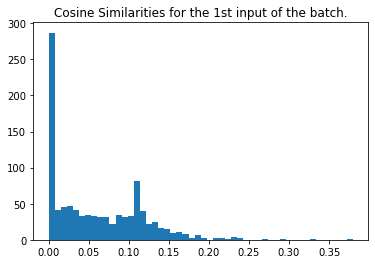

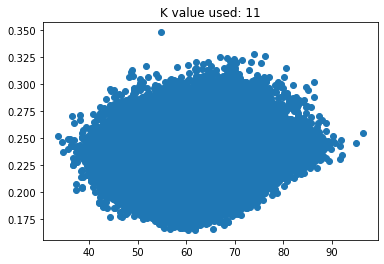

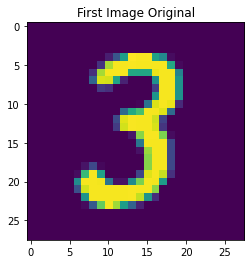

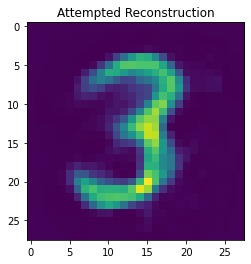

MSE loss for this input is:  0.001523720062508875
train loss: 0.00021976388234179467 test loss: 0.00023698073346167803
[epoch, batch], [40,   250] loss: 0.000
mean actives 11.0 0.011 % | max 11 0.011 %
(128, 1000) shape of cosine sims


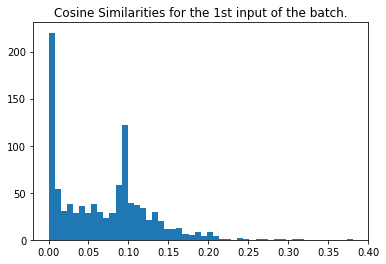

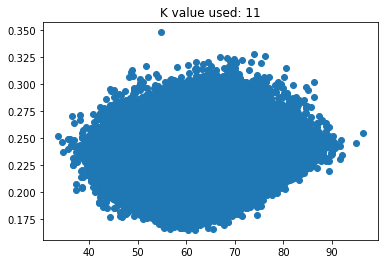

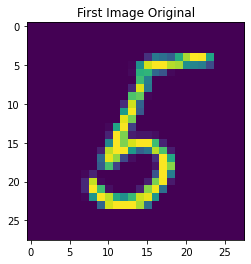

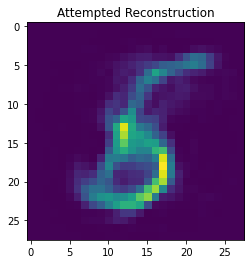

MSE loss for this input is:  0.0013551026278612564
train loss: 0.00022928336693439633 test loss: 0.00022670713951811194
Finished Training


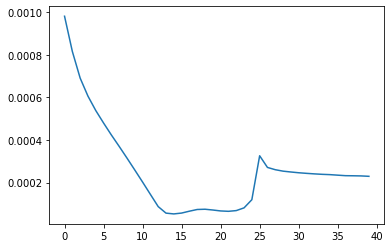

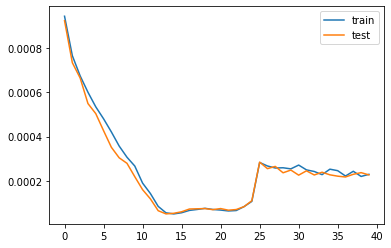

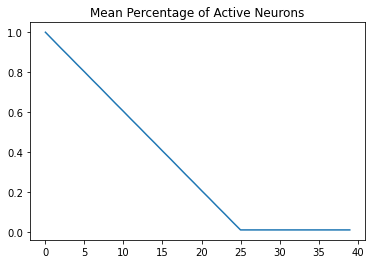

Latents and Labels dimensions: (60000, 1000) (60000,)
Latents and Labels dimensions: (10000, 1000) (10000,)
Logistic regression accuracy: Train= 0.886 | Test= 0.889


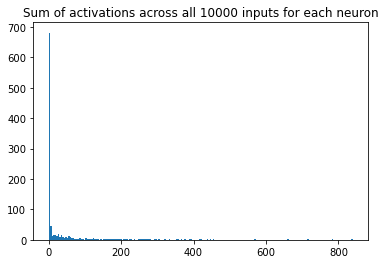

[681.  45.  14.  17.  17.  12.  19.   8.  16.   9.   6.   8.   7.  12.
  10.   5.   5.   2.   4.   4.   7.   1.   2.   0.   6.   3.   3.   2.
   1.   5.   1.   2.   4.   0.   3.   0.   1.   3.   2.   1.   1.   1.
   3.   2.   1.   1.   2.   1.   0.   1.   2.   1.   0.   1.   1.   0.
   1.   0.   0.   1.   1.   1.   1.   1.   1.   2.   1.   0.   0.   2.
   1.   0.   1.   0.   0.   0.   1.   0.   0.   1.   0.   0.   0.   0.
   2.   1.   0.   1.   0.   1.   0.   0.   1.   1.   0.   0.   0.   0.
   0.   1.   2.   0.   0.   0.   1.   0.   1.   0.   1.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   1.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0. 

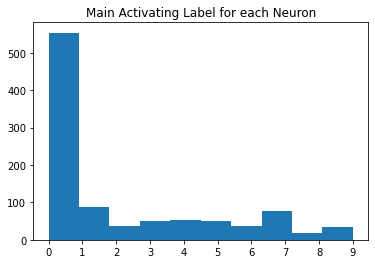

Neuron addresses should be 1000x784!!! (1000, 784) (1000, 784)
Euclidian distance


,0,1,2,3,4,5,6,7,8,9
0,0.000000,0.035409,0.088107,0.062057,0.062738,0.062943,0.087233,0.048071,0.122618,0.057362
1,0.035409,0.000000,0.070486,0.053891,0.063598,0.052420,0.083354,0.052708,0.095645,0.062055
2,0.088107,0.070486,0.000000,0.057646,0.067015,0.072381,0.085169,0.084482,0.106204,0.086287
3,0.062057,0.053891,0.057646,0.000000,0.062715,0.058525,0.090789,0.060849,0.091554,0.068668
4,0.062738,0.063598,0.067015,0.062715,0.000000,0.055337,0.081455,0.052487,0.097598,0.057631
5,0.062943,0.052420,0.072381,0.058525,0.055337,0.000000,0.098893,0.061384,0.080511,0.063675
6,0.087233,0.083354,0.085169,0.090789,0.081455,0.098893,0.000000,0.091052,0.132583,0.103973
7,0.048071,0.052708,0.084482,0.060849,0.052487,0.061384,0.091052,0.000000,0.107089,0.050311
8,0.122618,0.095645,0.106204,0.091554,0.097598,0.080511,0.132583,0.107089,0.000000,0.098333
9,0.057362,0.062055,0.086287,0.068668,0.057631,0.063675,0.103973,0.050311,0.098333,0.000000


cosine similarity


,0,1,2,3,4,5,6,7,8,9
0,1.000000,0.602733,0.565569,0.587767,0.572552,0.582142,0.577199,0.626056,0.543344,0.609428
1,0.602733,1.000000,0.630983,0.633019,0.560440,0.646367,0.548956,0.583860,0.621279,0.555070
2,0.565569,0.630983,1.000000,0.724537,0.677676,0.652121,0.635054,0.567907,0.616056,0.575174
3,0.587767,0.633019,0.724537,1.000000,0.637541,0.663618,0.559511,0.618171,0.648549,0.593787
4,0.572552,0.560440,0.677676,0.637541,1.000000,0.681461,0.605545,0.670618,0.622317,0.658569
5,0.582142,0.646367,0.652121,0.663618,0.681461,1.000000,0.520571,0.616714,0.696333,0.624953
6,0.577199,0.548956,0.635054,0.559511,0.605545,0.520571,1.000000,0.531649,0.517998,0.484674
7,0.626056,0.583860,0.567907,0.618171,0.670618,0.616714,0.531649,1.000000,0.568468,0.674676
8,0.543344,0.621279,0.616056,0.648549,0.622317,0.696333,0.517998,0.568468,1.000000,0.616284
9,0.609428,0.555070,0.575174,0.593787,0.658569,0.624953,0.484674,0.674676,0.616284,1.000000


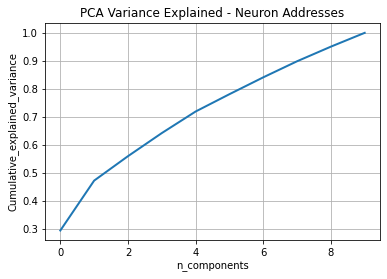

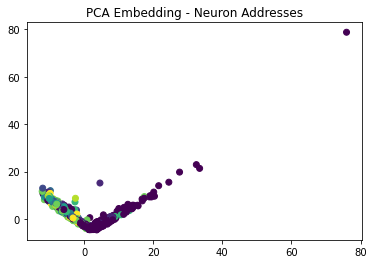

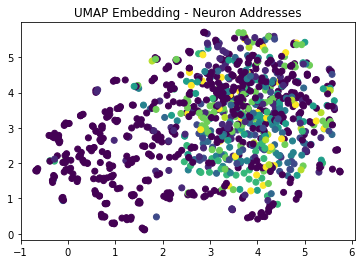

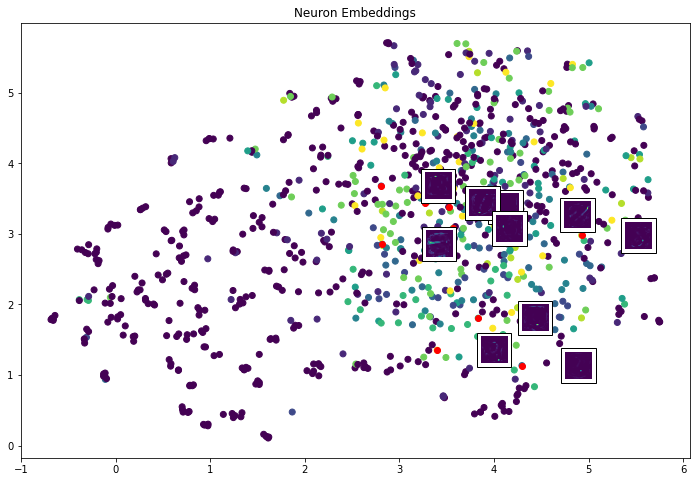

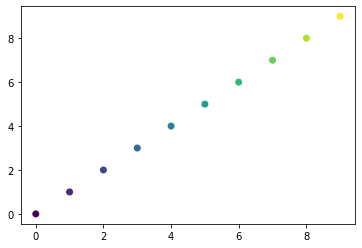

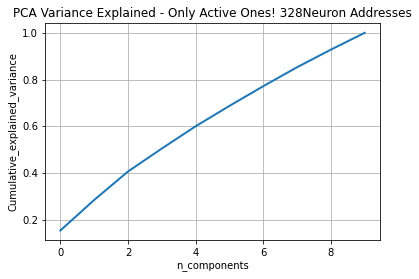

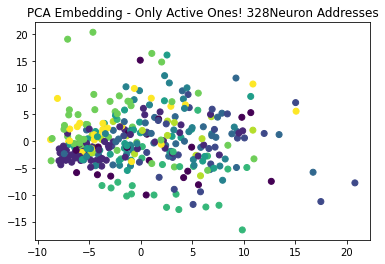

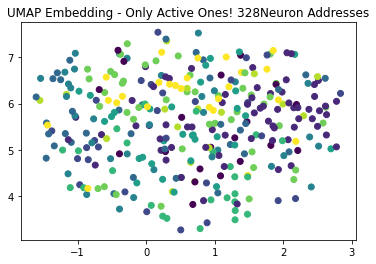

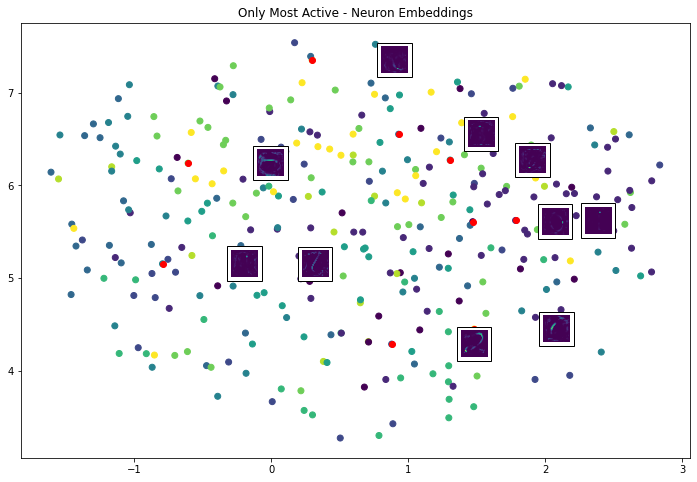

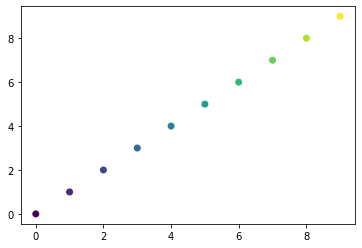

Giving some random plots from the most active neurons


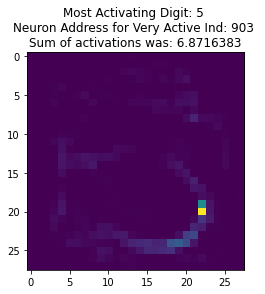

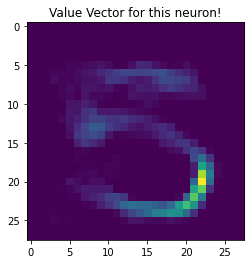

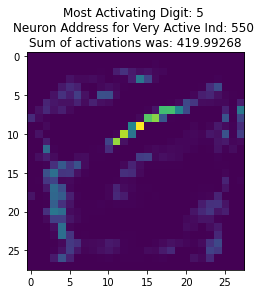

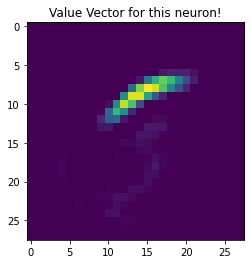

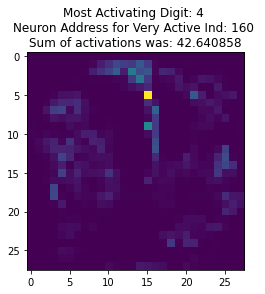

...

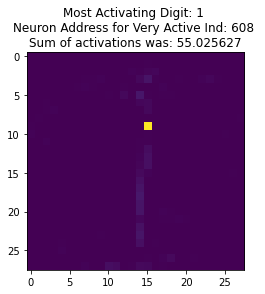

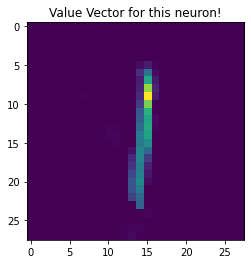

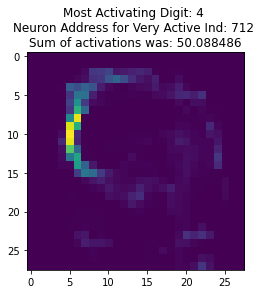

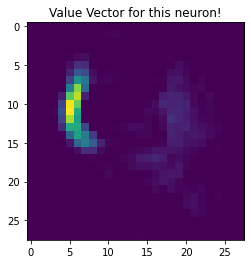

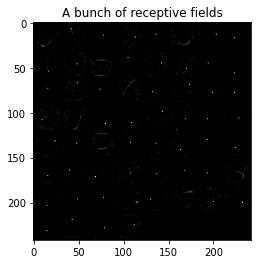

==================== K= 21 ===================
length of net parameters 2
[epoch, batch], [1,   250] loss: 0.000
mean actives 1000.0 1.0 % | max 1000 1.0 %
(128, 1000) shape of cosine sims


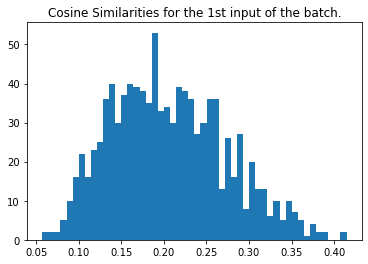

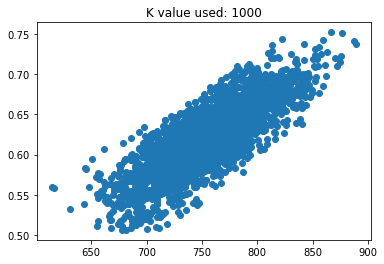

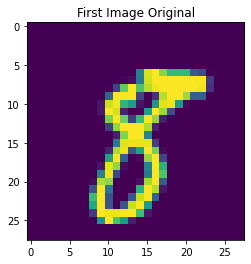

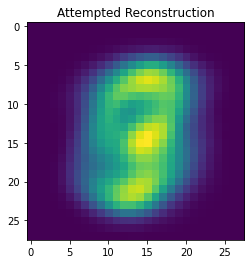

MSE loss for this input is:  0.0011415780350870015
train loss: 0.0009231923031620681 test loss: 0.0008977801189757884
[epoch, batch], [2,   250] loss: 0.000
mean actives 960.0 0.96 % | max 960 0.96 %
(128, 1000) shape of cosine sims


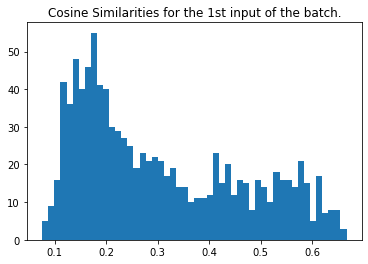

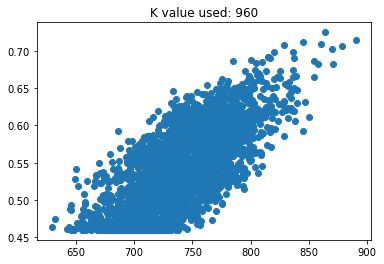

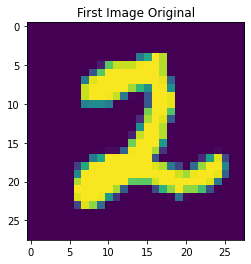

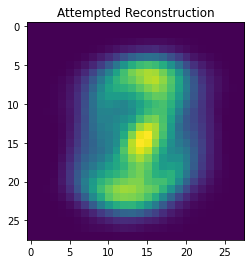

MSE loss for this input is:  0.0007973272277384388
train loss: 0.000780490052420646 test loss: 0.000779150752350688
[epoch, batch], [3,   250] loss: 0.000
mean actives 921.0 0.921 % | max 921 0.921 %
(128, 1000) shape of cosine sims


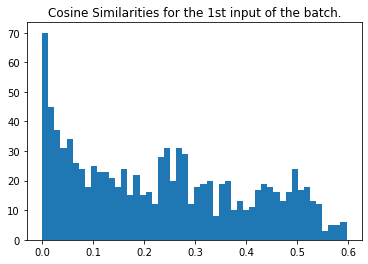

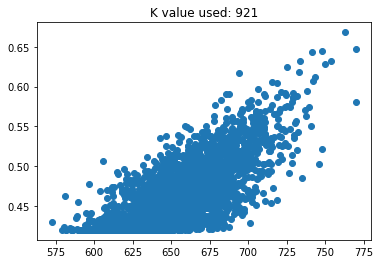

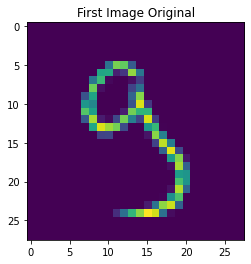

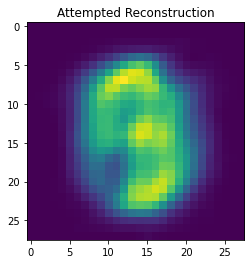

MSE loss for this input is:  0.0009253741222984937
train loss: 0.0006633630255237222 test loss: 0.000646027154289186
[epoch, batch], [4,   250] loss: 0.000
mean actives 882.0 0.882 % | max 882 0.882 %
(128, 1000) shape of cosine sims


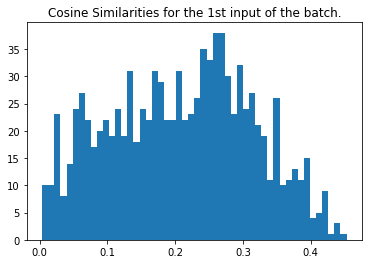

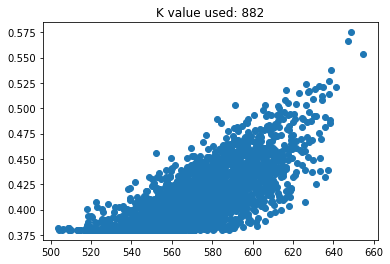

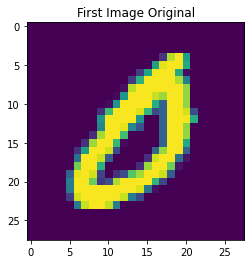

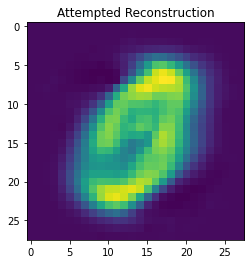

MSE loss for this input is:  0.0006243966671885277
train loss: 0.0005769762210547924 test loss: 0.0005638577858917415
[epoch, batch], [5,   250] loss: 0.000
mean actives 843.0 0.843 % | max 843 0.843 %
(128, 1000) shape of cosine sims


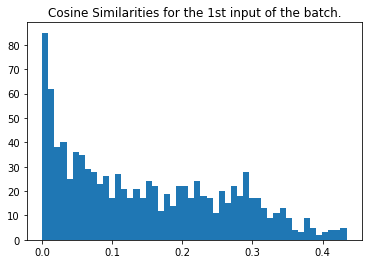

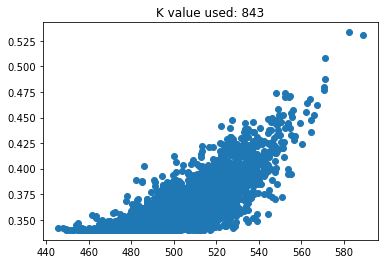

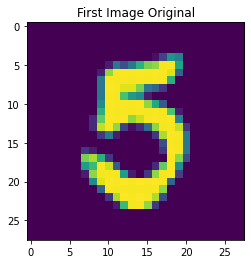

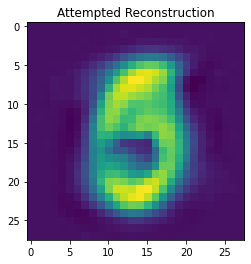

MSE loss for this input is:  0.0010025016203218577
train loss: 0.000539178668987006 test loss: 0.0004793986736331135
[epoch, batch], [6,   250] loss: 0.000
mean actives 804.0 0.804 % | max 804 0.804 %
(128, 1000) shape of cosine sims


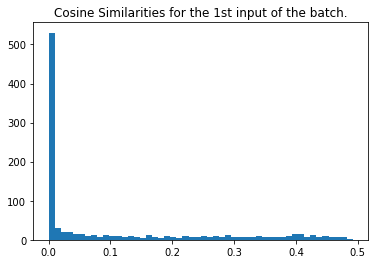

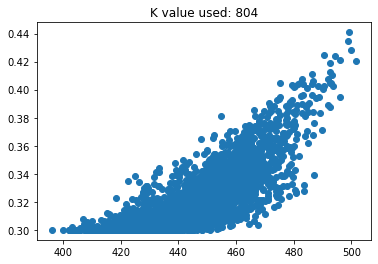

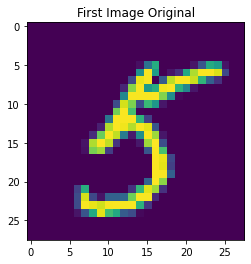

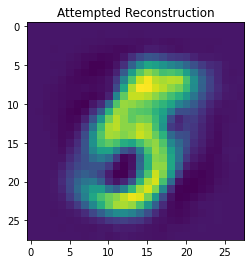

MSE loss for this input is:  0.0015033176358865232
train loss: 0.0004752181121148169 test loss: 0.0004307401832193136
[epoch, batch], [7,   250] loss: 0.000
mean actives 765.0 0.765 % | max 765 0.765 %
(128, 1000) shape of cosine sims


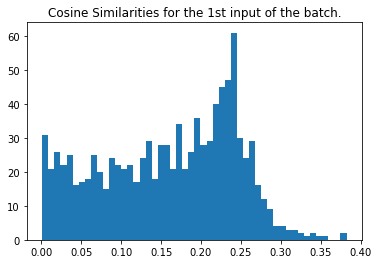

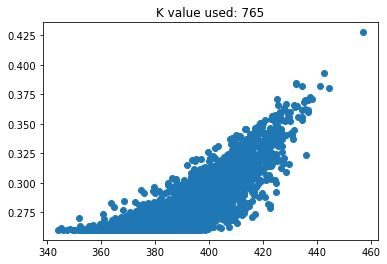

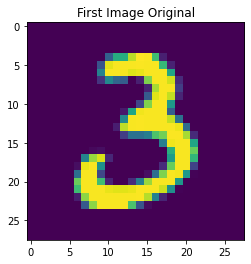

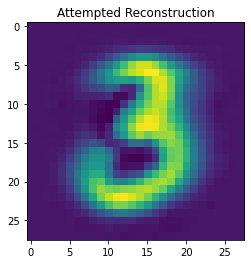

MSE loss for this input is:  0.0007392857603880824
train loss: 0.00040214211912825704 test loss: 0.0003837290860246867
[epoch, batch], [8,   250] loss: 0.000
mean actives 725.0 0.725 % | max 725 0.725 %
(128, 1000) shape of cosine sims


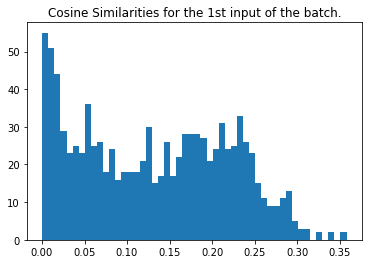

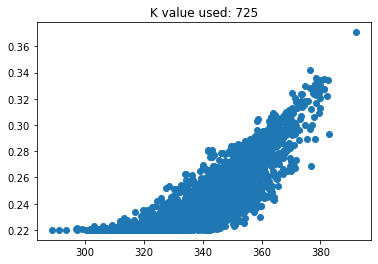

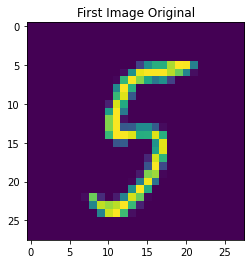

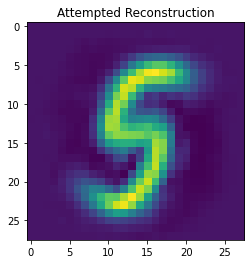

MSE loss for this input is:  0.000812976640097949
train loss: 0.00039037823444232345 test loss: 0.000316062563797459
[epoch, batch], [9,   250] loss: 0.000
mean actives 686.0 0.686 % | max 686 0.686 %
(128, 1000) shape of cosine sims


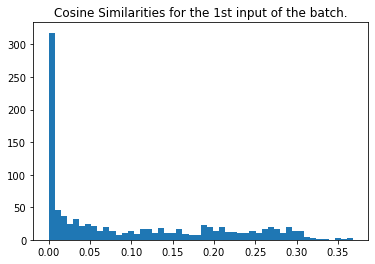

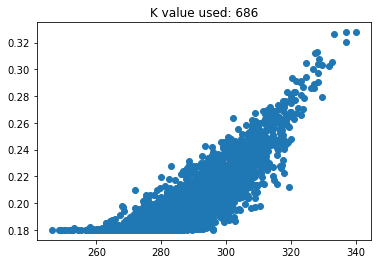

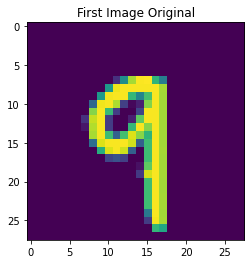

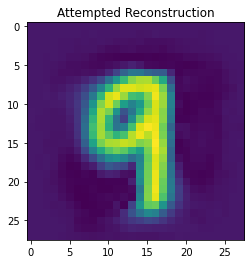

MSE loss for this input is:  0.0014587405080697974
train loss: 0.00030998600414022803 test loss: 0.00023990633781068027
[epoch, batch], [10,   250] loss: 0.000
mean actives 647.0 0.647 % | max 647 0.647 %
(128, 1000) shape of cosine sims


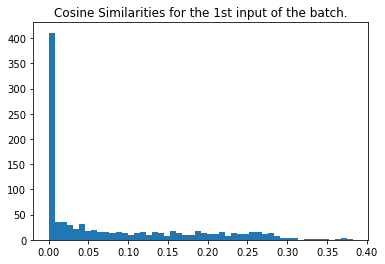

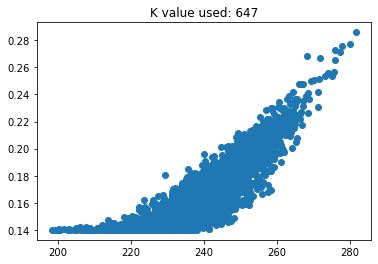

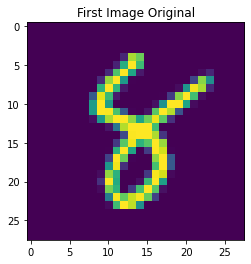

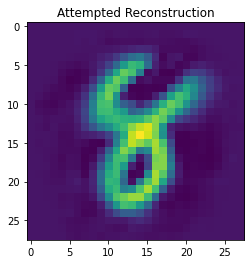

MSE loss for this input is:  0.001608165095047075
train loss: 0.00026215793332085013 test loss: 0.00021694807219319046
[epoch, batch], [11,   250] loss: 0.000
mean actives 608.0 0.608 % | max 608 0.608 %
(128, 1000) shape of cosine sims


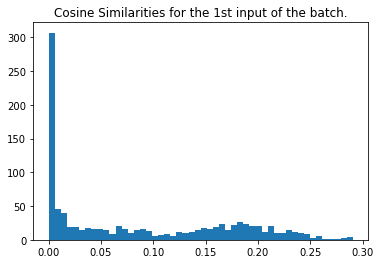

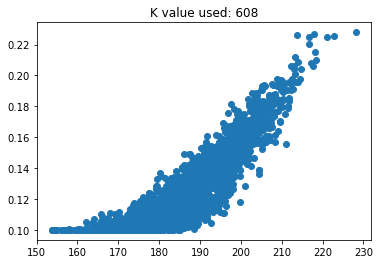

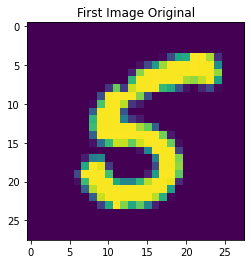

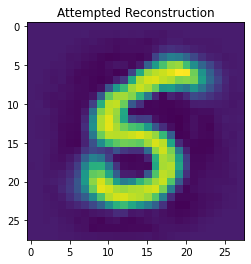

MSE loss for this input is:  0.0011820173537244601
train loss: 0.0001982796093216166 test loss: 0.000180777205969207
[epoch, batch], [12,   250] loss: 0.000
mean actives 569.0 0.569 % | max 569 0.569 %
(128, 1000) shape of cosine sims


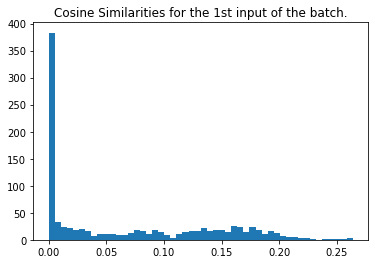

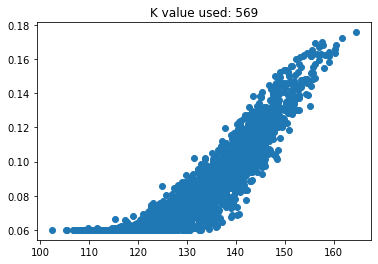

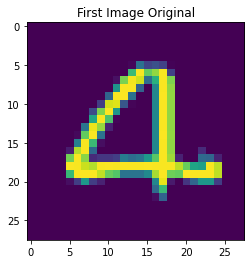

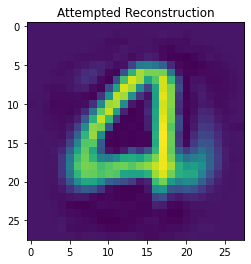

MSE loss for this input is:  0.0013863087004544784
train loss: 0.00014560158888343722 test loss: 0.00011950243060709909
[epoch, batch], [13,   250] loss: 0.000
mean actives 530.0 0.53 % | max 530 0.53 %
(128, 1000) shape of cosine sims


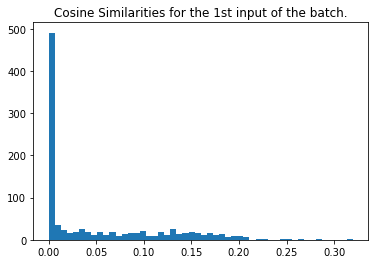

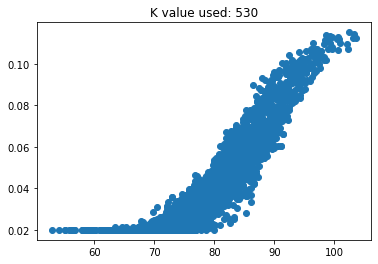

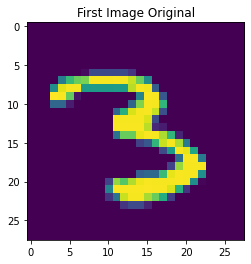

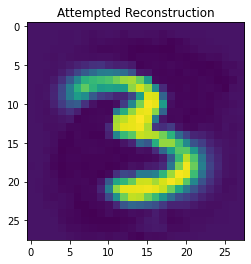

MSE loss for this input is:  0.0020277380030982346
train loss: 8.535833330824971e-05 test loss: 7.388795347651467e-05
[epoch, batch], [14,   250] loss: 0.000
mean actives 490.0 0.49 % | max 490 0.49 %
(128, 1000) shape of cosine sims


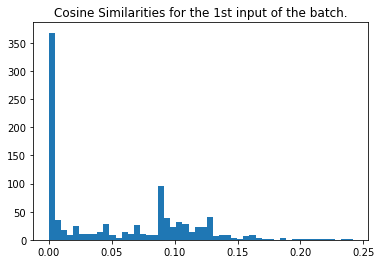

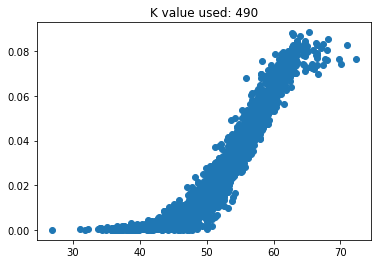

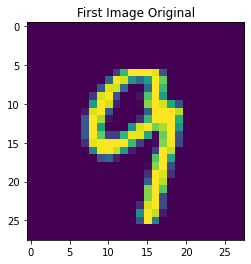

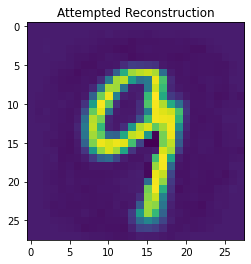

MSE loss for this input is:  0.0013768280647238906
train loss: 5.689490353688598e-05 test loss: 5.0075945182470605e-05
[epoch, batch], [15,   250] loss: 0.000
mean actives 451.0 0.451 % | max 451 0.451 %
(128, 1000) shape of cosine sims


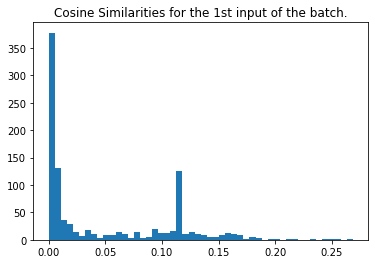

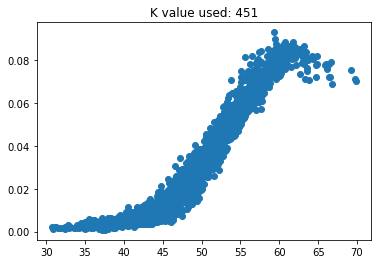

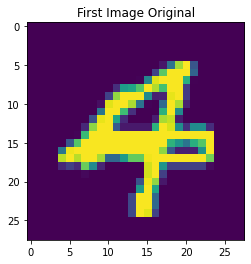

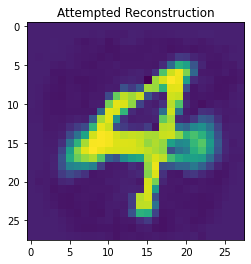

MSE loss for this input is:  0.0014883326936741264
train loss: 4.802460898645222e-05 test loss: 5.0305883632972836e-05
[epoch, batch], [16,   250] loss: 0.000
mean actives 412.0 0.412 % | max 412 0.412 %
(128, 1000) shape of cosine sims


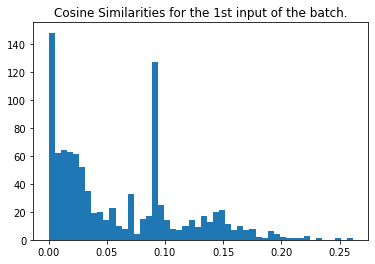

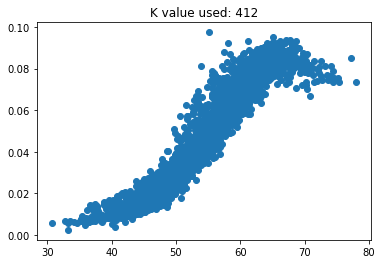

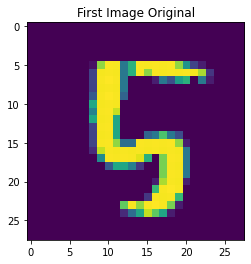

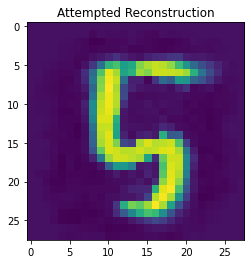

MSE loss for this input is:  0.0014981604656394646
train loss: 5.567730840994045e-05 test loss: 5.9674133808584884e-05
[epoch, batch], [17,   250] loss: 0.000
mean actives 373.0 0.373 % | max 373 0.373 %
(128, 1000) shape of cosine sims


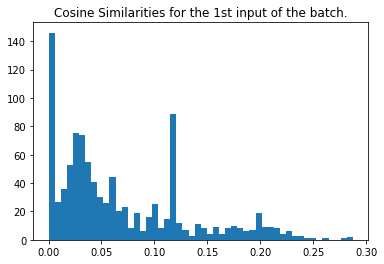

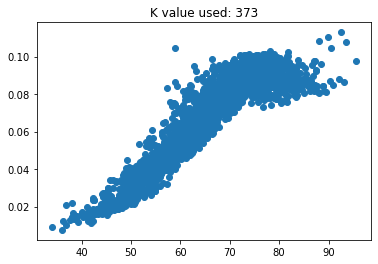

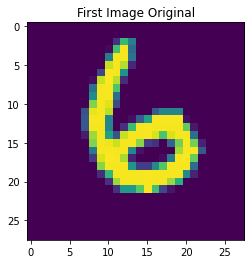

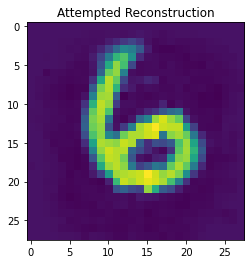

MSE loss for this input is:  0.0015511155432584335
train loss: 6.60951336612925e-05 test loss: 6.590792327187955e-05
[epoch, batch], [18,   250] loss: 0.000
mean actives 334.0 0.334 % | max 334 0.334 %
(128, 1000) shape of cosine sims


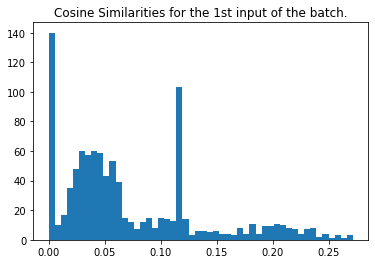

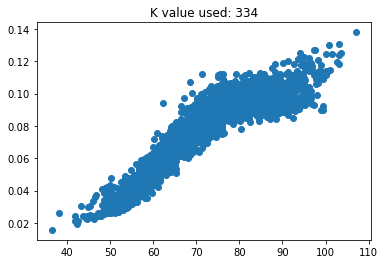

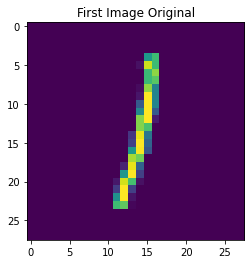

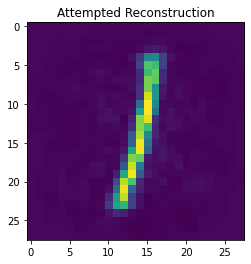

MSE loss for this input is:  0.001801679328996308
train loss: 7.03538753441535e-05 test loss: 7.251017086673528e-05
[epoch, batch], [19,   250] loss: 0.000
mean actives 295.0 0.295 % | max 295 0.295 %
(128, 1000) shape of cosine sims


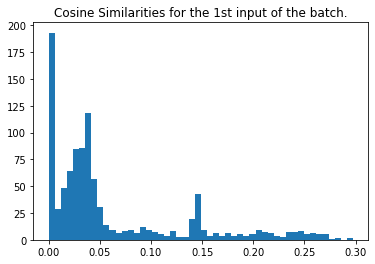

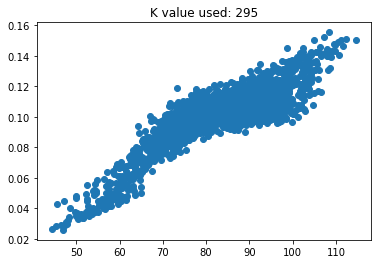

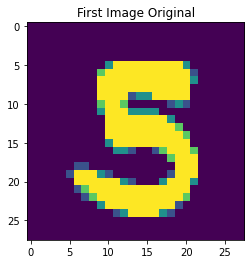

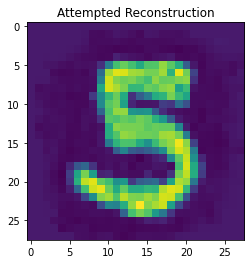

MSE loss for this input is:  0.001539655637984373
train loss: 7.177190127549693e-05 test loss: 7.509789429605007e-05
[epoch, batch], [20,   250] loss: 0.000
mean actives 255.0 0.255 % | max 255 0.255 %
(128, 1000) shape of cosine sims


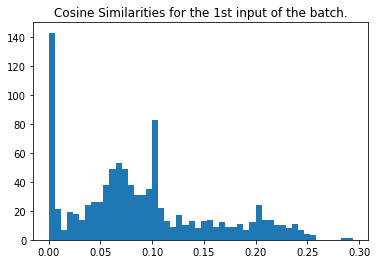

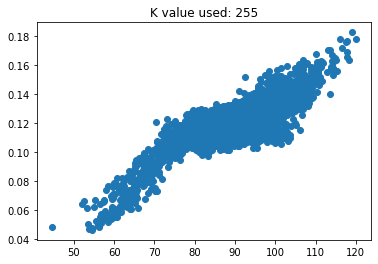

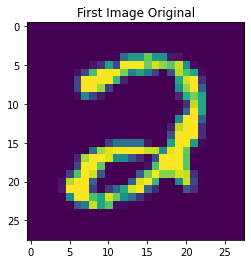

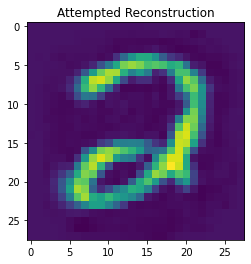

MSE loss for this input is:  0.0015779818807329451
train loss: 6.330110045382753e-05 test loss: 6.78164724376984e-05
[epoch, batch], [21,   250] loss: 0.000
mean actives 216.0 0.216 % | max 216 0.216 %
(128, 1000) shape of cosine sims


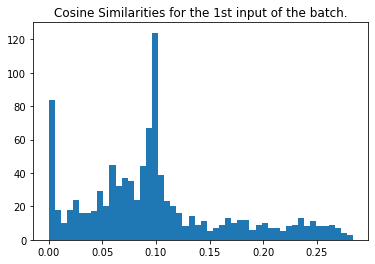

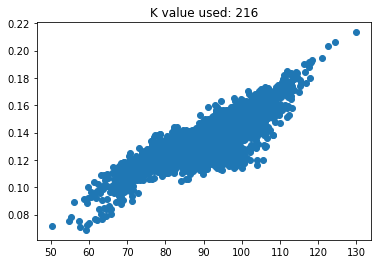

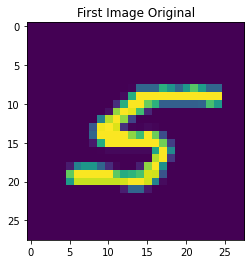

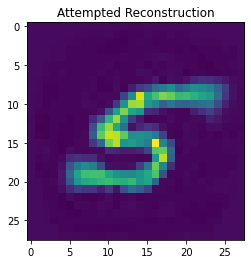

MSE loss for this input is:  0.0016379643763814653
train loss: 6.214694440132007e-05 test loss: 6.529274105560035e-05
[epoch, batch], [22,   250] loss: 0.000
mean actives 177.0 0.177 % | max 177 0.177 %
(128, 1000) shape of cosine sims


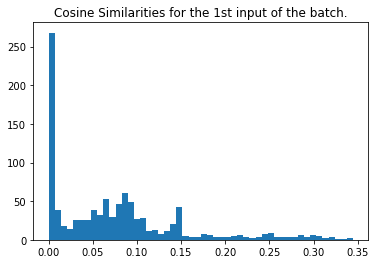

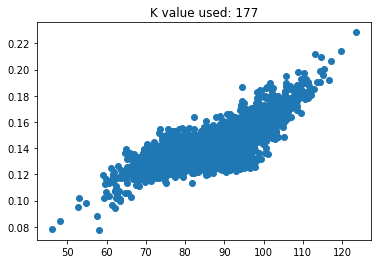

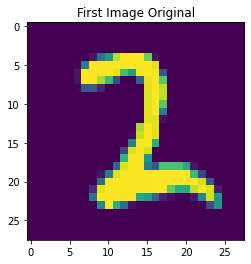

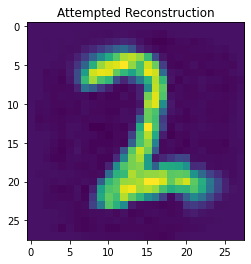

MSE loss for this input is:  0.001133943318712468
train loss: 5.999958739266731e-05 test loss: 6.914146069902927e-05
[epoch, batch], [23,   250] loss: 0.000
mean actives 138.0 0.138 % | max 138 0.138 %
(128, 1000) shape of cosine sims


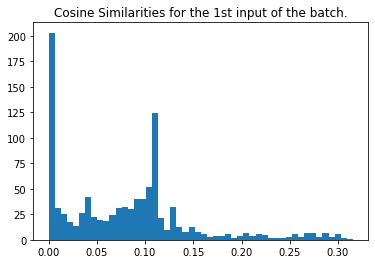

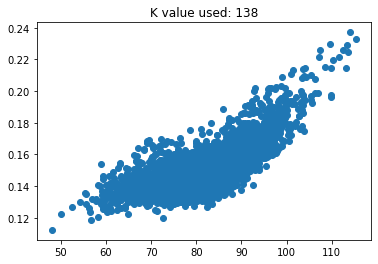

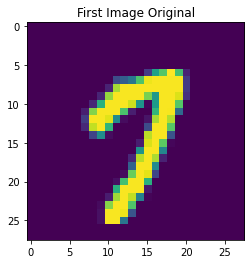

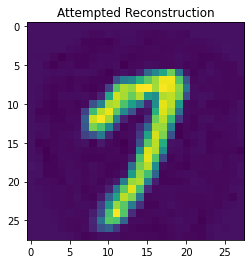

MSE loss for this input is:  0.0015491596898254082
train loss: 6.730147288180888e-05 test loss: 6.863661110401154e-05
[epoch, batch], [24,   250] loss: 0.000
mean actives 99.0 0.099 % | max 99 0.099 %
(128, 1000) shape of cosine sims


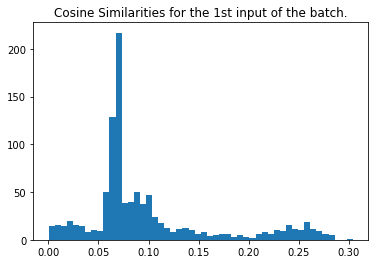

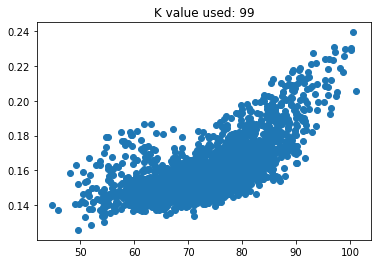

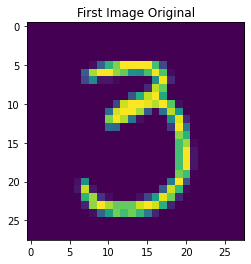

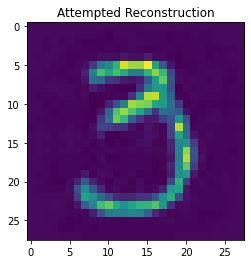

MSE loss for this input is:  0.0013899745381608301
train loss: 7.688110054004937e-05 test loss: 8.151630754582584e-05
[epoch, batch], [25,   250] loss: 0.000
mean actives 60.0 0.06 % | max 60 0.06 %
(128, 1000) shape of cosine sims


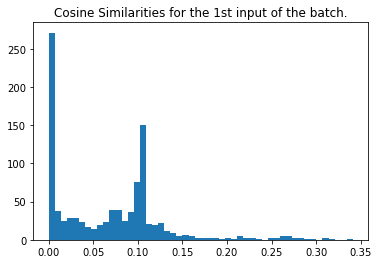

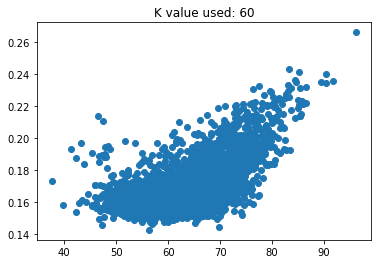

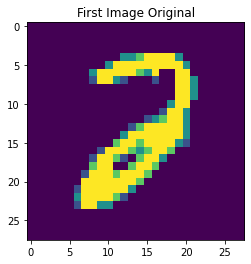

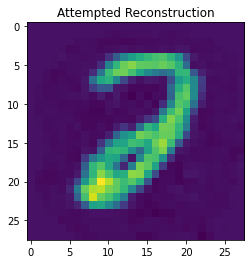

MSE loss for this input is:  0.0014358825829564308
train loss: 0.00010324933100491762 test loss: 0.0001022682263283059
[epoch, batch], [26,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


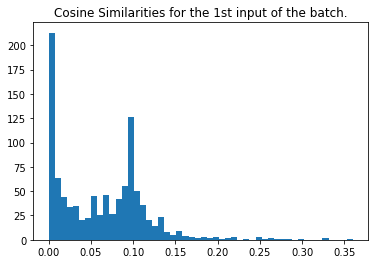

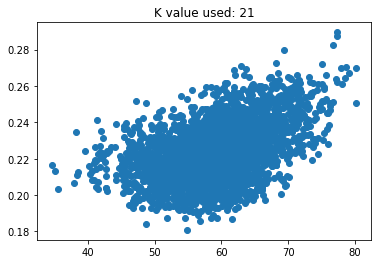

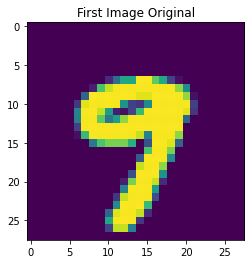

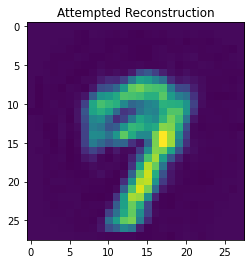

MSE loss for this input is:  0.0012311564416301493
train loss: 0.00020729420066345483 test loss: 0.00019612429605331272
[epoch, batch], [27,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


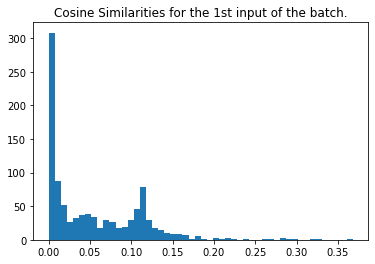

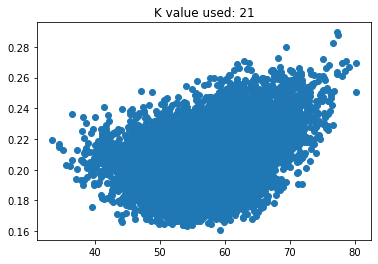

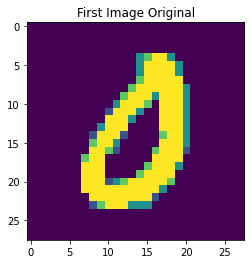

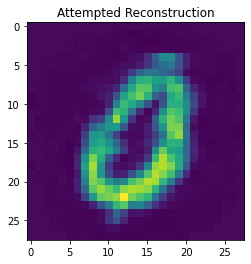

MSE loss for this input is:  0.0011093709997984829
train loss: 0.00019030638213735074 test loss: 0.00020134316582698375
[epoch, batch], [28,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


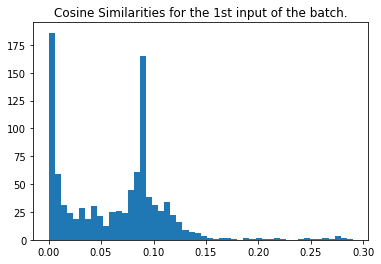

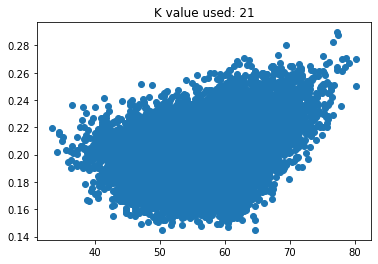

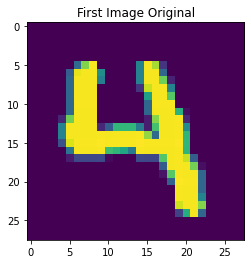

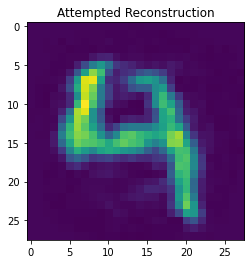

MSE loss for this input is:  0.0018034122732220863
train loss: 0.00019865136709995568 test loss: 0.00019097367476206273
[epoch, batch], [29,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


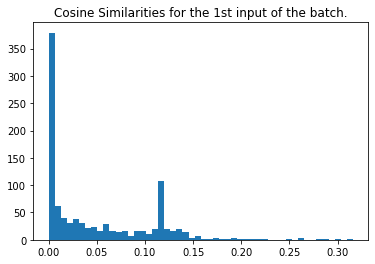

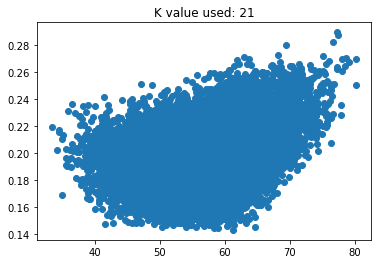

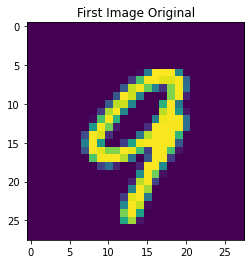

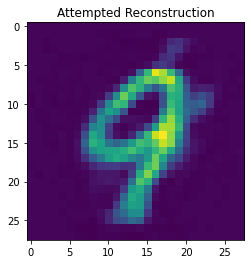

MSE loss for this input is:  0.0016657428777947718
train loss: 0.0001946926349774003 test loss: 0.00019694556249305606
[epoch, batch], [30,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


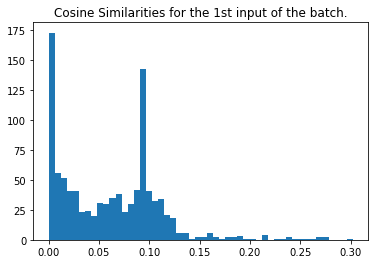

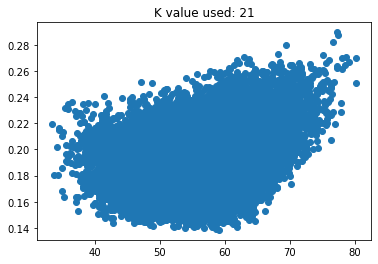

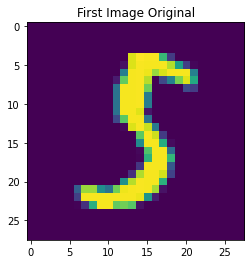

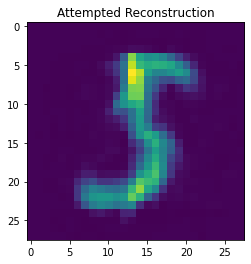

MSE loss for this input is:  0.0014239320037316304
train loss: 0.00018123899644706398 test loss: 0.00018594828725326806
[epoch, batch], [31,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


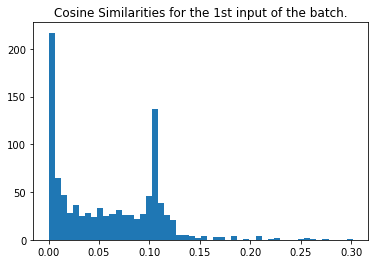

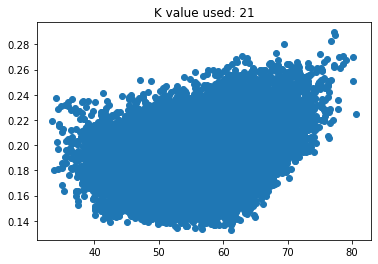

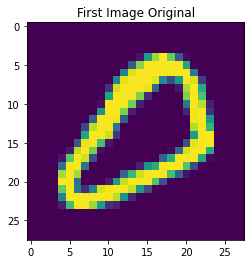

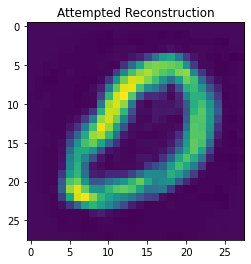

MSE loss for this input is:  0.0013879107273354822
train loss: 0.00019216233340557665 test loss: 0.000182073941687122
[epoch, batch], [32,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


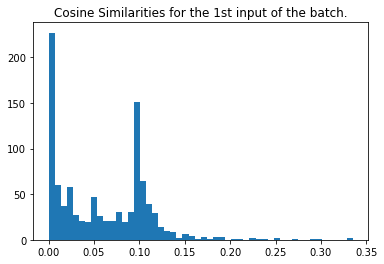

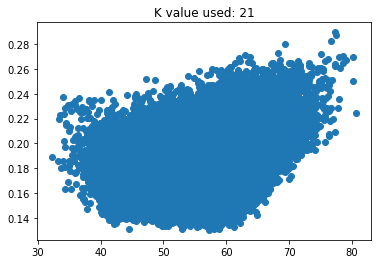

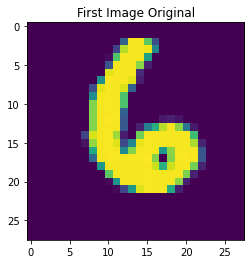

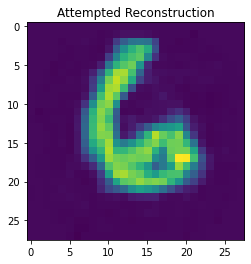

MSE loss for this input is:  0.0011511982551642827
train loss: 0.00018108075892087072 test loss: 0.0001854954898590222
[epoch, batch], [33,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


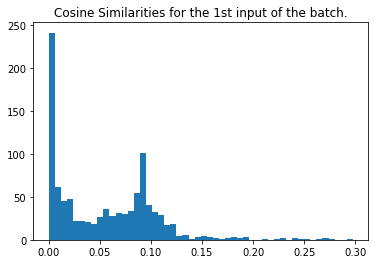

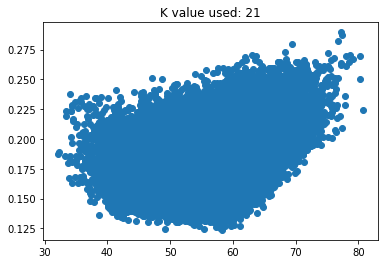

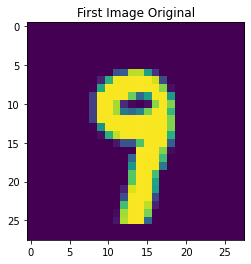

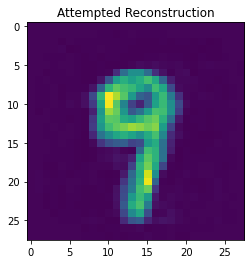

MSE loss for this input is:  0.0019359970275236635
train loss: 0.00017654342809692025 test loss: 0.0001740422158036381
[epoch, batch], [34,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


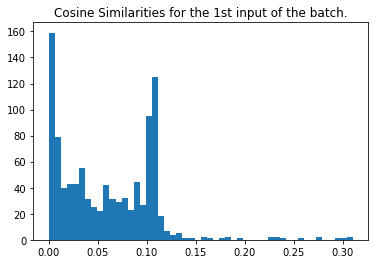

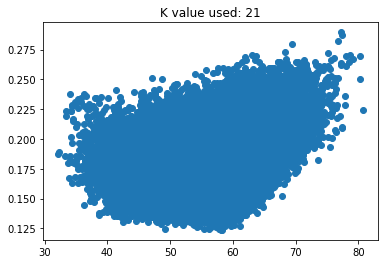

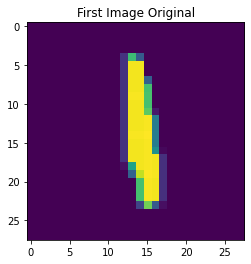

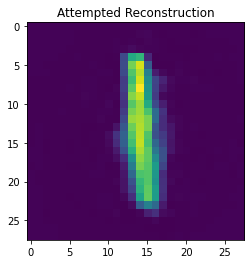

MSE loss for this input is:  0.0014651571305430665
train loss: 0.00017992666107602417 test loss: 0.00017872080206871033
[epoch, batch], [35,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


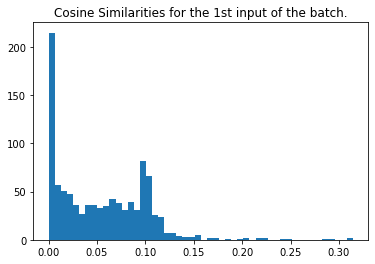

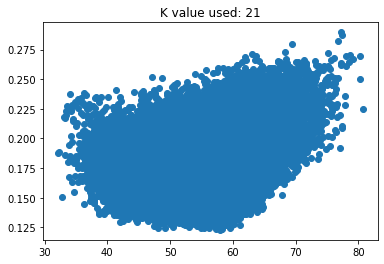

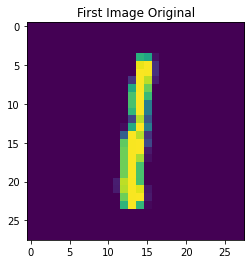

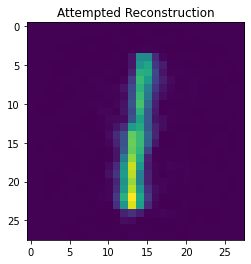

MSE loss for this input is:  0.001713695118621904
train loss: 0.0001688737829681486 test loss: 0.00017369592387694865
[epoch, batch], [36,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


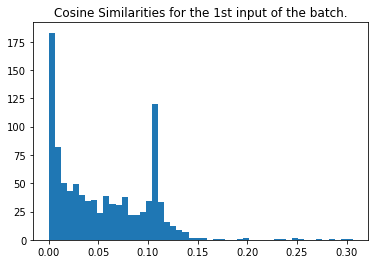

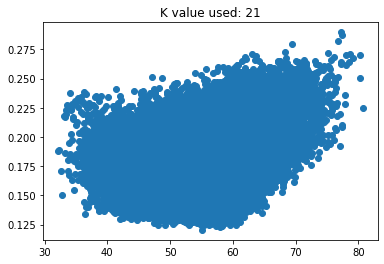

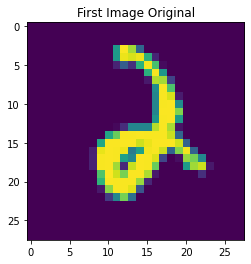

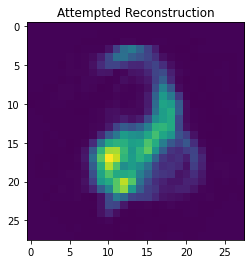

MSE loss for this input is:  0.0014496228220511455
train loss: 0.0001905217650346458 test loss: 0.00016642019909340888
[epoch, batch], [37,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


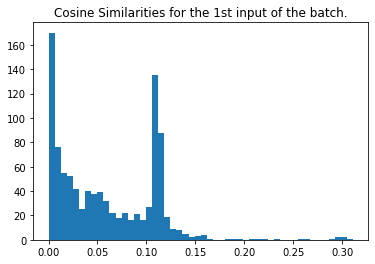

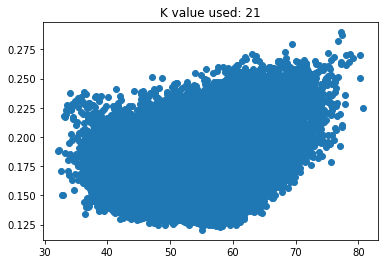

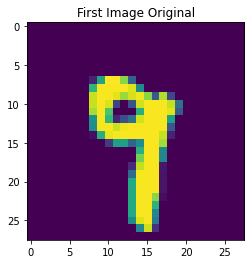

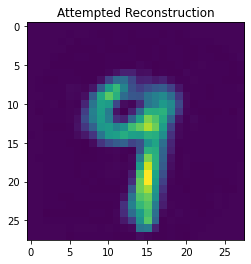

MSE loss for this input is:  0.0006781896310193199
train loss: 0.00018300657393410802 test loss: 0.00018422838184051216
[epoch, batch], [38,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


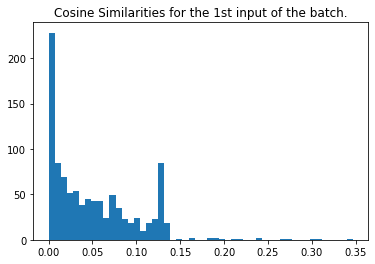

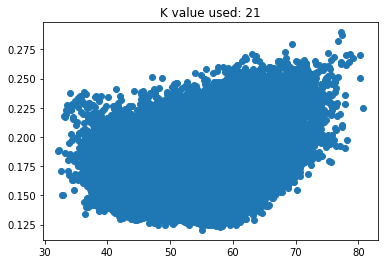

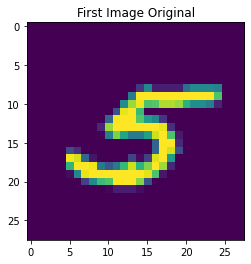

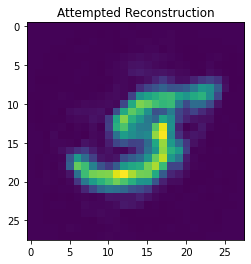

MSE loss for this input is:  0.0017313453920033512
train loss: 0.00017845207185018808 test loss: 0.0001733230019453913
[epoch, batch], [39,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


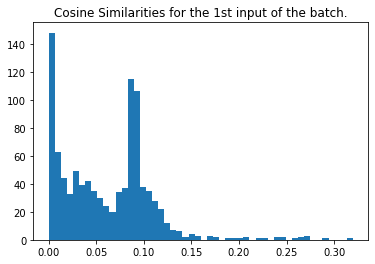

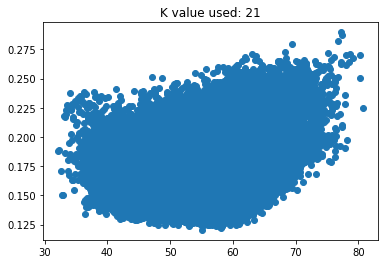

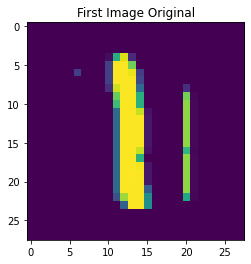

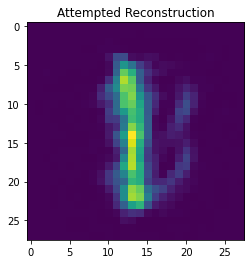

MSE loss for this input is:  0.0016970296903532378
train loss: 0.0001822032791096717 test loss: 0.0001672440121183172
[epoch, batch], [40,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


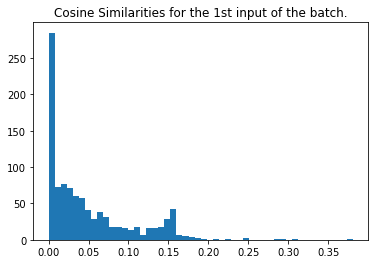

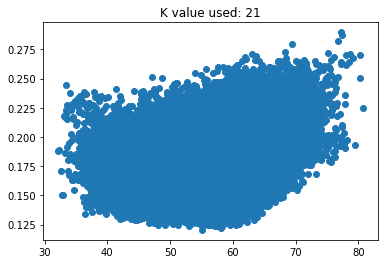

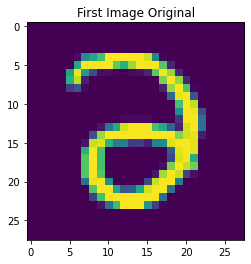

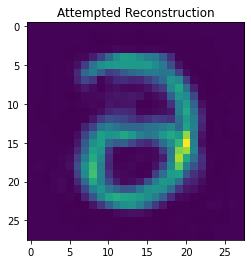

MSE loss for this input is:  0.0018910967877932958
train loss: 0.0001746869966154918 test loss: 0.00017323350766673684
Finished Training


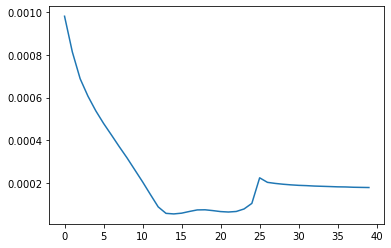

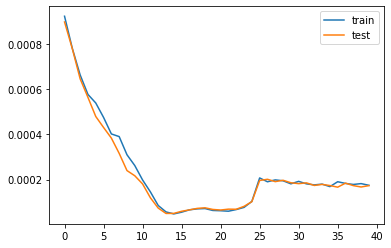

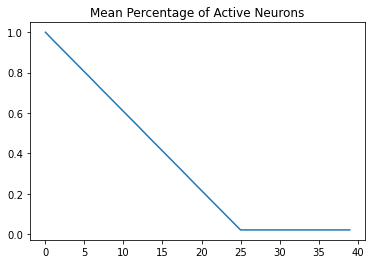

Latents and Labels dimensions: (60000, 1000) (60000,)
Latents and Labels dimensions: (10000, 1000) (10000,)
Logistic regression accuracy: Train= 0.892 | Test= 0.898


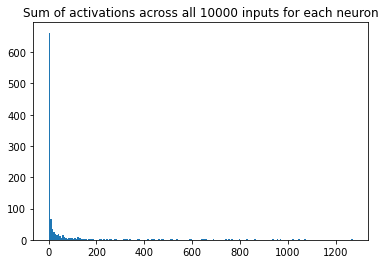

[662.  65.  33.  24.  17.  15.  18.  13.   6.  14.   8.   6.   4.   7.
   5.   6.   3.   5.   3.   8.   5.   1.   3.   4.   4.   0.   1.   2.
   2.   2.   0.   0.   0.   2.   2.   0.   2.   0.   1.   0.   1.   1.
   0.   1.   1.   0.   0.   0.   0.   1.   3.   2.   0.   1.   0.   0.
   0.   0.   2.   1.   0.   0.   0.   0.   0.   1.   0.   1.   1.   1.
   0.   0.   1.   0.   2.   1.   0.   0.   0.   0.   1.   1.   0.   0.
   1.   0.   0.   0.   0.   0.   0.   0.   1.   1.   0.   0.   0.   0.
   0.   0.   1.   1.   1.   1.   0.   0.   0.   0.   1.   0.   0.   0.
   0.   0.   0.   0.   1.   0.   1.   0.   1.   0.   0.   0.   0.   1.
   0.   0.   0.   0.   1.   0.   0.   0.   0.   1.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   1.   0.   0.   1.   0.   1.   0.
   0.   0.   0.   0.   0.   0.   1.   0.   0.   0.   2.   0.   0.   0.
   1.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0. 

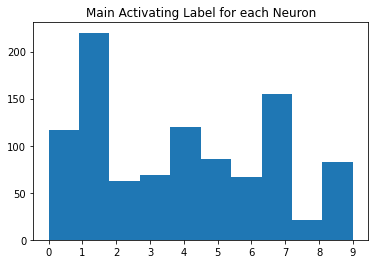

Neuron addresses should be 1000x784!!! (1000, 784) (1000, 784)
Euclidian distance


,0,1,2,3,4,5,6,7,8,9
0,0.000000,0.026527,0.036293,0.038918,0.025787,0.029749,0.045834,0.028196,0.073817,0.035087
1,0.026527,0.000000,0.044198,0.042882,0.032052,0.036471,0.049241,0.029907,0.082512,0.034535
2,0.036293,0.044198,0.000000,0.043505,0.046357,0.042145,0.051238,0.045233,0.079027,0.051976
3,0.038918,0.042882,0.043505,0.000000,0.045665,0.039706,0.064239,0.043147,0.068255,0.051923
4,0.025787,0.032052,0.046357,0.045665,0.000000,0.033176,0.050818,0.030282,0.081631,0.035045
5,0.029749,0.036471,0.042145,0.039706,0.033176,0.000000,0.057570,0.033898,0.064320,0.041108
6,0.045834,0.049241,0.051238,0.064239,0.050818,0.057570,0.000000,0.056496,0.096150,0.059711
7,0.028196,0.029907,0.045233,0.043147,0.030282,0.033898,0.056496,0.000000,0.076806,0.033817
8,0.073817,0.082512,0.079027,0.068255,0.081631,0.064320,0.096150,0.076806,0.000000,0.084234
9,0.035087,0.034535,0.051976,0.051923,0.035045,0.041108,0.059711,0.033817,0.084234,0.000000


cosine similarity


,0,1,2,3,4,5,6,7,8,9
0,1.000000,0.526427,0.645708,0.598288,0.584881,0.631697,0.566541,0.593519,0.563375,0.521002
1,0.526427,1.000000,0.540732,0.534701,0.423085,0.514141,0.513456,0.530591,0.486170,0.490435
2,0.645708,0.540732,1.000000,0.640323,0.530330,0.618002,0.599688,0.562191,0.555669,0.505928
3,0.598288,0.534701,0.640323,1.000000,0.518809,0.629478,0.487608,0.568385,0.618726,0.490558
4,0.584881,0.423085,0.530330,0.518809,1.000000,0.585868,0.510889,0.561588,0.495903,0.520052
5,0.631697,0.514141,0.618002,0.629478,0.585868,1.000000,0.497519,0.602702,0.636485,0.534677
6,0.566541,0.513456,0.599688,0.487608,0.510889,0.497519,1.000000,0.473772,0.461377,0.456221
7,0.593519,0.530591,0.562191,0.568385,0.561588,0.602702,0.473772,1.000000,0.540034,0.572546
8,0.563375,0.486170,0.555669,0.618726,0.495903,0.636485,0.461377,0.540034,1.000000,0.487274
9,0.521002,0.490435,0.505928,0.490558,0.520052,0.534677,0.456221,0.572546,0.487274,1.000000


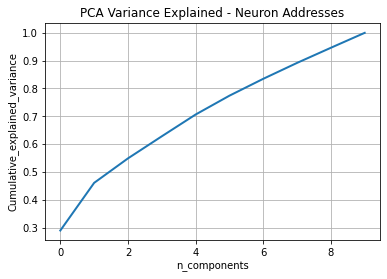

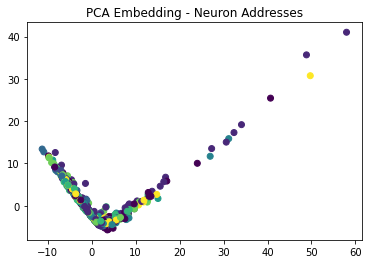

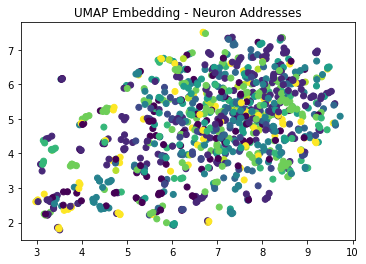

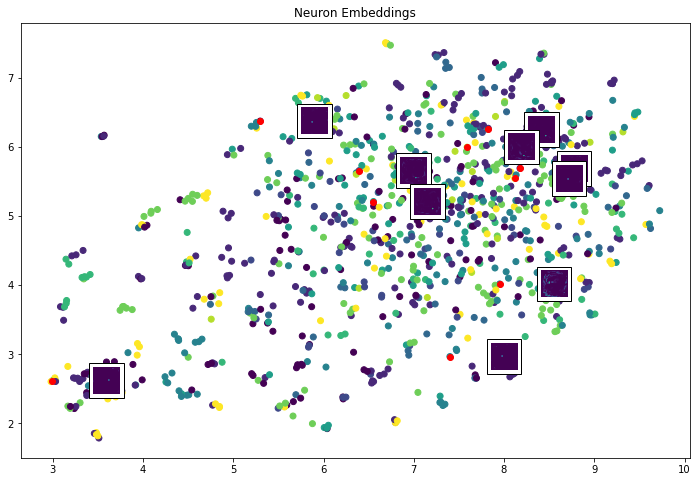

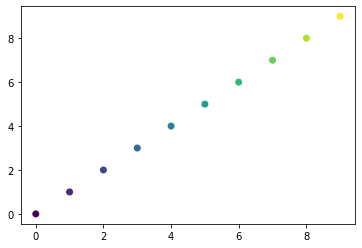

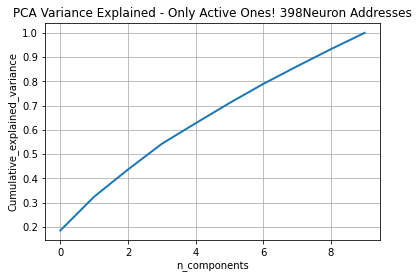

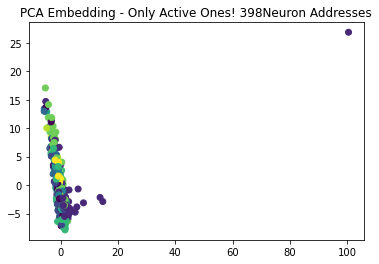

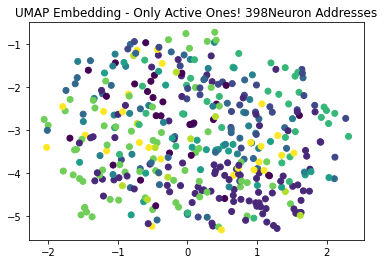

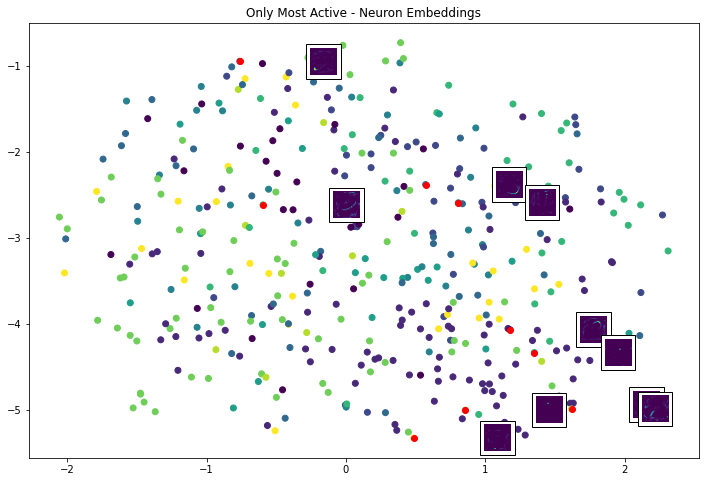

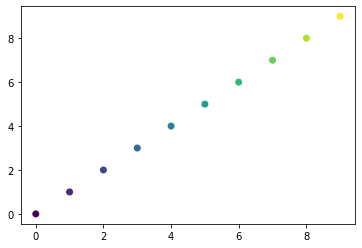

Giving some random plots from the most active neurons


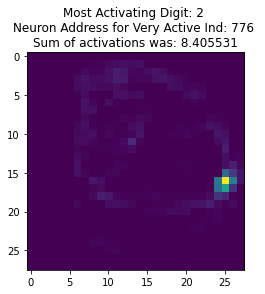

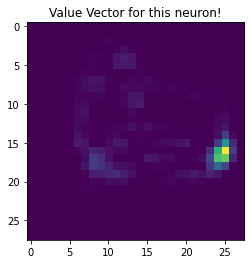

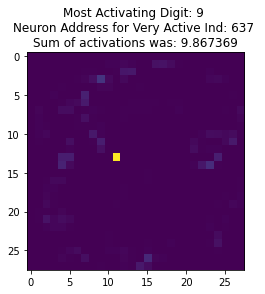

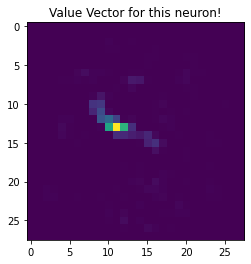

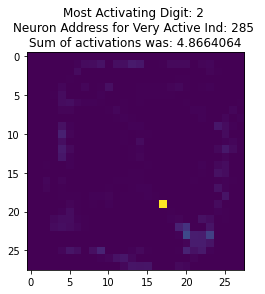

...

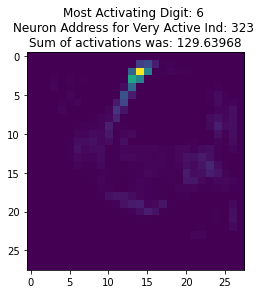

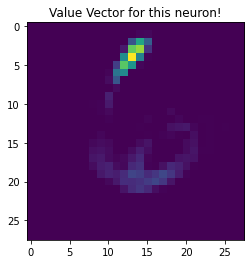

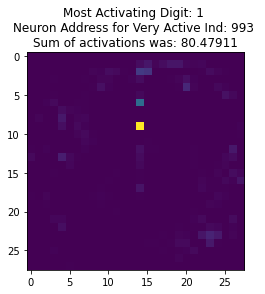

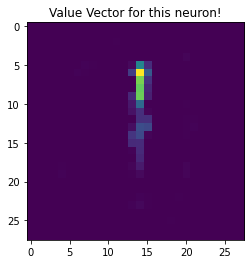

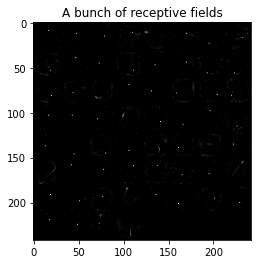

length of net parameters 2
[epoch, batch], [1,   250] loss: 0.000
mean actives 1000.0 1.0 % | max 1000 1.0 %
(128, 1000) shape of cosine sims


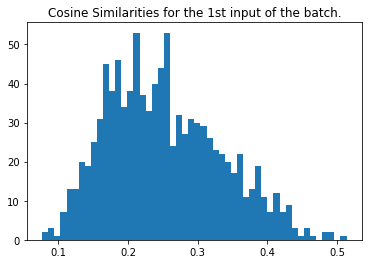

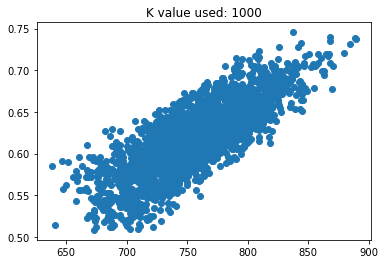

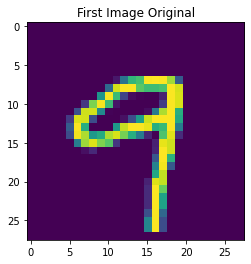

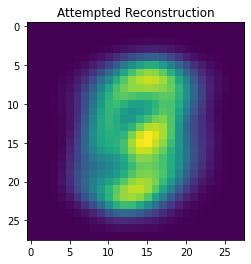

MSE loss for this input is:  0.0013179865722753564
train loss: 0.0009387307218275964 test loss: 0.0008986506145447493
[epoch, batch], [2,   250] loss: 0.000
mean actives 960.0 0.96 % | max 960 0.96 %
(128, 1000) shape of cosine sims


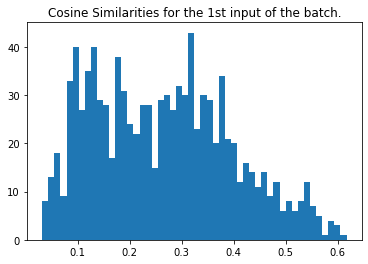

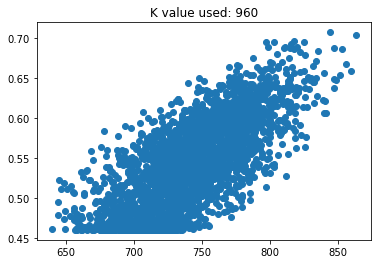

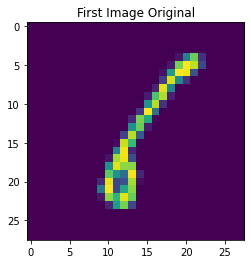

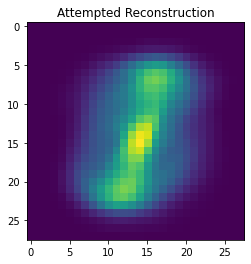

MSE loss for this input is:  0.0009563312086523796
train loss: 0.0007615543436259031 test loss: 0.0007575206109322608
[epoch, batch], [3,   250] loss: 0.000
mean actives 921.0 0.921 % | max 921 0.921 %
(128, 1000) shape of cosine sims


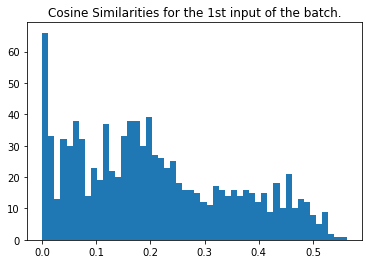

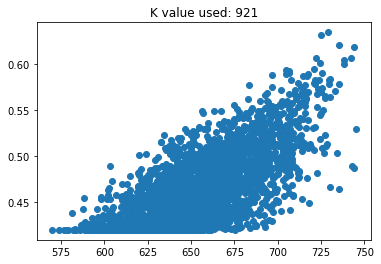

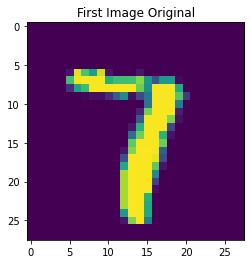

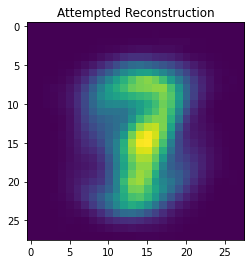

MSE loss for this input is:  0.000997360947788978
train loss: 0.0006991203408688307 test loss: 0.0006380626000463963
[epoch, batch], [4,   250] loss: 0.000
mean actives 882.0 0.882 % | max 882 0.882 %
(128, 1000) shape of cosine sims


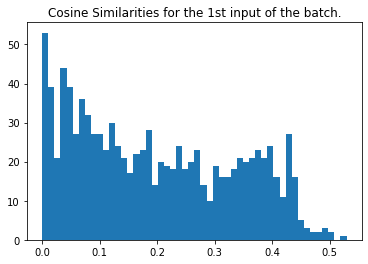

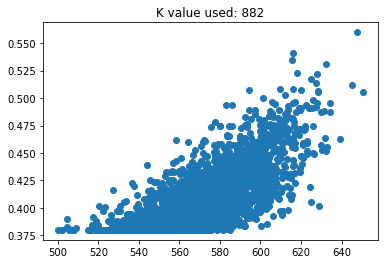

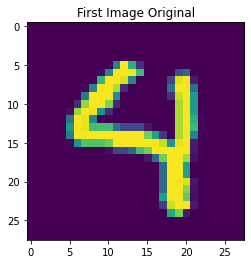

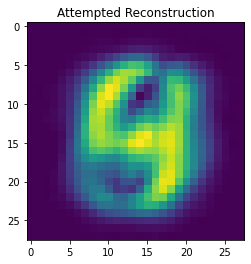

MSE loss for this input is:  0.0005232072150220677
train loss: 0.0005848339642398059 test loss: 0.0005727262469008565
[epoch, batch], [5,   250] loss: 0.000
mean actives 843.0 0.843 % | max 843 0.843 %
(128, 1000) shape of cosine sims


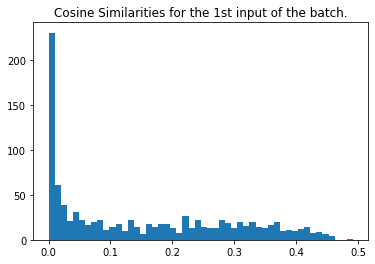

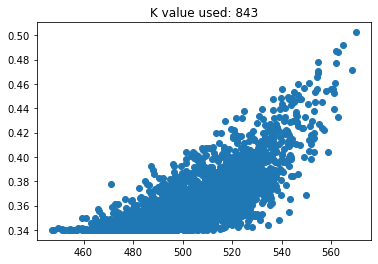

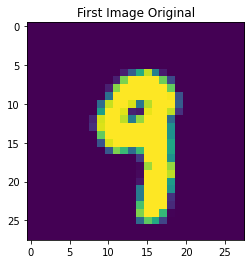

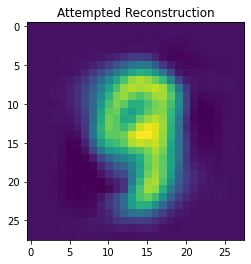

MSE loss for this input is:  0.0010107602087818847
train loss: 0.0005383125972002745 test loss: 0.0004884586669504642
[epoch, batch], [6,   250] loss: 0.000
mean actives 804.0 0.804 % | max 804 0.804 %
(128, 1000) shape of cosine sims


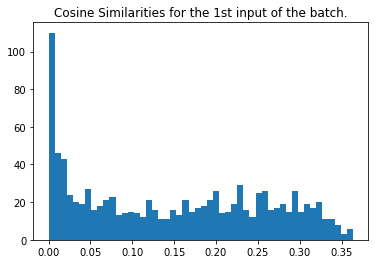

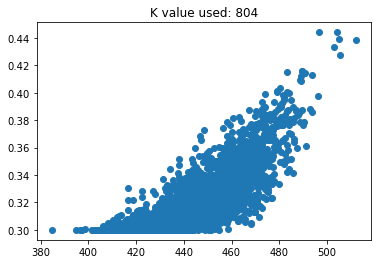

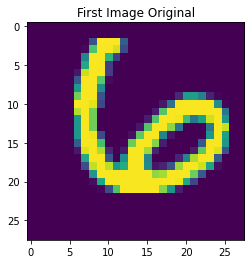

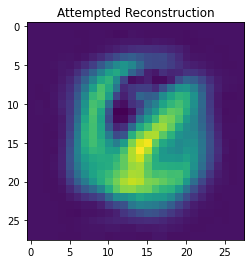

MSE loss for this input is:  0.0009413042999043757
train loss: 0.0004755998670589179 test loss: 0.0004274653038010001
[epoch, batch], [7,   250] loss: 0.000
mean actives 765.0 0.765 % | max 765 0.765 %
(128, 1000) shape of cosine sims


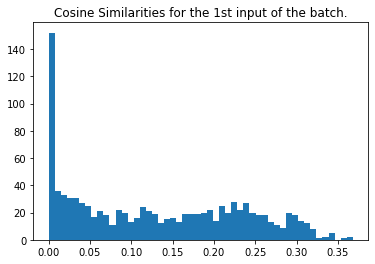

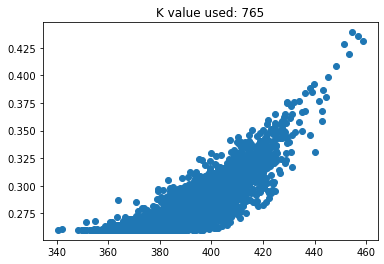

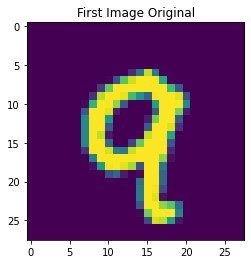

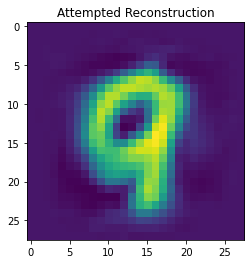

MSE loss for this input is:  0.001129615215622649
train loss: 0.00041055140900425613 test loss: 0.0003594262234400958
[epoch, batch], [8,   250] loss: 0.000
mean actives 725.0 0.725 % | max 725 0.725 %
(128, 1000) shape of cosine sims


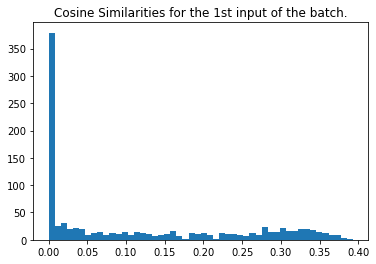

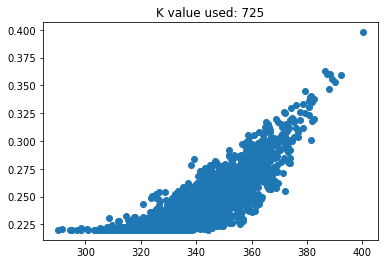

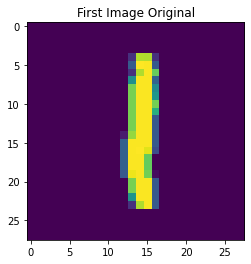

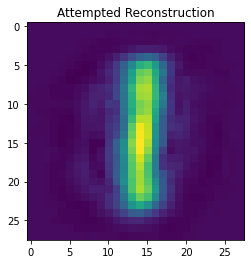

MSE loss for this input is:  0.0006797132747513908
train loss: 0.00034823454916477203 test loss: 0.0003427747287787497
[epoch, batch], [9,   250] loss: 0.000
mean actives 686.0 0.686 % | max 686 0.686 %
(128, 1000) shape of cosine sims


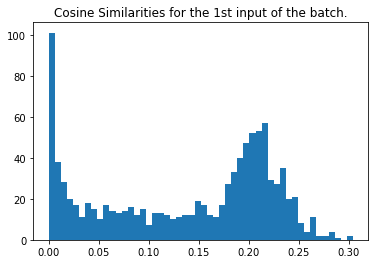

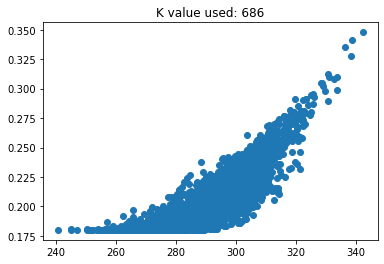

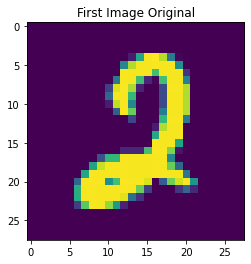

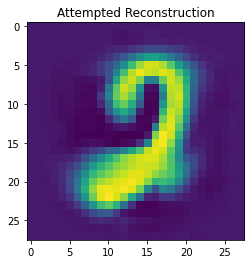

MSE loss for this input is:  0.0007196499833038875
train loss: 0.0003170807322021574 test loss: 0.0002466177975293249
[epoch, batch], [10,   250] loss: 0.000
mean actives 647.0 0.647 % | max 647 0.647 %
(128, 1000) shape of cosine sims


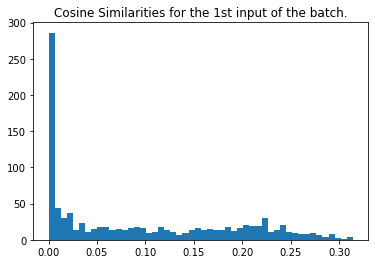

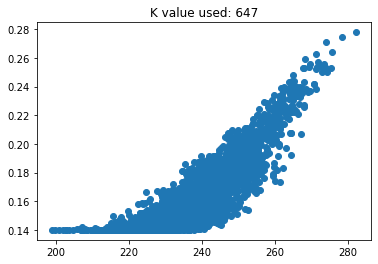

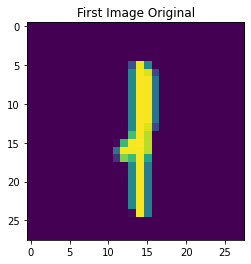

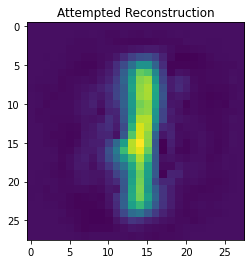

MSE loss for this input is:  0.0013951298837759057
train loss: 0.00025109731359407306 test loss: 0.00022343770251609385
[epoch, batch], [11,   250] loss: 0.000
mean actives 608.0 0.608 % | max 608 0.608 %
(128, 1000) shape of cosine sims


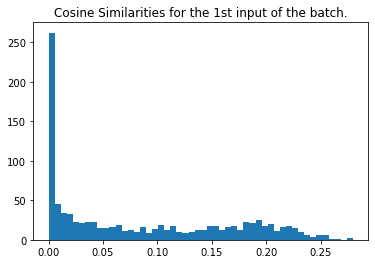

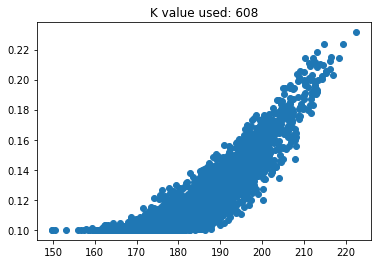

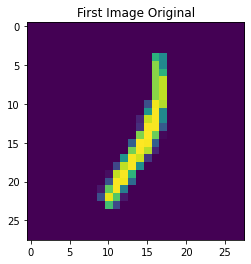

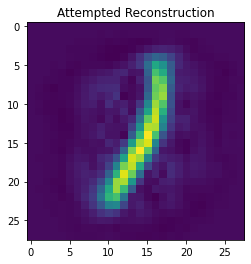

MSE loss for this input is:  0.0015359917769626696
train loss: 0.0001859107578638941 test loss: 0.00016583620163146406
[epoch, batch], [12,   250] loss: 0.000
mean actives 569.0 0.569 % | max 569 0.569 %
(128, 1000) shape of cosine sims


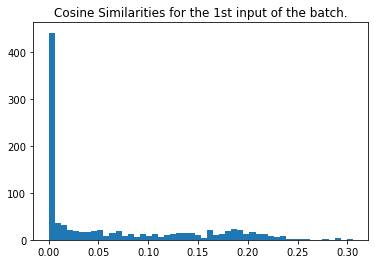

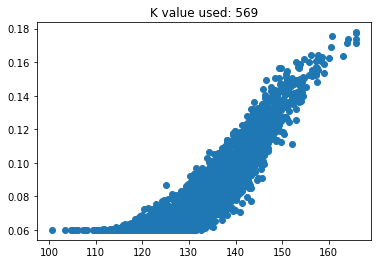

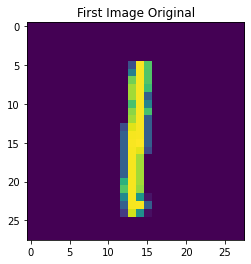

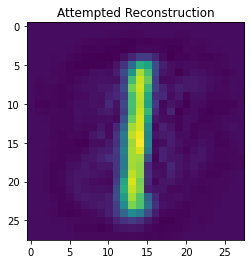

MSE loss for this input is:  0.0012760775125756556
train loss: 0.00013262624270282686 test loss: 0.0001241542777279392
[epoch, batch], [13,   250] loss: 0.000
mean actives 530.0 0.53 % | max 530 0.53 %
(128, 1000) shape of cosine sims


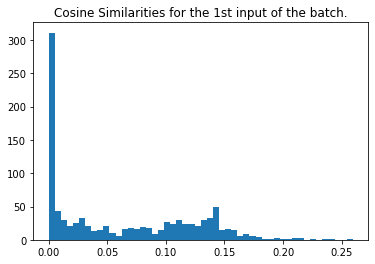

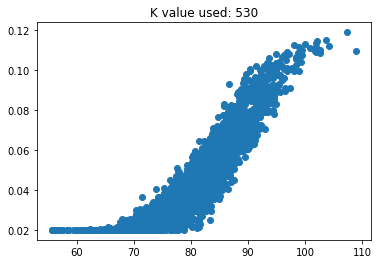

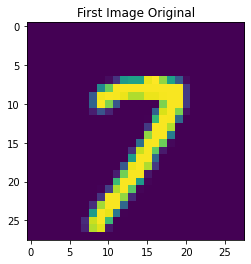

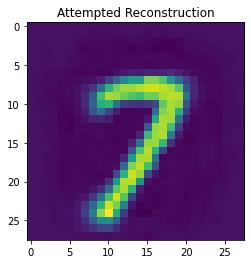

MSE loss for this input is:  0.0014334092943035827
train loss: 8.036715735215694e-05 test loss: 7.272248330991715e-05
[epoch, batch], [14,   250] loss: 0.000
mean actives 490.0 0.49 % | max 490 0.49 %
(128, 1000) shape of cosine sims


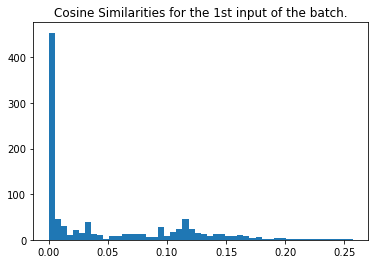

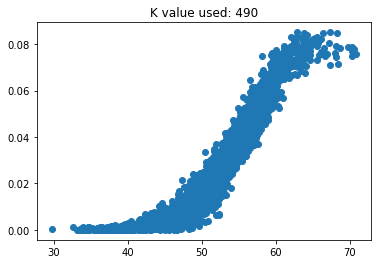

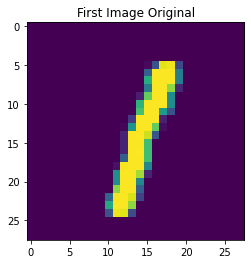

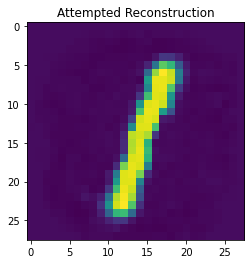

MSE loss for this input is:  0.0015071295962041738
train loss: 5.231442264630459e-05 test loss: 5.0898801418952644e-05
[epoch, batch], [15,   250] loss: 0.000
mean actives 451.0 0.451 % | max 451 0.451 %
(128, 1000) shape of cosine sims


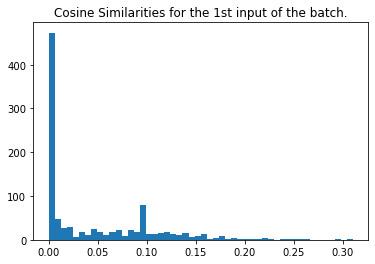

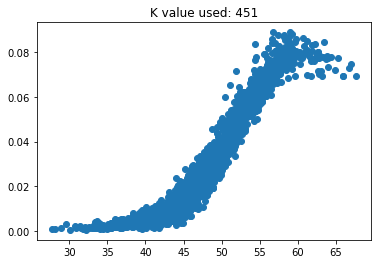

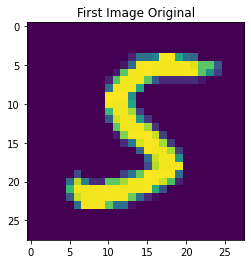

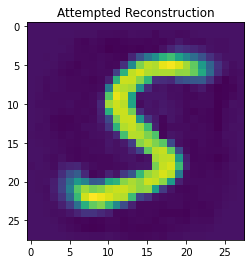

MSE loss for this input is:  0.0017652552650899303
train loss: 4.637089659809135e-05 test loss: 4.805948992725462e-05
[epoch, batch], [16,   250] loss: 0.000
mean actives 412.0 0.412 % | max 412 0.412 %
(128, 1000) shape of cosine sims


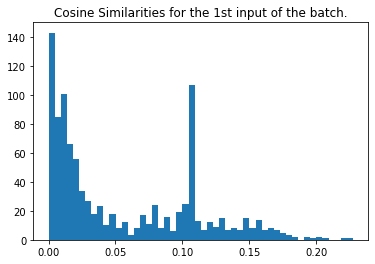

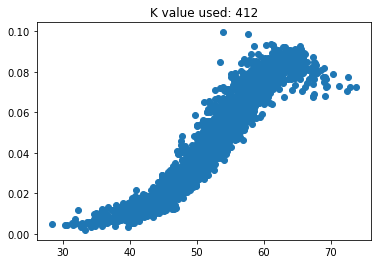

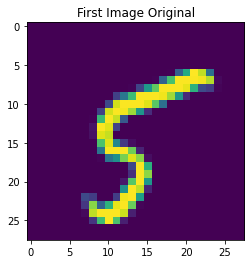

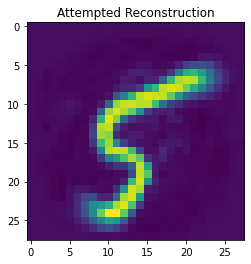

MSE loss for this input is:  0.0012041435253863431
train loss: 5.171062002773397e-05 test loss: 6.406234024325386e-05
[epoch, batch], [17,   250] loss: 0.000
mean actives 373.0 0.373 % | max 373 0.373 %
(128, 1000) shape of cosine sims


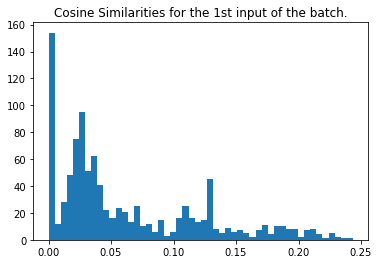

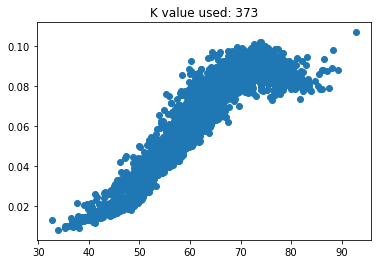

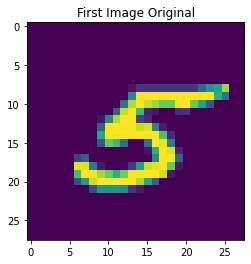

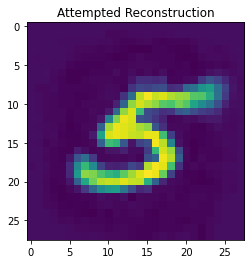

MSE loss for this input is:  0.0016944099749837602
train loss: 6.0962836869293824e-05 test loss: 6.379321712302044e-05
[epoch, batch], [18,   250] loss: 0.000
mean actives 334.0 0.334 % | max 334 0.334 %
(128, 1000) shape of cosine sims


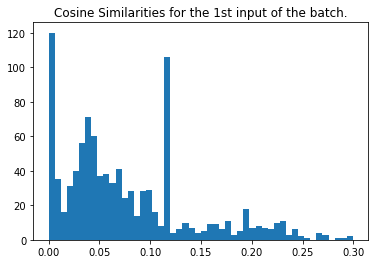

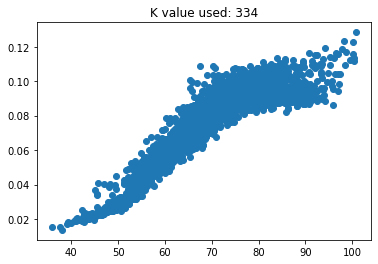

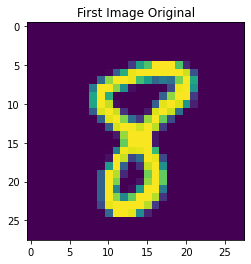

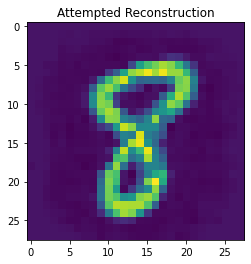

MSE loss for this input is:  0.0010230998147507102
train loss: 7.065093086566776e-05 test loss: 7.527452544309199e-05
[epoch, batch], [19,   250] loss: 0.000
mean actives 295.0 0.295 % | max 295 0.295 %
(128, 1000) shape of cosine sims


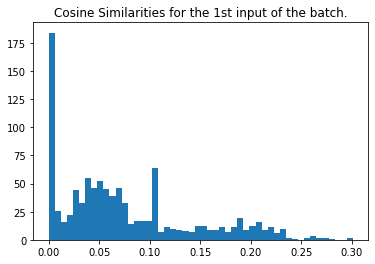

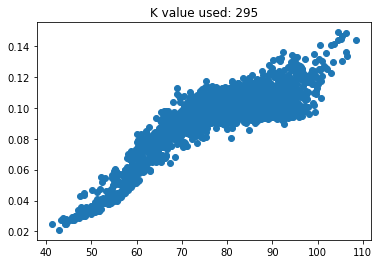

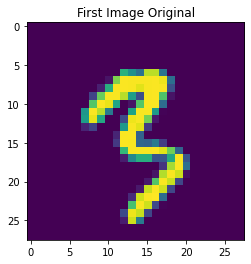

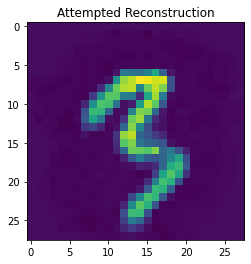

MSE loss for this input is:  0.0012972982866423471
train loss: 6.868712807772681e-05 test loss: 7.598847150802612e-05
[epoch, batch], [20,   250] loss: 0.000
mean actives 255.0 0.255 % | max 255 0.255 %
(128, 1000) shape of cosine sims


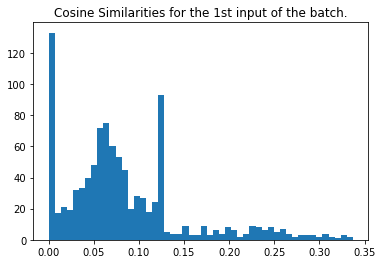

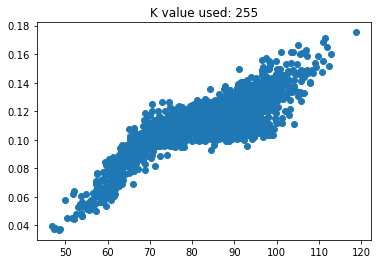

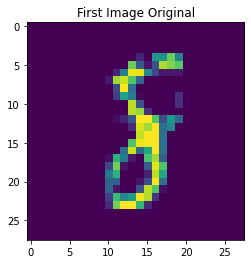

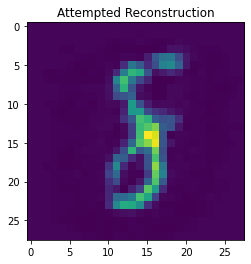

MSE loss for this input is:  0.0013767841215036353
train loss: 7.253609510371462e-05 test loss: 7.482722867280245e-05
[epoch, batch], [21,   250] loss: 0.000
mean actives 216.0 0.216 % | max 216 0.216 %
(128, 1000) shape of cosine sims


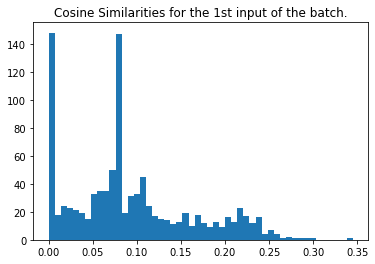

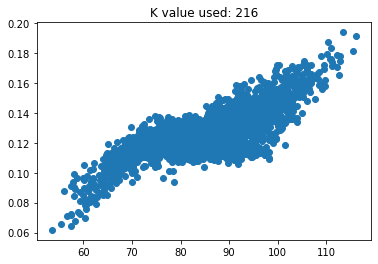

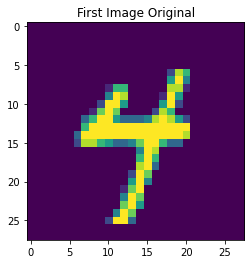

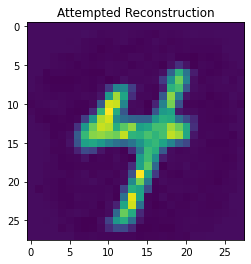

MSE loss for this input is:  0.0016735495657336954
train loss: 6.407916225725785e-05 test loss: 6.749870954081416e-05
[epoch, batch], [22,   250] loss: 0.000
mean actives 177.0 0.177 % | max 177 0.177 %
(128, 1000) shape of cosine sims


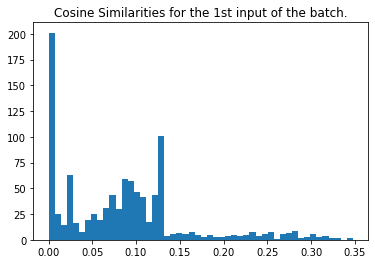

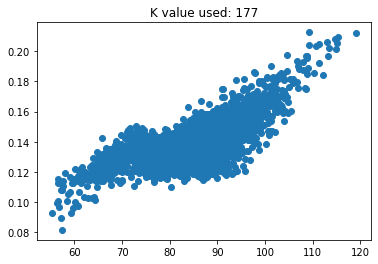

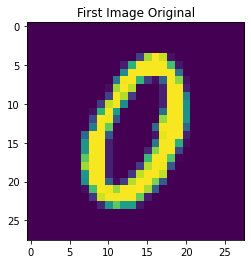

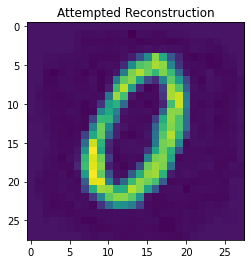

MSE loss for this input is:  0.0017971209421449778
train loss: 6.177074101287872e-05 test loss: 6.426686013583094e-05
[epoch, batch], [23,   250] loss: 0.000
mean actives 138.0 0.138 % | max 138 0.138 %
(128, 1000) shape of cosine sims


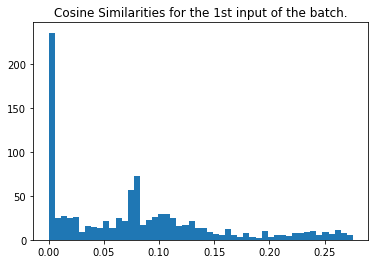

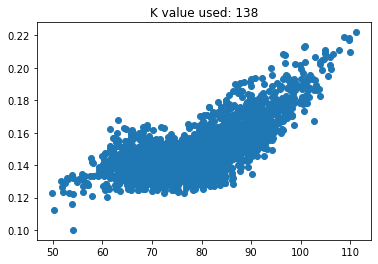

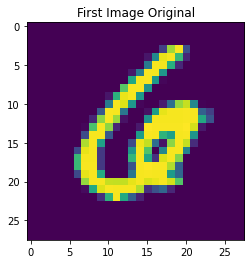

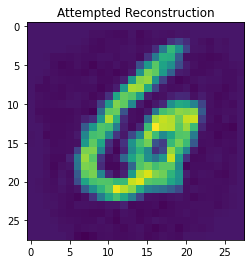

MSE loss for this input is:  0.0010466326256187595
train loss: 6.762241537217051e-05 test loss: 6.57206546748057e-05
[epoch, batch], [24,   250] loss: 0.000
mean actives 99.0 0.099 % | max 99 0.099 %
(128, 1000) shape of cosine sims


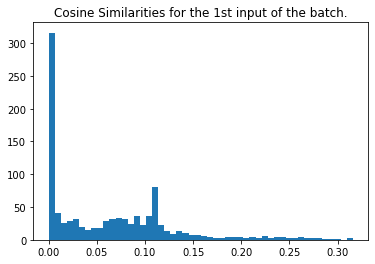

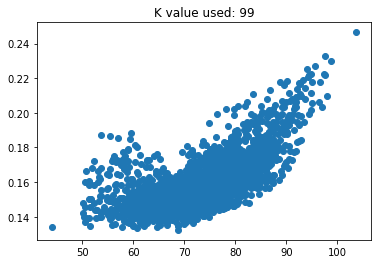

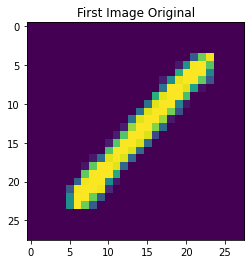

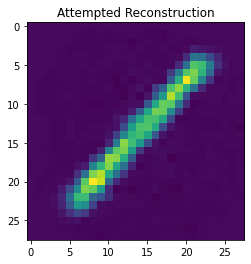

MSE loss for this input is:  0.00142792140950962
train loss: 7.598936645081267e-05 test loss: 7.888836262281984e-05
[epoch, batch], [25,   250] loss: 0.000
mean actives 60.0 0.06 % | max 60 0.06 %
(128, 1000) shape of cosine sims


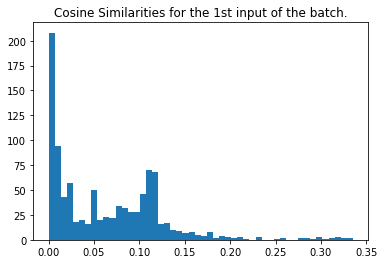

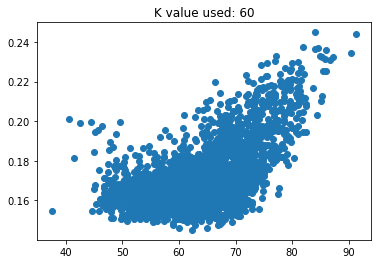

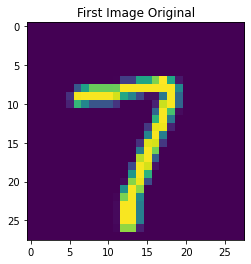

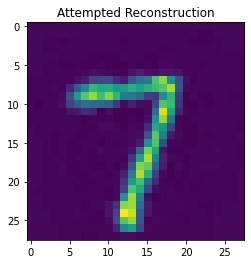

MSE loss for this input is:  0.0010449051552889298
train loss: 0.00010686807945603505 test loss: 0.00010482035577297211
[epoch, batch], [26,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


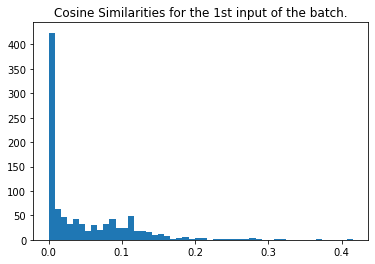

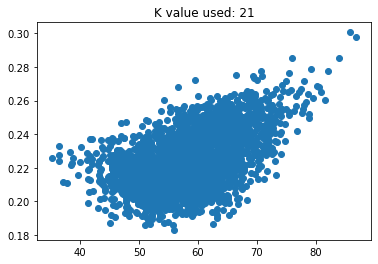

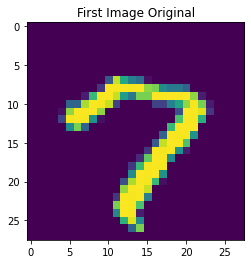

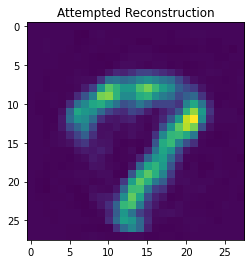

MSE loss for this input is:  0.0015348471244987175
train loss: 0.00021507499332074076 test loss: 0.00019550030992832035
[epoch, batch], [27,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


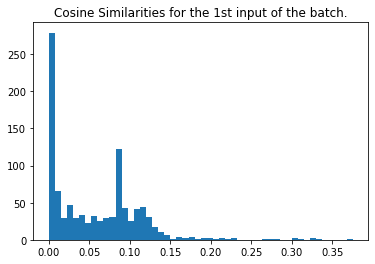

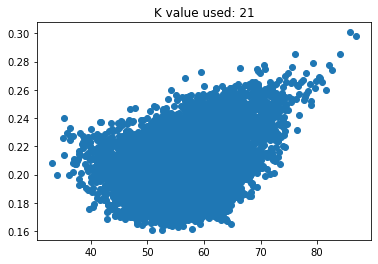

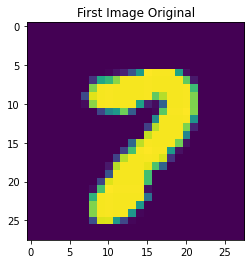

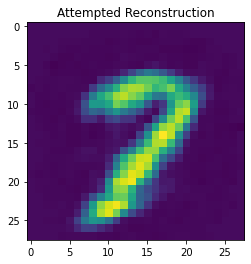

MSE loss for this input is:  0.0012742946190493448
train loss: 0.00019475586304906756 test loss: 0.0001917323243105784
[epoch, batch], [28,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


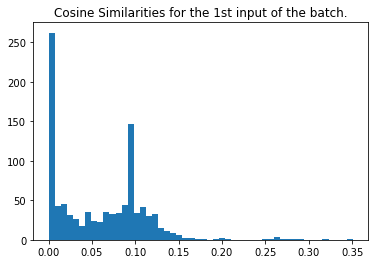

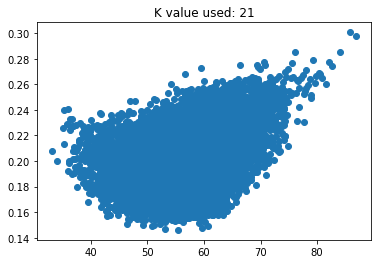

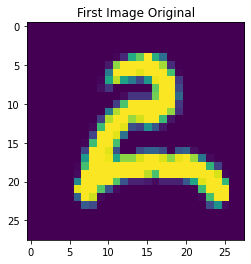

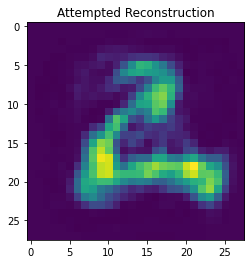

MSE loss for this input is:  0.0011973193257438894
train loss: 0.00019596467609517276 test loss: 0.0001935677428264171
[epoch, batch], [29,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


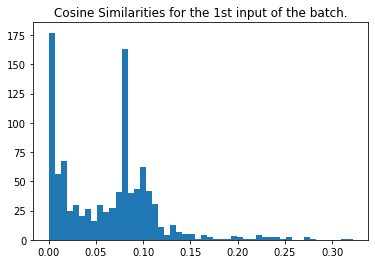

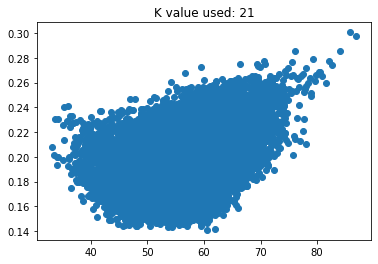

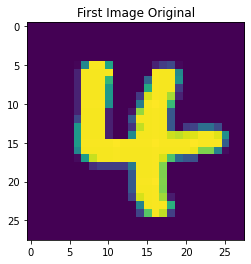

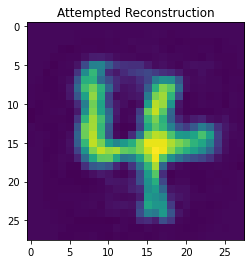

MSE loss for this input is:  0.0013718378483032693
train loss: 0.00019083023653365672 test loss: 0.00018327553698327392
[epoch, batch], [30,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


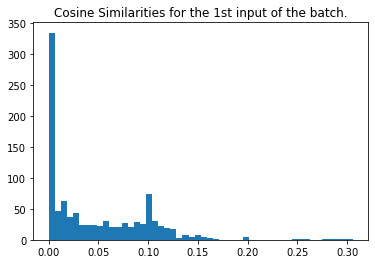

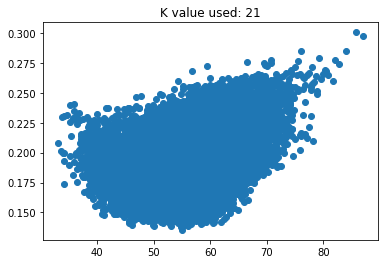

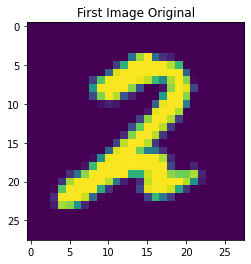

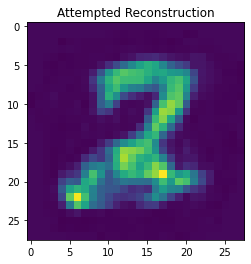

MSE loss for this input is:  0.0014977190567522633
train loss: 0.00018007351900450885 test loss: 0.00020035407214891165
[epoch, batch], [31,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


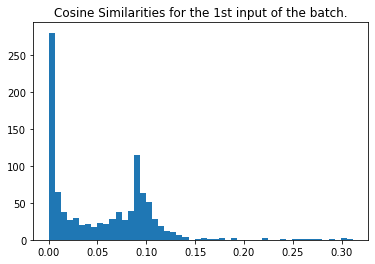

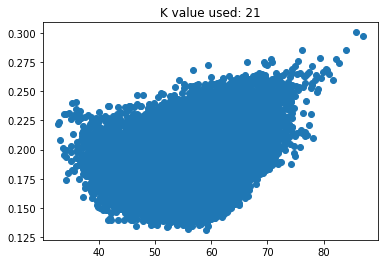

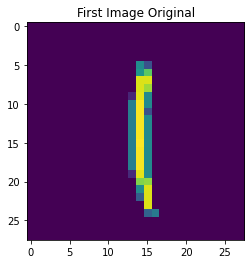

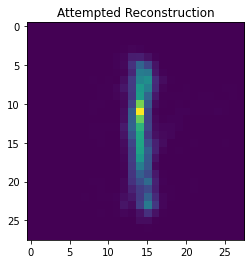

MSE loss for this input is:  0.0020346515336815193
train loss: 0.00019254785729572177 test loss: 0.0001793309929780662
[epoch, batch], [32,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


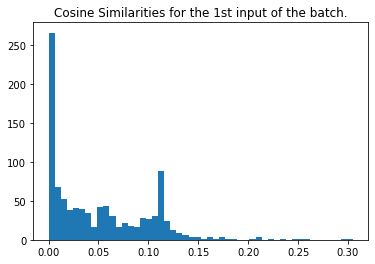

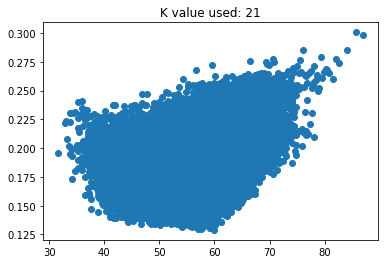

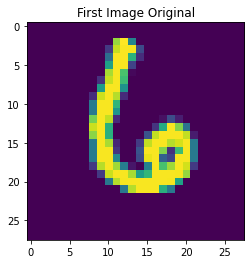

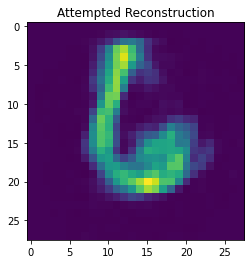

MSE loss for this input is:  0.0015877325619970048
train loss: 0.00018015399109572172 test loss: 0.00016802352911327034
[epoch, batch], [33,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


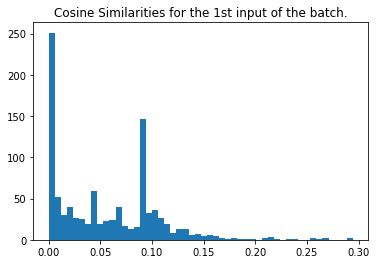

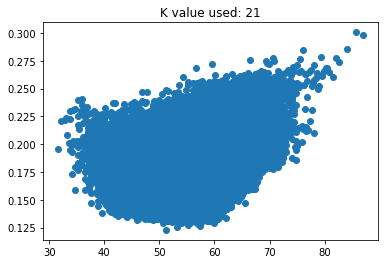

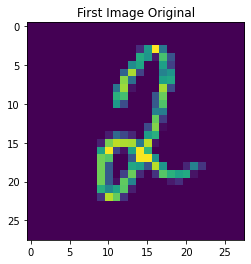

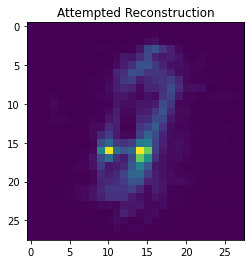

MSE loss for this input is:  0.0015248276141225075
train loss: 0.00018726471171248704 test loss: 0.00018025028111878783
[epoch, batch], [34,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


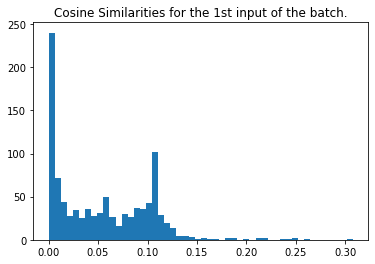

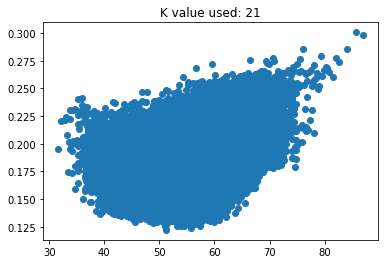

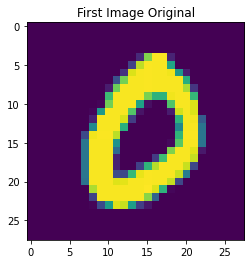

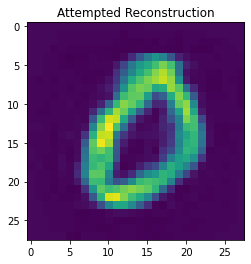

MSE loss for this input is:  0.0015790514191802666
train loss: 0.00018160422041546553 test loss: 0.00018672645092010498
[epoch, batch], [35,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


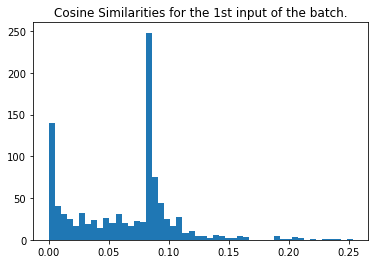

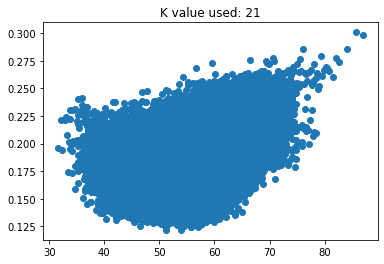

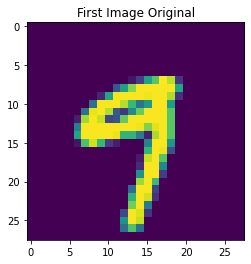

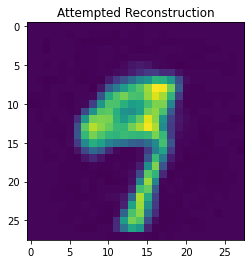

MSE loss for this input is:  0.0010131959404264177
train loss: 0.00018689423450268805 test loss: 0.0001861286727944389
[epoch, batch], [36,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


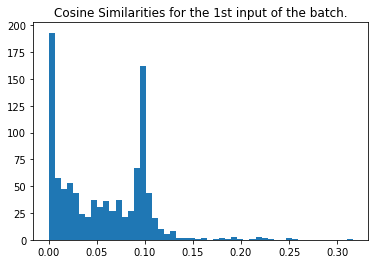

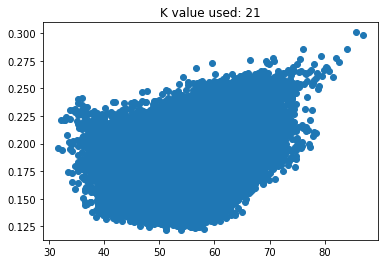

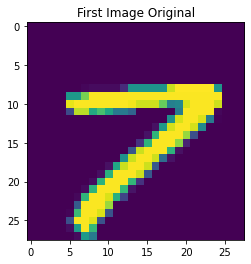

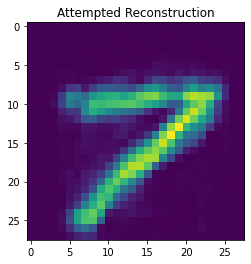

MSE loss for this input is:  0.0012034456036528762
train loss: 0.00017564219888299704 test loss: 0.0001701160508673638
[epoch, batch], [37,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


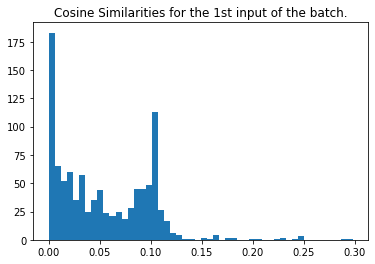

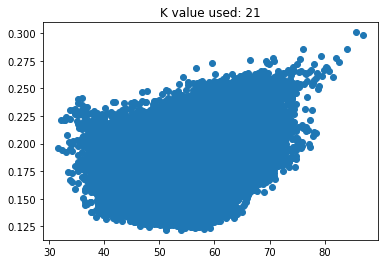

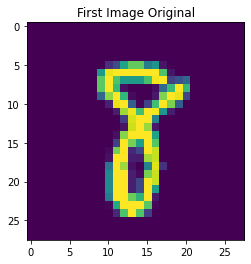

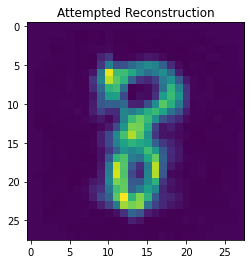

MSE loss for this input is:  0.0012825753311721646
train loss: 0.00016980318468995392 test loss: 0.00017991848289966583
[epoch, batch], [38,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


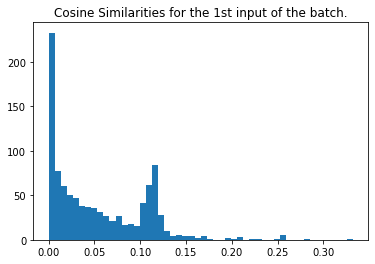

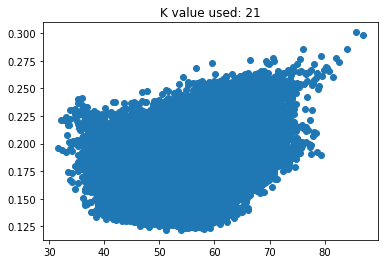

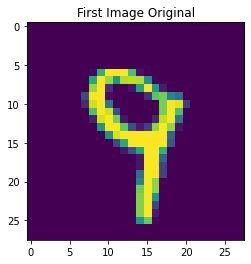

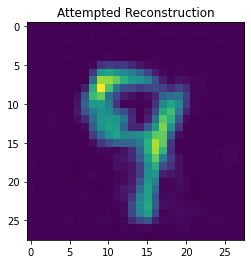

MSE loss for this input is:  0.0012974304204084435
train loss: 0.00017741229385137558 test loss: 0.00017782913346309215
[epoch, batch], [39,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


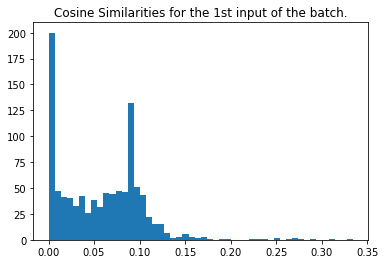

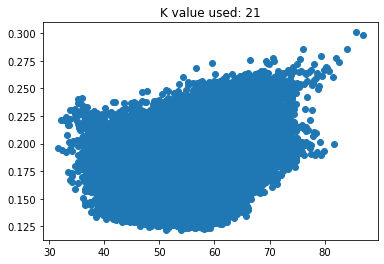

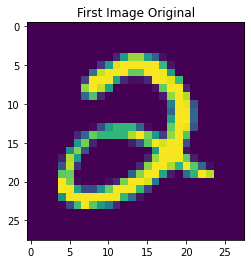

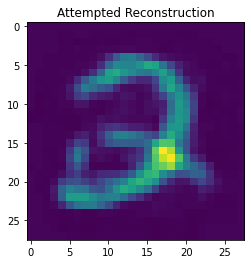

MSE loss for this input is:  0.0013315828174960856
train loss: 0.00017268200463149697 test loss: 0.00018832895148079842
[epoch, batch], [40,   250] loss: 0.000
mean actives 21.0 0.021 % | max 21 0.021 %
(128, 1000) shape of cosine sims


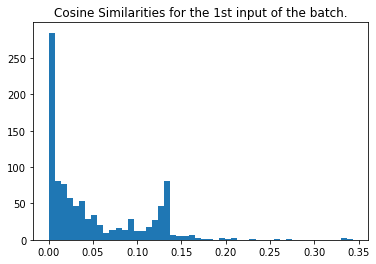

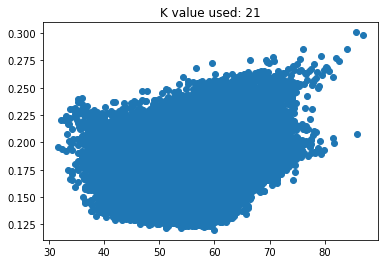

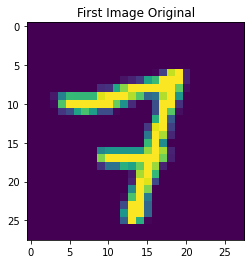

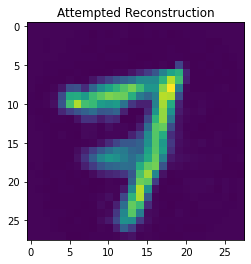

MSE loss for this input is:  0.0013710520401292918
train loss: 0.00017846371338237077 test loss: 0.00017313056741841137
Finished Training


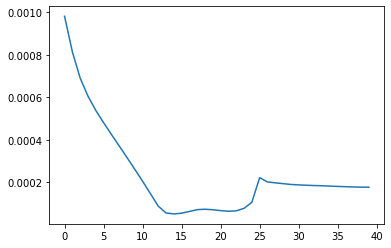

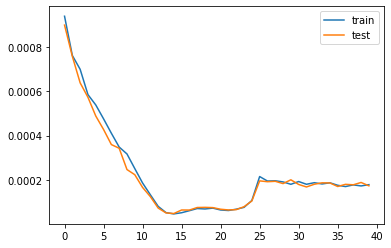

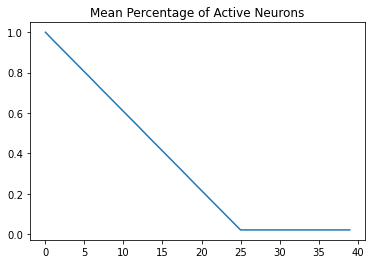

Latents and Labels dimensions: (60000, 1000) (60000,)
Latents and Labels dimensions: (10000, 1000) (10000,)
Logistic regression accuracy: Train= 0.892 | Test= 0.898


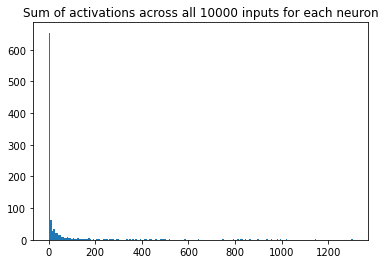

[654.  61.  29.  34.  21.  20.  15.  15.  10.   9.   7.   5.   9.   6.
   6.   3.   5.   3.   1.   6.   4.   2.   1.   2.   3.   4.   5.   3.
   0.   2.   0.   1.   2.   1.   0.   0.   1.   1.   2.   0.   2.   2.
   1.   0.   1.   1.   0.   0.   0.   0.   0.   1.   0.   1.   0.   3.
   0.   1.   0.   0.   1.   0.   0.   1.   2.   0.   1.   1.   0.   0.
   1.   0.   0.   2.   1.   1.   2.   0.   0.   2.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   2.   0.   0.   0.   0.   0.   0.   0.   0.
   2.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   1.   0.   0.   0.   0.   0.   0.   1.   0.   0.   1.   0.
   1.   1.   0.   1.   0.   0.   1.   0.   0.   0.   0.   1.   0.   0.
   0.   0.   0.   1.   0.   0.   1.   0.   0.   0.   1.   0.   1.   0.
   0.   0.   1.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   1.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0. 

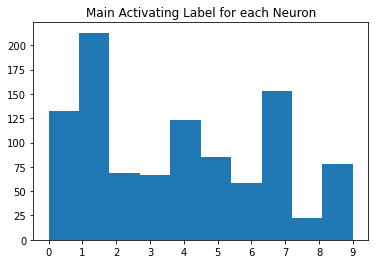

Neuron addresses should be 1000x784!!! (1000, 784) (1000, 784)
Euclidian distance


,0,1,2,3,4,5,6,7,8,9
0,0.000000,0.029381,0.049272,0.043798,0.028217,0.037673,0.054666,0.031532,0.091209,0.037408
1,0.029381,0.000000,0.054392,0.043109,0.030939,0.039543,0.057883,0.032886,0.096083,0.039257
2,0.049272,0.054392,0.000000,0.046342,0.049689,0.045351,0.057235,0.052931,0.088215,0.056022
3,0.043798,0.043109,0.046342,0.000000,0.043990,0.038677,0.064863,0.046585,0.085214,0.050430
4,0.028217,0.030939,0.049689,0.043990,0.000000,0.035986,0.055023,0.029911,0.088729,0.033639
5,0.037673,0.039543,0.045351,0.038677,0.035986,0.000000,0.063724,0.038678,0.070394,0.042409
6,0.054666,0.057883,0.057235,0.064863,0.055023,0.063724,0.000000,0.061656,0.106638,0.065615
7,0.031532,0.032886,0.052931,0.046585,0.029911,0.038678,0.061656,0.000000,0.088820,0.039290
8,0.091209,0.096083,0.088215,0.085214,0.088729,0.070394,0.106638,0.088820,0.000000,0.093907
9,0.037408,0.039257,0.056022,0.050430,0.033639,0.042409,0.065615,0.039290,0.093907,0.000000


cosine similarity


,0,1,2,3,4,5,6,7,8,9
0,1.000000,0.488199,0.584041,0.524117,0.557099,0.574601,0.575996,0.576346,0.526272,0.534911
1,0.488199,1.000000,0.518451,0.504287,0.445774,0.523838,0.537767,0.515502,0.490526,0.469051
2,0.584041,0.518451,1.000000,0.650105,0.578159,0.651724,0.632661,0.564330,0.579196,0.549947
3,0.524117,0.504287,0.650105,1.000000,0.516870,0.644687,0.537329,0.526985,0.576443,0.510189
4,0.557099,0.445774,0.578159,0.516870,1.000000,0.591044,0.571385,0.592430,0.546567,0.578117
5,0.574601,0.523838,0.651724,0.644687,0.591044,1.000000,0.537481,0.592822,0.664860,0.573753
6,0.575996,0.537767,0.632661,0.537329,0.571385,0.537481,1.000000,0.526329,0.497780,0.506258
7,0.576346,0.515502,0.564330,0.526985,0.592430,0.592822,0.526329,1.000000,0.544355,0.552913
8,0.526272,0.490526,0.579196,0.576443,0.546567,0.664860,0.497780,0.544355,1.000000,0.513759
9,0.534911,0.469051,0.549947,0.510189,0.578117,0.573753,0.506258,0.552913,0.513759,1.000000


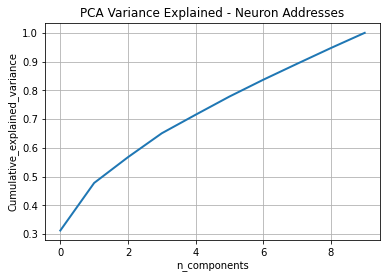

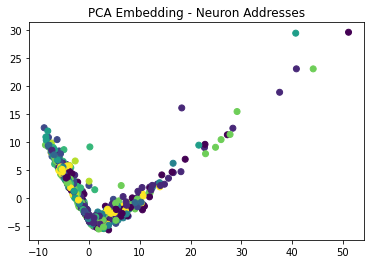

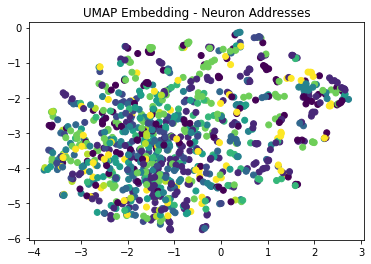

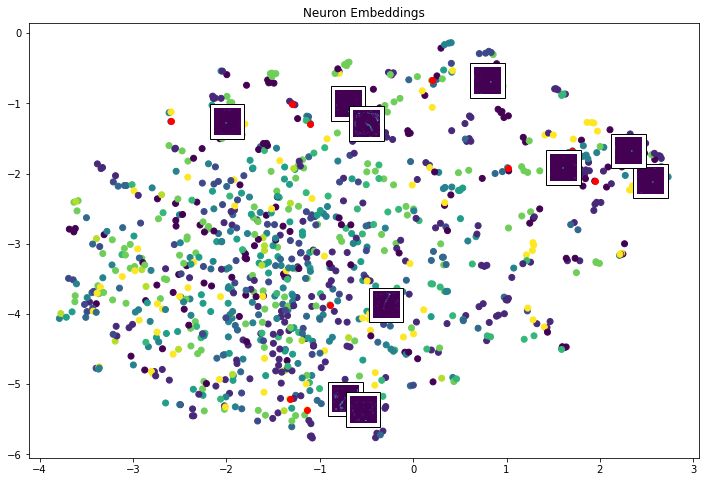

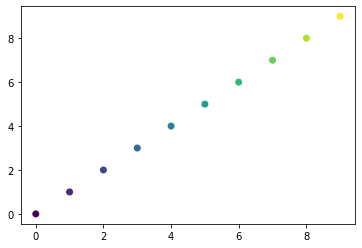

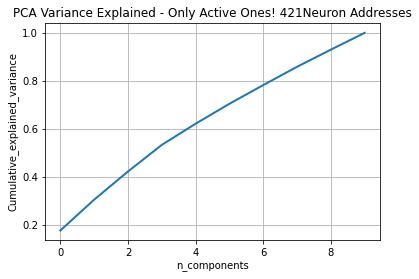

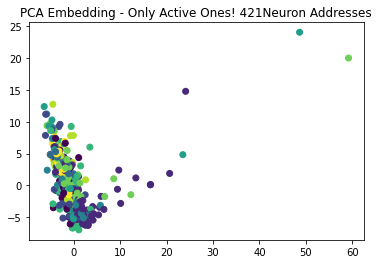

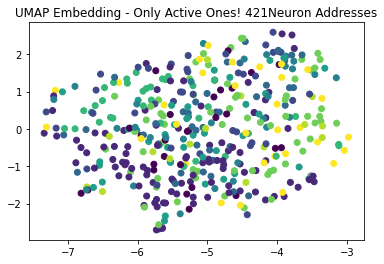

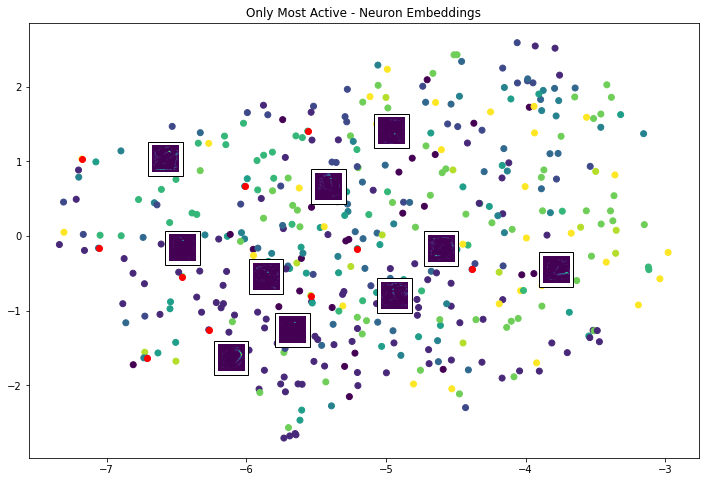

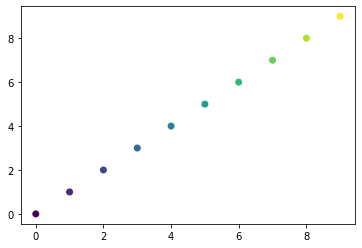

Giving some random plots from the most active neurons


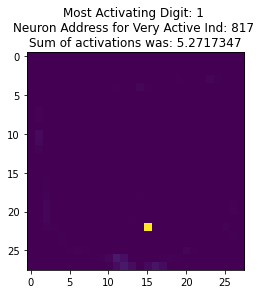

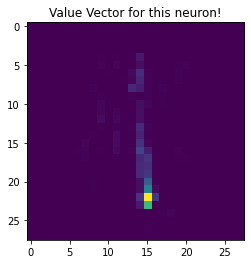

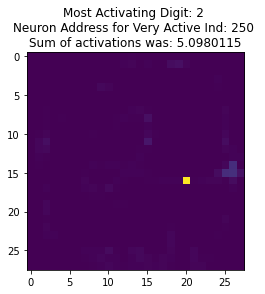

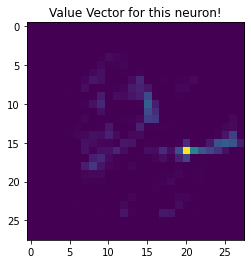

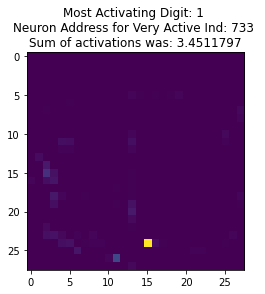

...

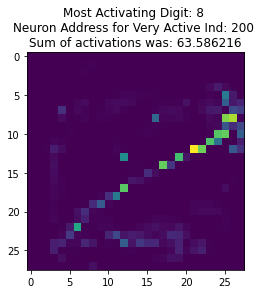

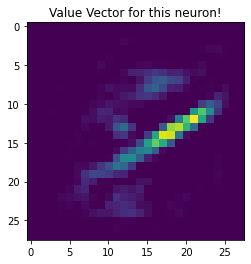

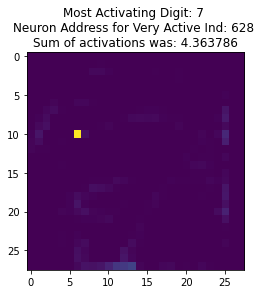

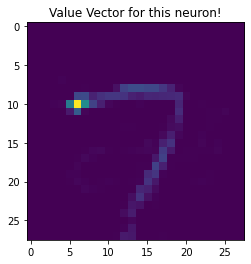

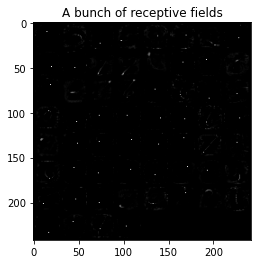

==================== K= 32 ===================
length of net parameters 2
[epoch, batch], [1,   250] loss: 0.000
mean actives 1000.0 1.0 % | max 1000 1.0 %
(128, 1000) shape of cosine sims


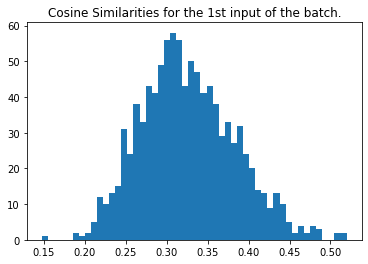

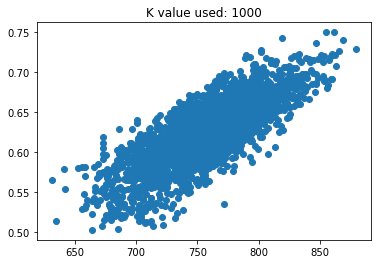

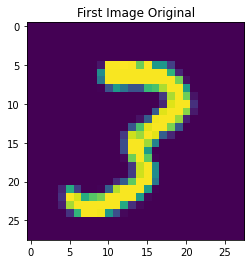

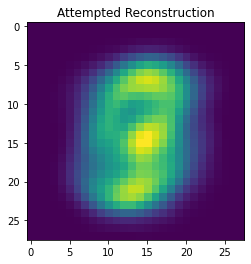

MSE loss for this input is:  0.0011568314262798854
train loss: 0.0008964281878434122 test loss: 0.0009140125475823879
[epoch, batch], [2,   250] loss: 0.000
mean actives 961.0 0.961 % | max 961 0.961 %
(128, 1000) shape of cosine sims


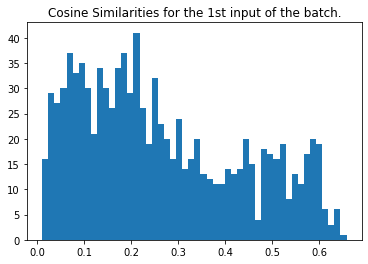

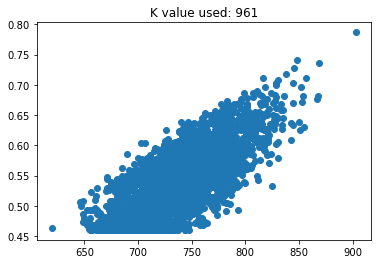

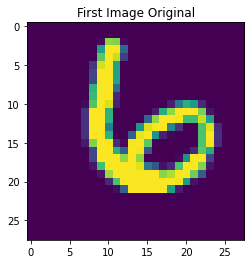

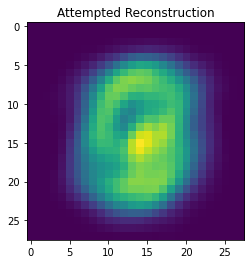

MSE loss for this input is:  0.0008715721113341195
train loss: 0.0007731316145509481 test loss: 0.0007591759203933179
[epoch, batch], [3,   250] loss: 0.000
mean actives 922.0 0.922 % | max 922 0.922 %
(128, 1000) shape of cosine sims


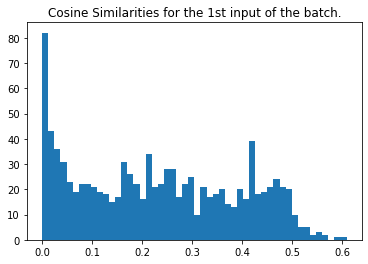

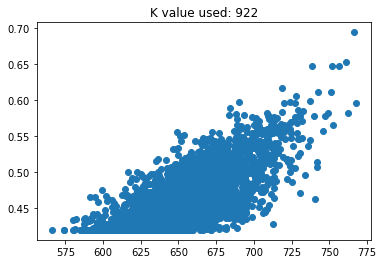

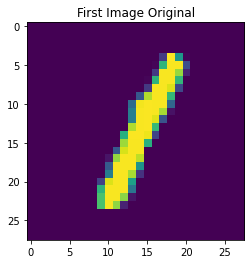

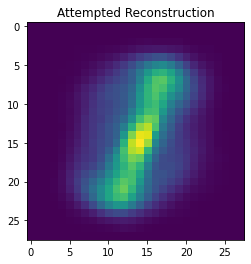

MSE loss for this input is:  0.0008124605733521131
train loss: 0.0006908468785695732 test loss: 0.0006271992460824549
[epoch, batch], [4,   250] loss: 0.000
mean actives 883.0 0.883 % | max 883 0.883 %
(128, 1000) shape of cosine sims


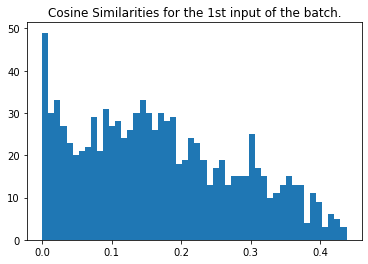

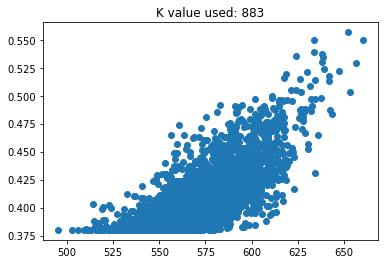

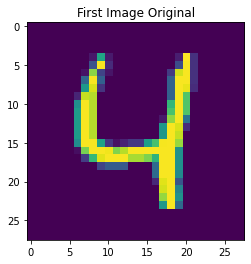

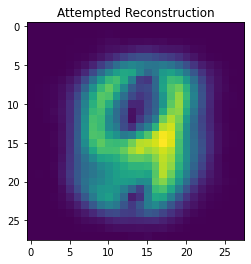

MSE loss for this input is:  0.0011738493126265857
train loss: 0.0005991525831632316 test loss: 0.0005317723844200373
[epoch, batch], [5,   250] loss: 0.000
mean actives 845.0 0.845 % | max 845 0.845 %
(128, 1000) shape of cosine sims


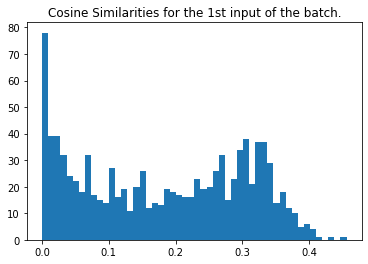

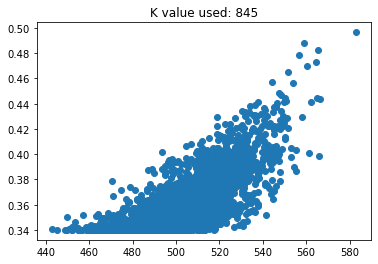

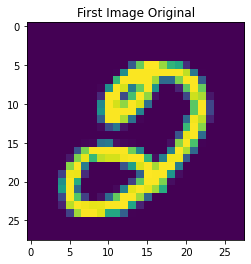

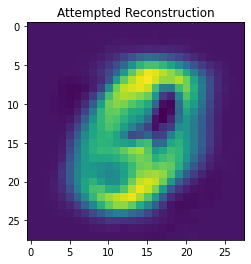

MSE loss for this input is:  0.0006384613866708716
train loss: 0.0005057743983343244 test loss: 0.0005043446435593069
[epoch, batch], [6,   250] loss: 0.000
mean actives 806.0 0.806 % | max 806 0.806 %
(128, 1000) shape of cosine sims


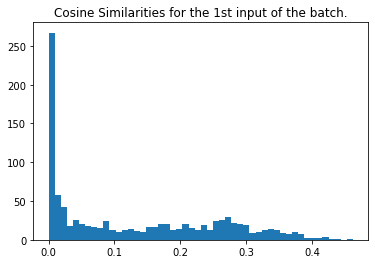

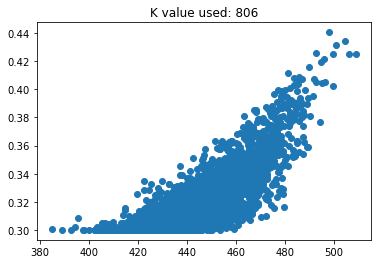

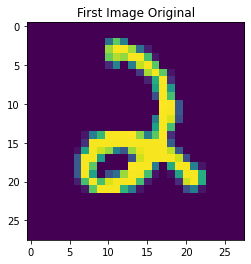

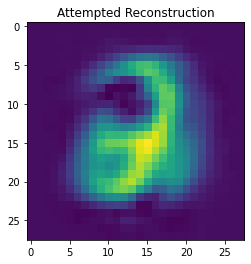

MSE loss for this input is:  0.0012172613368958843
train loss: 0.0005078672547824681 test loss: 0.0004318998253438622
[epoch, batch], [7,   250] loss: 0.000
mean actives 767.0 0.767 % | max 767 0.767 %
(128, 1000) shape of cosine sims


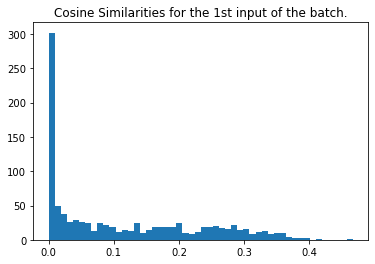

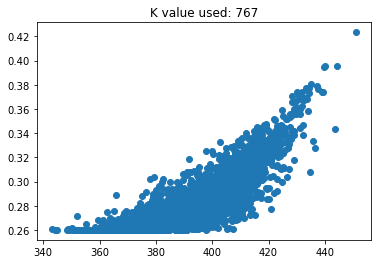

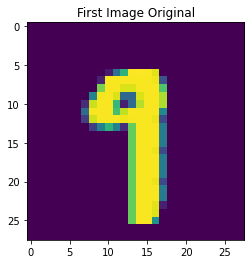

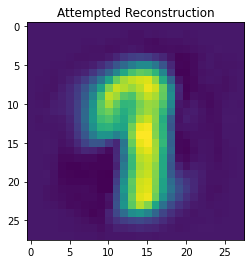

MSE loss for this input is:  0.0015015618837609583
train loss: 0.0004199279937893152 test loss: 0.00036194216227158904
[epoch, batch], [8,   250] loss: 0.000
mean actives 728.0 0.728 % | max 728 0.728 %
(128, 1000) shape of cosine sims


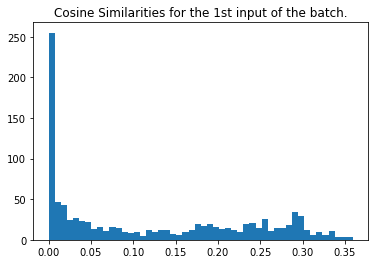

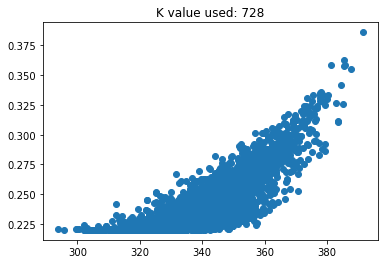

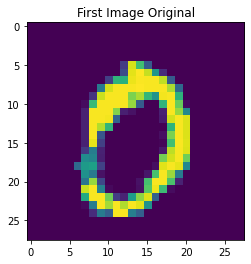

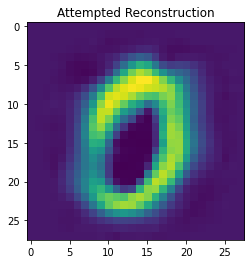

MSE loss for this input is:  0.0009638588799505817
train loss: 0.0003734902711585164 test loss: 0.0003024745674338192
[epoch, batch], [9,   250] loss: 0.000
mean actives 690.0 0.69 % | max 690 0.69 %
(128, 1000) shape of cosine sims


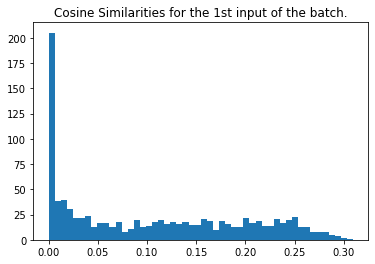

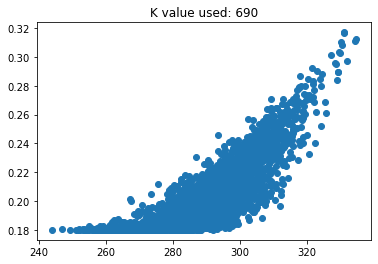

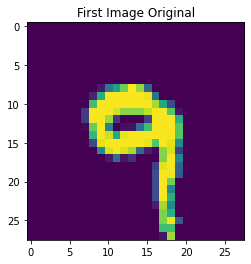

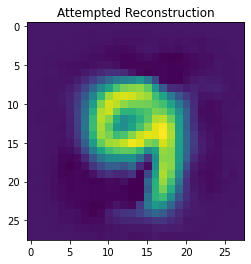

MSE loss for this input is:  0.001283714053582172
train loss: 0.0002958316763397306 test loss: 0.00027523061726242304
[epoch, batch], [10,   250] loss: 0.000
mean actives 651.0 0.651 % | max 651 0.651 %
(128, 1000) shape of cosine sims


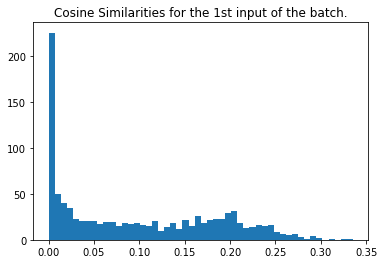

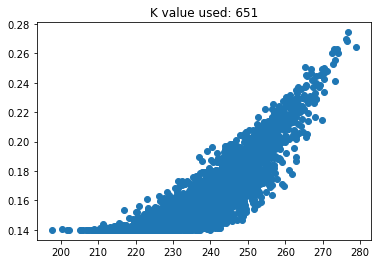

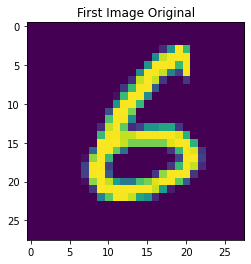

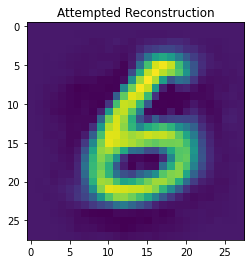

MSE loss for this input is:  0.0012943841973129585
train loss: 0.0002532277430873364 test loss: 0.00022208970040082932
[epoch, batch], [11,   250] loss: 0.000
mean actives 612.0 0.612 % | max 612 0.612 %
(128, 1000) shape of cosine sims


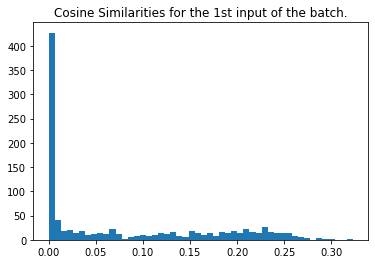

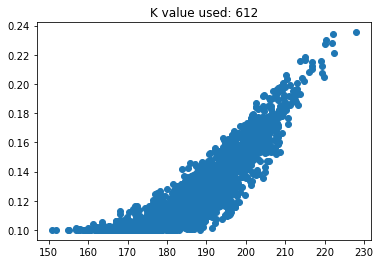

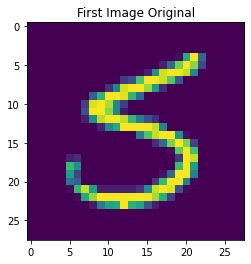

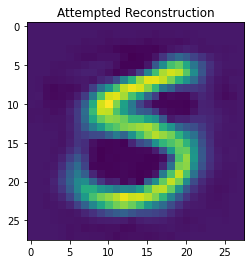

MSE loss for this input is:  0.0015999460402800112
train loss: 0.00019955776224378496 test loss: 0.00017818965716287494
[epoch, batch], [12,   250] loss: 0.000
mean actives 574.0 0.574 % | max 574 0.574 %
(128, 1000) shape of cosine sims


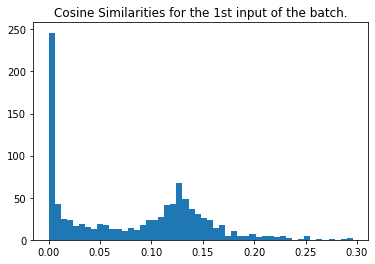

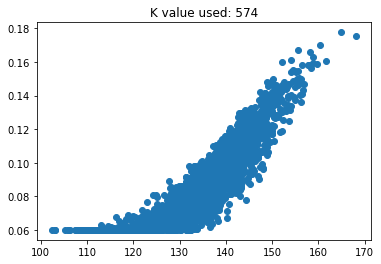

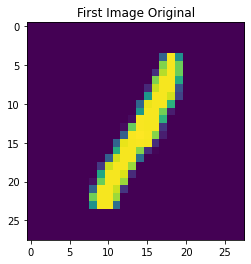

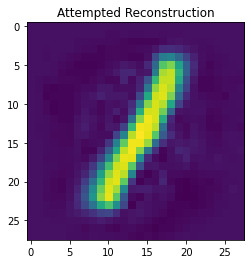

MSE loss for this input is:  0.0015265473297664098
train loss: 0.00013485235103871673 test loss: 0.000117470532131847
[epoch, batch], [13,   250] loss: 0.000
mean actives 535.0 0.535 % | max 535 0.535 %
(128, 1000) shape of cosine sims


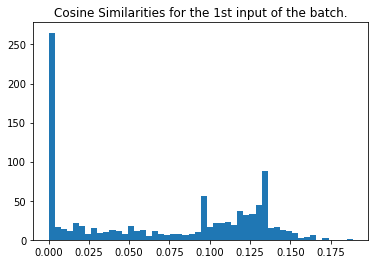

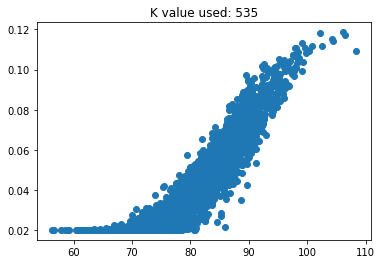

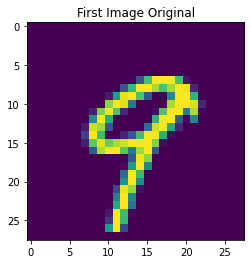

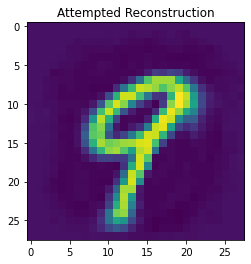

MSE loss for this input is:  0.0006251271662055229
train loss: 8.500524563714862e-05 test loss: 7.05714919604361e-05
[epoch, batch], [14,   250] loss: 0.000
mean actives 496.0 0.496 % | max 496 0.496 %
(128, 1000) shape of cosine sims


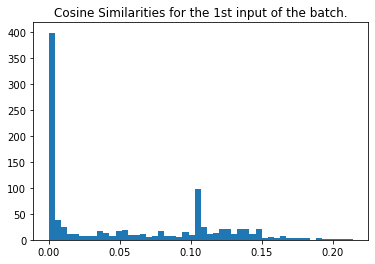

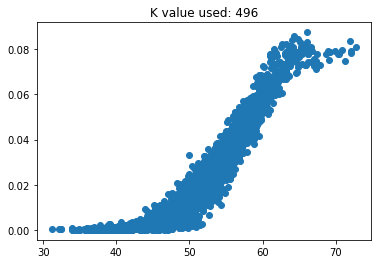

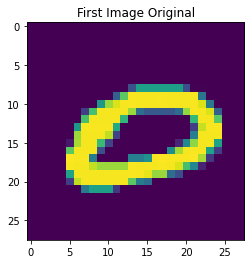

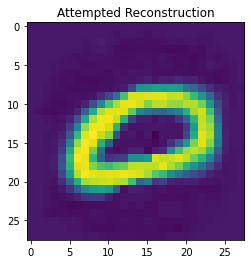

MSE loss for this input is:  0.0017737992564026191
train loss: 5.4173633543541655e-05 test loss: 5.4195461416384205e-05
[epoch, batch], [15,   250] loss: 0.000
mean actives 457.0 0.457 % | max 457 0.457 %
(128, 1000) shape of cosine sims


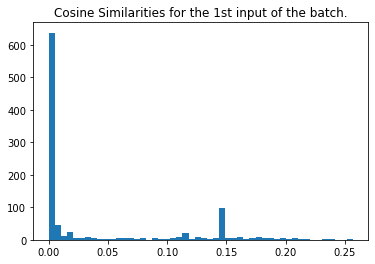

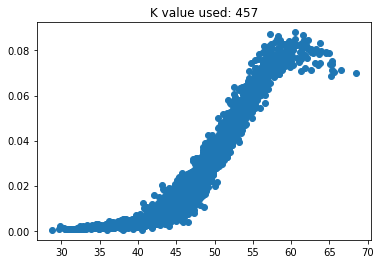

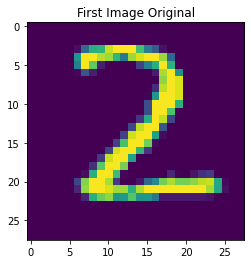

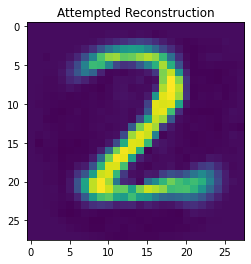

MSE loss for this input is:  0.0018018490197707195
train loss: 4.913103475701064e-05 test loss: 5.5158405302790925e-05
[epoch, batch], [16,   250] loss: 0.000
mean actives 419.0 0.419 % | max 419 0.419 %
(128, 1000) shape of cosine sims


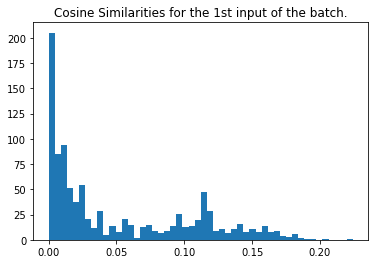

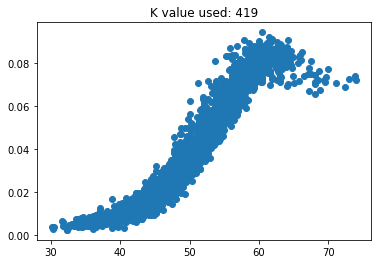

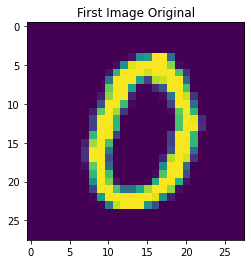

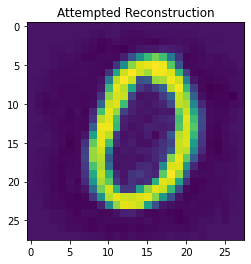

MSE loss for this input is:  0.0011539843161495365
train loss: 5.2755538490600884e-05 test loss: 5.350608626031317e-05
[epoch, batch], [17,   250] loss: 0.000
mean actives 380.0 0.38 % | max 380 0.38 %
(128, 1000) shape of cosine sims


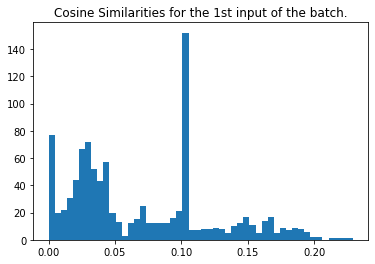

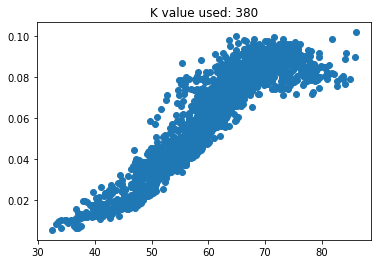

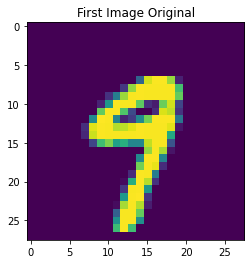

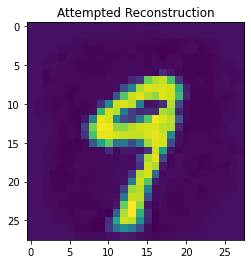

MSE loss for this input is:  0.0009113225553716932
train loss: 5.711531775887124e-05 test loss: 6.550920807057992e-05
[epoch, batch], [18,   250] loss: 0.000
mean actives 341.0 0.341 % | max 341 0.341 %
(128, 1000) shape of cosine sims


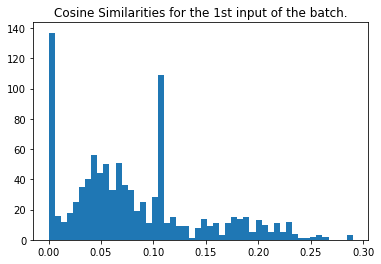

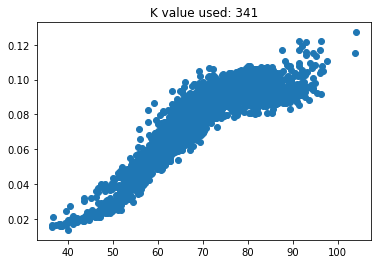

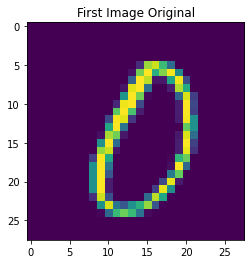

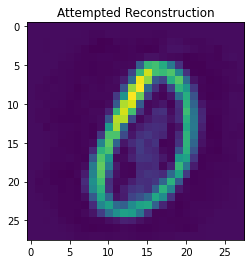

MSE loss for this input is:  0.001859923406523101
train loss: 6.718737131450325e-05 test loss: 7.174858183134347e-05
[epoch, batch], [19,   250] loss: 0.000
mean actives 303.0 0.303 % | max 303 0.303 %
(128, 1000) shape of cosine sims


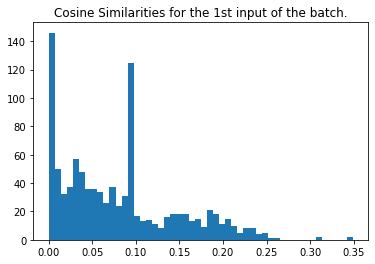

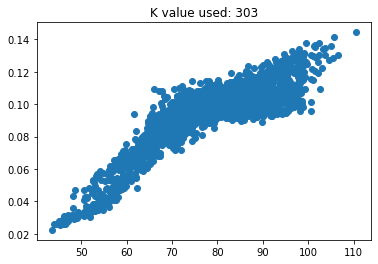

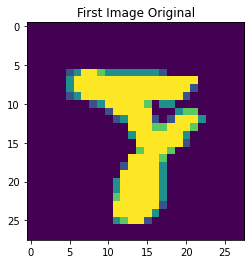

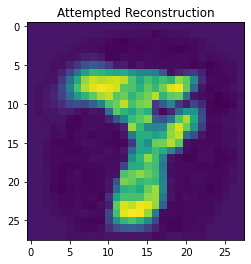

MSE loss for this input is:  0.0017001268510915795
train loss: 6.773996574338526e-05 test loss: 7.713331433478743e-05
[epoch, batch], [20,   250] loss: 0.000
mean actives 264.0 0.264 % | max 264 0.264 %
(128, 1000) shape of cosine sims


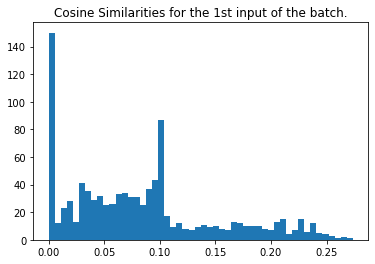

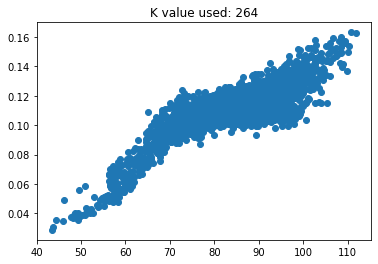

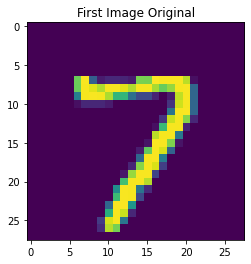

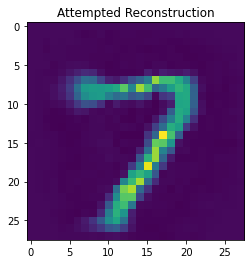

MSE loss for this input is:  0.0015849857305993839
train loss: 6.89418229740113e-05 test loss: 6.922803731868044e-05
[epoch, batch], [21,   250] loss: 0.000
mean actives 225.0 0.225 % | max 225 0.225 %
(128, 1000) shape of cosine sims


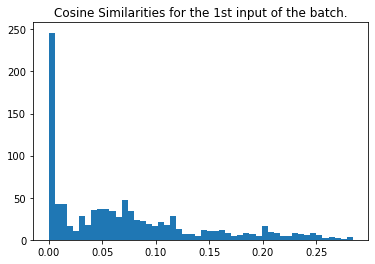

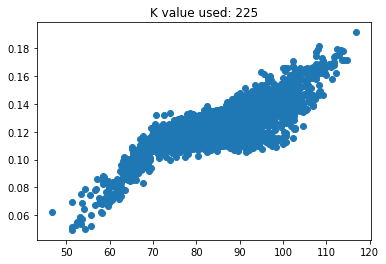

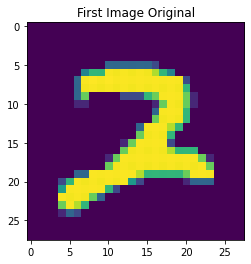

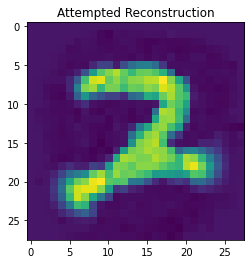

MSE loss for this input is:  0.00149247764932866
train loss: 6.362604472087696e-05 test loss: 6.343713903333992e-05
[epoch, batch], [22,   250] loss: 0.000
mean actives 186.0 0.186 % | max 186 0.186 %
(128, 1000) shape of cosine sims


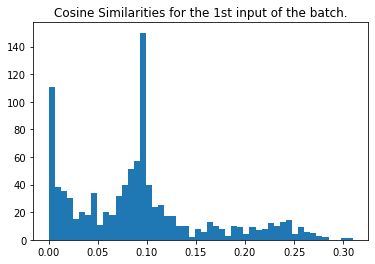

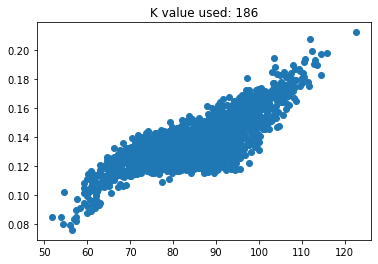

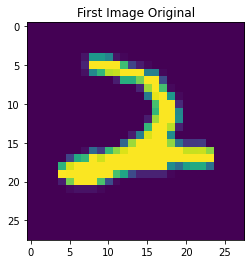

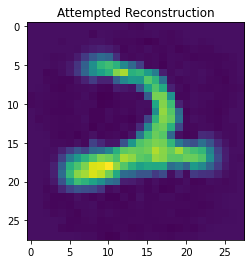

MSE loss for this input is:  0.0007410843153389133
train loss: 6.48836576147005e-05 test loss: 6.858530105091631e-05
[epoch, batch], [23,   250] loss: 0.000
mean actives 148.0 0.148 % | max 148 0.148 %
(128, 1000) shape of cosine sims


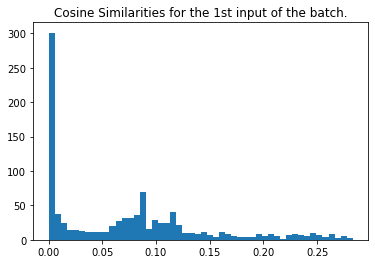

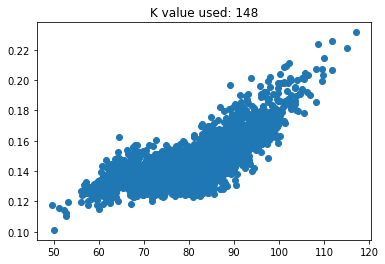

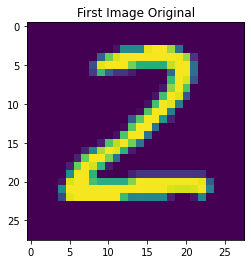

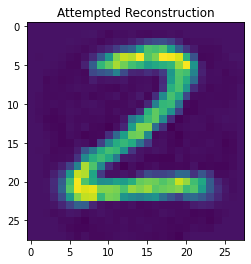

MSE loss for this input is:  0.0017016893442796202
train loss: 6.261713861022145e-05 test loss: 6.697852950310335e-05
[epoch, batch], [24,   250] loss: 0.000
mean actives 109.0 0.109 % | max 109 0.109 %
(128, 1000) shape of cosine sims


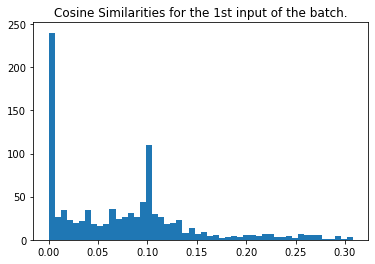

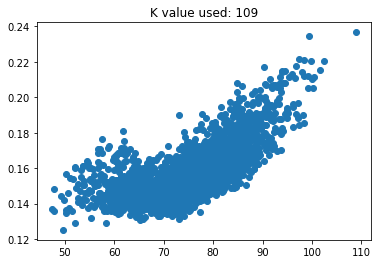

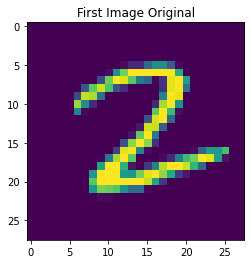

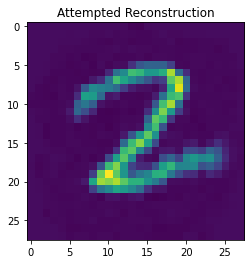

MSE loss for this input is:  0.0013798557373942161
train loss: 7.140328671084717e-05 test loss: 7.126706623239443e-05
[epoch, batch], [25,   250] loss: 0.000
mean actives 70.0 0.07 % | max 70 0.07 %
(128, 1000) shape of cosine sims


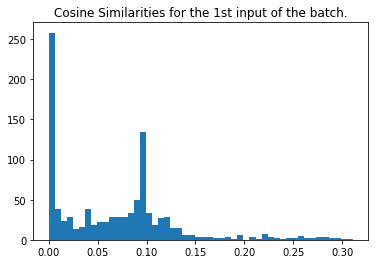

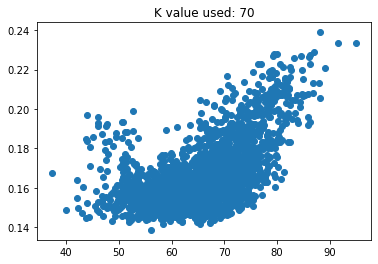

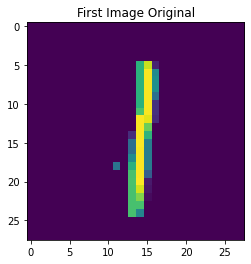

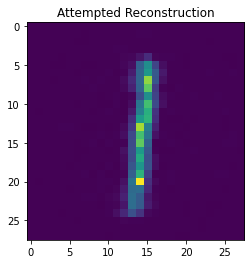

MSE loss for this input is:  0.0017045409399635938
train loss: 9.625236270949244e-05 test loss: 9.17434153961949e-05
[epoch, batch], [26,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


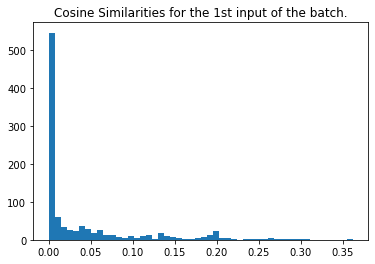

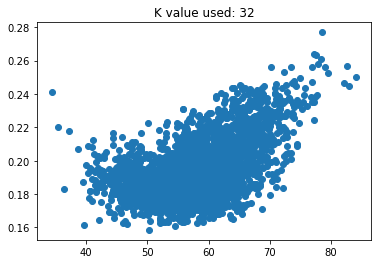

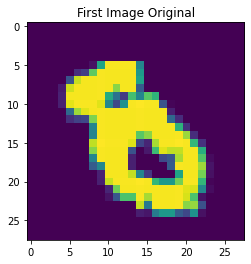

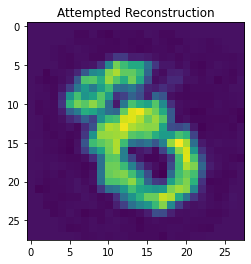

MSE loss for this input is:  0.00165468515182028
train loss: 0.00015262546367011964 test loss: 0.00015192956198006868
[epoch, batch], [27,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


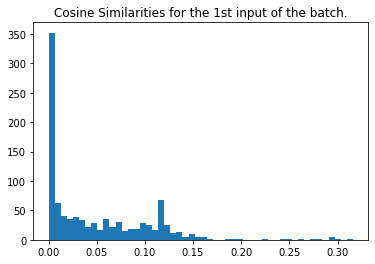

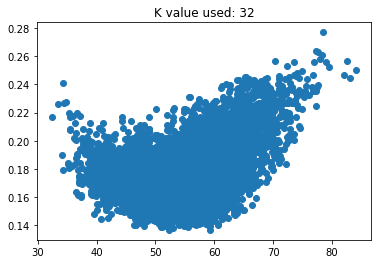

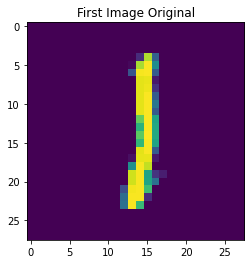

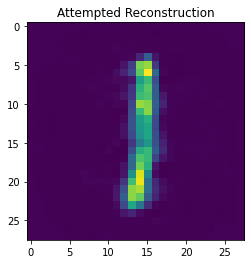

MSE loss for this input is:  0.0018355321823334207
train loss: 0.00015181371418293566 test loss: 0.0001467240508645773
[epoch, batch], [28,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


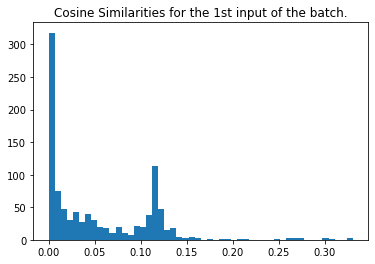

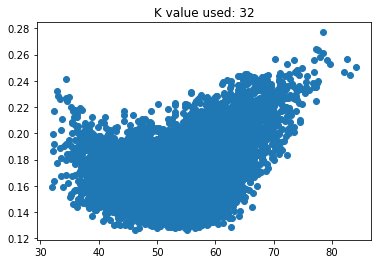

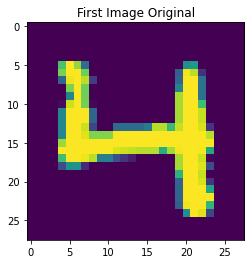

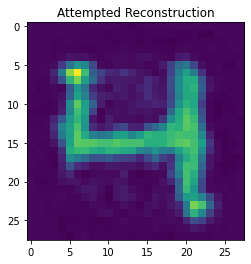

MSE loss for this input is:  0.0020237073910479644
train loss: 0.0001526477572042495 test loss: 0.0001447563845431432
[epoch, batch], [29,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


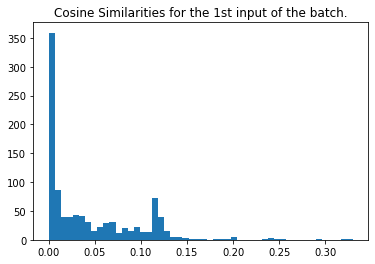

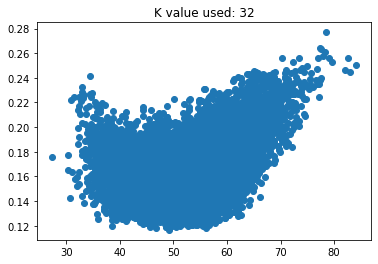

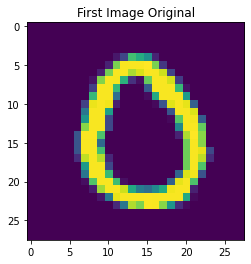

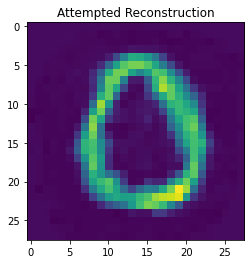

MSE loss for this input is:  0.001445316690571454
train loss: 0.00015156656445469707 test loss: 0.00015453234664164484
[epoch, batch], [30,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


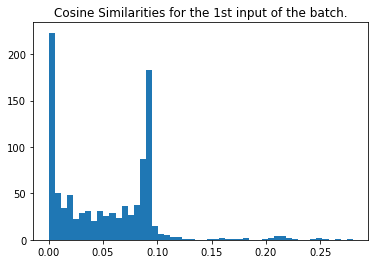

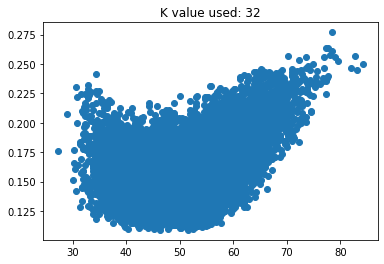

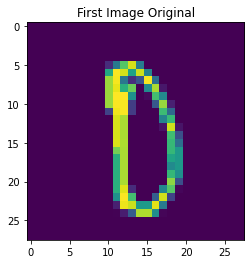

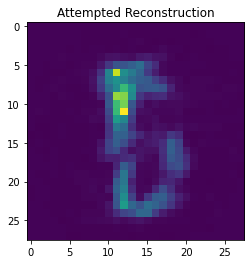

MSE loss for this input is:  0.0012751684657164983
train loss: 0.00015490897931158543 test loss: 0.00015520371380262077
[epoch, batch], [31,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


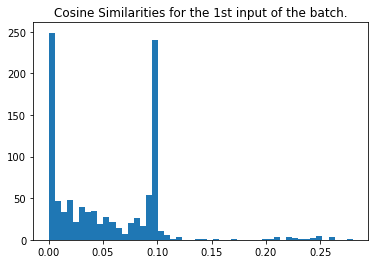

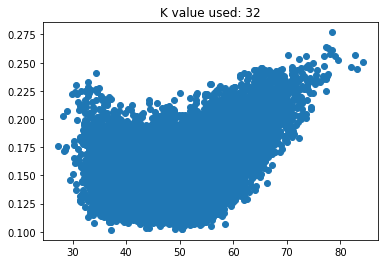

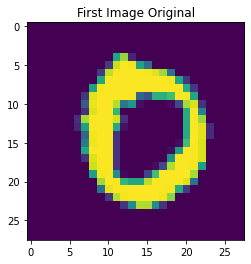

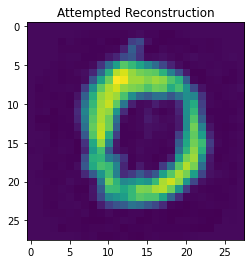

MSE loss for this input is:  0.0012464335530388113
train loss: 0.00014847949205432087 test loss: 0.000154402237967588
[epoch, batch], [32,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


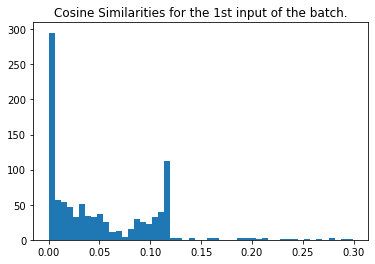

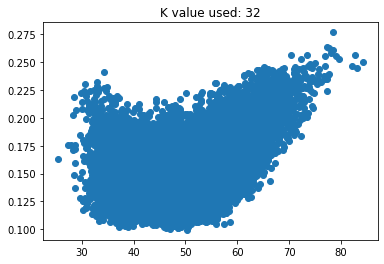

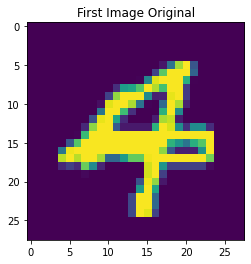

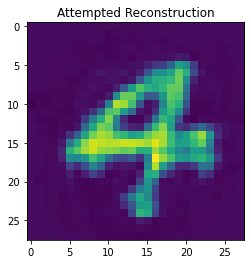

MSE loss for this input is:  0.0012596756676021888
train loss: 0.0001492230367148295 test loss: 0.00015262968372553587
[epoch, batch], [33,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


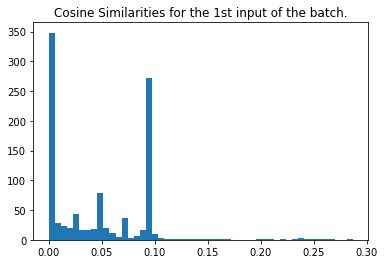

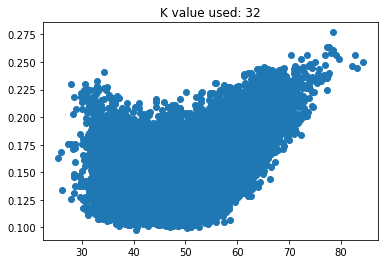

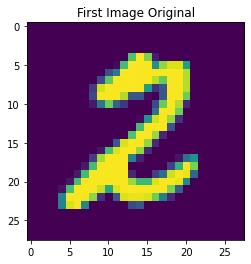

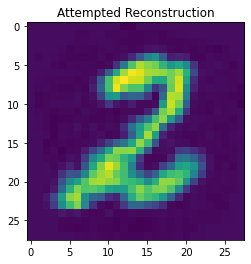

MSE loss for this input is:  0.00098243135274673
train loss: 0.00015020773571450263 test loss: 0.00014831009320914745
[epoch, batch], [34,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


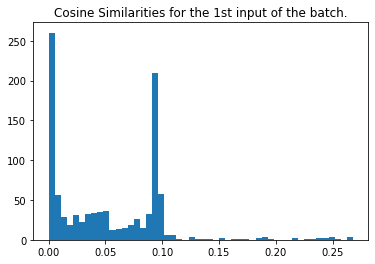

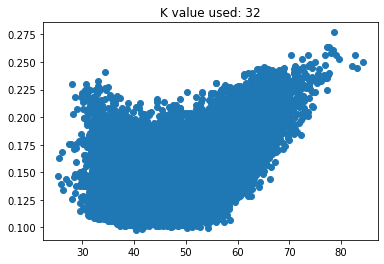

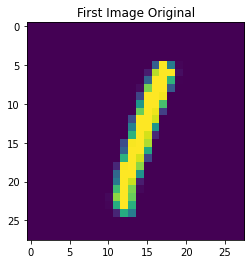

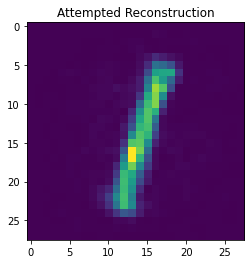

MSE loss for this input is:  0.0015979298219388845
train loss: 0.0001627419114811346 test loss: 0.00015006789180915803
[epoch, batch], [35,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


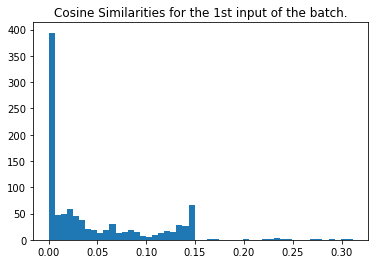

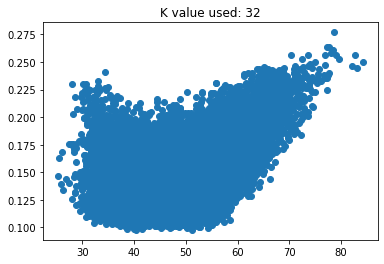

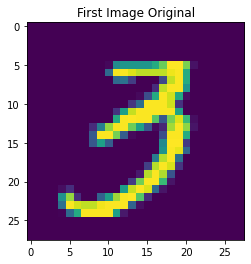

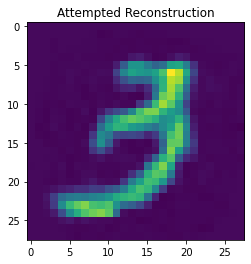

MSE loss for this input is:  0.0014395389933975376
train loss: 0.0001482441002735868 test loss: 0.0001420660992152989
[epoch, batch], [36,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


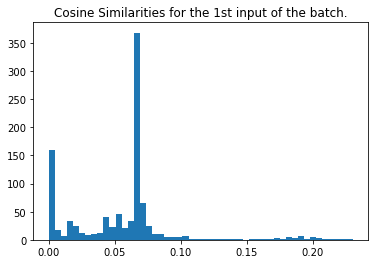

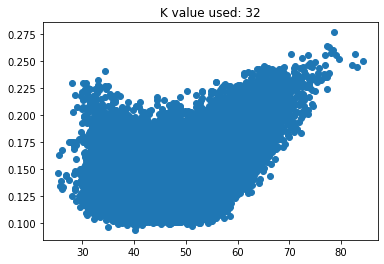

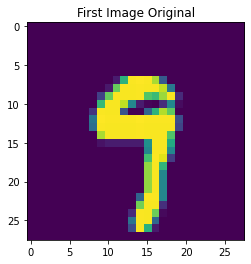

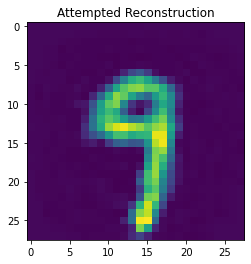

MSE loss for this input is:  0.0012717711530169662
train loss: 0.00015082472236827016 test loss: 0.000142811011755839
[epoch, batch], [37,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


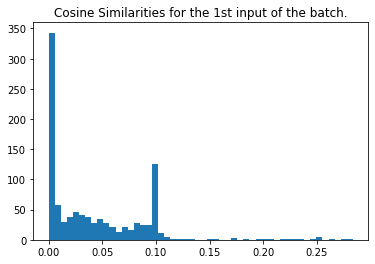

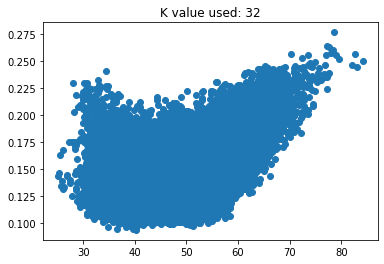

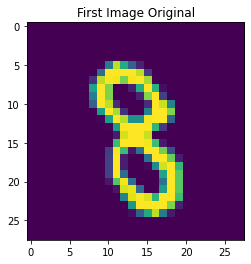

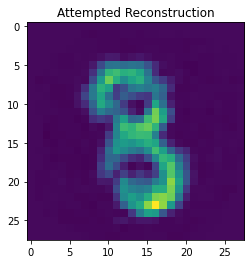

MSE loss for this input is:  0.001294195347902726
train loss: 0.0001423936482751742 test loss: 0.00014928133168723434
[epoch, batch], [38,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


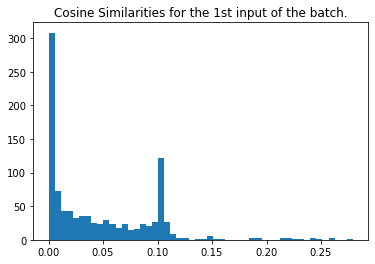

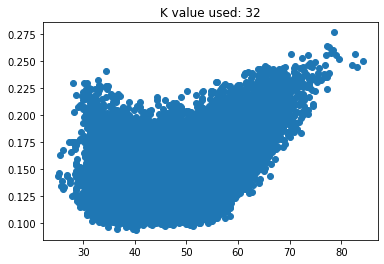

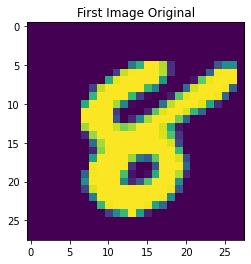

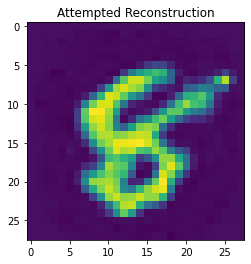

MSE loss for this input is:  0.0011565201744741323
train loss: 0.00014276763249654323 test loss: 0.00015480619913432747
[epoch, batch], [39,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


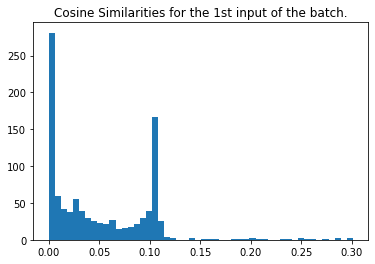

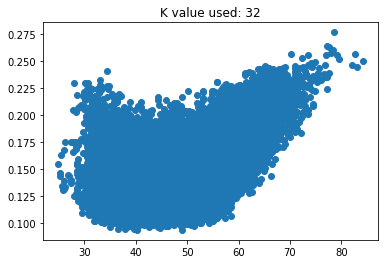

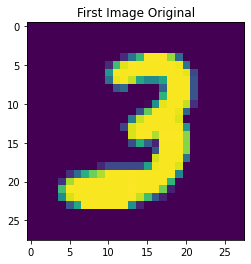

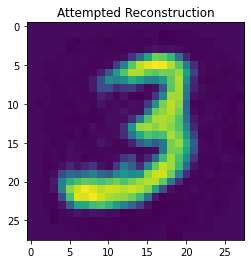

MSE loss for this input is:  0.0016435460776698832
train loss: 0.00014252116670832038 test loss: 0.0001437436294509098
[epoch, batch], [40,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


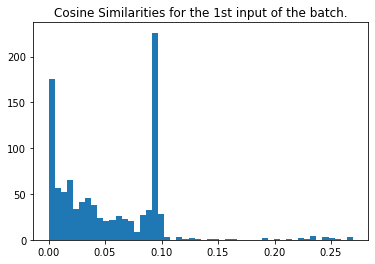

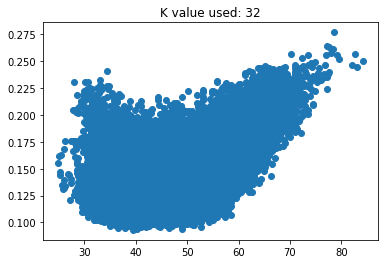

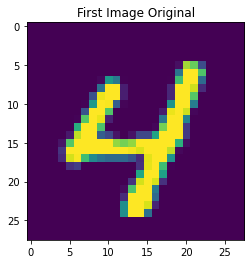

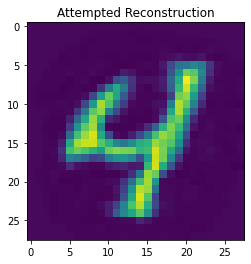

MSE loss for this input is:  0.0007864495321195953
train loss: 0.00013958127237856388 test loss: 0.00014965891023166478
Finished Training


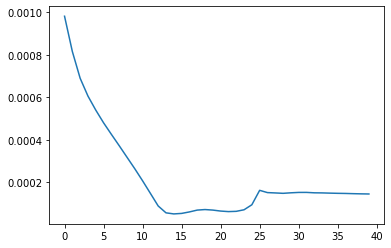

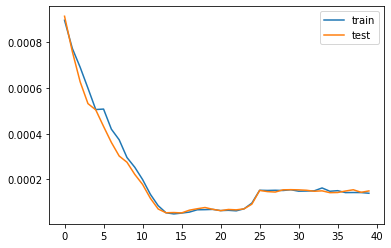

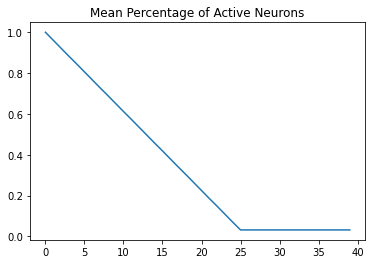

Latents and Labels dimensions: (60000, 1000) (60000,)
Latents and Labels dimensions: (10000, 1000) (10000,)
Logistic regression accuracy: Train= 0.878 | Test= 0.886


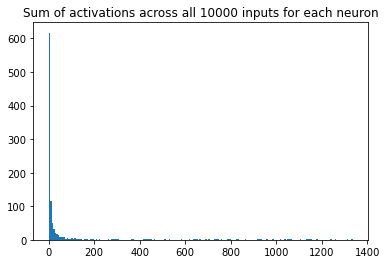

[617. 117.  50.  32.  19.  16.  13.   8.   8.   7.   8.   1.   5.   2.
   2.   5.   2.   6.   1.   3.   1.   3.   0.   1.   1.   2.   0.   1.
   2.   2.   0.   1.   0.   1.   0.   0.   0.   0.   0.   1.   0.   3.
   1.   1.   1.   1.   0.   0.   0.   0.   0.   0.   0.   0.   1.   1.
   0.   0.   0.   0.   0.   0.   1.   1.   1.   1.   1.   1.   0.   1.
   0.   0.   0.   0.   0.   0.   2.   0.   0.   1.   0.   0.   0.   0.
   0.   0.   0.   1.   0.   0.   0.   0.   2.   0.   0.   1.   1.   1.
   0.   1.   0.   0.   0.   1.   0.   1.   0.   0.   0.   1.   1.   1.
   0.   1.   0.   0.   0.   1.   1.   2.   0.   0.   0.   1.   1.   0.
   0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   0.   1.   2.   1.
   0.   0.   0.   1.   0.   0.   0.   1.   0.   0.   0.   0.   2.   0.
   0.   1.   0.   1.   1.   1.   0.   0.   0.   0.   0.   1.   0.   0.
   0.   1.   1.   2.   1.   0.   0.   0.   1.   0.   0.   0.   0.   0.
   0.   0.   0.   1.   0.   0.   1.   0.   0.   0.   0.   0.   0.   0.
   1. 

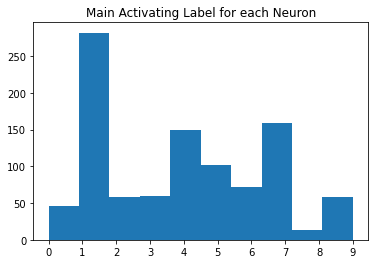

Neuron addresses should be 1000x784!!! (1000, 784) (1000, 784)
Euclidian distance


,0,1,2,3,4,5,6,7,8,9
0,0.000000,0.059224,0.048493,0.062380,0.059650,0.044958,0.060945,0.049423,0.132475,0.065442
1,0.059224,0.000000,0.045183,0.043866,0.026880,0.032524,0.042913,0.026731,0.125375,0.041243
2,0.048493,0.045183,0.000000,0.048473,0.050217,0.037809,0.052255,0.047081,0.126979,0.059961
3,0.062380,0.043866,0.048473,0.000000,0.045566,0.037726,0.058124,0.046459,0.128076,0.058817
4,0.059650,0.026880,0.050217,0.045566,0.000000,0.033214,0.044401,0.027457,0.125790,0.041054
5,0.044958,0.032524,0.037809,0.037726,0.033214,0.000000,0.048485,0.030227,0.103126,0.043481
6,0.060945,0.042913,0.052255,0.058124,0.044401,0.048485,0.000000,0.051055,0.137856,0.061304
7,0.049423,0.026731,0.047081,0.046459,0.027457,0.030227,0.051055,0.000000,0.124325,0.042401
8,0.132475,0.125375,0.126979,0.128076,0.125790,0.103126,0.137856,0.124325,0.000000,0.134333
9,0.065442,0.041243,0.059961,0.058817,0.041054,0.043481,0.061304,0.042401,0.134333,0.000000


cosine similarity


,0,1,2,3,4,5,6,7,8,9
0,1.000000,0.454914,0.628488,0.507291,0.477811,0.630682,0.561581,0.587528,0.426270,0.472061
1,0.454914,1.000000,0.545178,0.532922,0.648462,0.621778,0.624168,0.681848,0.411149,0.544067
2,0.628488,0.545178,1.000000,0.586920,0.518261,0.660265,0.600443,0.569069,0.439037,0.476616
3,0.507291,0.532922,0.586920,1.000000,0.542388,0.645831,0.542410,0.555792,0.426471,0.466764
4,0.477811,0.648462,0.518261,0.542388,1.000000,0.638071,0.621024,0.693606,0.417123,0.574026
5,0.630682,0.621778,0.660265,0.645831,0.638071,1.000000,0.601770,0.688666,0.559622,0.579215
6,0.561581,0.624168,0.600443,0.542410,0.621024,0.601770,1.000000,0.574598,0.400470,0.507244
7,0.587528,0.681848,0.569069,0.555792,0.693606,0.688666,0.574598,1.000000,0.433940,0.582196
8,0.426270,0.411149,0.439037,0.426471,0.417123,0.559622,0.400470,0.433940,1.000000,0.386879
9,0.472061,0.544067,0.476616,0.466764,0.574026,0.579215,0.507244,0.582196,0.386879,1.000000


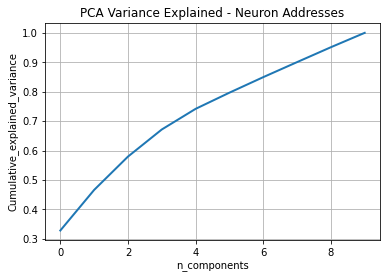

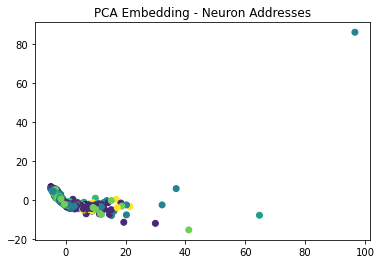

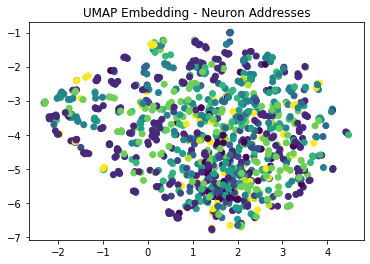

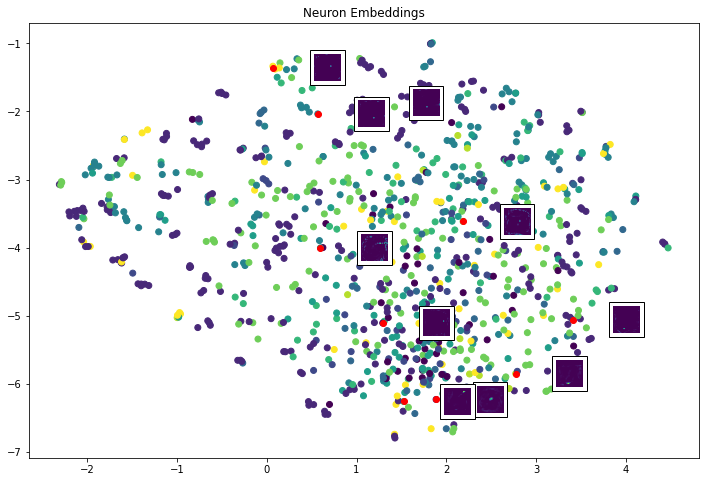

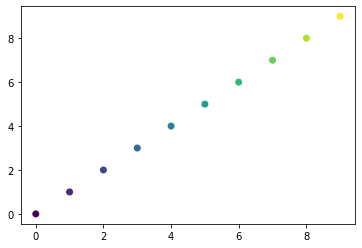

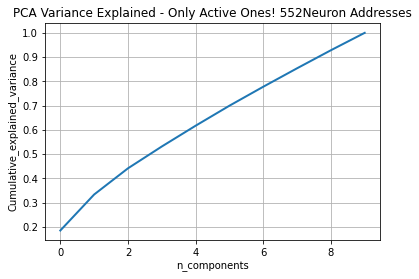

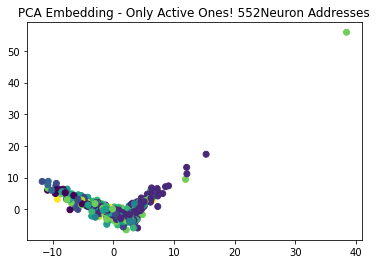

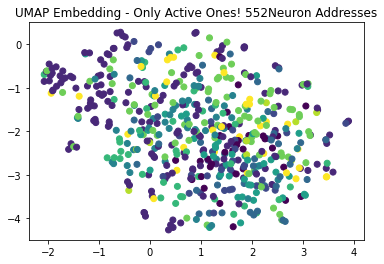

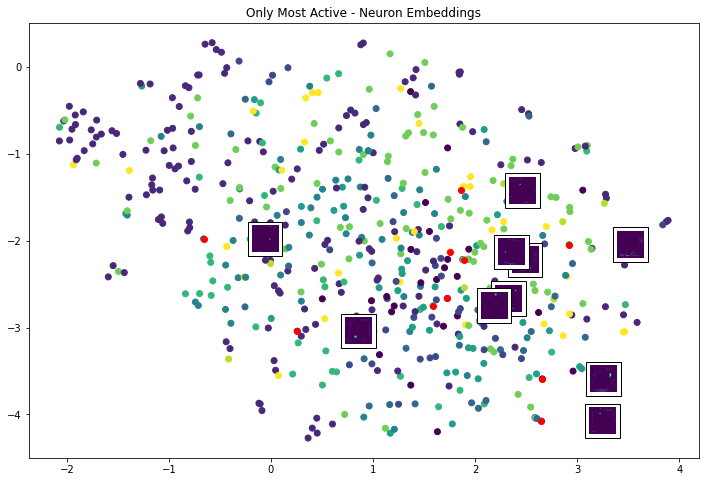

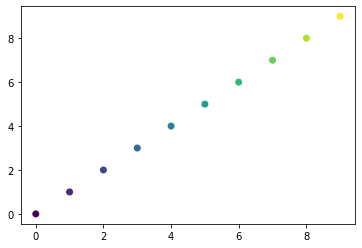

Giving some random plots from the most active neurons


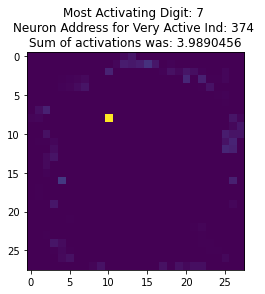

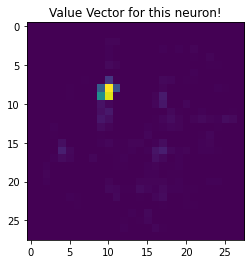

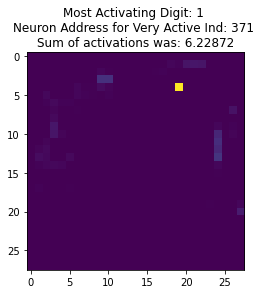

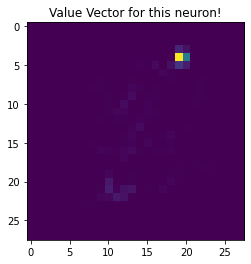

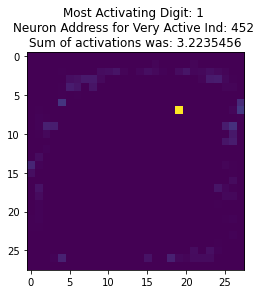

...

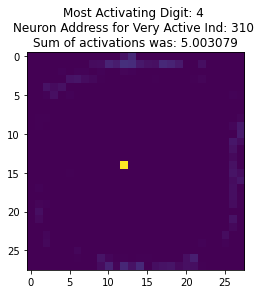

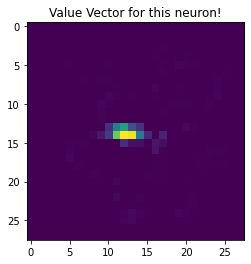

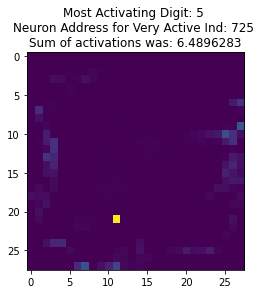

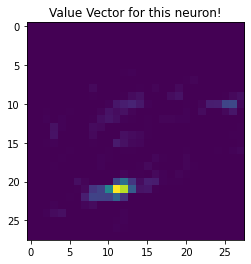

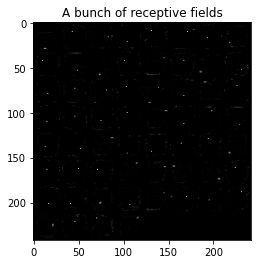

length of net parameters 2
[epoch, batch], [1,   250] loss: 0.000
mean actives 1000.0 1.0 % | max 1000 1.0 %
(128, 1000) shape of cosine sims


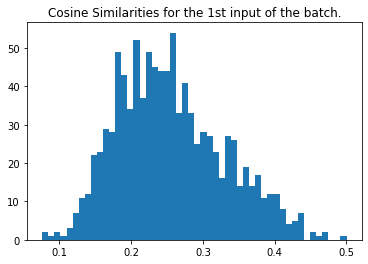

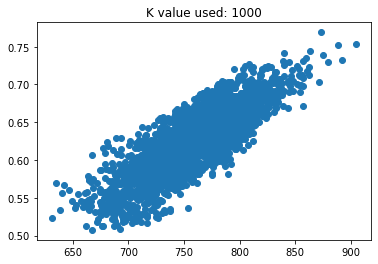

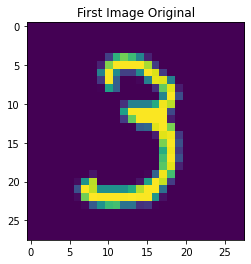

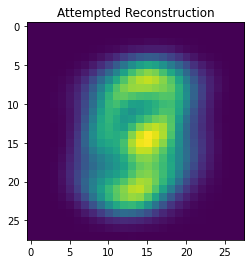

MSE loss for this input is:  0.0012612209788390569
train loss: 0.0009467462077736855 test loss: 0.0009184324881061912
[epoch, batch], [2,   250] loss: 0.000
mean actives 961.0 0.961 % | max 961 0.961 %
(128, 1000) shape of cosine sims


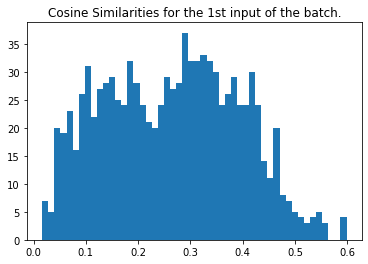

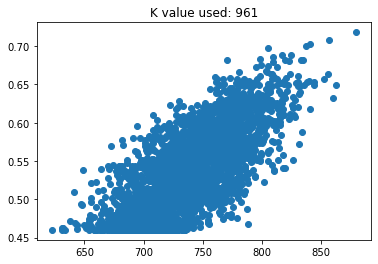

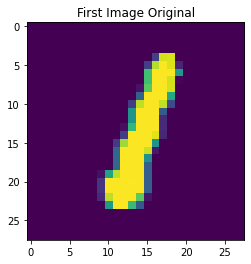

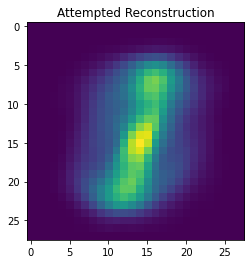

MSE loss for this input is:  0.0008169877133807357
train loss: 0.0007924629026092589 test loss: 0.0007616369985044003
[epoch, batch], [3,   250] loss: 0.000
mean actives 922.0 0.922 % | max 922 0.922 %
(128, 1000) shape of cosine sims


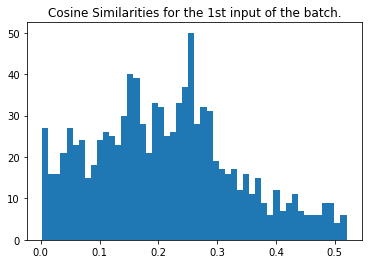

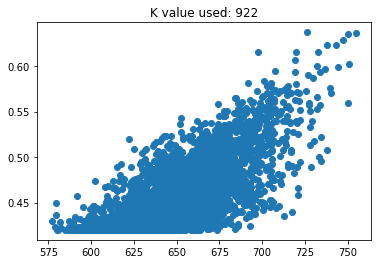

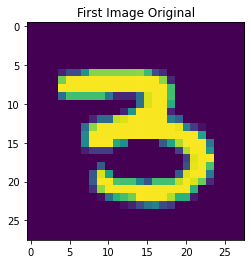

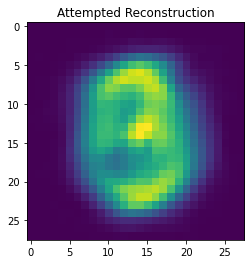

MSE loss for this input is:  0.0009554677775927953
train loss: 0.0006876687402836978 test loss: 0.0006634784513153136
[epoch, batch], [4,   250] loss: 0.000
mean actives 883.0 0.883 % | max 883 0.883 %
(128, 1000) shape of cosine sims


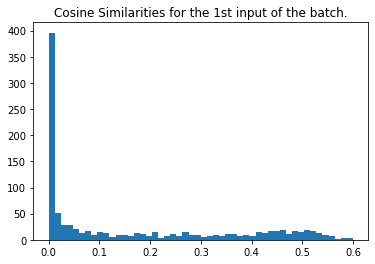

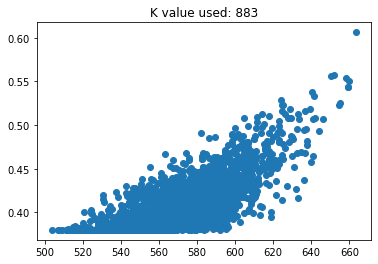

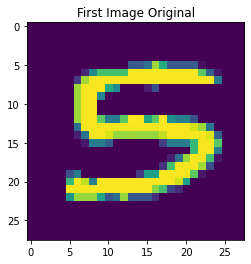

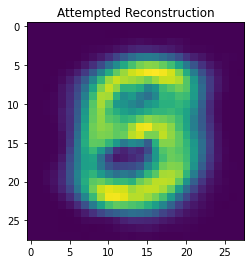

MSE loss for this input is:  0.0014304723970744075
train loss: 0.0005812837043777108 test loss: 0.0005409862496890128
[epoch, batch], [5,   250] loss: 0.000
mean actives 845.0 0.845 % | max 845 0.845 %
(128, 1000) shape of cosine sims


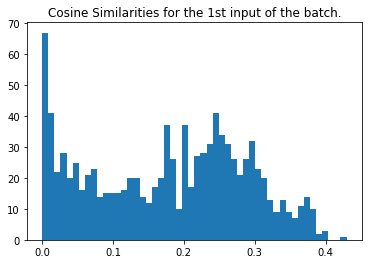

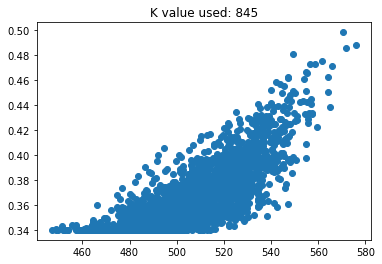

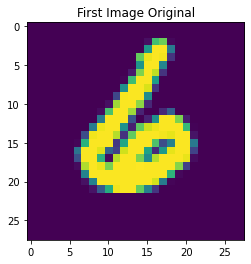

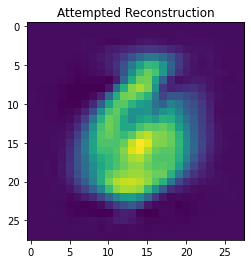

MSE loss for this input is:  0.0009243273157246259
train loss: 0.0005588008207269013 test loss: 0.0004898207844235003
[epoch, batch], [6,   250] loss: 0.000
mean actives 806.0 0.806 % | max 806 0.806 %
(128, 1000) shape of cosine sims


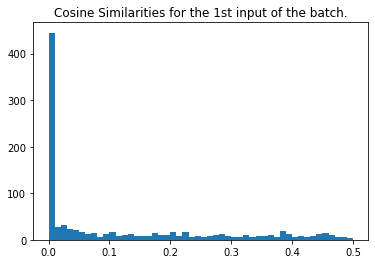

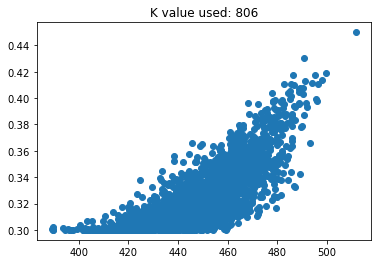

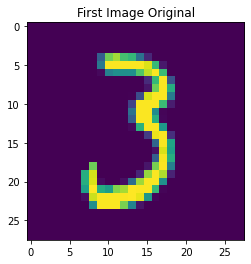

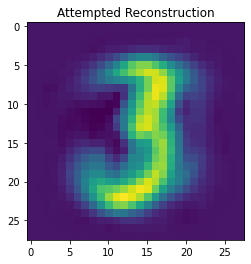

MSE loss for this input is:  0.0010624765893634484
train loss: 0.0004986671847291291 test loss: 0.0004275041283108294
[epoch, batch], [7,   250] loss: 0.000
mean actives 767.0 0.767 % | max 767 0.767 %
(128, 1000) shape of cosine sims


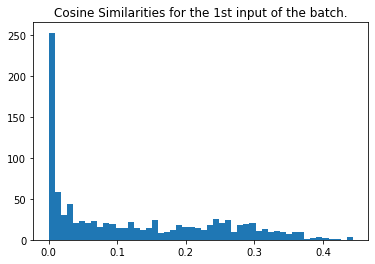

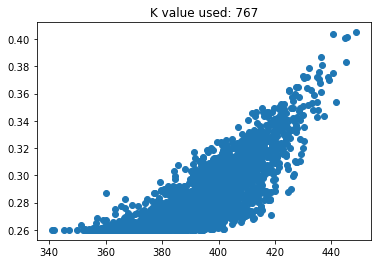

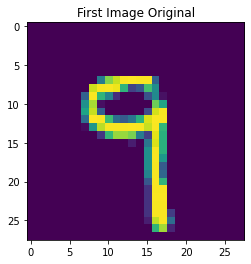

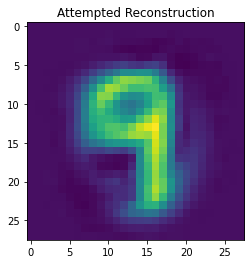

MSE loss for this input is:  0.0011214768247944967
train loss: 0.00040668572182767093 test loss: 0.0003897801216226071
[epoch, batch], [8,   250] loss: 0.000
mean actives 728.0 0.728 % | max 728 0.728 %
(128, 1000) shape of cosine sims


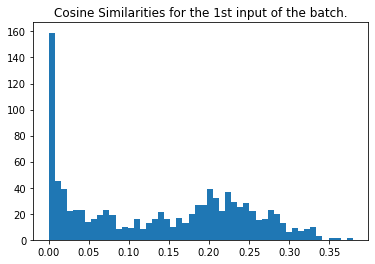

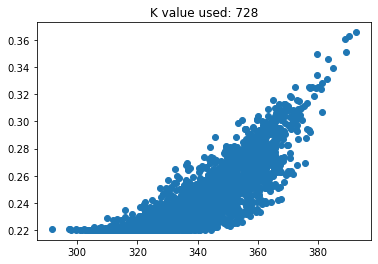

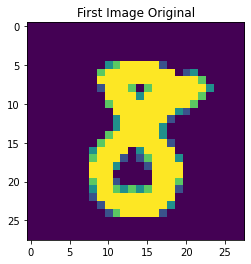

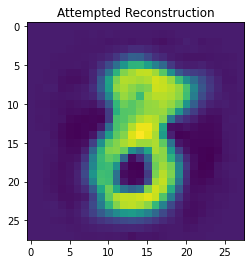

MSE loss for this input is:  0.0011699172307033927
train loss: 0.00037092590355314314 test loss: 0.00033451925264671445
[epoch, batch], [9,   250] loss: 0.000
mean actives 690.0 0.69 % | max 690 0.69 %
(128, 1000) shape of cosine sims


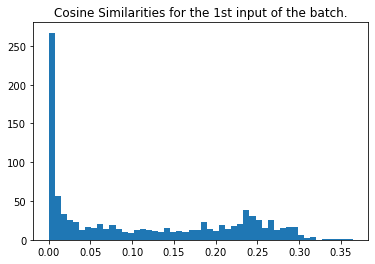

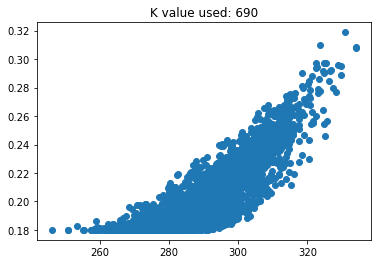

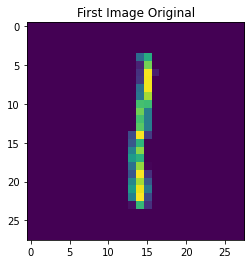

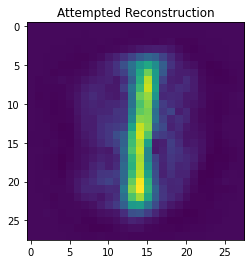

MSE loss for this input is:  0.0016431543900042164
train loss: 0.00030623775091953576 test loss: 0.00026919643278233707
[epoch, batch], [10,   250] loss: 0.000
mean actives 651.0 0.651 % | max 651 0.651 %
(128, 1000) shape of cosine sims


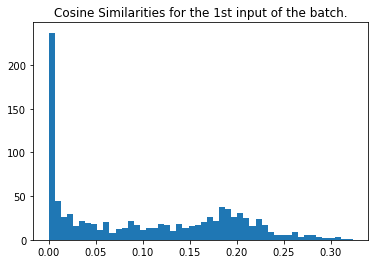

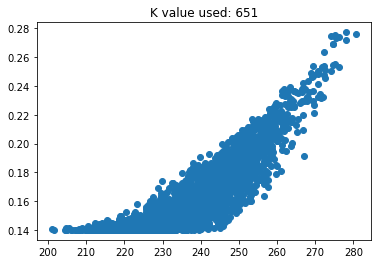

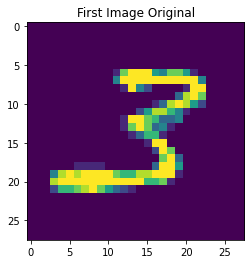

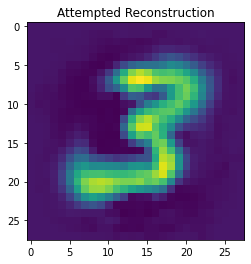

MSE loss for this input is:  0.0009578334889849837
train loss: 0.00023966228764038533 test loss: 0.0002168529899790883
[epoch, batch], [11,   250] loss: 0.000
mean actives 612.0 0.612 % | max 612 0.612 %
(128, 1000) shape of cosine sims


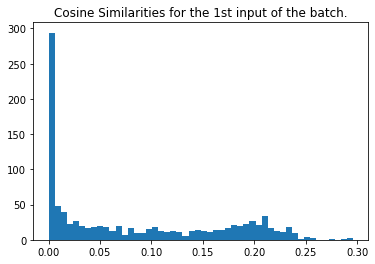

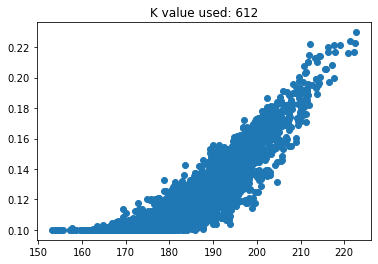

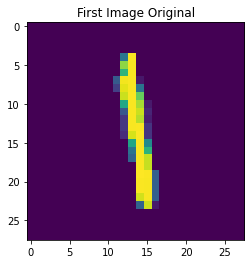

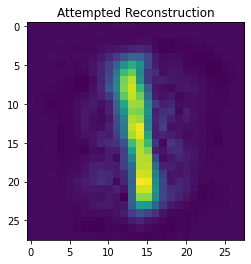

MSE loss for this input is:  0.0012281704313901005
train loss: 0.00019792819512076676 test loss: 0.00016885189688764513
[epoch, batch], [12,   250] loss: 0.000
mean actives 574.0 0.574 % | max 574 0.574 %
(128, 1000) shape of cosine sims


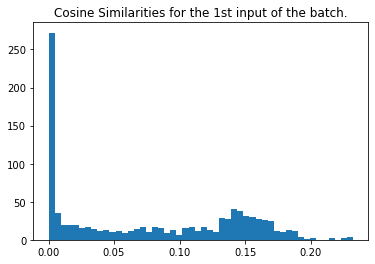

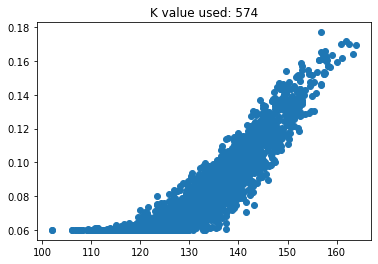

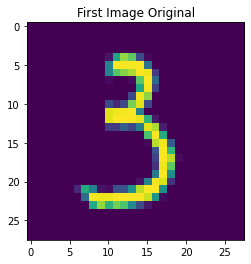

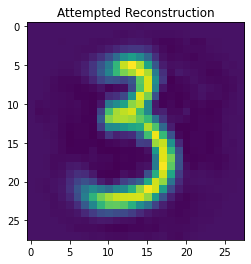

MSE loss for this input is:  0.0015474349564435531
train loss: 0.00014280420145951211 test loss: 0.0001081804366549477
[epoch, batch], [13,   250] loss: 0.000
mean actives 535.0 0.535 % | max 535 0.535 %
(128, 1000) shape of cosine sims


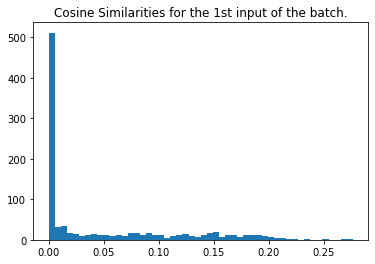

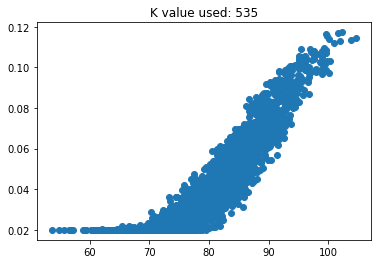

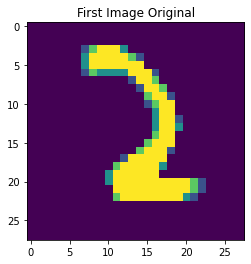

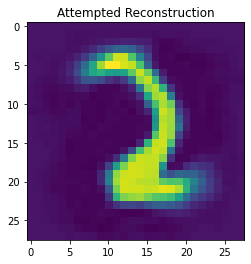

MSE loss for this input is:  0.0015374533071809886
train loss: 8.764910307945684e-05 test loss: 7.063333760015666e-05
[epoch, batch], [14,   250] loss: 0.000
mean actives 496.0 0.496 % | max 496 0.496 %
(128, 1000) shape of cosine sims


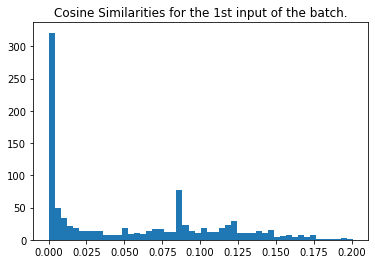

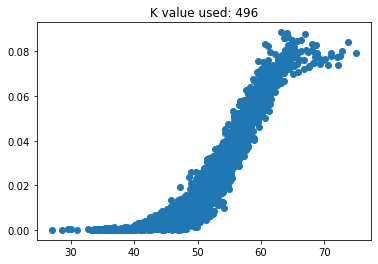

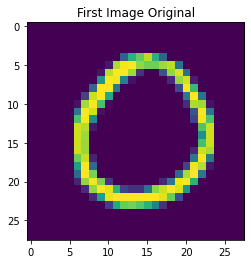

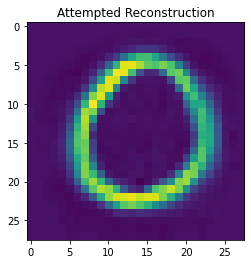

MSE loss for this input is:  0.0011147858993131288
train loss: 5.10850441060029e-05 test loss: 5.367406993173063e-05
[epoch, batch], [15,   250] loss: 0.000
mean actives 457.0 0.457 % | max 457 0.457 %
(128, 1000) shape of cosine sims


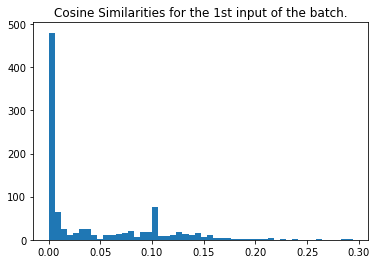

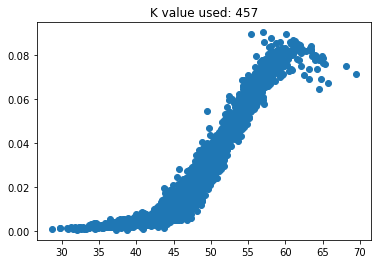

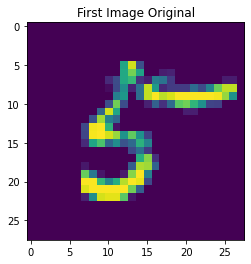

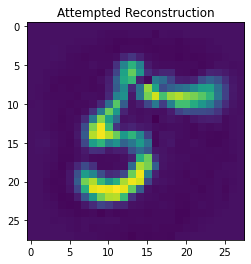

MSE loss for this input is:  0.0012806588593794375
train loss: 5.157067789696157e-05 test loss: 5.175472688279115e-05
[epoch, batch], [16,   250] loss: 0.000
mean actives 419.0 0.419 % | max 419 0.419 %
(128, 1000) shape of cosine sims


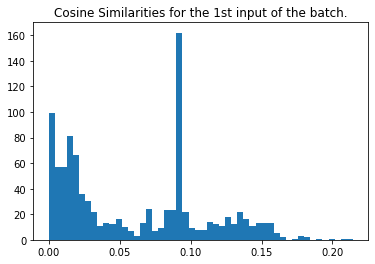

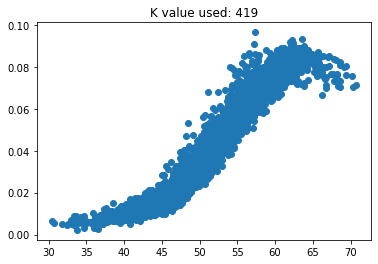

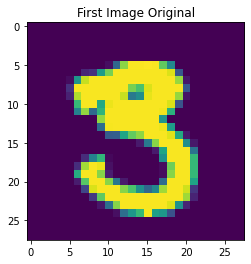

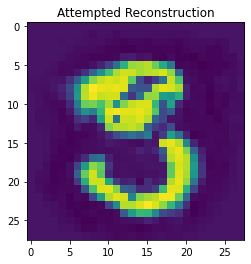

MSE loss for this input is:  0.0014878897642602725
train loss: 5.2878902351949364e-05 test loss: 5.459380190586671e-05
[epoch, batch], [17,   250] loss: 0.000
mean actives 380.0 0.38 % | max 380 0.38 %
(128, 1000) shape of cosine sims


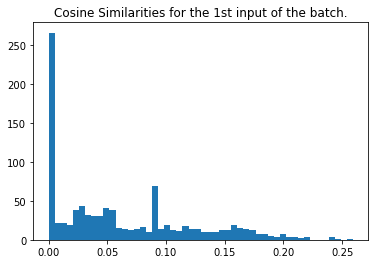

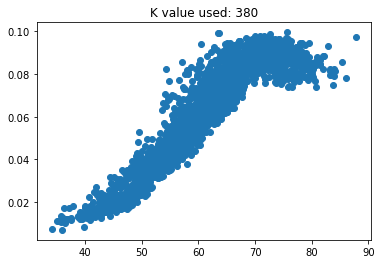

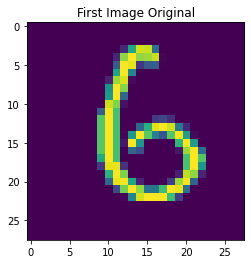

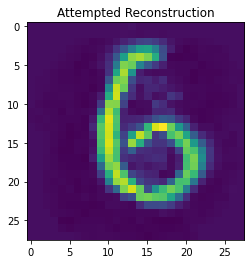

MSE loss for this input is:  0.0015718585678509303
train loss: 6.034222315065563e-05 test loss: 6.703797407681122e-05
[epoch, batch], [18,   250] loss: 0.000
mean actives 341.0 0.341 % | max 341 0.341 %
(128, 1000) shape of cosine sims


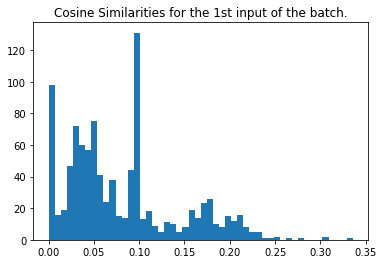

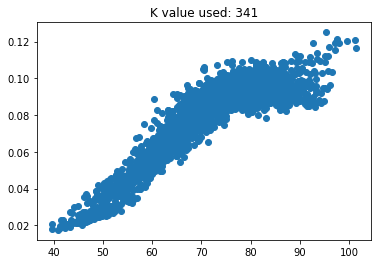

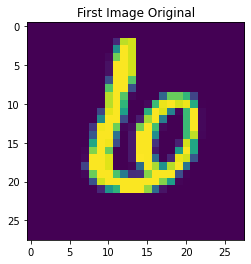

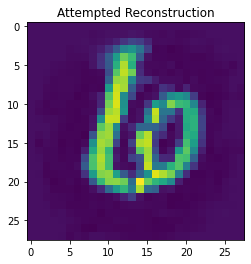

MSE loss for this input is:  0.0015356429681486013
train loss: 6.457075505750254e-05 test loss: 7.329087384277955e-05
[epoch, batch], [19,   250] loss: 0.000
mean actives 303.0 0.303 % | max 303 0.303 %
(128, 1000) shape of cosine sims


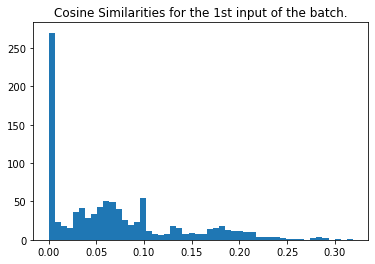

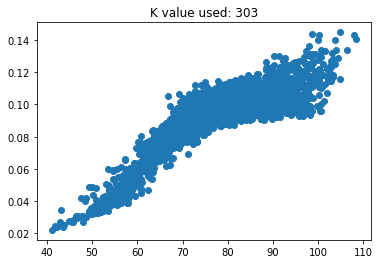

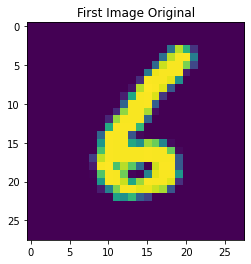

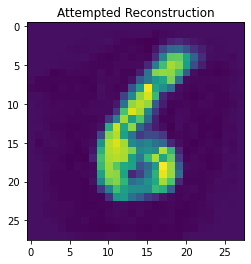

MSE loss for this input is:  0.0019093397624638615
train loss: 7.368203660007566e-05 test loss: 6.975528958719224e-05
[epoch, batch], [20,   250] loss: 0.000
mean actives 264.0 0.264 % | max 264 0.264 %
(128, 1000) shape of cosine sims


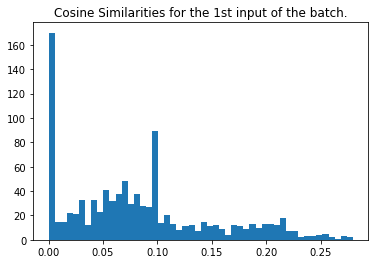

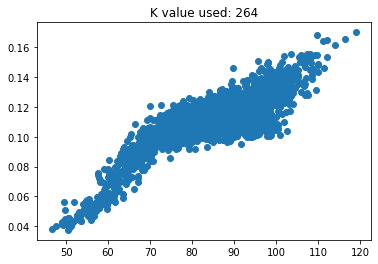

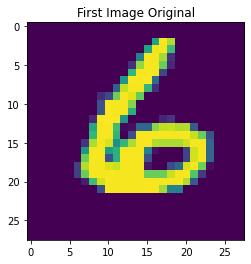

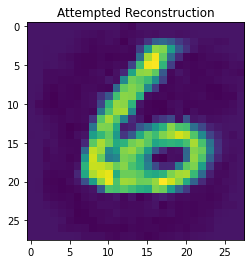

MSE loss for this input is:  0.0012563121866206734
train loss: 6.764965655747801e-05 test loss: 6.929866503924131e-05
[epoch, batch], [21,   250] loss: 0.000
mean actives 225.0 0.225 % | max 225 0.225 %
(128, 1000) shape of cosine sims


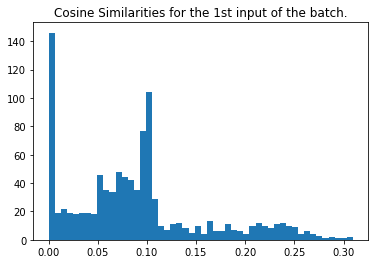

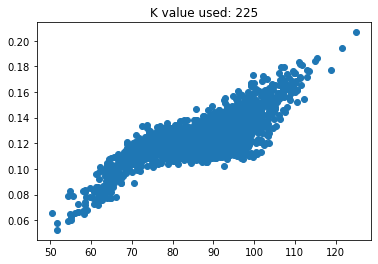

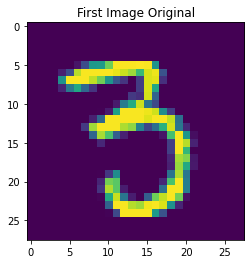

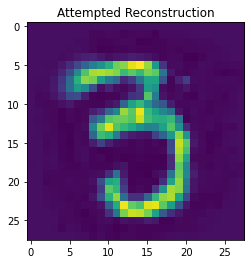

MSE loss for this input is:  0.0012520765315513222
train loss: 6.483317702077329e-05 test loss: 6.508327351184562e-05
[epoch, batch], [22,   250] loss: 0.000
mean actives 186.0 0.186 % | max 186 0.186 %
(128, 1000) shape of cosine sims


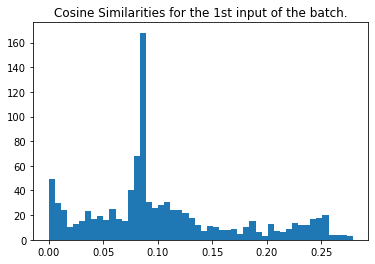

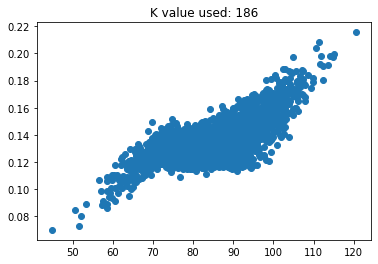

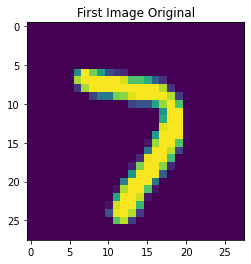

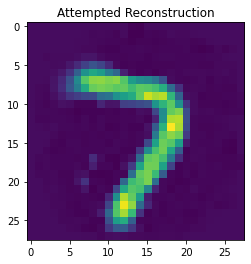

MSE loss for this input is:  0.0012701815184281797
train loss: 6.22150837443769e-05 test loss: 6.52689122944139e-05
[epoch, batch], [23,   250] loss: 0.000
mean actives 148.0 0.148 % | max 148 0.148 %
(128, 1000) shape of cosine sims


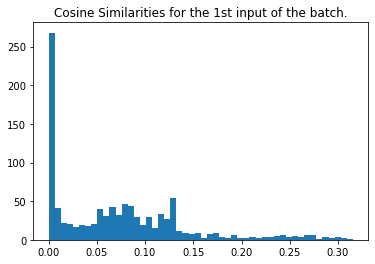

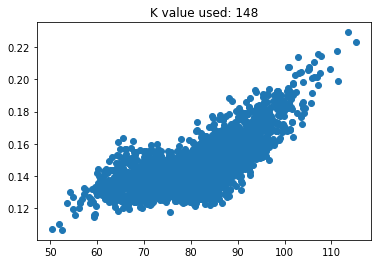

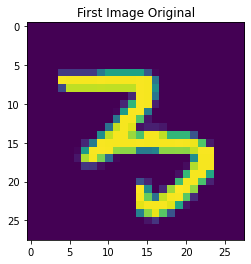

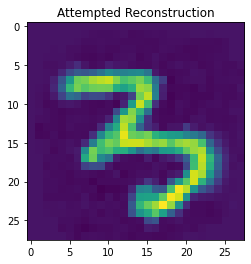

MSE loss for this input is:  0.001565148179628411
train loss: 6.172499706735834e-05 test loss: 6.588803080376238e-05
[epoch, batch], [24,   250] loss: 0.000
mean actives 109.0 0.109 % | max 109 0.109 %
(128, 1000) shape of cosine sims


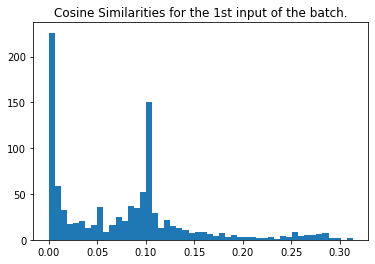

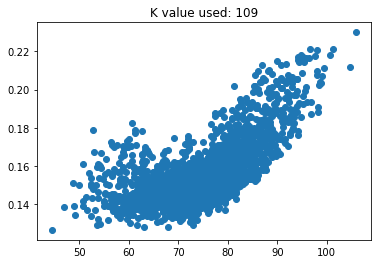

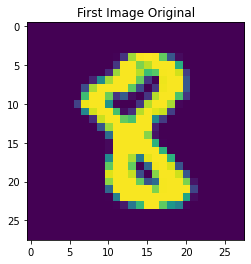

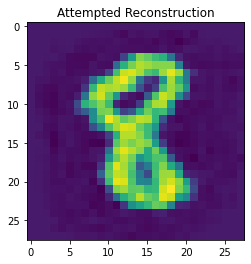

MSE loss for this input is:  0.0012095883792760422
train loss: 7.402579649351537e-05 test loss: 7.156270294217393e-05
[epoch, batch], [25,   250] loss: 0.000
mean actives 70.0 0.07 % | max 70 0.07 %
(128, 1000) shape of cosine sims


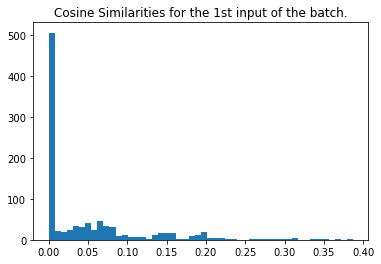

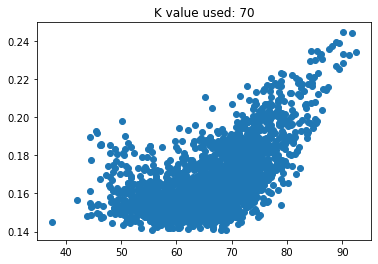

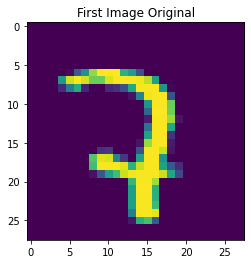

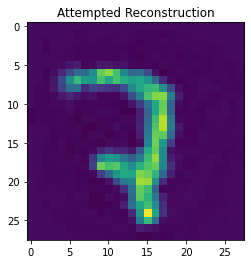

MSE loss for this input is:  0.0017244467625812609
train loss: 8.93793476279825e-05 test loss: 9.225736721418798e-05
[epoch, batch], [26,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


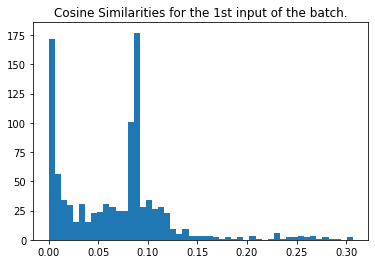

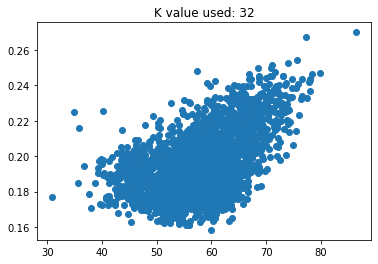

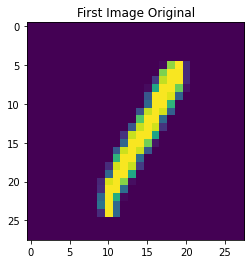

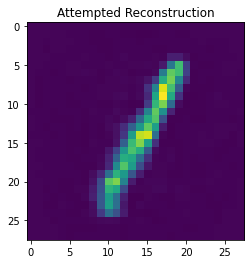

MSE loss for this input is:  0.0014327379817865333
train loss: 0.00015014679229352623 test loss: 0.00015101503231562674
[epoch, batch], [27,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


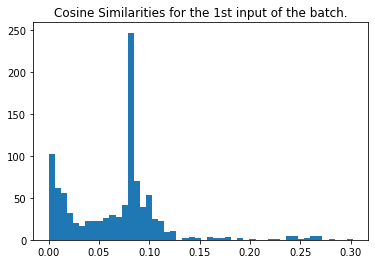

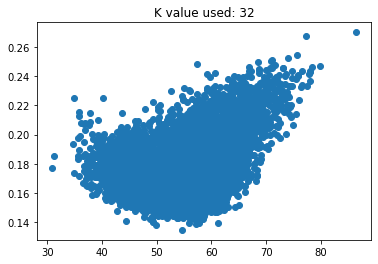

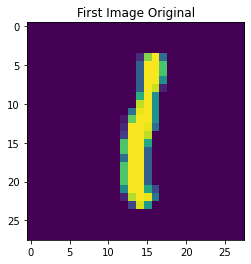

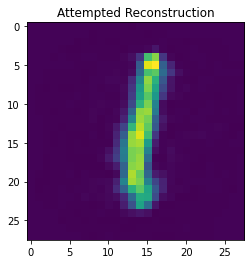

MSE loss for this input is:  0.0012609002997680586
train loss: 0.00014626439951825887 test loss: 0.00014846328122075647
[epoch, batch], [28,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


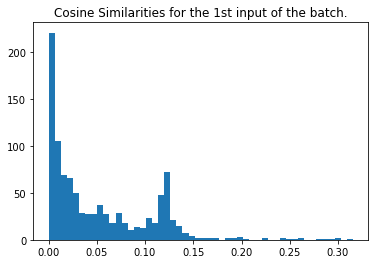

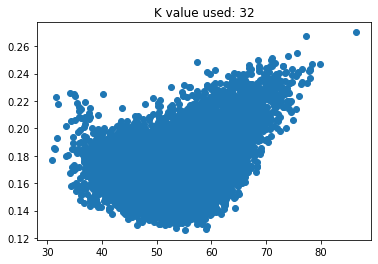

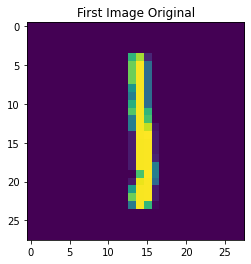

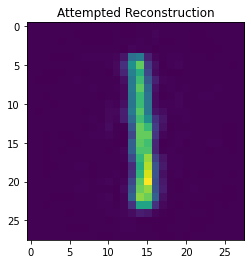

MSE loss for this input is:  0.0015348319192321934
train loss: 0.00014880439266562462 test loss: 0.00015373302449006587
[epoch, batch], [29,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


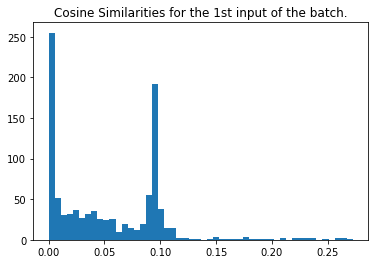

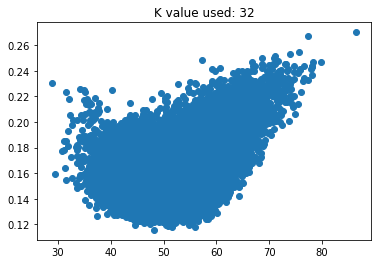

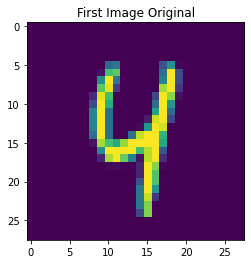

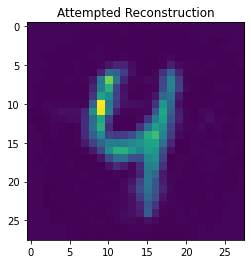

MSE loss for this input is:  0.0015975945458120229
train loss: 0.0001395869185216725 test loss: 0.0001418385363649577
[epoch, batch], [30,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


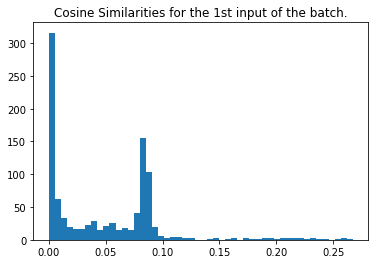

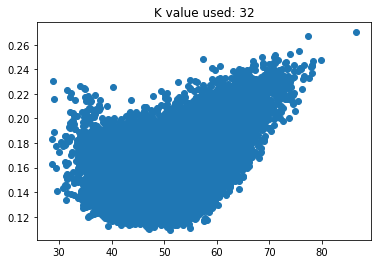

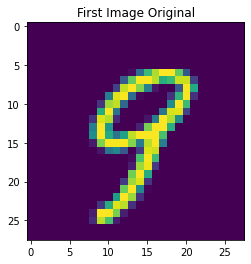

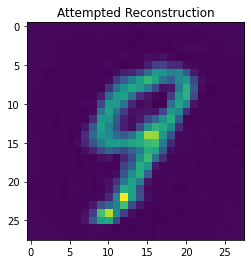

MSE loss for this input is:  0.0013051470931695433
train loss: 0.00014636603009421378 test loss: 0.0001494721946073696
[epoch, batch], [31,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


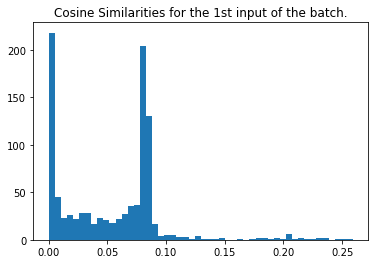

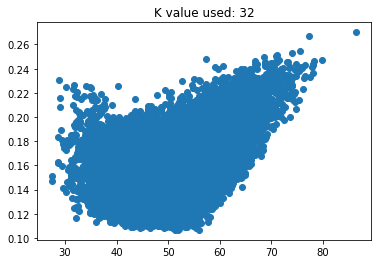

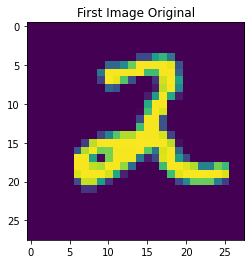

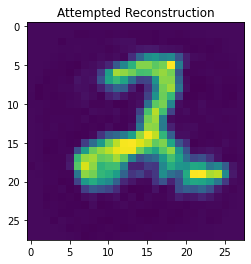

MSE loss for this input is:  0.0011318281901126004
train loss: 0.00015567739319521934 test loss: 0.00015232009172905236
[epoch, batch], [32,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


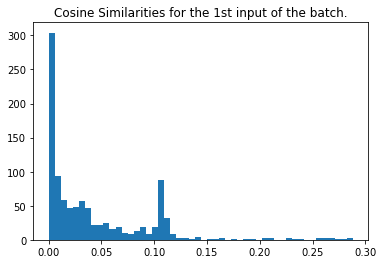

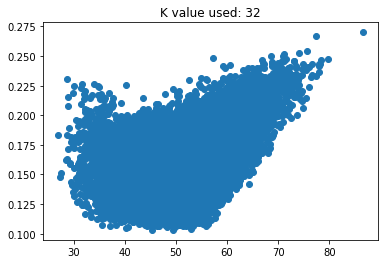

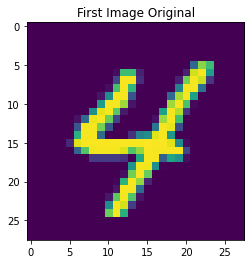

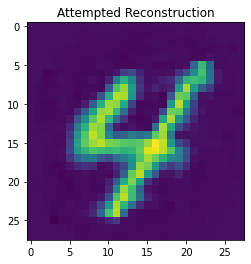

MSE loss for this input is:  0.0017952300152000115
train loss: 0.00014708087837789208 test loss: 0.00014162884326651692
[epoch, batch], [33,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


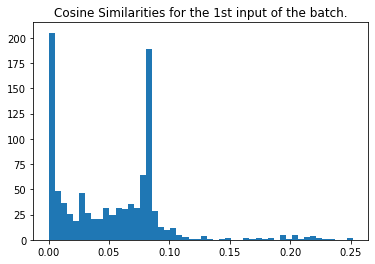

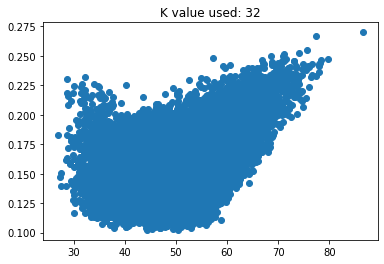

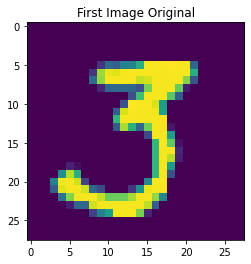

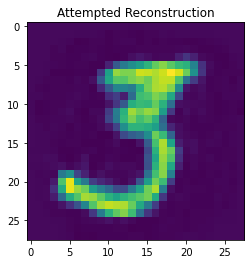

MSE loss for this input is:  0.0012883414723435227
train loss: 0.00014409987488761544 test loss: 0.00014798360643908381
[epoch, batch], [34,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


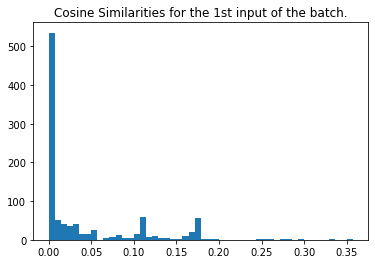

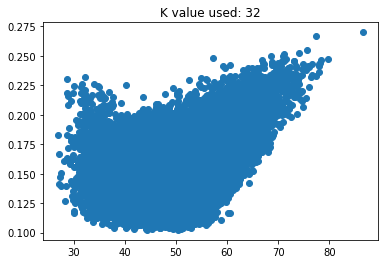

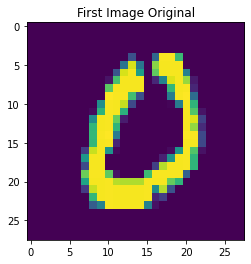

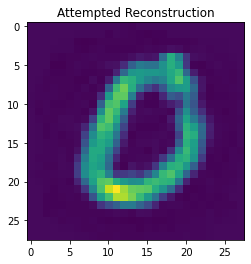

MSE loss for this input is:  0.0019697175950420145
train loss: 0.00015833416546229273 test loss: 0.00015496562991756946
[epoch, batch], [35,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


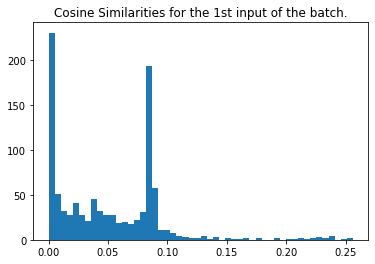

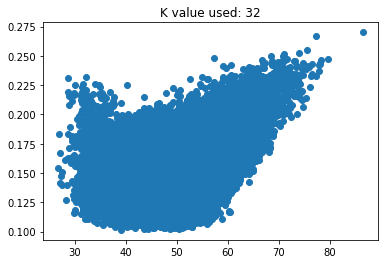

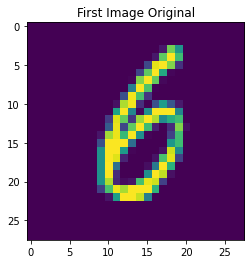

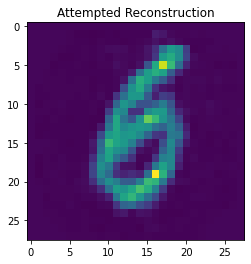

MSE loss for this input is:  0.0015595468635461768
train loss: 0.00014104778529144824 test loss: 0.0001550711167510599
[epoch, batch], [36,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


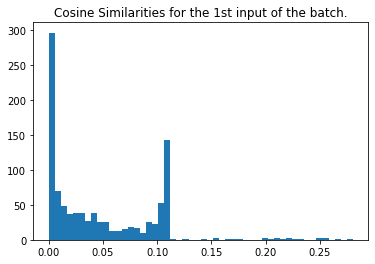

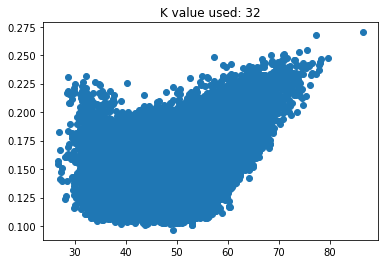

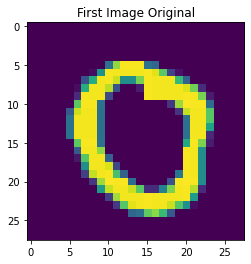

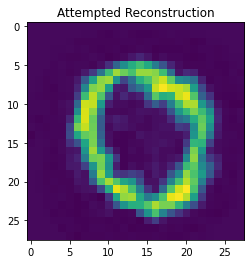

MSE loss for this input is:  0.0012957532795108094
train loss: 0.00015221521607600152 test loss: 0.0001579217059770599
[epoch, batch], [37,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


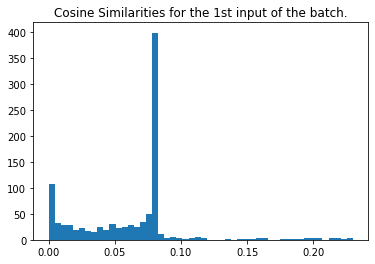

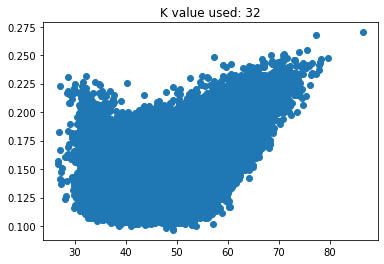

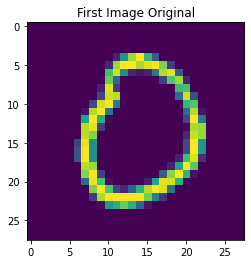

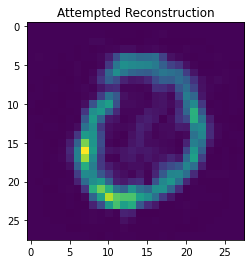

MSE loss for this input is:  0.0014838240280443309
train loss: 0.00015381192497443408 test loss: 0.00015200194320641458
[epoch, batch], [38,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


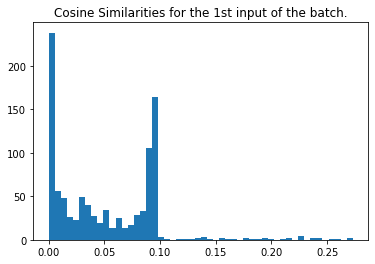

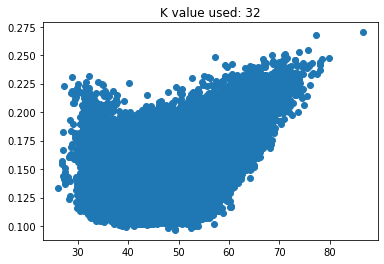

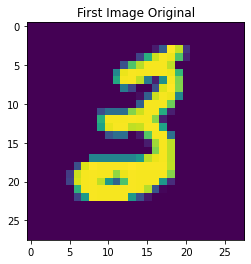

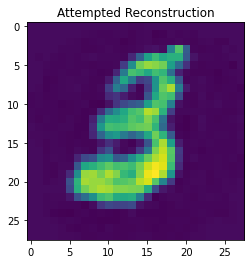

MSE loss for this input is:  0.0013941489920324208
train loss: 0.00015637159231118858 test loss: 0.00014604473835788667
[epoch, batch], [39,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


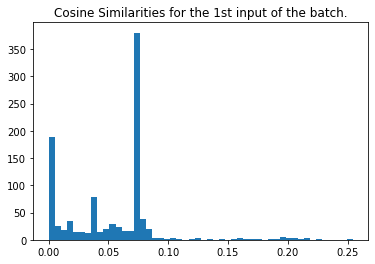

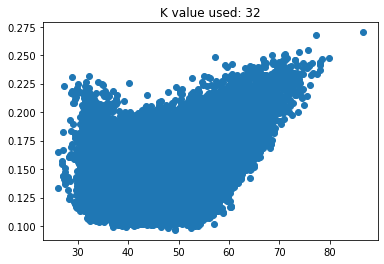

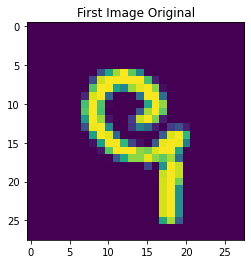

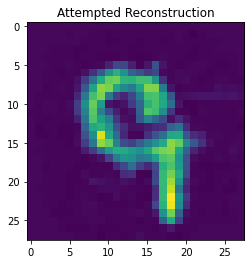

MSE loss for this input is:  0.00116024911403656
train loss: 0.00013915005547460169 test loss: 0.0001482057268731296
[epoch, batch], [40,   250] loss: 0.000
mean actives 32.0 0.032 % | max 32 0.032 %
(128, 1000) shape of cosine sims


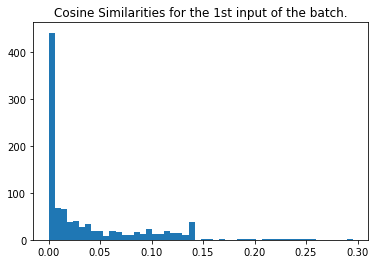

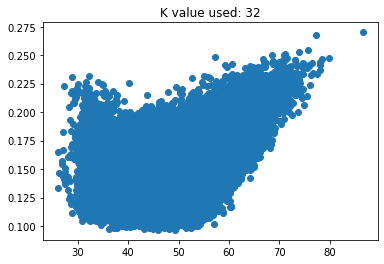

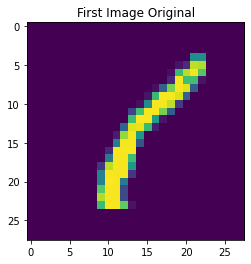

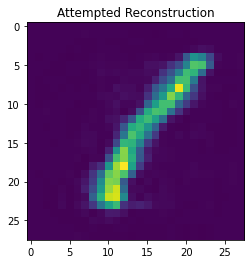

MSE loss for this input is:  0.0018334467800296083
train loss: 0.00015929184155538678 test loss: 0.00014653104881290346
Finished Training


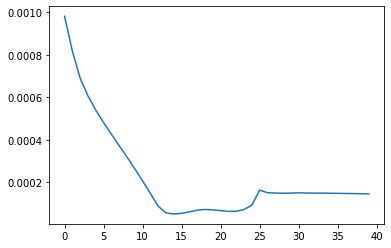

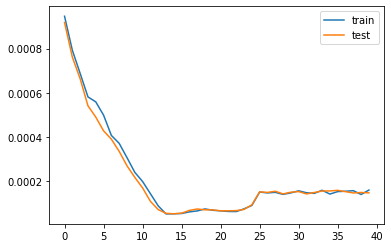

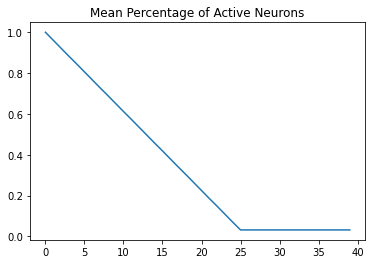

Latents and Labels dimensions: (60000, 1000) (60000,)
Latents and Labels dimensions: (10000, 1000) (10000,)
Logistic regression accuracy: Train= 0.879 | Test= 0.883


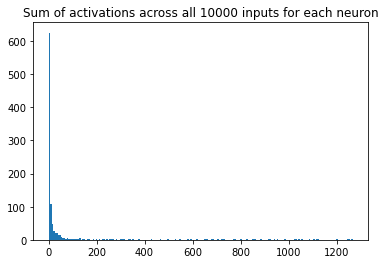

[625. 108.  48.  26.  22.  20.  15.  15.   9.   4.   4.   3.   5.   2.
   1.   3.   3.   2.   2.   1.   4.   0.   1.   1.   0.   2.   1.   0.
   0.   3.   0.   1.   0.   1.   0.   1.   1.   0.   1.   0.   1.   2.
   2.   0.   1.   0.   0.   1.   1.   1.   0.   0.   1.   2.   0.   1.
   0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   0.   1.   0.   0.
   0.   0.   0.   1.   0.   0.   0.   0.   1.   0.   0.   0.   0.   1.
   0.   0.   1.   0.   0.   0.   0.   1.   0.   2.   0.   0.   0.   1.
   0.   0.   0.   0.   1.   1.   2.   0.   0.   1.   1.   0.   0.   1.
   0.   1.   1.   1.   0.   0.   0.   0.   0.   1.   1.   0.   0.   0.
   1.   0.   0.   0.   1.   0.   0.   0.   1.   2.   0.   0.   0.   1.
   0.   0.   0.   0.   2.   1.   0.   0.   2.   0.   1.   0.   0.   0.
   0.   2.   0.   0.   0.   0.   0.   1.   1.   0.   2.   0.   2.   0.
   0.   0.   0.   1.   0.   0.   2.   0.   1.   1.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   2.   0.   0.   0.   0.   0.   0.
   1. 

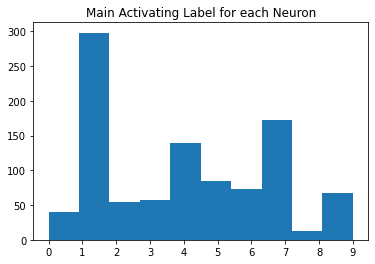

Neuron addresses should be 1000x784!!! (1000, 784) (1000, 784)
Euclidian distance


,0,1,2,3,4,5,6,7,8,9
0,0.000000,0.065848,0.049595,0.063294,0.064494,0.047218,0.058826,0.059210,0.105723,0.072542
1,0.065848,0.000000,0.049570,0.044674,0.029276,0.037663,0.037648,0.027863,0.106365,0.039297
2,0.049595,0.049570,0.000000,0.046197,0.049939,0.042402,0.048709,0.048565,0.107972,0.058178
3,0.063294,0.044674,0.046197,0.000000,0.047677,0.041866,0.051121,0.044678,0.107834,0.058129
4,0.064494,0.029276,0.049939,0.047677,0.000000,0.034439,0.034442,0.029669,0.104944,0.038008
5,0.047218,0.037663,0.042402,0.041866,0.034439,0.000000,0.043583,0.034179,0.084669,0.047516
6,0.058826,0.037648,0.048709,0.051121,0.034442,0.043583,0.000000,0.045862,0.112776,0.054868
7,0.059210,0.027863,0.048565,0.044678,0.029669,0.034179,0.045862,0.000000,0.103506,0.038956
8,0.105723,0.106365,0.107972,0.107834,0.104944,0.084669,0.112776,0.103506,0.000000,0.118183
9,0.072542,0.039297,0.058178,0.058129,0.038008,0.047516,0.054868,0.038956,0.118183,0.000000


cosine similarity


,0,1,2,3,4,5,6,7,8,9
0,1.000000,0.429206,0.646633,0.525667,0.478893,0.637582,0.565951,0.534381,0.497304,0.445525
1,0.429206,1.000000,0.526444,0.530291,0.641026,0.574642,0.622194,0.678031,0.424676,0.574819
2,0.646633,0.526444,1.000000,0.622546,0.555787,0.639703,0.608534,0.579262,0.466919,0.514734
3,0.525667,0.530291,0.622546,1.000000,0.539488,0.616020,0.562035,0.581740,0.453512,0.480551
4,0.478893,0.641026,0.555787,0.539488,1.000000,0.646556,0.677975,0.687195,0.450826,0.623183
5,0.637582,0.574642,0.639703,0.616020,0.646556,1.000000,0.609053,0.660916,0.585348,0.552915
6,0.565951,0.622194,0.608534,0.562035,0.677975,0.609053,1.000000,0.580475,0.429434,0.519690
7,0.534381,0.678031,0.579262,0.581740,0.687195,0.660916,0.580475,1.000000,0.465790,0.625661
8,0.497304,0.424676,0.466919,0.453512,0.450826,0.585348,0.429434,0.465790,1.000000,0.386918
9,0.445525,0.574819,0.514734,0.480551,0.623183,0.552915,0.519690,0.625661,0.386918,1.000000


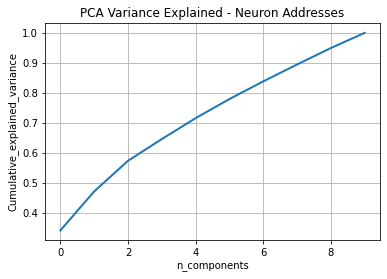

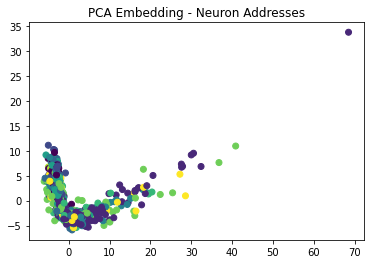

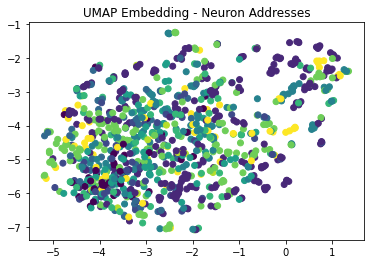

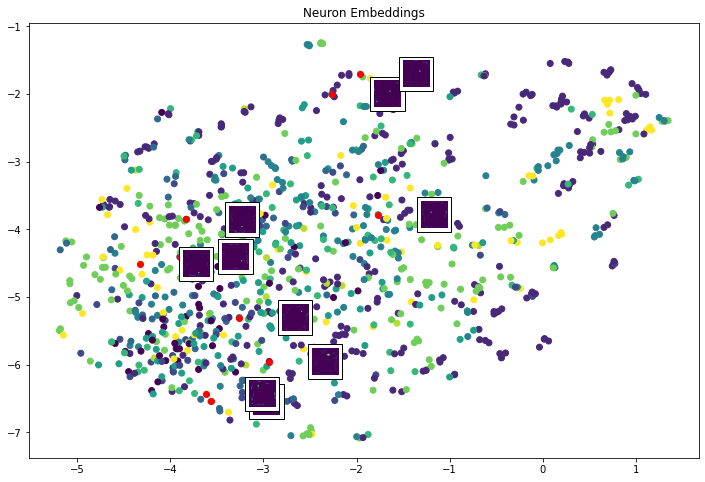

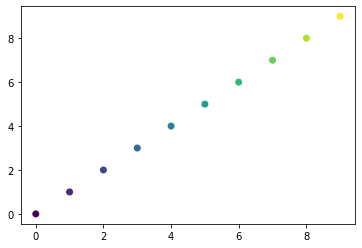

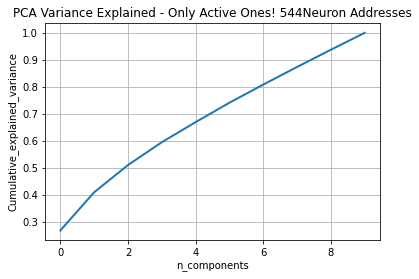

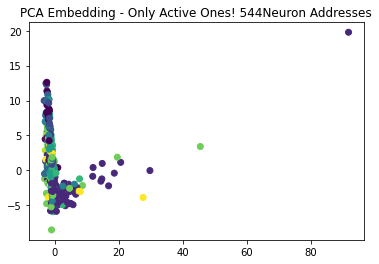

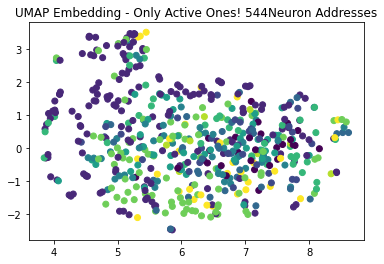

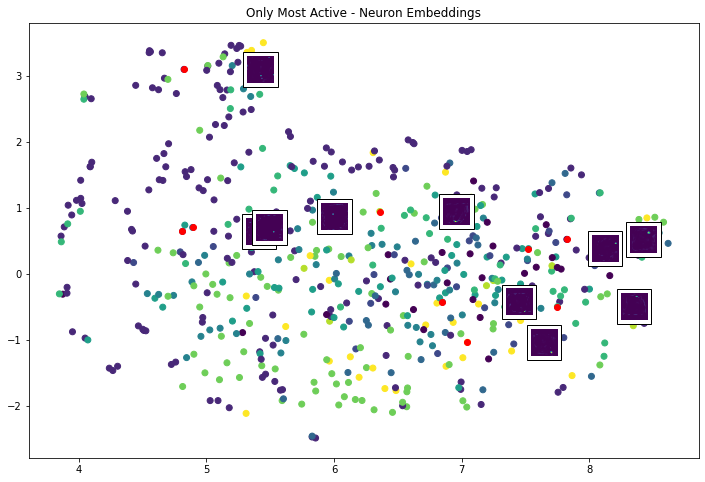

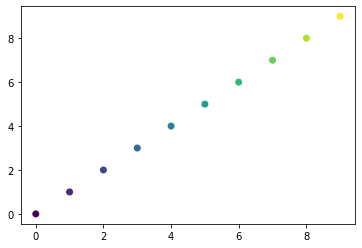

Giving some random plots from the most active neurons


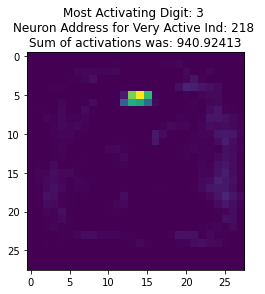

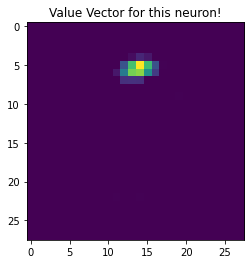

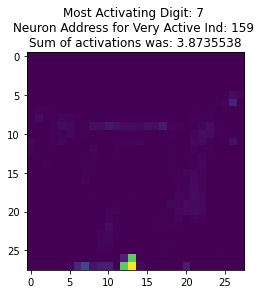

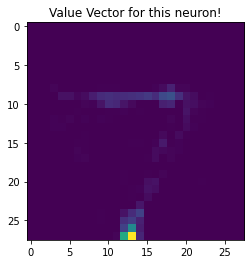

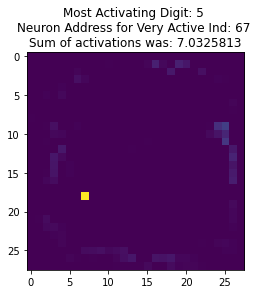

...

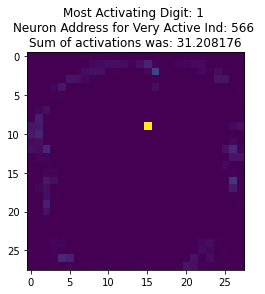

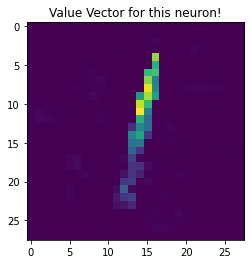

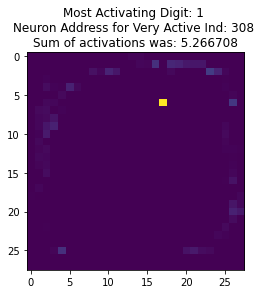

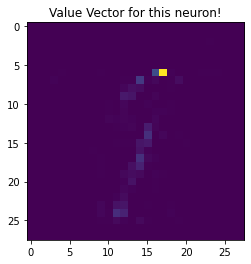

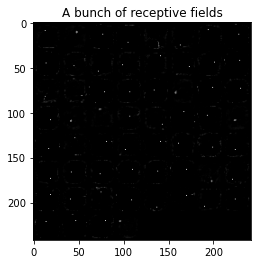

==================== K= 42 ===================
length of net parameters 2
[epoch, batch], [1,   250] loss: 0.000
mean actives 1000.0 1.0 % | max 1000 1.0 %
(128, 1000) shape of cosine sims


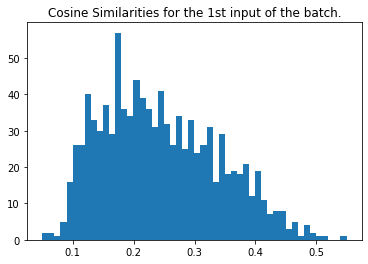

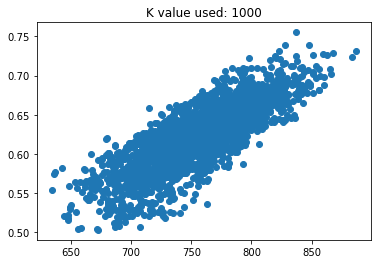

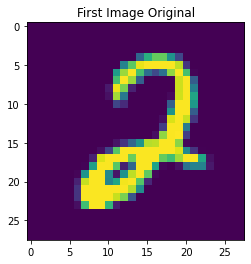

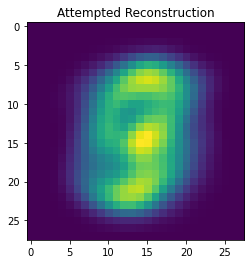

MSE loss for this input is:  0.0007536003784257538
train loss: 0.0009098847513087094 test loss: 0.0008970965864136815
[epoch, batch], [2,   250] loss: 0.000
mean actives 961.0 0.961 % | max 961 0.961 %
(128, 1000) shape of cosine sims


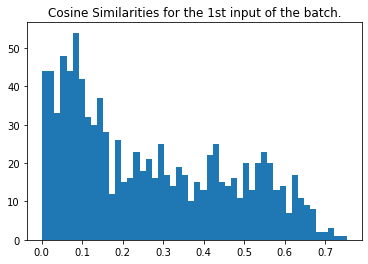

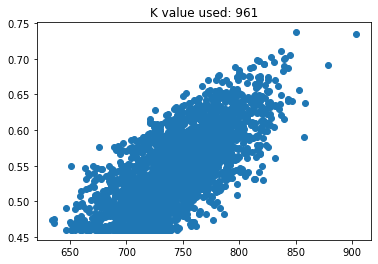

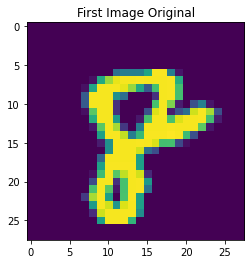

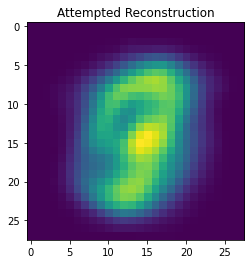

MSE loss for this input is:  0.0011058326582519375
train loss: 0.000743263924960047 test loss: 0.0007897973409853876
[epoch, batch], [3,   250] loss: 0.000
mean actives 923.0 0.923 % | max 923 0.923 %
(128, 1000) shape of cosine sims


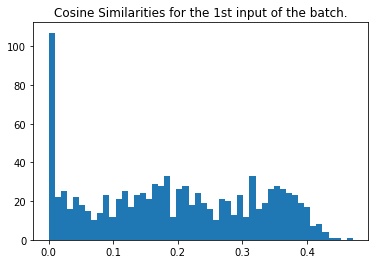

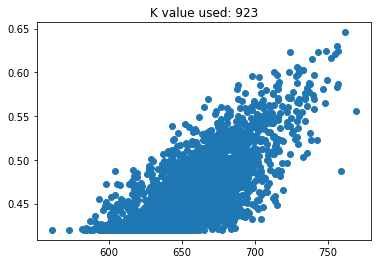

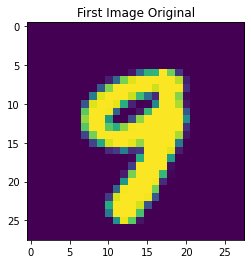

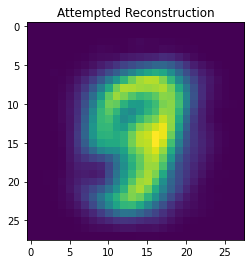

MSE loss for this input is:  0.001428093229021345
train loss: 0.0006636892794631422 test loss: 0.0006390691269189119
[epoch, batch], [4,   250] loss: 0.000
mean actives 885.0 0.885 % | max 885 0.885 %
(128, 1000) shape of cosine sims


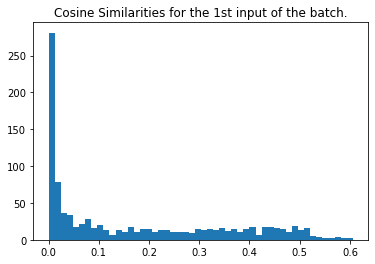

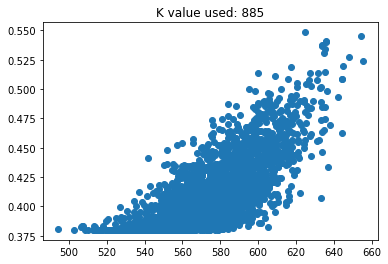

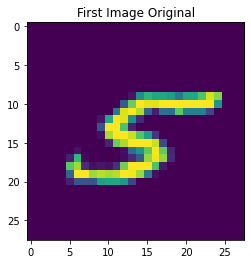

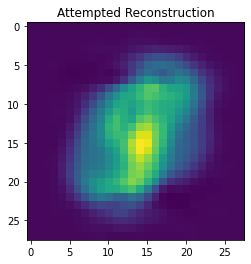

MSE loss for this input is:  0.0009573704886193178
train loss: 0.000586292939260602 test loss: 0.0005274748546071351
[epoch, batch], [5,   250] loss: 0.000
mean actives 846.0 0.846 % | max 846 0.846 %
(128, 1000) shape of cosine sims


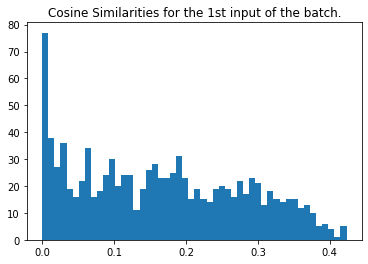

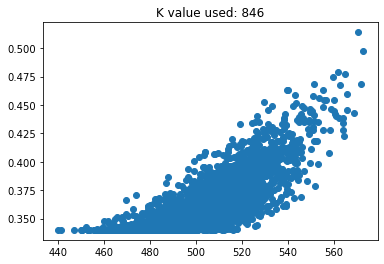

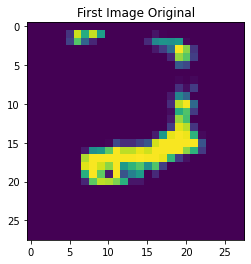

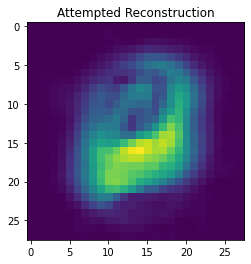

MSE loss for this input is:  0.0009383802511254136
train loss: 0.0005331758875399828 test loss: 0.000515489955432713
[epoch, batch], [6,   250] loss: 0.000
mean actives 808.0 0.808 % | max 808 0.808 %
(128, 1000) shape of cosine sims


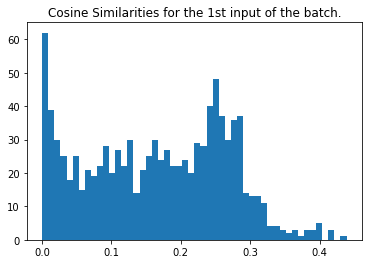

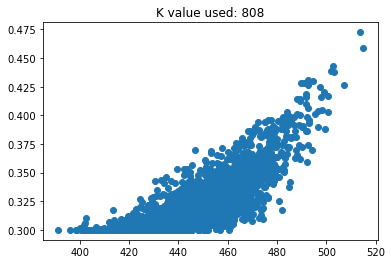

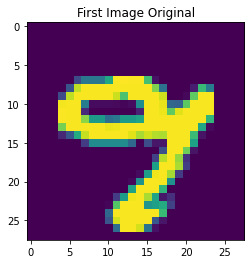

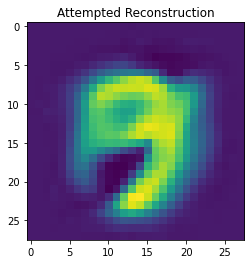

MSE loss for this input is:  0.0010228310616648927
train loss: 0.0004910089774057269 test loss: 0.00043588021071627736
[epoch, batch], [7,   250] loss: 0.000
mean actives 770.0 0.77 % | max 770 0.77 %
(128, 1000) shape of cosine sims


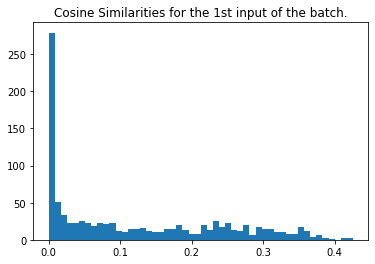

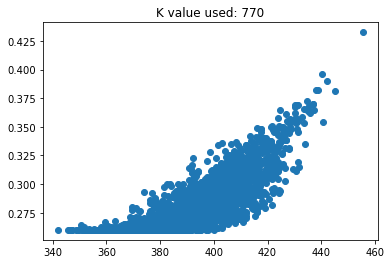

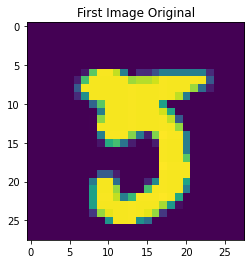

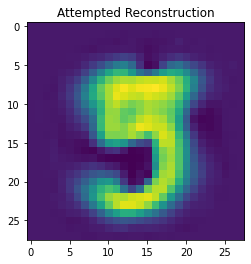

MSE loss for this input is:  0.0011066495611959575
train loss: 0.0004380343889351934 test loss: 0.00037168621201999485
[epoch, batch], [8,   250] loss: 0.000
mean actives 731.0 0.731 % | max 731 0.731 %
(128, 1000) shape of cosine sims


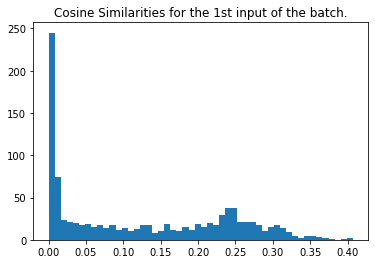

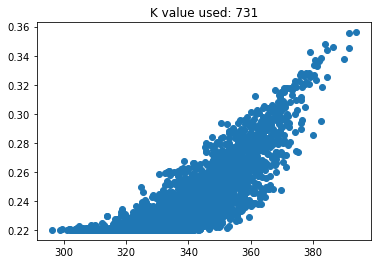

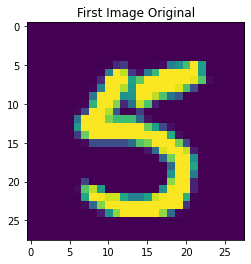

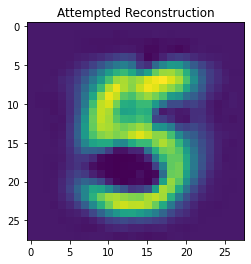

MSE loss for this input is:  0.001753479242324829
train loss: 0.0003727325820364058 test loss: 0.0003124924551229924
[epoch, batch], [9,   250] loss: 0.000
mean actives 693.0 0.693 % | max 693 0.693 %
(128, 1000) shape of cosine sims


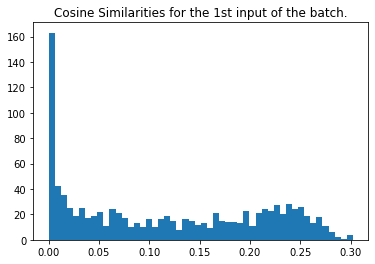

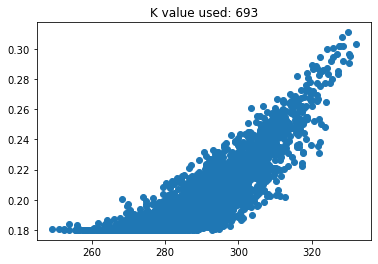

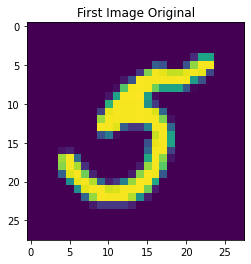

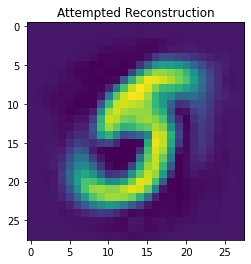

MSE loss for this input is:  0.001107565602477716
train loss: 0.00032525250571779907 test loss: 0.0002807419514283538
[epoch, batch], [10,   250] loss: 0.000
mean actives 655.0 0.655 % | max 655 0.655 %
(128, 1000) shape of cosine sims


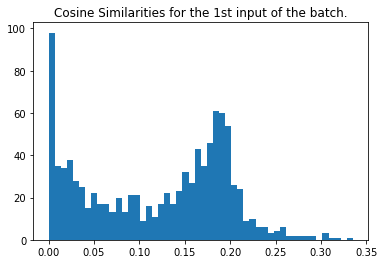

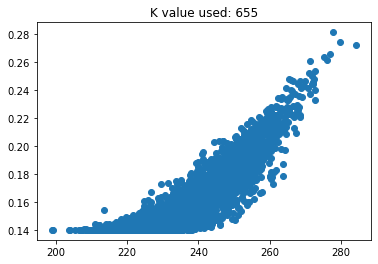

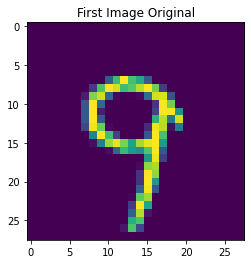

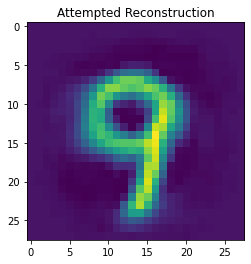

MSE loss for this input is:  0.0015459893917550845
train loss: 0.00028360215947031975 test loss: 0.00022794652613811195
[epoch, batch], [11,   250] loss: 0.000
mean actives 616.0 0.616 % | max 616 0.616 %
(128, 1000) shape of cosine sims


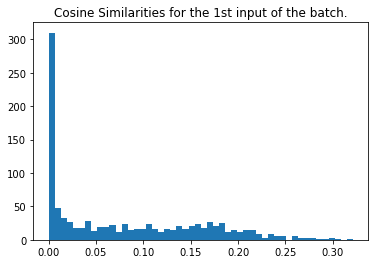

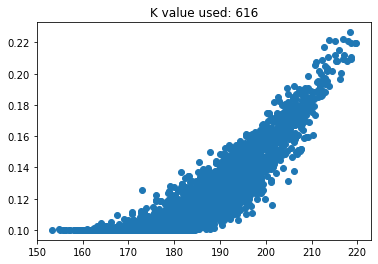

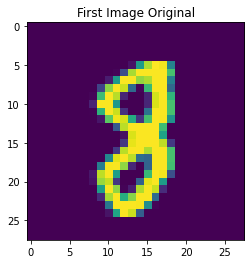

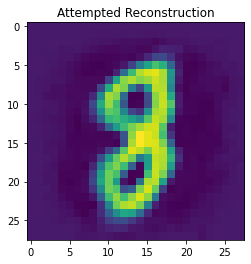

MSE loss for this input is:  0.0017831894207973869
train loss: 0.00022032689594198018 test loss: 0.00017833724268712103
[epoch, batch], [12,   250] loss: 0.000
mean actives 578.0 0.578 % | max 578 0.578 %
(128, 1000) shape of cosine sims


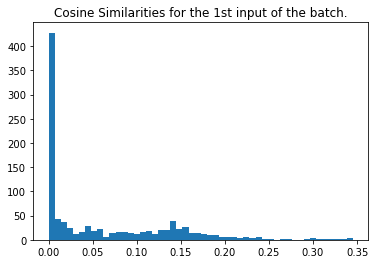

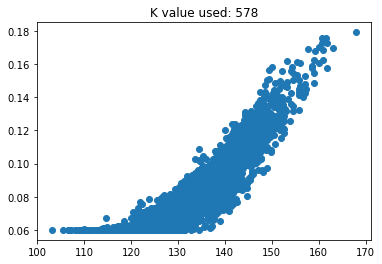

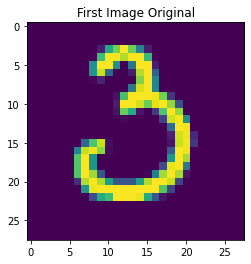

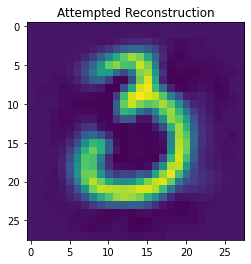

MSE loss for this input is:  0.0017562624143094433
train loss: 0.00013229479372967035 test loss: 0.0001191850533359684
[epoch, batch], [13,   250] loss: 0.000
mean actives 540.0 0.54 % | max 540 0.54 %
(128, 1000) shape of cosine sims


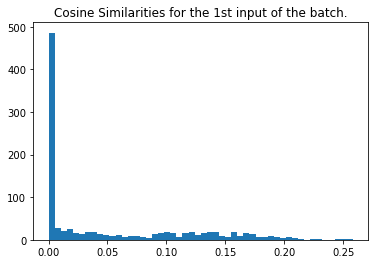

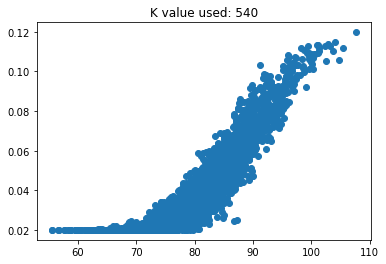

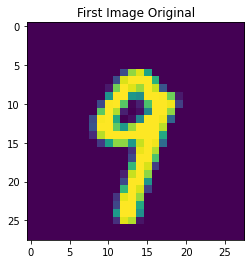

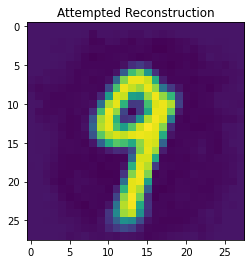

MSE loss for this input is:  0.0016460053774775291
train loss: 7.998519140528515e-05 test loss: 7.360535528277978e-05
[epoch, batch], [14,   250] loss: 0.000
mean actives 501.0 0.501 % | max 501 0.501 %
(128, 1000) shape of cosine sims


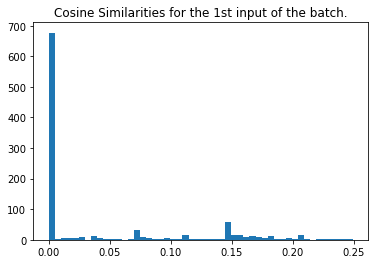

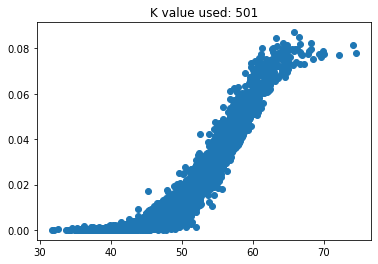

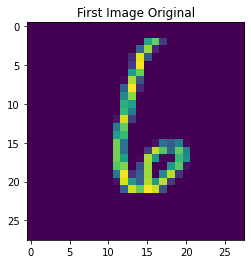

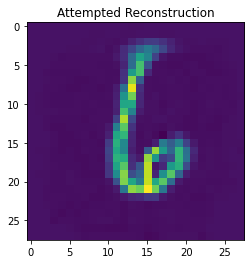

MSE loss for this input is:  0.0020768409784959288
train loss: 4.9075875722337514e-05 test loss: 5.538843834074214e-05
[epoch, batch], [15,   250] loss: 0.000
mean actives 463.0 0.463 % | max 463 0.463 %
(128, 1000) shape of cosine sims


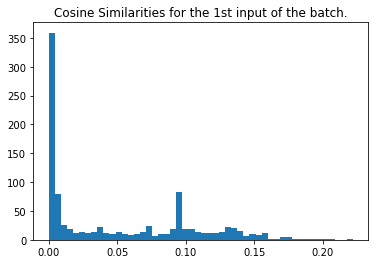

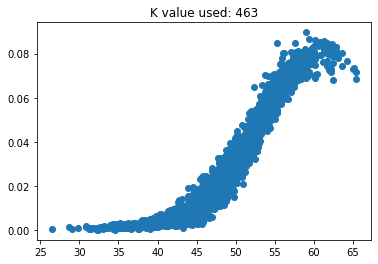

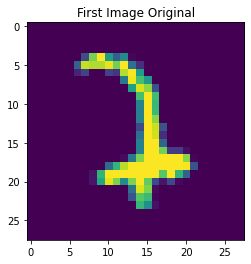

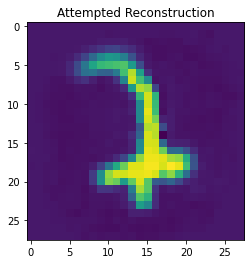

MSE loss for this input is:  0.0013812193456961184
train loss: 5.2727991715073586e-05 test loss: 4.839540633838624e-05
[epoch, batch], [16,   250] loss: 0.000
mean actives 425.0 0.425 % | max 425 0.425 %
(128, 1000) shape of cosine sims


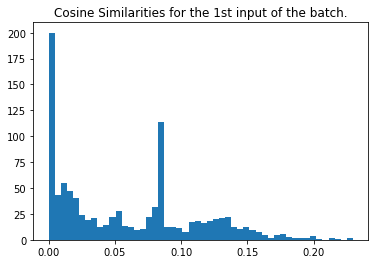

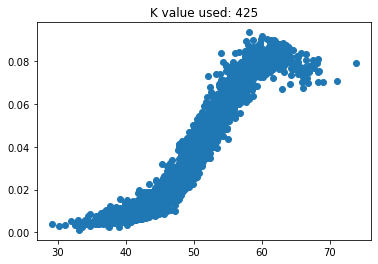

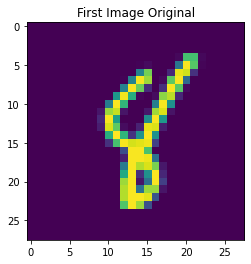

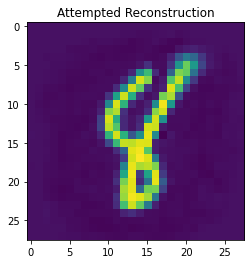

MSE loss for this input is:  0.001563591616494315
train loss: 5.491591218742542e-05 test loss: 5.045103534939699e-05
[epoch, batch], [17,   250] loss: 0.000
mean actives 386.0 0.386 % | max 386 0.386 %
(128, 1000) shape of cosine sims


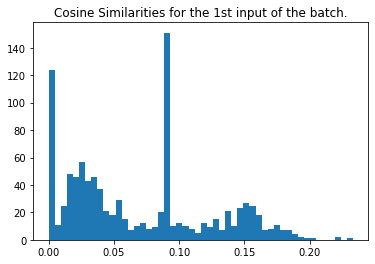

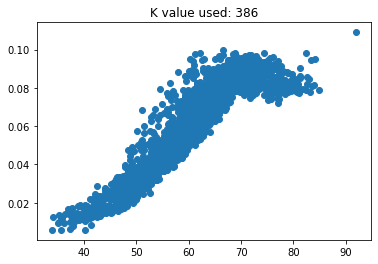

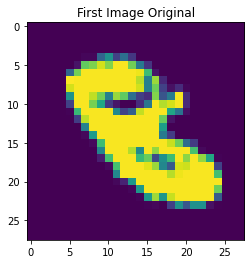

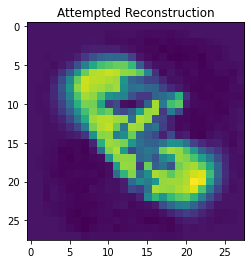

MSE loss for this input is:  0.0010325936030368417
train loss: 5.7497825764585286e-05 test loss: 6.367159221554175e-05
[epoch, batch], [18,   250] loss: 0.000
mean actives 348.0 0.348 % | max 348 0.348 %
(128, 1000) shape of cosine sims


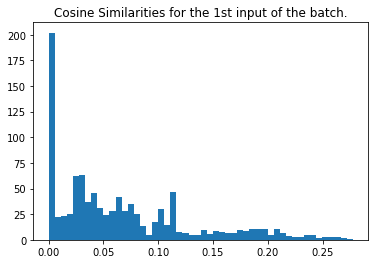

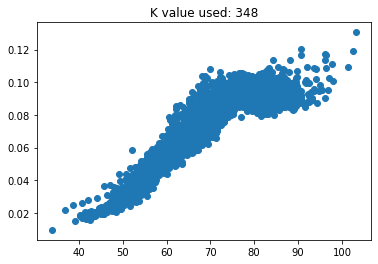

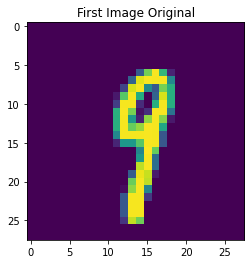

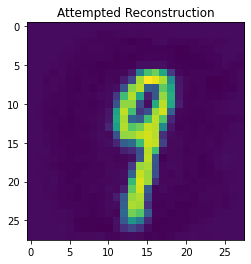

MSE loss for this input is:  0.001759006052601094
train loss: 7.040929631330073e-05 test loss: 7.598983211209998e-05
[epoch, batch], [19,   250] loss: 0.000
mean actives 310.0 0.31 % | max 310 0.31 %
(128, 1000) shape of cosine sims


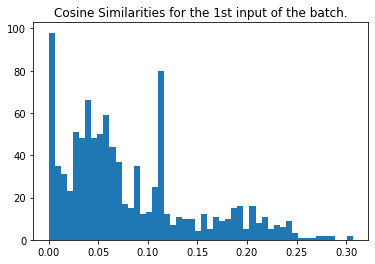

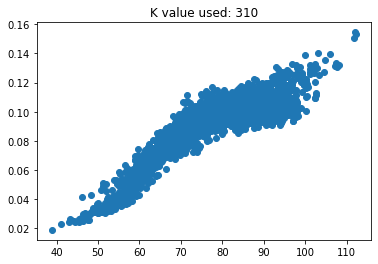

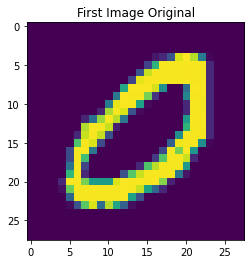

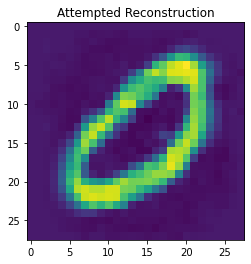

MSE loss for this input is:  0.001347454226746851
train loss: 7.355705747613683e-05 test loss: 7.582289254060015e-05
[epoch, batch], [20,   250] loss: 0.000
mean actives 271.0 0.271 % | max 271 0.271 %
(128, 1000) shape of cosine sims


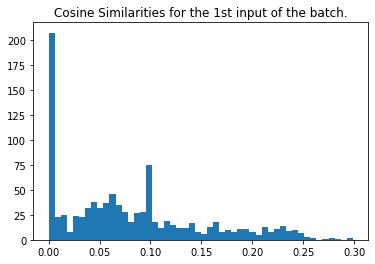

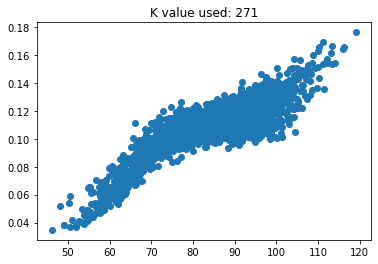

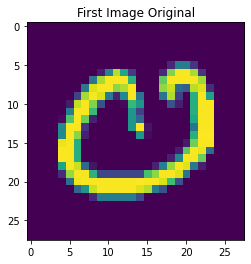

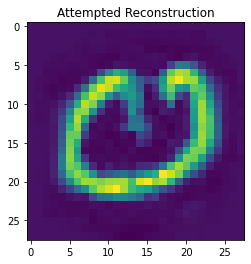

MSE loss for this input is:  0.0012051391662383567
train loss: 6.888705684104934e-05 test loss: 7.096162153175101e-05
[epoch, batch], [21,   250] loss: 0.000
mean actives 233.0 0.233 % | max 233 0.233 %
(128, 1000) shape of cosine sims


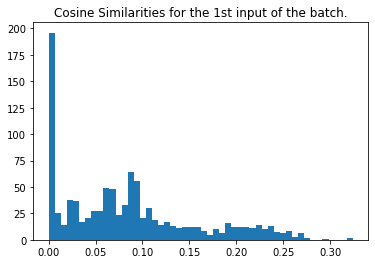

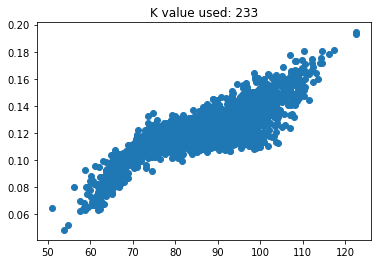

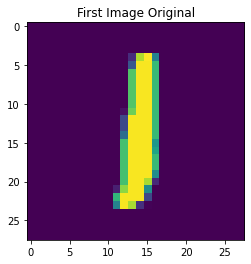

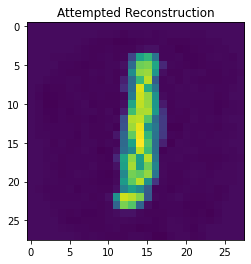

MSE loss for this input is:  0.001842980482140366
train loss: 6.888512871228158e-05 test loss: 6.460193981183693e-05
[epoch, batch], [22,   250] loss: 0.000
mean actives 195.0 0.195 % | max 195 0.195 %
(128, 1000) shape of cosine sims


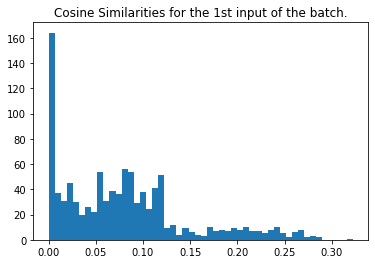

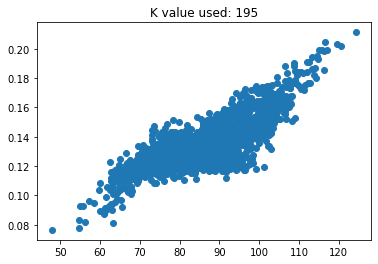

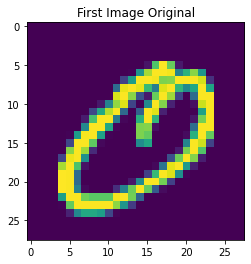

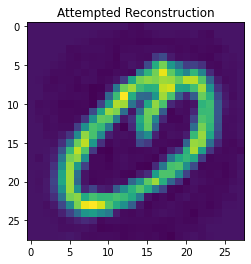

MSE loss for this input is:  0.001521578704824253
train loss: 6.364629371091723e-05 test loss: 6.483830657089129e-05
[epoch, batch], [23,   250] loss: 0.000
mean actives 156.0 0.156 % | max 156 0.156 %
(128, 1000) shape of cosine sims


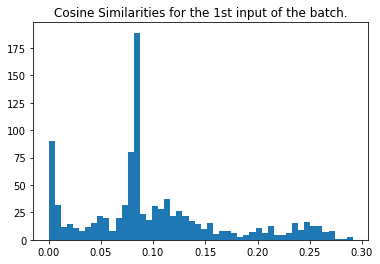

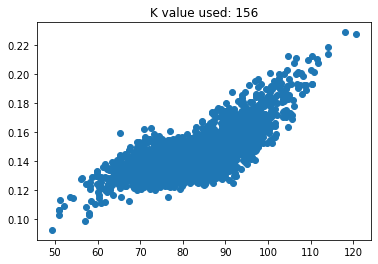

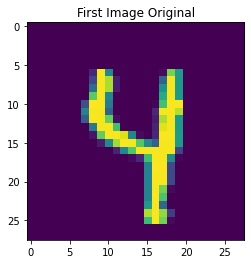

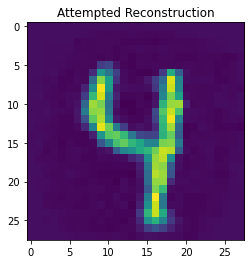

MSE loss for this input is:  0.0013867154413340042
train loss: 6.146355008240789e-05 test loss: 6.378317630151287e-05
[epoch, batch], [24,   250] loss: 0.000
mean actives 118.0 0.118 % | max 118 0.118 %
(128, 1000) shape of cosine sims


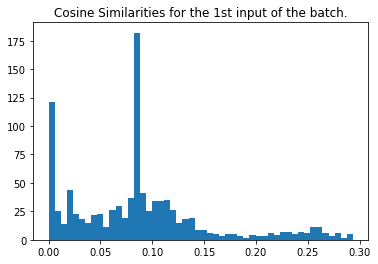

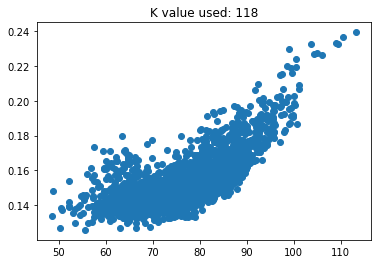

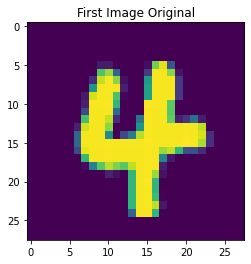

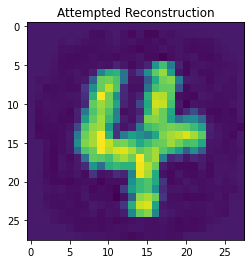

MSE loss for this input is:  0.0010091650242708167
train loss: 7.029562402749434e-05 test loss: 6.83150501572527e-05
[epoch, batch], [25,   250] loss: 0.000
mean actives 80.0 0.08 % | max 80 0.08 %
(128, 1000) shape of cosine sims


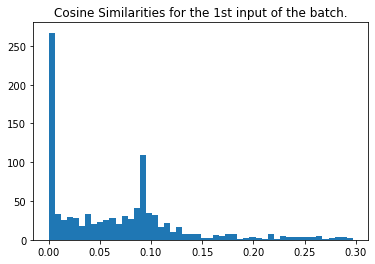

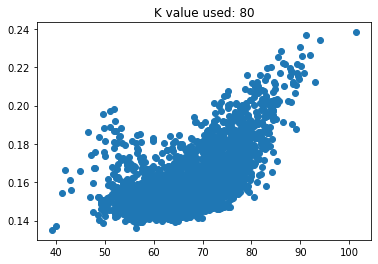

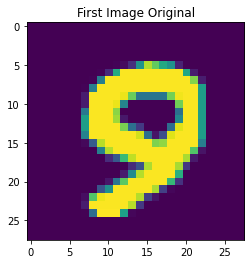

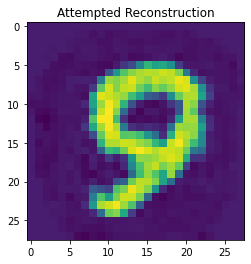

MSE loss for this input is:  0.0011224502659573847
train loss: 8.305047231260687e-05 test loss: 8.787357364781201e-05
[epoch, batch], [26,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


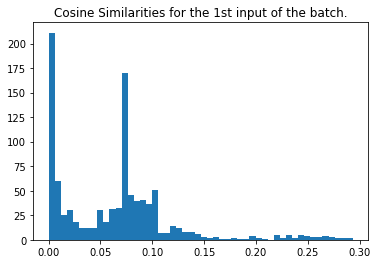

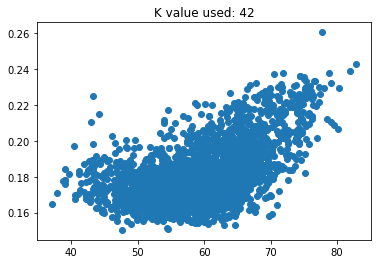

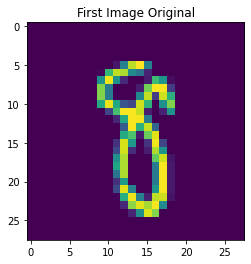

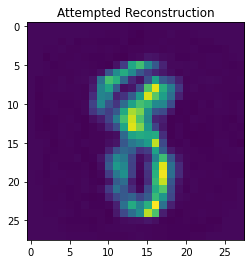

MSE loss for this input is:  0.00144056215578196
train loss: 0.00013791321543976665 test loss: 0.00012911870726384223
[epoch, batch], [27,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


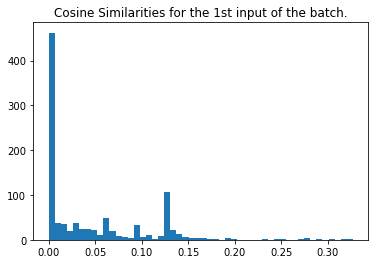

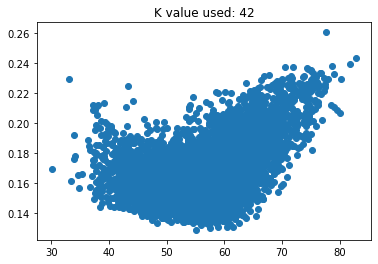

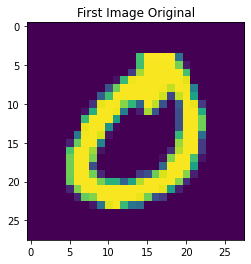

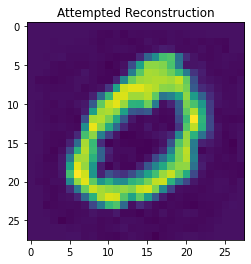

MSE loss for this input is:  0.00155341914113687
train loss: 0.0001258634147234261 test loss: 0.00012251992302481085
[epoch, batch], [28,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


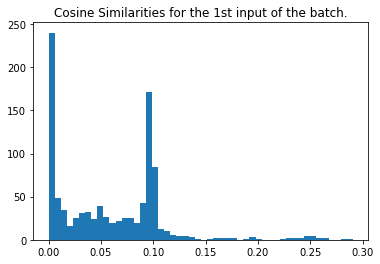

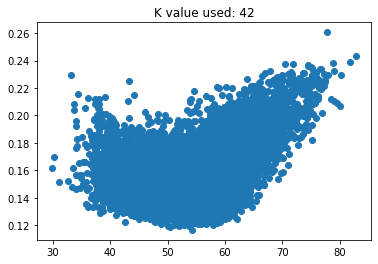

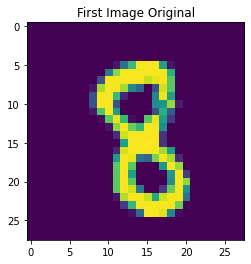

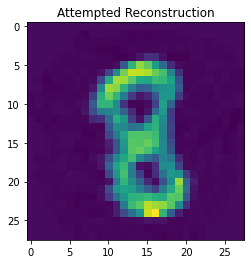

MSE loss for this input is:  0.0006917100779864253
train loss: 0.00012597968452610075 test loss: 0.00013035732263233513
[epoch, batch], [29,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


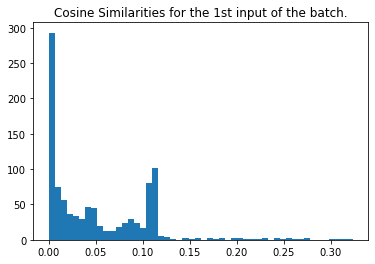

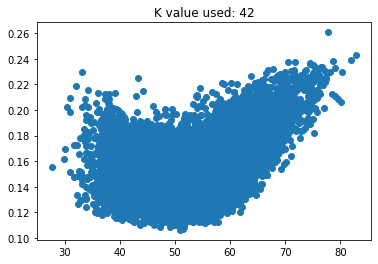

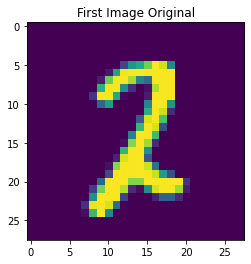

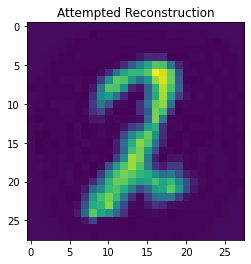

MSE loss for this input is:  0.0015615722050472181
train loss: 0.00013337175187189132 test loss: 0.00013297518307808787
[epoch, batch], [30,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


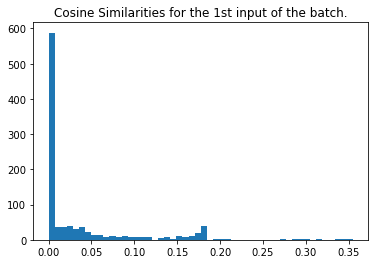

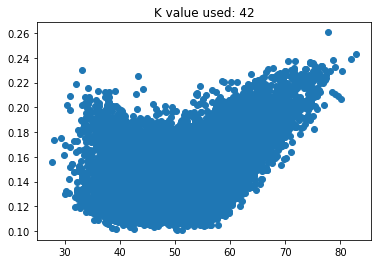

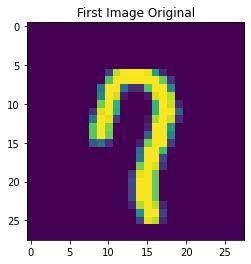

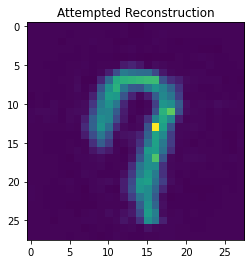

MSE loss for this input is:  0.002172109880009476
train loss: 0.00012984470231458545 test loss: 0.0001330967788817361
[epoch, batch], [31,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


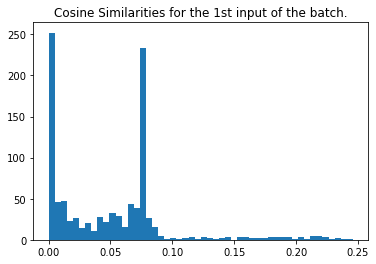

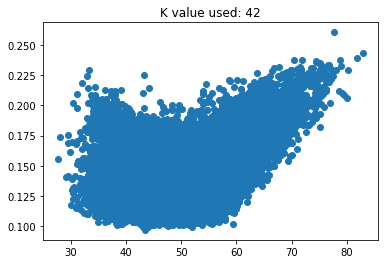

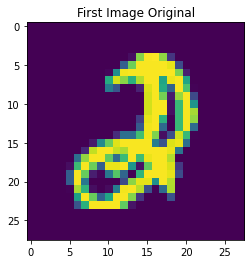

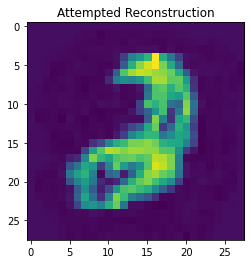

MSE loss for this input is:  0.0010599320640369337
train loss: 0.00014133936201687902 test loss: 0.00012344704009592533
[epoch, batch], [32,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


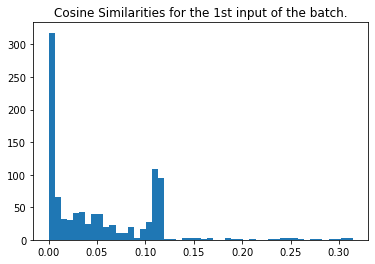

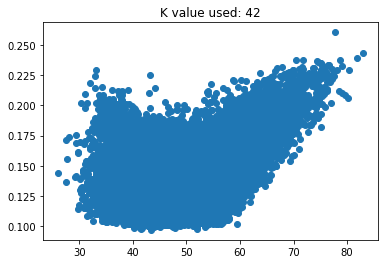

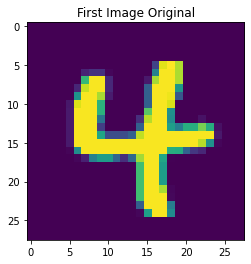

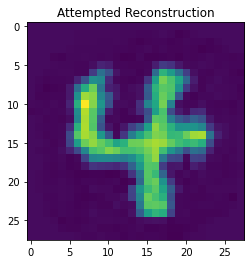

MSE loss for this input is:  0.0013522546814412487
train loss: 0.00012333475751802325 test loss: 0.0001325667544733733
[epoch, batch], [33,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


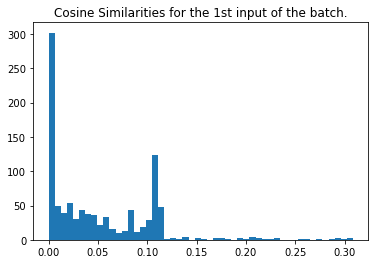

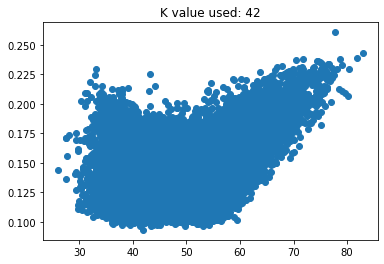

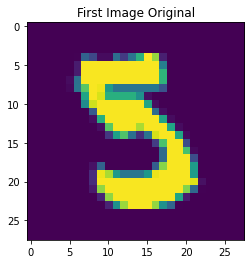

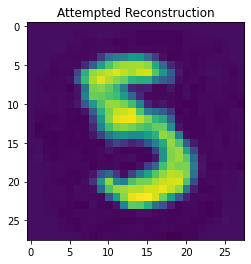

MSE loss for this input is:  0.0013907570011761723
train loss: 0.00011836528574349359 test loss: 0.00012578786117956042
[epoch, batch], [34,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


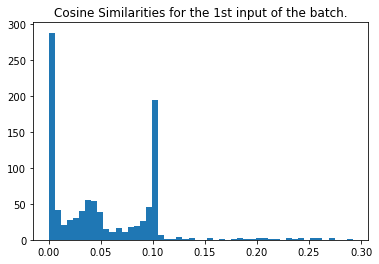

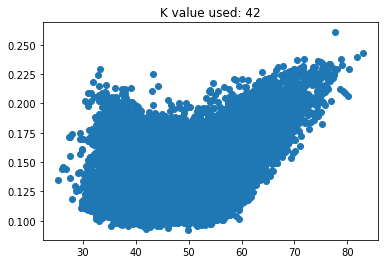

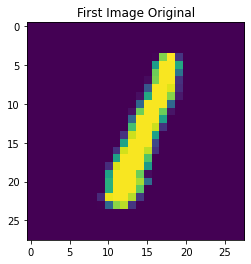

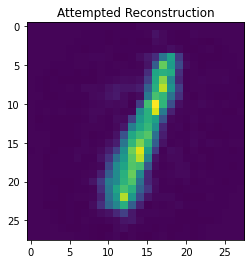

MSE loss for this input is:  0.0013561393229328856
train loss: 0.00012947454524692148 test loss: 0.0001329988444922492
[epoch, batch], [35,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


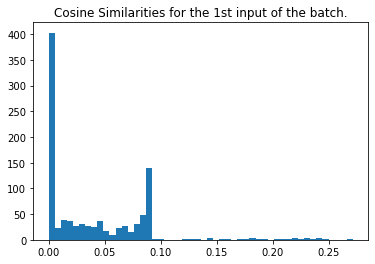

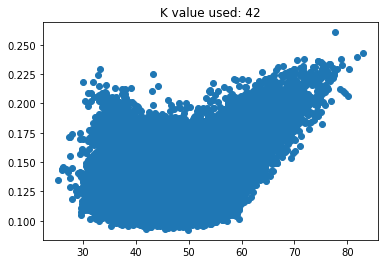

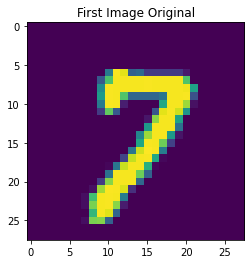

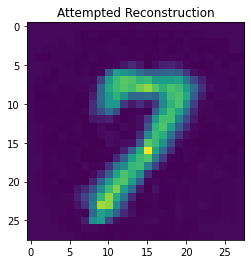

MSE loss for this input is:  0.0015253873199832682
train loss: 0.0001285638427361846 test loss: 0.00012949742085766047
[epoch, batch], [36,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


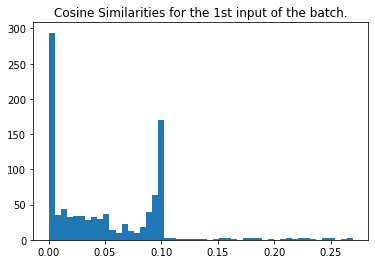

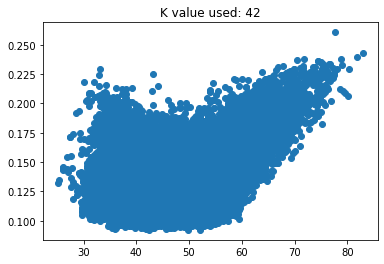

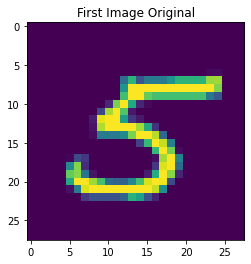

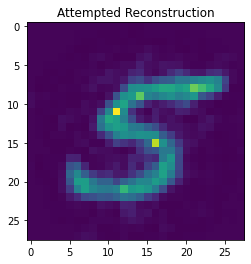

MSE loss for this input is:  0.0009701473980533833
train loss: 0.00012757997319567949 test loss: 0.00013570052396971732
[epoch, batch], [37,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


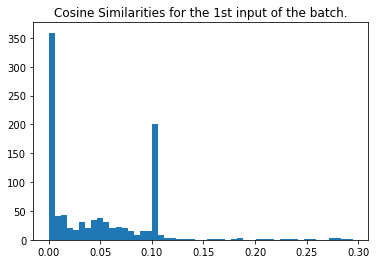

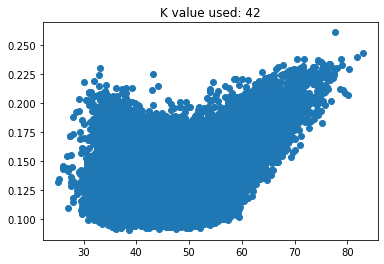

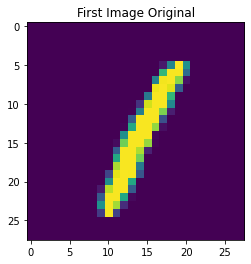

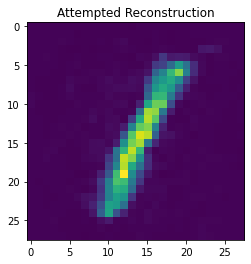

MSE loss for this input is:  0.0004004639934520332
train loss: 0.0001407672098139301 test loss: 0.00013797427527606487
[epoch, batch], [38,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


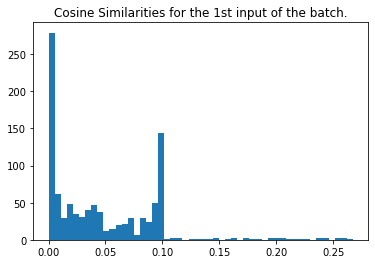

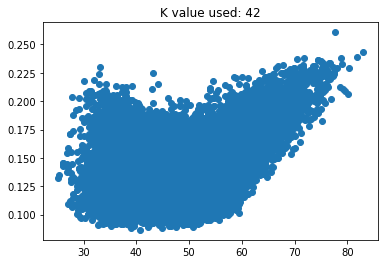

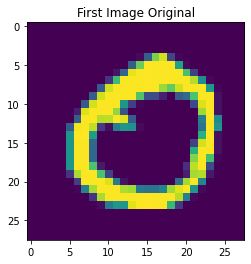

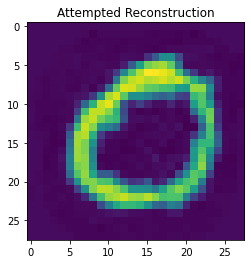

MSE loss for this input is:  0.0015596166557195236
train loss: 0.00013135731569491327 test loss: 0.00015597375750076026
[epoch, batch], [39,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


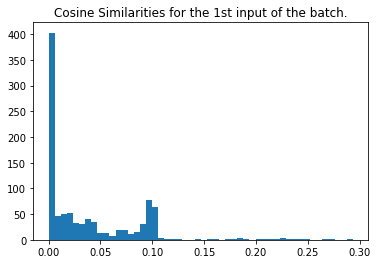

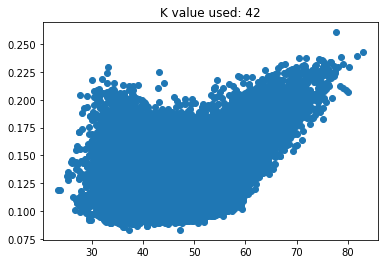

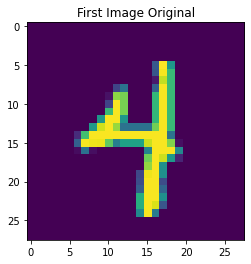

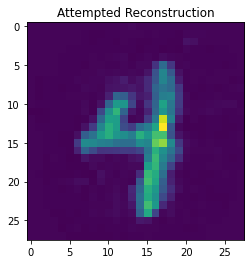

MSE loss for this input is:  0.0015203035911735222
train loss: 0.00011778812040574849 test loss: 0.00011994198575848714
[epoch, batch], [40,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


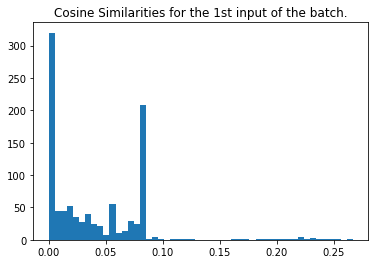

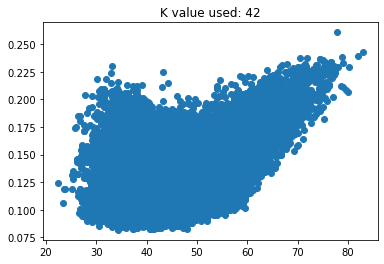

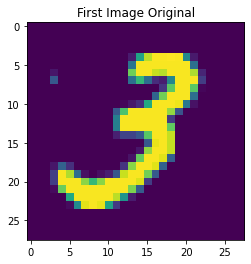

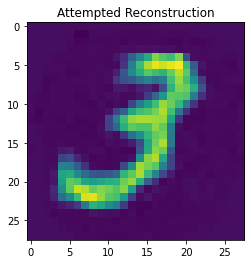

MSE loss for this input is:  0.0017910321452179734
train loss: 0.00011608287604758516 test loss: 0.000126212602481246
Finished Training


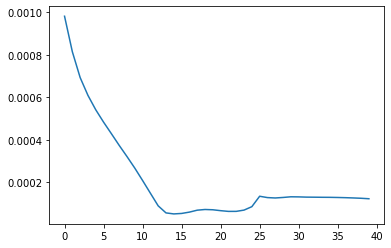

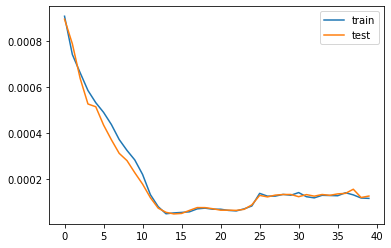

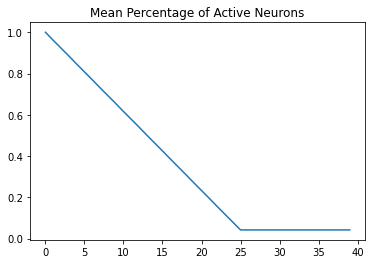

Latents and Labels dimensions: (60000, 1000) (60000,)
Latents and Labels dimensions: (10000, 1000) (10000,)
Logistic regression accuracy: Train= 0.881 | Test= 0.885


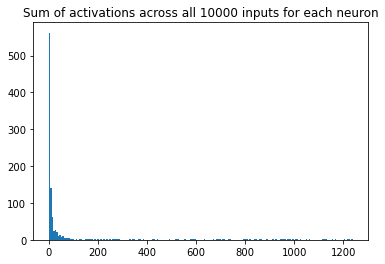

[562. 140.  63.  25.  27.  22.   9.  13.   7.   9.   5.   4.   6.   4.
   1.   1.   2.   0.   1.   0.   2.   3.   0.   0.   2.   1.   1.   1.
   2.   0.   1.   0.   2.   0.   1.   0.   1.   0.   1.   0.   1.   0.
   1.   2.   1.   1.   1.   0.   0.   0.   0.   0.   0.   2.   0.   1.
   2.   0.   0.   1.   1.   0.   1.   0.   0.   0.   0.   0.   1.   1.
   0.   1.   0.   0.   0.   0.   0.   0.   0.   1.   0.   0.   0.   1.
   1.   2.   0.   0.   0.   1.   0.   0.   0.   1.   1.   2.   1.   0.
   0.   0.   0.   0.   1.   0.   0.   0.   0.   0.   1.   0.   1.   2.
   1.   0.   1.   1.   0.   0.   3.   1.   0.   0.   0.   0.   0.   0.
   0.   0.   3.   1.   1.   0.   1.   0.   0.   1.   1.   0.   1.   1.
   0.   0.   0.   1.   0.   0.   0.   2.   0.   1.   0.   0.   1.   1.
   1.   1.   0.   2.   1.   0.   1.   0.   2.   1.   0.   1.   0.   0.
   0.   2.   0.   1.   0.   0.   0.   0.   0.   0.   0.   0.   1.   2.
   1.   0.   0.   0.   1.   0.   1.   0.   0.   0.   0.   0.   1.   0.
   2. 

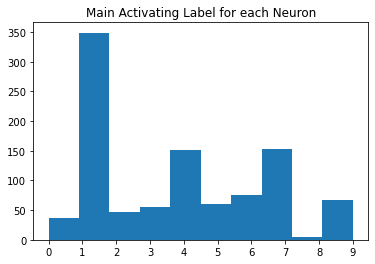

Neuron addresses should be 1000x784!!! (1000, 784) (1000, 784)
Euclidian distance


,0,1,2,3,4,5,6,7,8,9
0,0.000000,0.079129,0.061753,0.075635,0.084860,0.063474,0.063257,0.066858,0.239447,0.083630
1,0.079129,0.000000,0.055309,0.053888,0.033053,0.052822,0.048154,0.030089,0.254710,0.040379
2,0.061753,0.055309,0.000000,0.052338,0.071994,0.056389,0.051866,0.057276,0.234030,0.071225
3,0.075635,0.053888,0.052338,0.000000,0.059654,0.051479,0.050102,0.054014,0.239835,0.068846
4,0.084860,0.033053,0.071994,0.059654,0.000000,0.048229,0.046680,0.032931,0.248268,0.045744
5,0.063474,0.052822,0.056389,0.051479,0.048229,0.000000,0.054022,0.042854,0.219755,0.063523
6,0.063257,0.048154,0.051866,0.050102,0.046680,0.054022,0.000000,0.051258,0.240399,0.063401
7,0.066858,0.030089,0.057276,0.054014,0.032931,0.042854,0.051258,0.000000,0.245992,0.039214
8,0.239447,0.254710,0.234030,0.239835,0.248268,0.219755,0.240399,0.245992,0.000000,0.255635
9,0.083630,0.040379,0.071225,0.068846,0.045744,0.063523,0.063401,0.039214,0.255635,0.000000


cosine similarity


,0,1,2,3,4,5,6,7,8,9
0,1.000000,0.418819,0.560044,0.486482,0.460579,0.582199,0.582223,0.527707,0.382343,0.418034
1,0.418819,1.000000,0.529311,0.573183,0.767101,0.599679,0.633980,0.748049,0.301230,0.669890
2,0.560044,0.529311,1.000000,0.597066,0.489387,0.582949,0.615015,0.534669,0.387045,0.434021
3,0.486482,0.573183,0.597066,1.000000,0.598062,0.638828,0.647109,0.588761,0.371880,0.485766
4,0.460579,0.767101,0.489387,0.598062,1.000000,0.684610,0.693781,0.772608,0.353190,0.685918
5,0.582199,0.599679,0.582949,0.638828,0.684610,1.000000,0.631710,0.687131,0.447335,0.542901
6,0.582223,0.633980,0.615015,0.647109,0.693781,0.631710,1.000000,0.623421,0.373990,0.541894
7,0.527707,0.748049,0.534669,0.588761,0.772608,0.687131,0.623421,1.000000,0.342327,0.692317
8,0.382343,0.301230,0.387045,0.371880,0.353190,0.447335,0.373990,0.342327,1.000000,0.309106
9,0.418034,0.669890,0.434021,0.485766,0.685918,0.542901,0.541894,0.692317,0.309106,1.000000


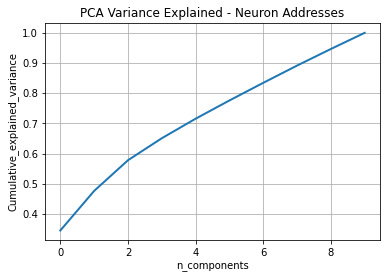

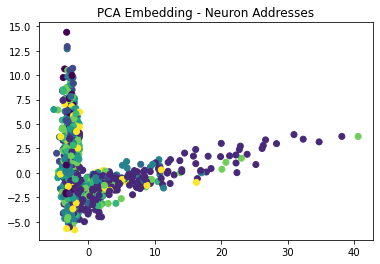

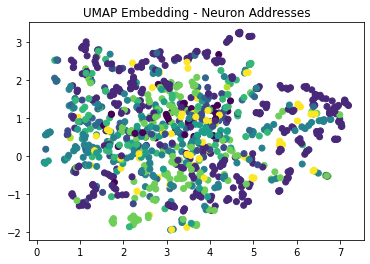

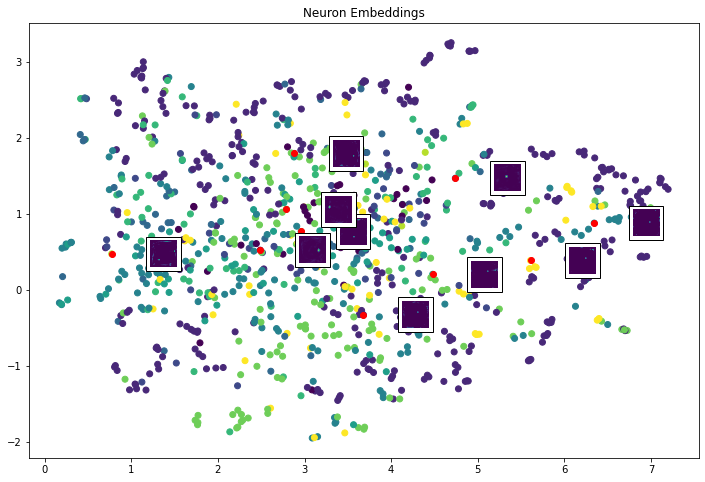

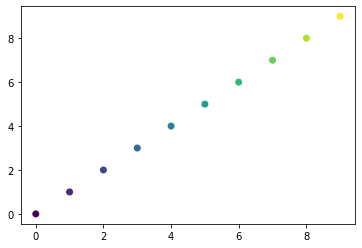

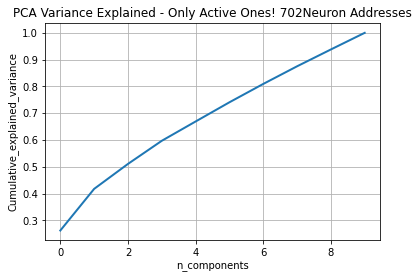

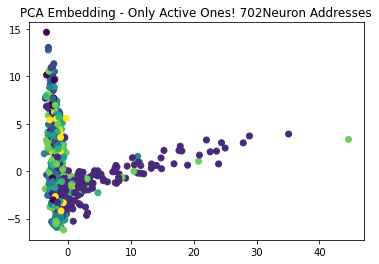

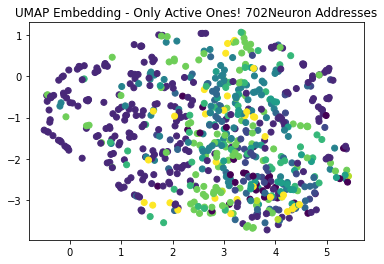

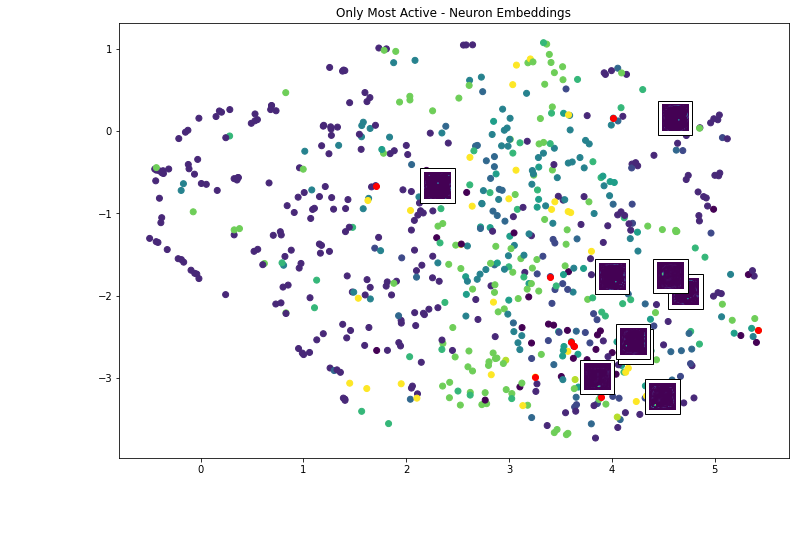

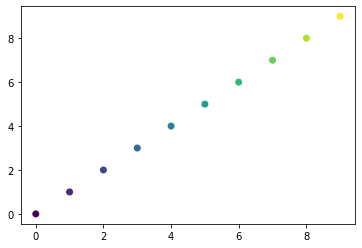

Giving some random plots from the most active neurons


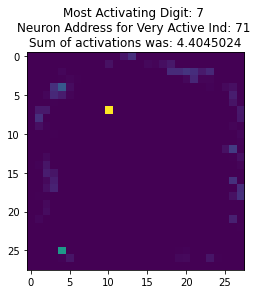

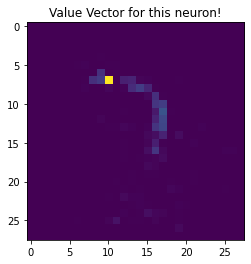

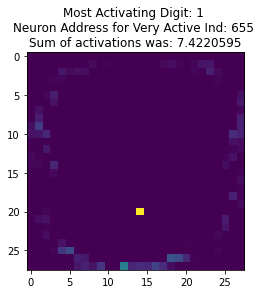

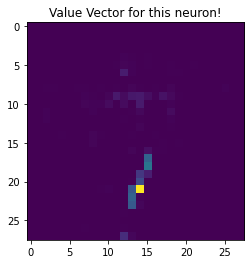

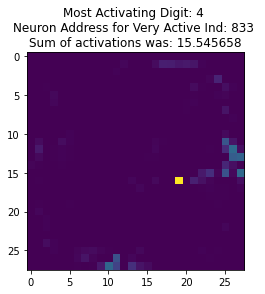

...

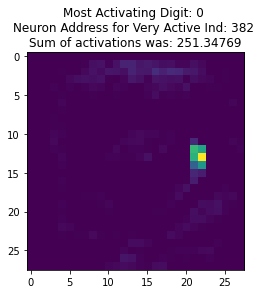

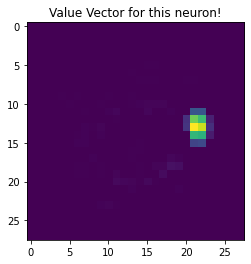

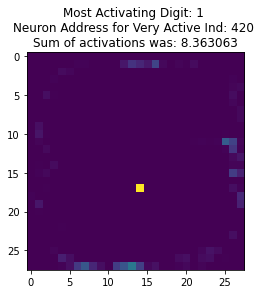

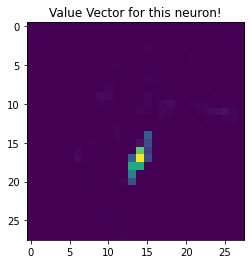

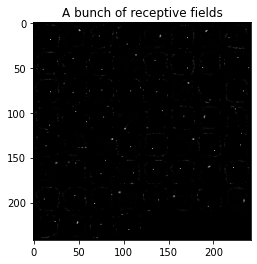

length of net parameters 2
[epoch, batch], [1,   250] loss: 0.000
mean actives 1000.0 1.0 % | max 1000 1.0 %
(128, 1000) shape of cosine sims


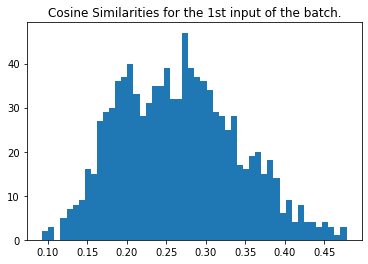

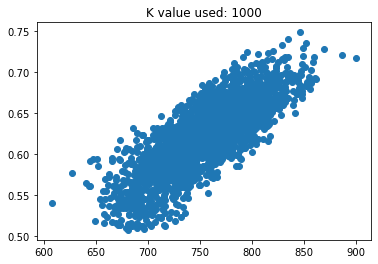

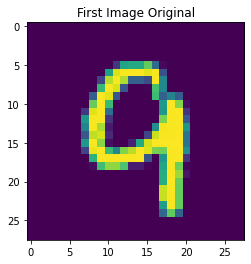

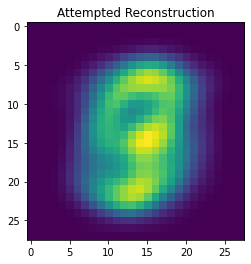

MSE loss for this input is:  0.0008467611457620348
train loss: 0.0009050965309143066 test loss: 0.0009191505960188806
[epoch, batch], [2,   250] loss: 0.000
mean actives 961.0 0.961 % | max 961 0.961 %
(128, 1000) shape of cosine sims


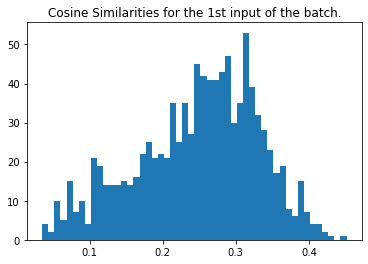

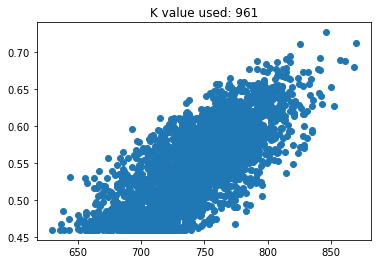

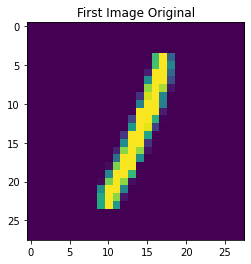

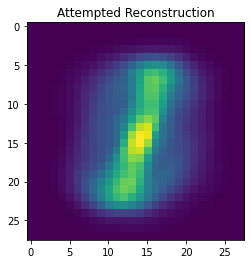

MSE loss for this input is:  0.0011658102121888374
train loss: 0.0007836283184587955 test loss: 0.0007596745272167027
[epoch, batch], [3,   250] loss: 0.000
mean actives 923.0 0.923 % | max 923 0.923 %
(128, 1000) shape of cosine sims


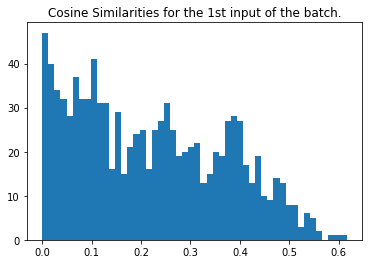

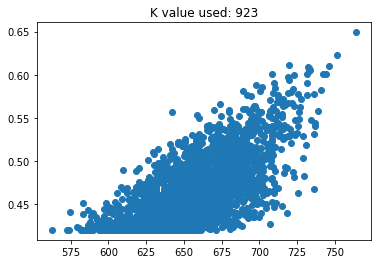

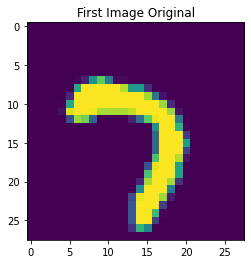

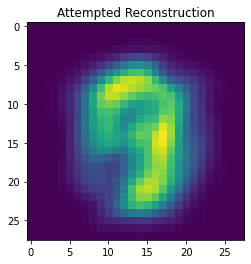

MSE loss for this input is:  0.0010754913091659546
train loss: 0.0006628013215959072 test loss: 0.00062958849593997
[epoch, batch], [4,   250] loss: 0.000
mean actives 885.0 0.885 % | max 885 0.885 %
(128, 1000) shape of cosine sims


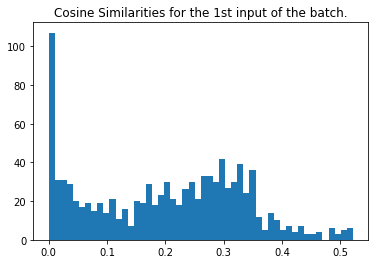

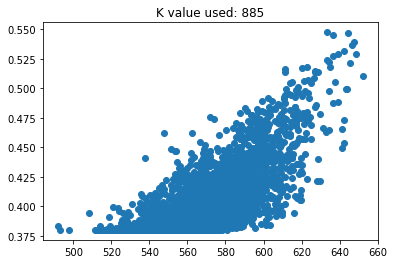

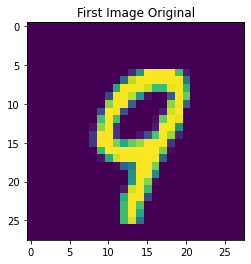

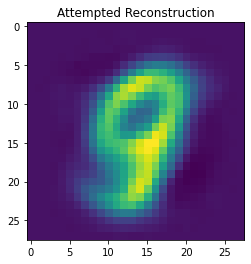

MSE loss for this input is:  0.0010869078794304207
train loss: 0.0005971603095531464 test loss: 0.0005717415479011834
[epoch, batch], [5,   250] loss: 0.000
mean actives 846.0 0.846 % | max 846 0.846 %
(128, 1000) shape of cosine sims


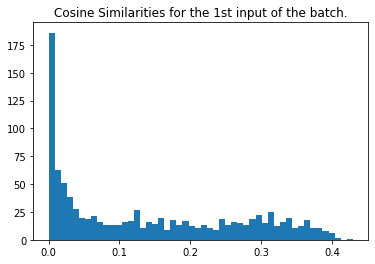

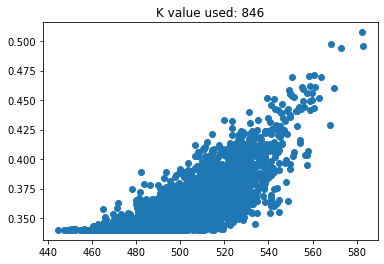

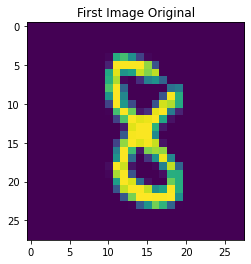

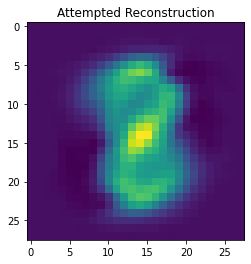

MSE loss for this input is:  0.0009358774642555081
train loss: 0.0005459791282191873 test loss: 0.000482460338389501
[epoch, batch], [6,   250] loss: 0.000
mean actives 808.0 0.808 % | max 808 0.808 %
(128, 1000) shape of cosine sims


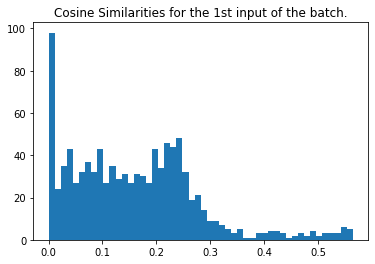

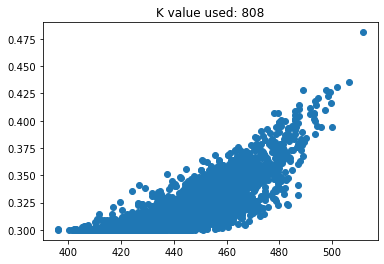

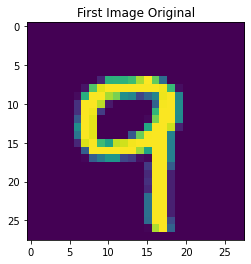

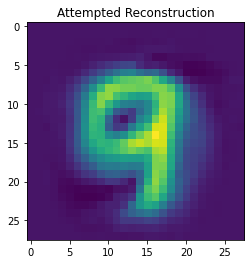

MSE loss for this input is:  0.0011337511241436005
train loss: 0.0004775488341692835 test loss: 0.0004202473792247474
[epoch, batch], [7,   250] loss: 0.000
mean actives 770.0 0.77 % | max 770 0.77 %
(128, 1000) shape of cosine sims


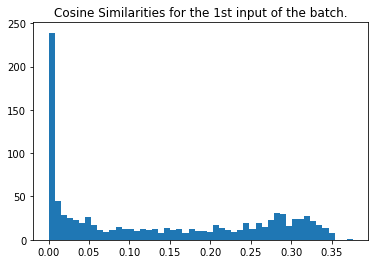

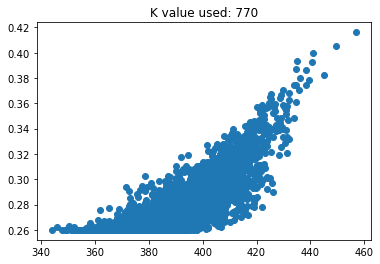

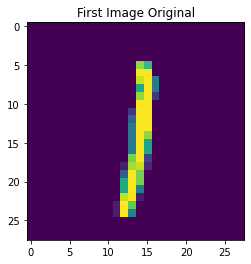

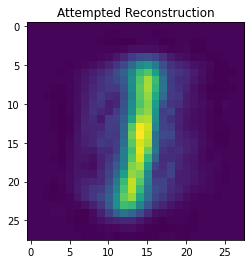

MSE loss for this input is:  0.0013072372091059781
train loss: 0.00043177008046768606 test loss: 0.0003710093442350626
[epoch, batch], [8,   250] loss: 0.000
mean actives 731.0 0.731 % | max 731 0.731 %
(128, 1000) shape of cosine sims


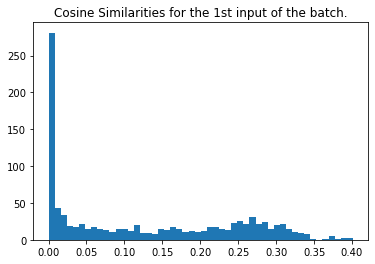

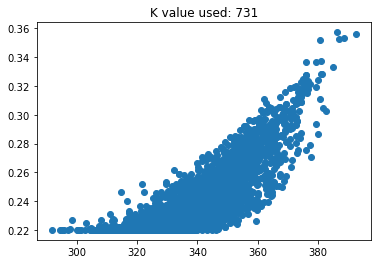

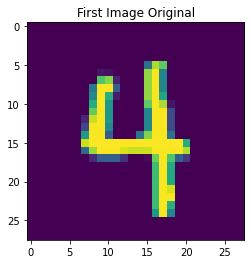

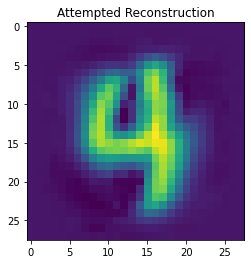

MSE loss for this input is:  0.001077500152952817
train loss: 0.0003679517831187695 test loss: 0.00029998592799529433
[epoch, batch], [9,   250] loss: 0.000
mean actives 693.0 0.693 % | max 693 0.693 %
(128, 1000) shape of cosine sims


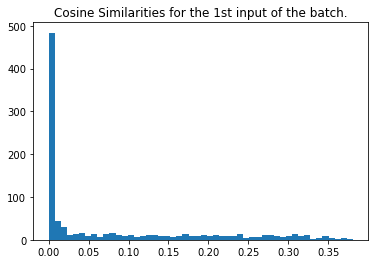

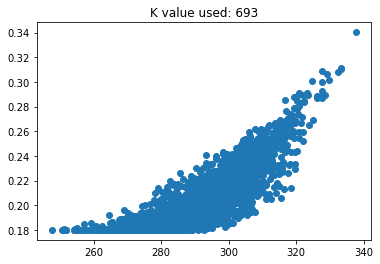

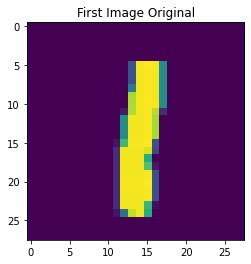

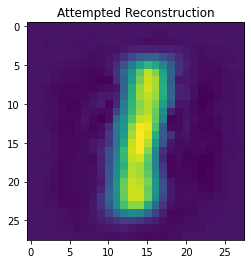

MSE loss for this input is:  0.0019809273736817496
train loss: 0.0003290338208898902 test loss: 0.00026421473012305796
[epoch, batch], [10,   250] loss: 0.000
mean actives 655.0 0.655 % | max 655 0.655 %
(128, 1000) shape of cosine sims


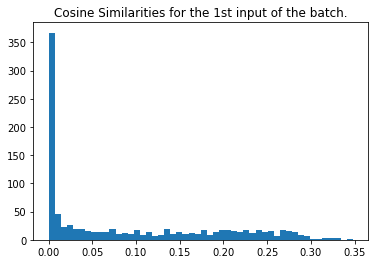

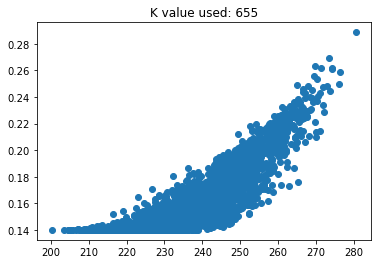

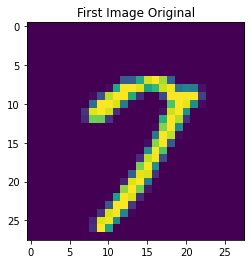

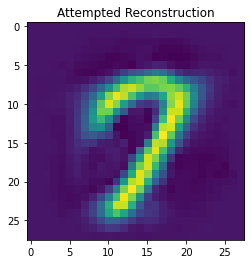

MSE loss for this input is:  0.0015317086054354298
train loss: 0.00026776292361319065 test loss: 0.00021774867491330951
[epoch, batch], [11,   250] loss: 0.000
mean actives 616.0 0.616 % | max 616 0.616 %
(128, 1000) shape of cosine sims


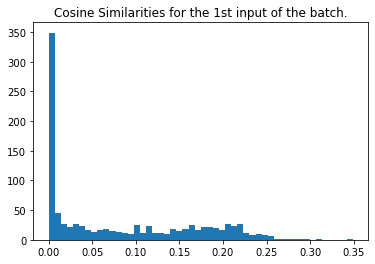

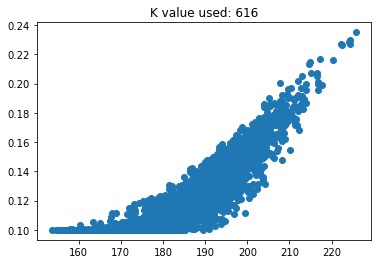

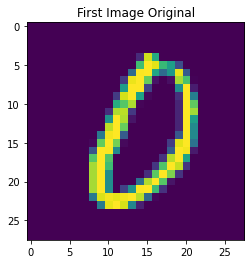

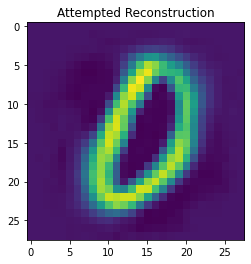

MSE loss for this input is:  0.0019282444703335665
train loss: 0.0001958354259841144 test loss: 0.00016015057917684317
[epoch, batch], [12,   250] loss: 0.000
mean actives 578.0 0.578 % | max 578 0.578 %
(128, 1000) shape of cosine sims


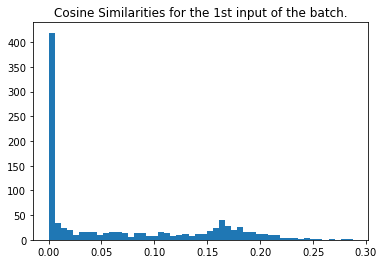

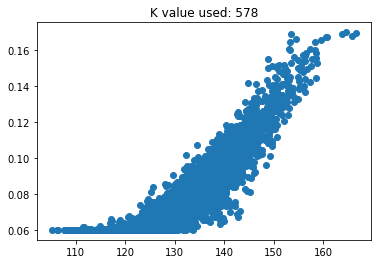

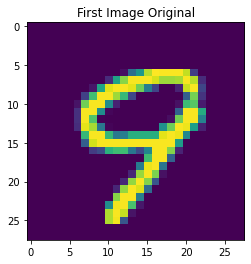

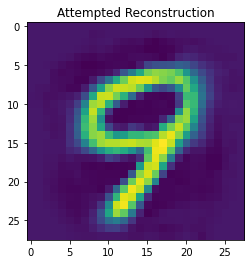

MSE loss for this input is:  0.0010646101163358105
train loss: 0.00014862096577417105 test loss: 0.00011505813745316118
[epoch, batch], [13,   250] loss: 0.000
mean actives 540.0 0.54 % | max 540 0.54 %
(128, 1000) shape of cosine sims


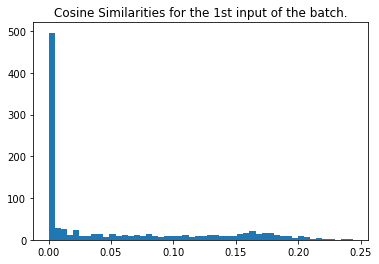

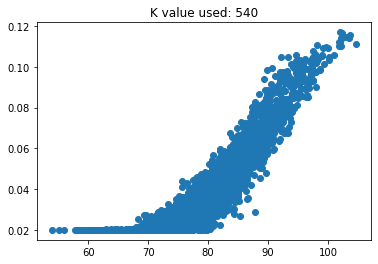

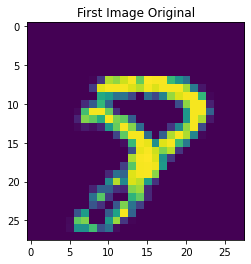

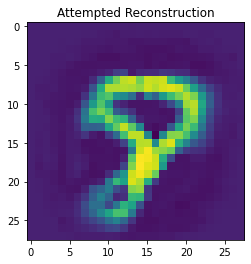

MSE loss for this input is:  0.0015985517173397299
train loss: 8.21582943899557e-05 test loss: 6.80425509926863e-05
[epoch, batch], [14,   250] loss: 0.000
mean actives 501.0 0.501 % | max 501 0.501 %
(128, 1000) shape of cosine sims


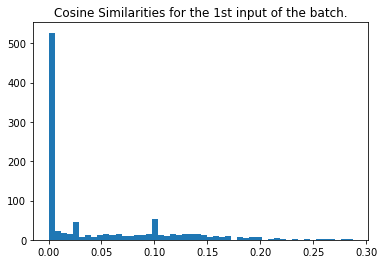

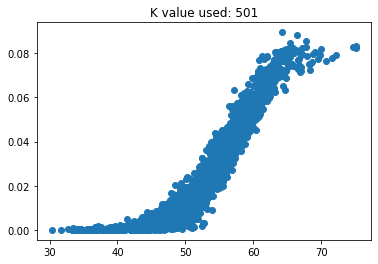

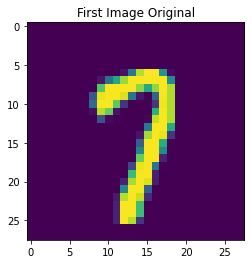

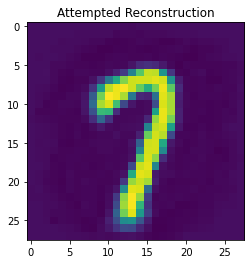

MSE loss for this input is:  0.0019310160863156222
train loss: 5.624328332487494e-05 test loss: 4.998400618205778e-05
[epoch, batch], [15,   250] loss: 0.000
mean actives 463.0 0.463 % | max 463 0.463 %
(128, 1000) shape of cosine sims


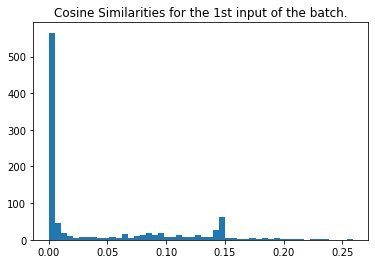

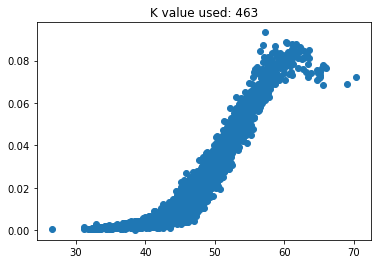

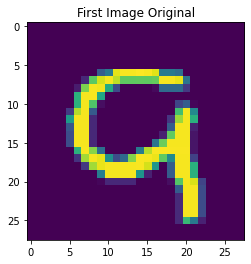

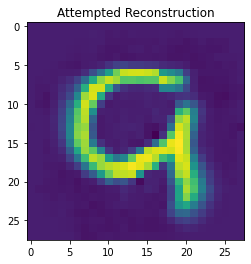

MSE loss for this input is:  0.0019315750319130567
train loss: 5.098591645946726e-05 test loss: 5.113992665428668e-05
[epoch, batch], [16,   250] loss: 0.000
mean actives 425.0 0.425 % | max 425 0.425 %
(128, 1000) shape of cosine sims


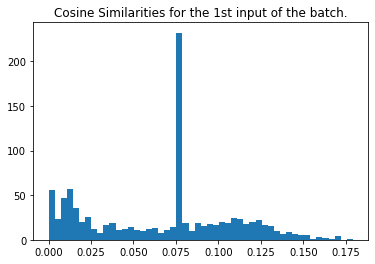

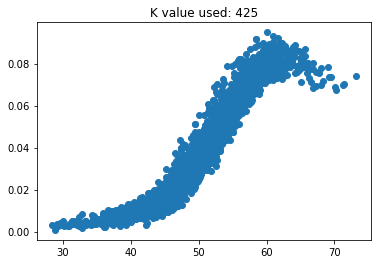

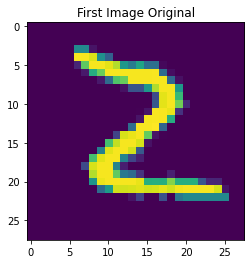

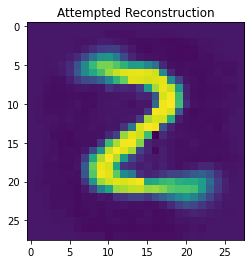

MSE loss for this input is:  0.0011135505474343592
train loss: 5.093103027320467e-05 test loss: 5.902304474147968e-05
[epoch, batch], [17,   250] loss: 0.000
mean actives 386.0 0.386 % | max 386 0.386 %
(128, 1000) shape of cosine sims


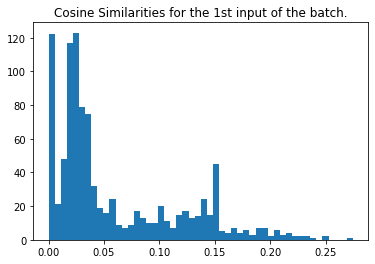

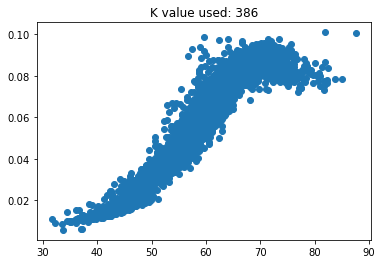

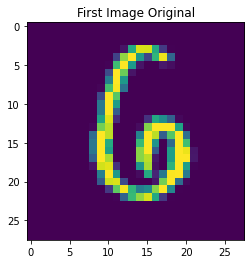

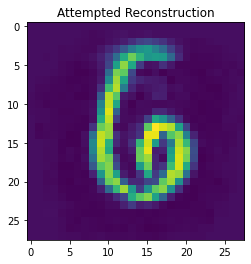

MSE loss for this input is:  0.0016818020720871128
train loss: 6.310077151283622e-05 test loss: 6.0673977714031935e-05
[epoch, batch], [18,   250] loss: 0.000
mean actives 348.0 0.348 % | max 348 0.348 %
(128, 1000) shape of cosine sims


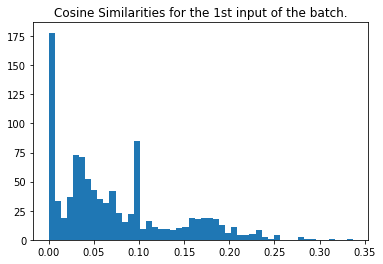

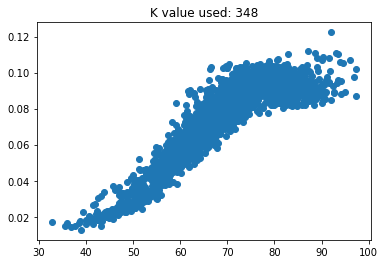

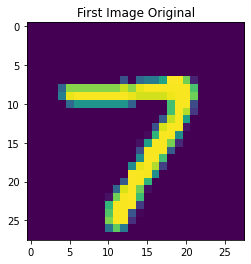

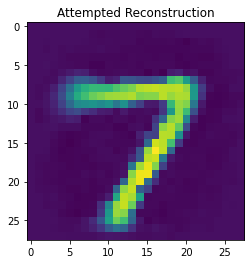

MSE loss for this input is:  0.0018426572181740586
train loss: 7.351992826443166e-05 test loss: 7.463849033229053e-05
[epoch, batch], [19,   250] loss: 0.000
mean actives 310.0 0.31 % | max 310 0.31 %
(128, 1000) shape of cosine sims


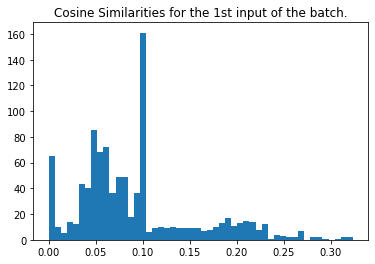

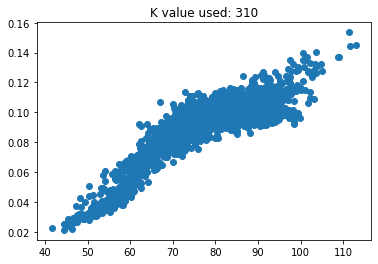

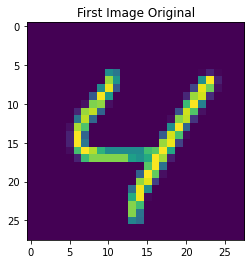

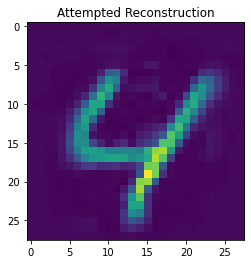

MSE loss for this input is:  0.0012885937277151613
train loss: 6.973442214075476e-05 test loss: 7.391024701064453e-05
[epoch, batch], [20,   250] loss: 0.000
mean actives 271.0 0.271 % | max 271 0.271 %
(128, 1000) shape of cosine sims


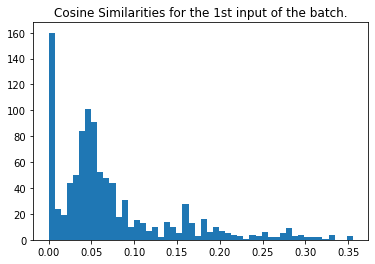

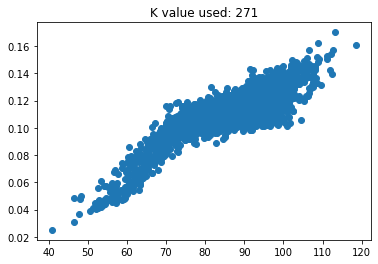

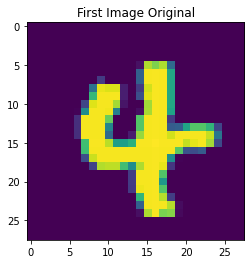

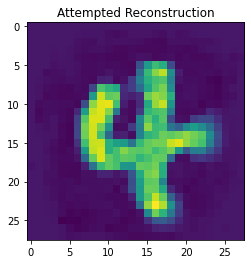

MSE loss for this input is:  0.001639715566927073
train loss: 7.091707084327936e-05 test loss: 7.280248973984271e-05
[epoch, batch], [21,   250] loss: 0.000
mean actives 233.0 0.233 % | max 233 0.233 %
(128, 1000) shape of cosine sims


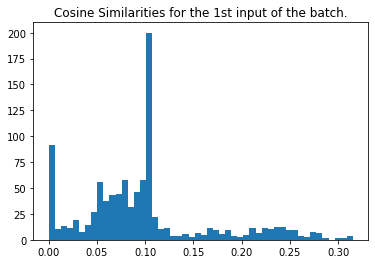

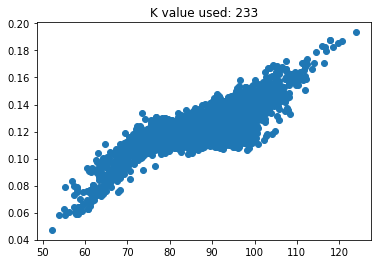

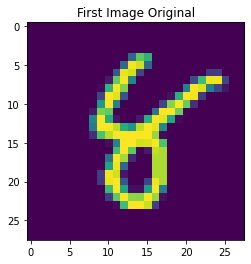

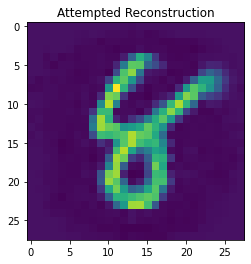

MSE loss for this input is:  0.0011813507548400334
train loss: 6.0035028582205996e-05 test loss: 6.351301999529824e-05
[epoch, batch], [22,   250] loss: 0.000
mean actives 195.0 0.195 % | max 195 0.195 %
(128, 1000) shape of cosine sims


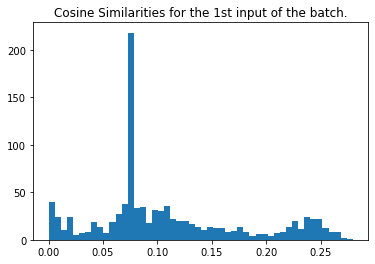

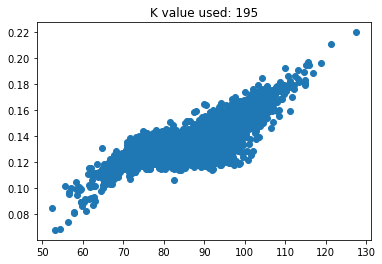

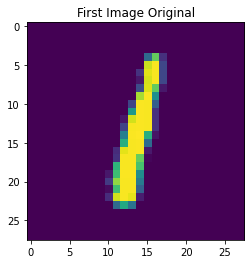

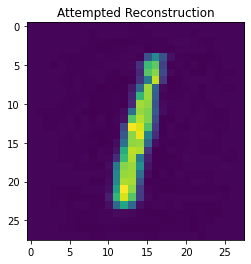

MSE loss for this input is:  0.0013799021134571154
train loss: 6.512239633593708e-05 test loss: 6.843399751232937e-05
[epoch, batch], [23,   250] loss: 0.000
mean actives 156.0 0.156 % | max 156 0.156 %
(128, 1000) shape of cosine sims


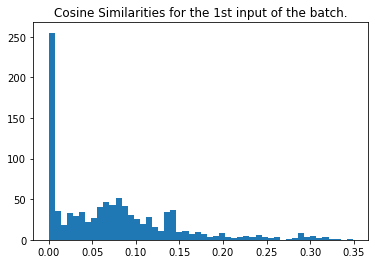

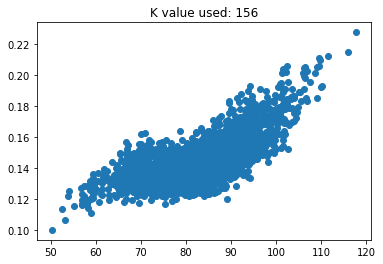

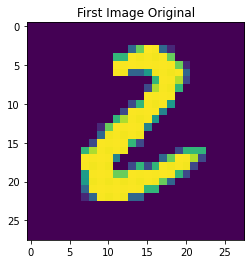

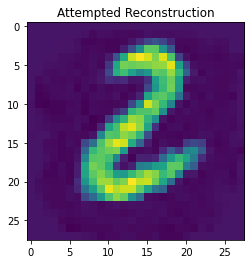

MSE loss for this input is:  0.0015529108290769616
train loss: 5.916439477005042e-05 test loss: 6.430559005821124e-05
[epoch, batch], [24,   250] loss: 0.000
mean actives 118.0 0.118 % | max 118 0.118 %
(128, 1000) shape of cosine sims


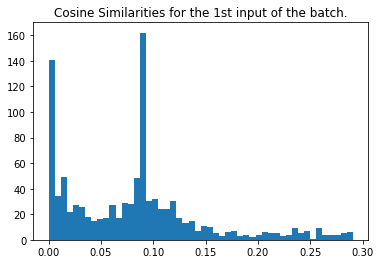

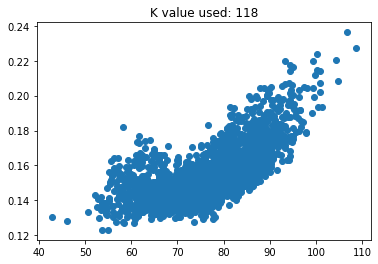

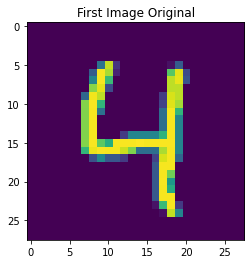

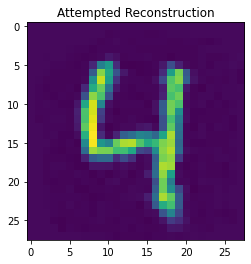

MSE loss for this input is:  0.0013096156168957145
train loss: 7.131074380595237e-05 test loss: 7.338639261433855e-05
[epoch, batch], [25,   250] loss: 0.000
mean actives 80.0 0.08 % | max 80 0.08 %
(128, 1000) shape of cosine sims


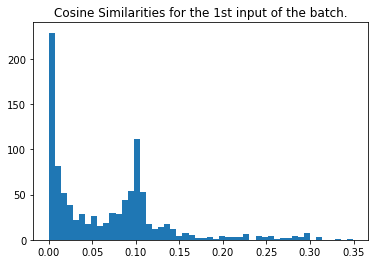

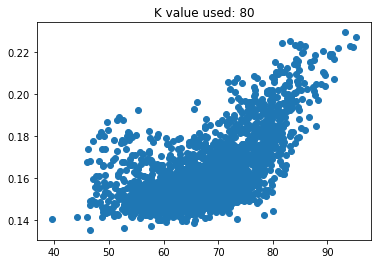

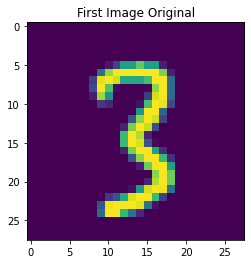

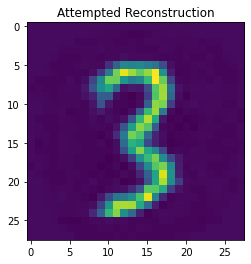

MSE loss for this input is:  0.0018447374506872526
train loss: 8.719971083337441e-05 test loss: 8.847744902595878e-05
[epoch, batch], [26,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


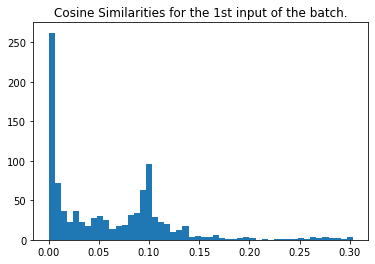

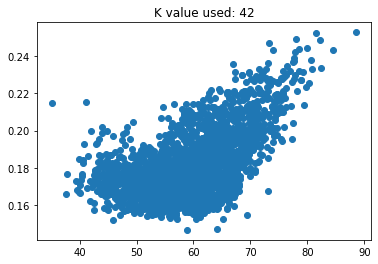

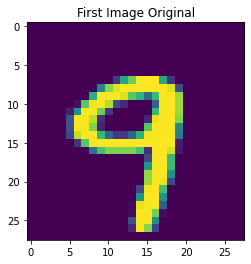

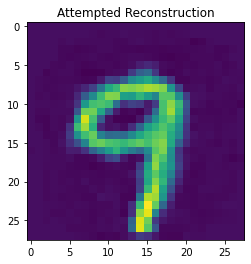

MSE loss for this input is:  0.0014548394448903141
train loss: 0.00012455901014618576 test loss: 0.0001274476235266775
[epoch, batch], [27,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


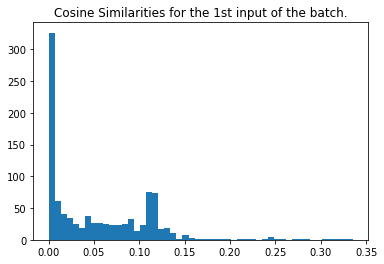

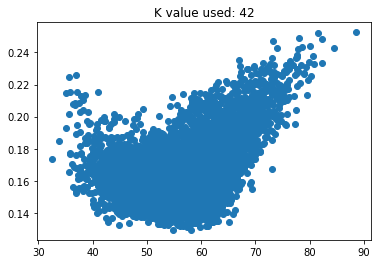

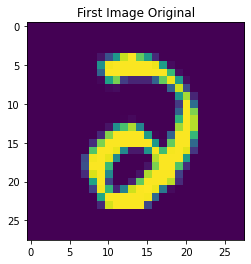

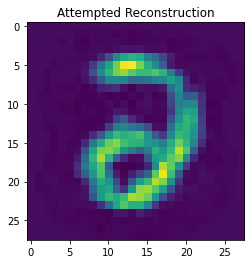

MSE loss for this input is:  0.0012214950913069199
train loss: 0.00012253111344762146 test loss: 0.00012919618166051805
[epoch, batch], [28,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


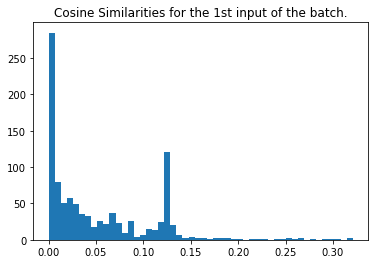

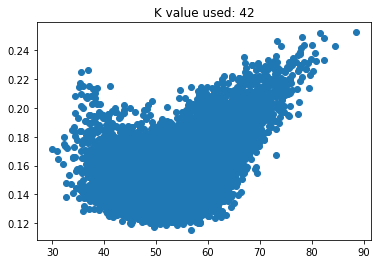

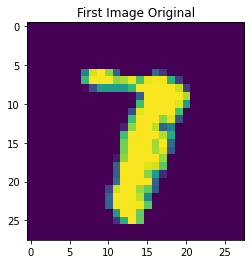

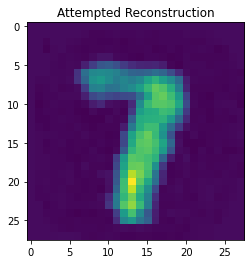

MSE loss for this input is:  0.0006360250848288438
train loss: 0.00012958815204910934 test loss: 0.00013119082723278552
[epoch, batch], [29,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


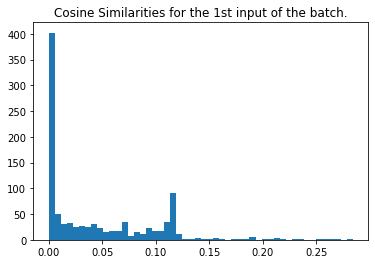

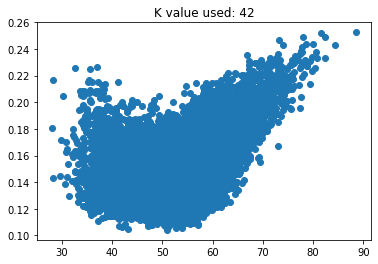

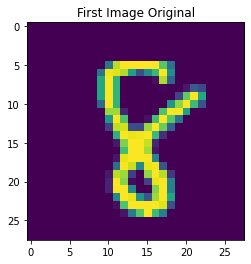

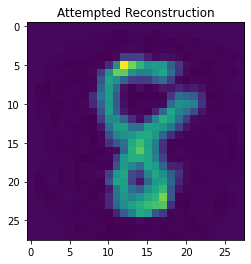

MSE loss for this input is:  0.0012619267312847838
train loss: 0.0001351663377135992 test loss: 0.00013824962661601603
[epoch, batch], [30,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


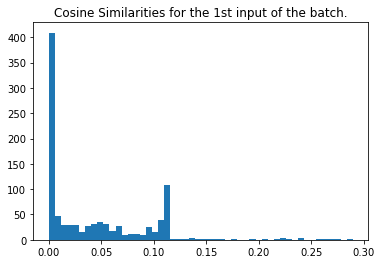

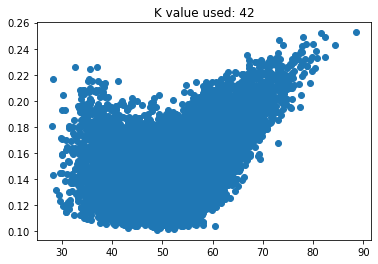

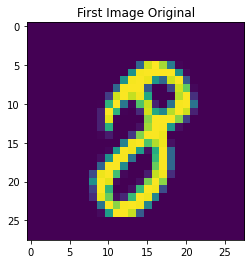

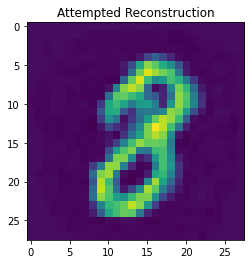

MSE loss for this input is:  0.0010803465028198398
train loss: 0.00012895795225631446 test loss: 0.0001401852205162868
[epoch, batch], [31,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


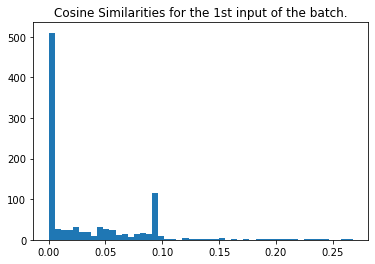

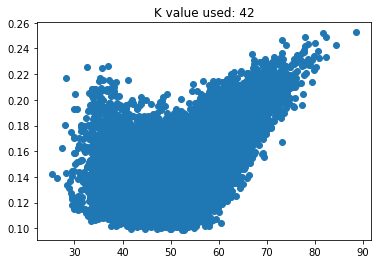

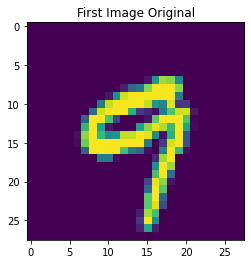

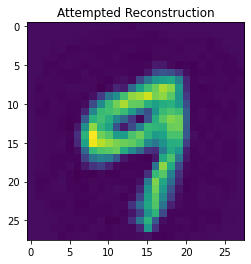

MSE loss for this input is:  0.0019963368469355057
train loss: 0.00012810993939638138 test loss: 0.0001483721425756812
[epoch, batch], [32,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


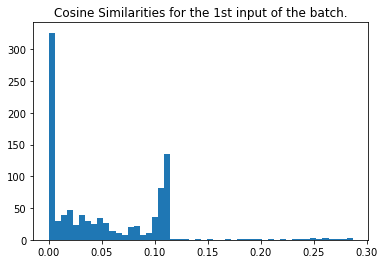

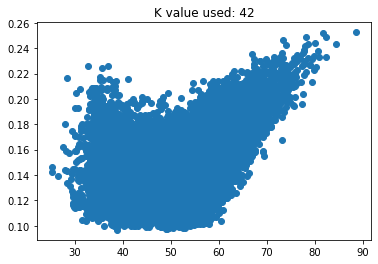

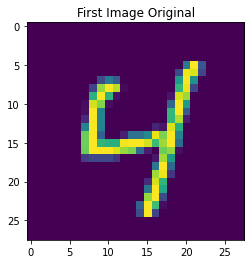

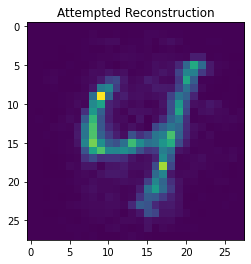

MSE loss for this input is:  0.0013594936047281539
train loss: 0.00012280243390705436 test loss: 0.0001439045590814203
[epoch, batch], [33,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


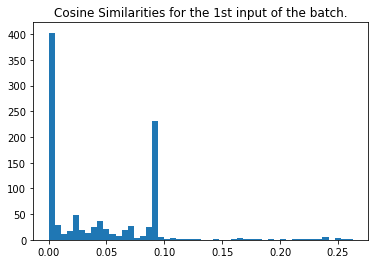

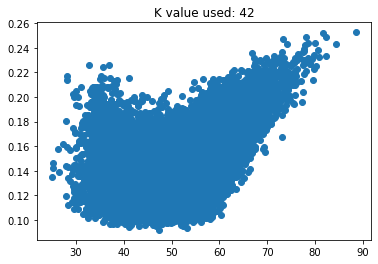

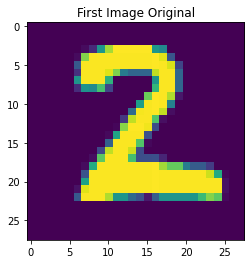

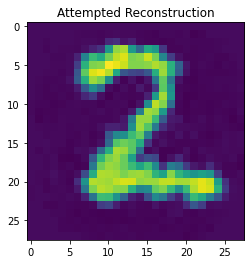

MSE loss for this input is:  0.0017056939553241341
train loss: 0.0001313207030761987 test loss: 0.00014007685240358114
[epoch, batch], [34,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


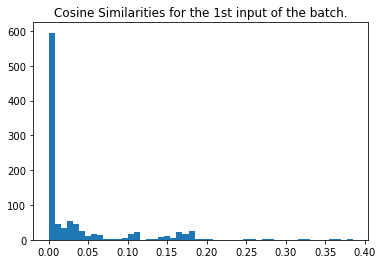

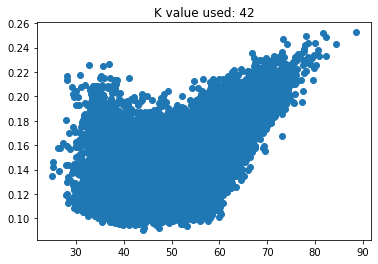

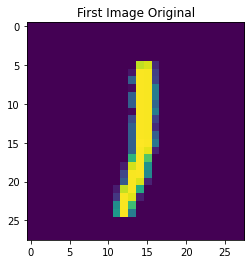

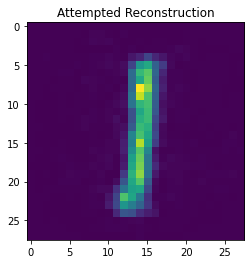

MSE loss for this input is:  0.0015993986506851353
train loss: 0.00013468816177919507 test loss: 0.00013182881230022758
[epoch, batch], [35,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


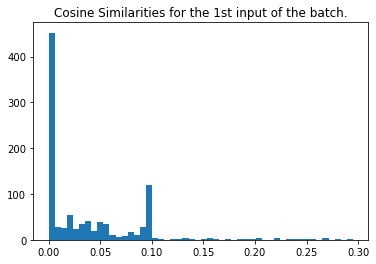

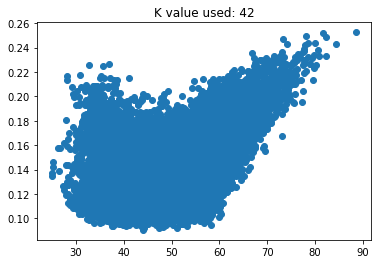

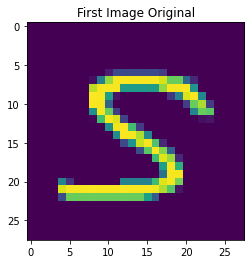

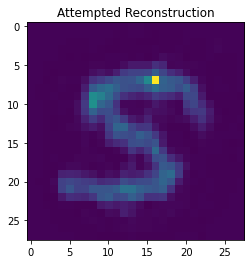

MSE loss for this input is:  0.0016360399978501456
train loss: 0.00012075077393092215 test loss: 0.0001438109902665019
[epoch, batch], [36,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


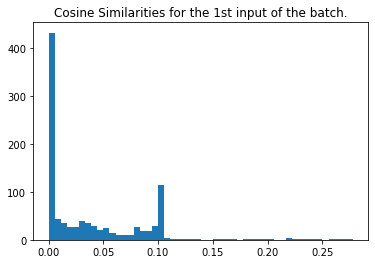

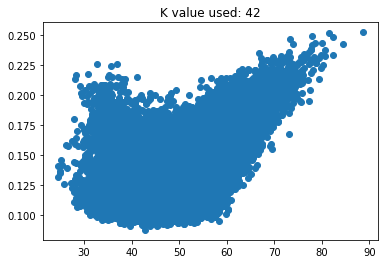

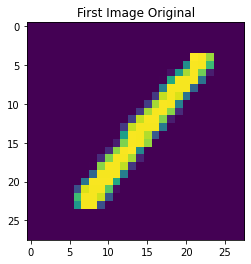

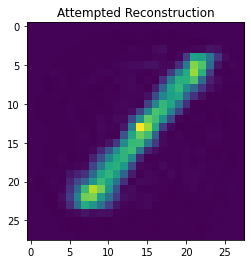

MSE loss for this input is:  0.0020902210048266818
train loss: 0.00012282085663173348 test loss: 0.00013245924492366612
[epoch, batch], [37,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


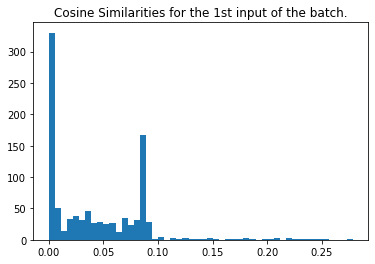

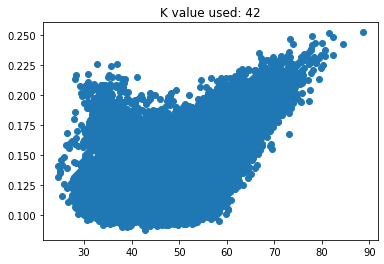

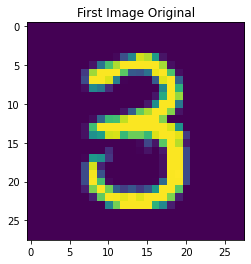

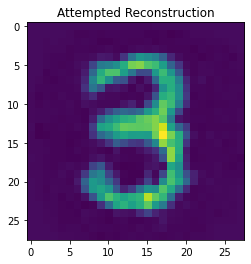

MSE loss for this input is:  0.001682532685143607
train loss: 0.0001306036429014057 test loss: 0.000123784935567528
[epoch, batch], [38,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


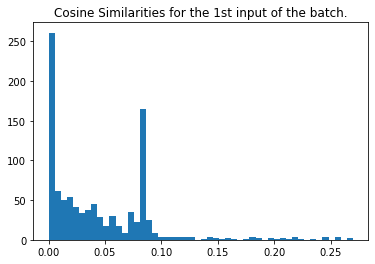

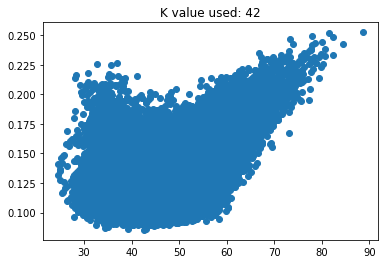

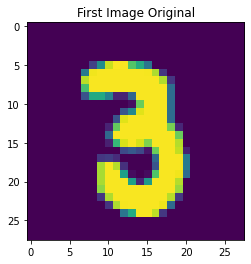

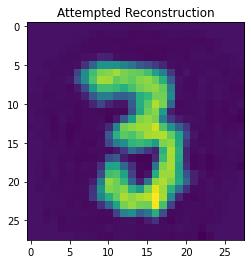

MSE loss for this input is:  0.0013084969654375193
train loss: 0.0001309169310843572 test loss: 0.000132508430397138
[epoch, batch], [39,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


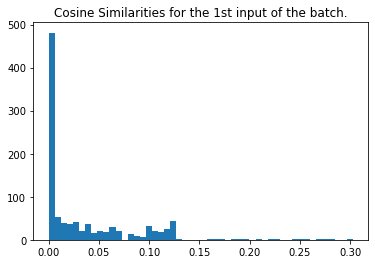

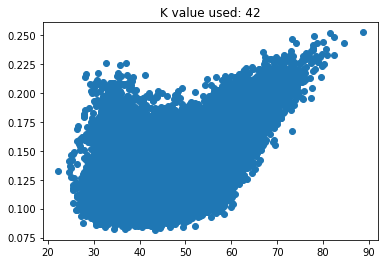

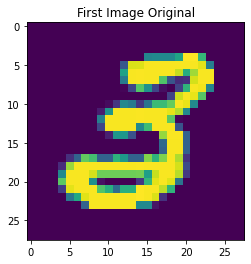

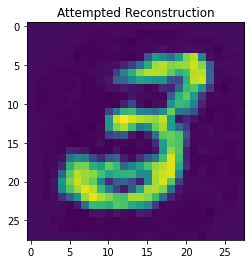

MSE loss for this input is:  0.0016159768007239516
train loss: 0.00012714331387542188 test loss: 0.00011953370994888246
[epoch, batch], [40,   250] loss: 0.000
mean actives 42.0 0.042 % | max 42 0.042 %
(128, 1000) shape of cosine sims


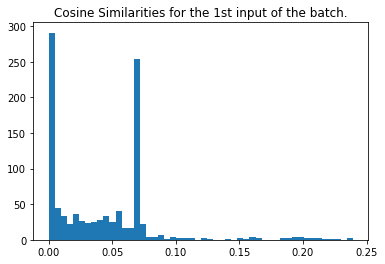

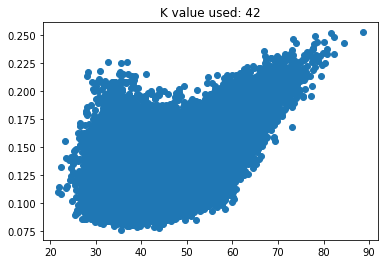

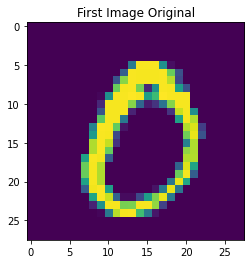

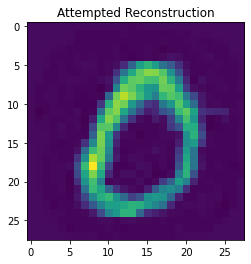

MSE loss for this input is:  0.0015115763763992153
train loss: 0.0001235083764186129 test loss: 0.00012739517842419446
Finished Training


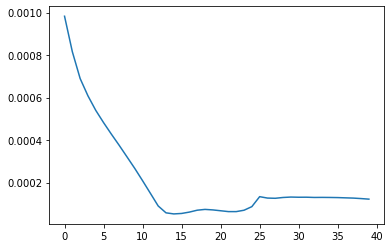

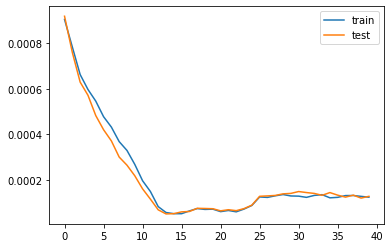

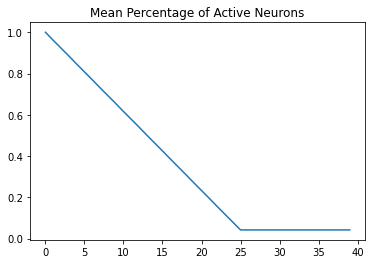

Latents and Labels dimensions: (60000, 1000) (60000,)
Latents and Labels dimensions: (10000, 1000) (10000,)
Logistic regression accuracy: Train= 0.881 | Test= 0.888


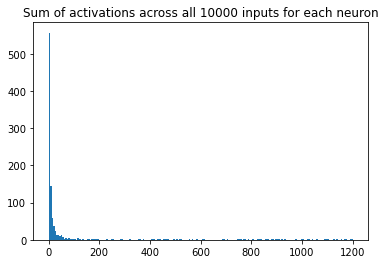

[557. 145.  59.  38.  24.  12.  14.   9.  13.   8.   3.   5.   2.   4.
   1.   2.   1.   2.   0.   4.   1.   0.   3.   0.   0.   2.   1.   0.
   2.   1.   2.   1.   2.   0.   0.   0.   0.   0.   2.   0.   0.   1.
   2.   0.   0.   0.   0.   1.   1.   0.   0.   0.   0.   2.   0.   0.
   0.   0.   0.   1.   1.   0.   1.   0.   0.   0.   0.   1.   1.   1.
   0.   2.   1.   1.   0.   1.   1.   1.   1.   0.   0.   0.   2.   0.
   1.   0.   1.   1.   0.   0.   0.   0.   1.   0.   1.   0.   0.   1.
   0.   0.   0.   1.   1.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   1.   1.   0.   1.   0.   0.   0.   0.   0.   0.   1.   1.
   1.   0.   2.   2.   0.   1.   0.   0.   3.   0.   0.   2.   2.   1.
   0.   0.   1.   1.   1.   0.   1.   1.   0.   1.   2.   1.   0.   1.
   0.   1.   0.   0.   0.   0.   0.   0.   1.   0.   0.   0.   1.   1.
   0.   0.   1.   2.   0.   1.   0.   0.   1.   0.   0.   0.   0.   1.
   1.   1.   0.   0.   0.   1.   0.   1.   0.   0.   1.   0.   1.   1.
   0. 

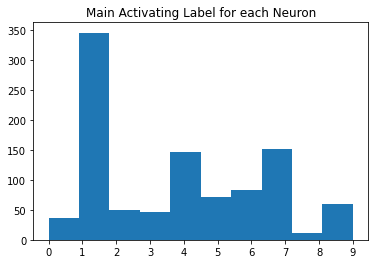

Neuron addresses should be 1000x784!!! (1000, 784) (1000, 784)
Euclidian distance


,0,1,2,3,4,5,6,7,8,9
0,0.000000,0.084436,0.059606,0.078614,0.083681,0.063440,0.073612,0.063443,0.201393,0.083471
1,0.084436,0.000000,0.061687,0.058373,0.027873,0.047283,0.037684,0.035325,0.159630,0.037799
2,0.059606,0.061687,0.000000,0.059350,0.066452,0.054308,0.055746,0.057436,0.188944,0.068307
3,0.078614,0.058373,0.059350,0.000000,0.068841,0.060136,0.057472,0.062061,0.184886,0.069264
4,0.083681,0.027873,0.066452,0.068841,0.000000,0.042231,0.038092,0.035659,0.158489,0.033481
5,0.063440,0.047283,0.054308,0.060136,0.042231,0.000000,0.053473,0.041772,0.156683,0.055377
6,0.073612,0.037684,0.055746,0.057472,0.038092,0.053473,0.000000,0.051767,0.185977,0.057638
7,0.063443,0.035325,0.057436,0.062061,0.035659,0.041772,0.051767,0.000000,0.168191,0.040649
8,0.201393,0.159630,0.188944,0.184886,0.158489,0.156683,0.185977,0.168191,0.000000,0.175387
9,0.083471,0.037799,0.068307,0.069264,0.033481,0.055377,0.057638,0.040649,0.175387,0.000000


cosine similarity


,0,1,2,3,4,5,6,7,8,9
0,1.000000,0.450569,0.604606,0.486787,0.514911,0.618946,0.563228,0.589224,0.302994,0.467622
1,0.450569,1.000000,0.537038,0.573328,0.828744,0.689427,0.757585,0.743672,0.448802,0.731787
2,0.604606,0.537038,1.000000,0.552256,0.571483,0.634214,0.630675,0.570101,0.313468,0.500383
3,0.486787,0.573328,0.552256,1.000000,0.564076,0.602403,0.626222,0.547473,0.338414,0.505993
4,0.514911,0.828744,0.571483,0.564076,1.000000,0.752555,0.779276,0.778987,0.474770,0.795090
5,0.618946,0.689427,0.634214,0.602403,0.752555,1.000000,0.678742,0.726547,0.475226,0.642378
6,0.563228,0.757585,0.630675,0.626222,0.779276,0.678742,1.000000,0.665626,0.363083,0.633221
7,0.589224,0.743672,0.570101,0.547473,0.778987,0.726547,0.665626,1.000000,0.412246,0.712178
8,0.302994,0.448802,0.313468,0.338414,0.474770,0.475226,0.363083,0.412246,1.000000,0.385876
9,0.467622,0.731787,0.500383,0.505993,0.795090,0.642378,0.633221,0.712178,0.385876,1.000000


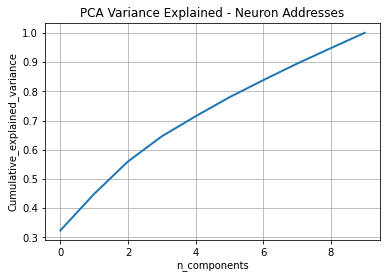

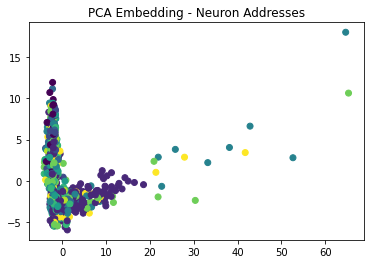

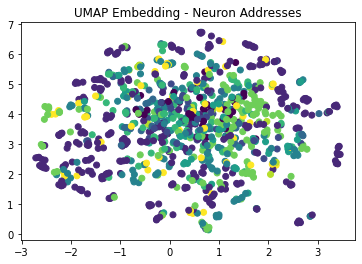

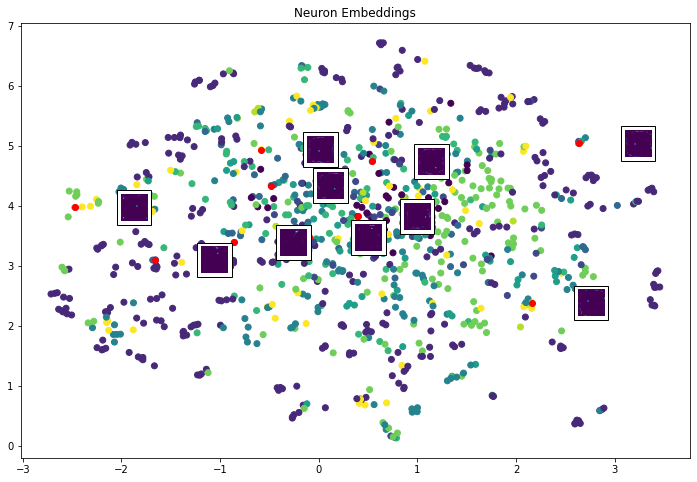

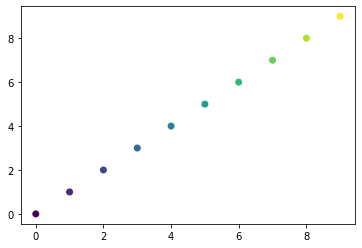

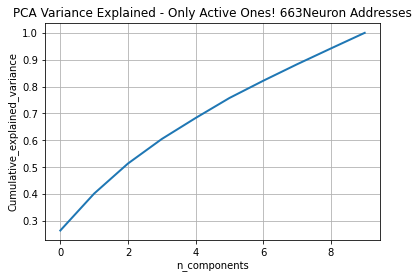

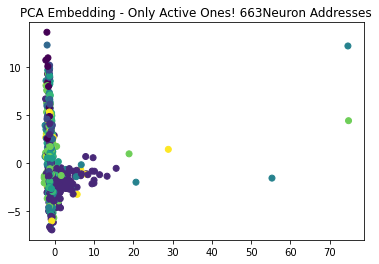

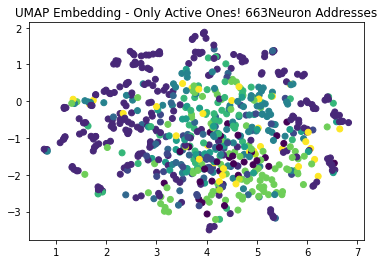

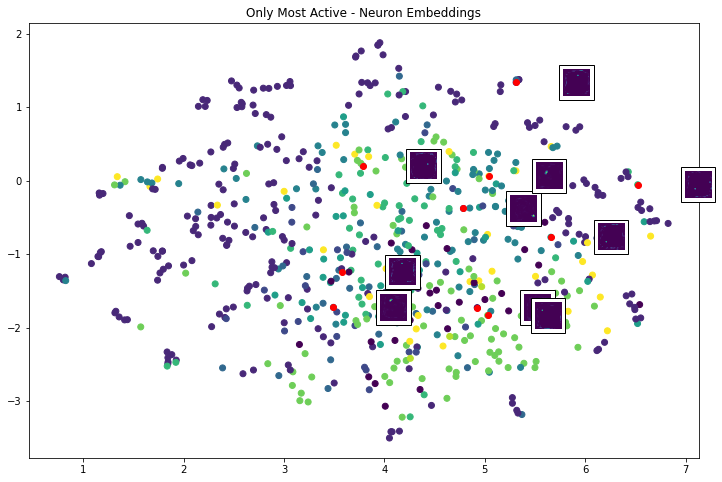

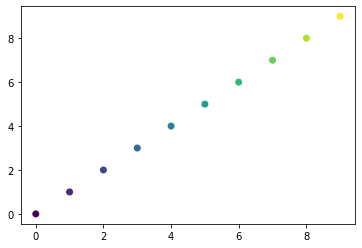

Giving some random plots from the most active neurons


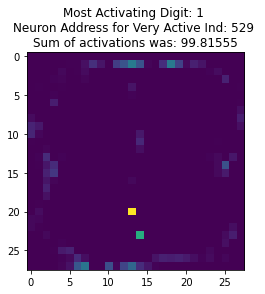

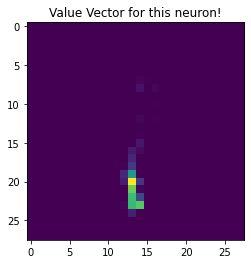

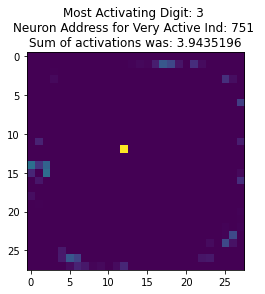

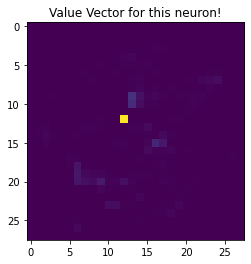

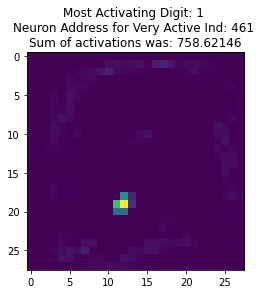

...

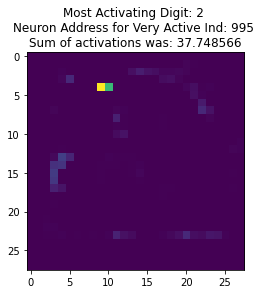

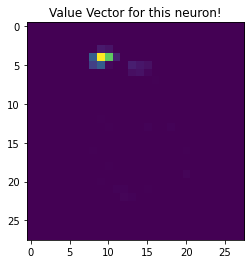

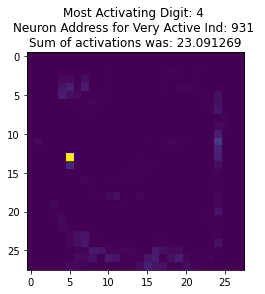

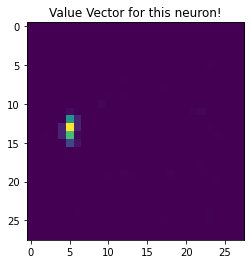

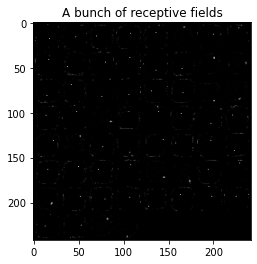

==================== K= 53 ===================
length of net parameters 2
[epoch, batch], [1,   250] loss: 0.000
mean actives 1000.0 1.0 % | max 1000 1.0 %
(128, 1000) shape of cosine sims


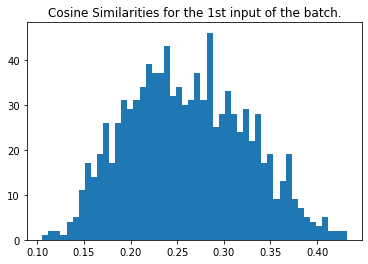

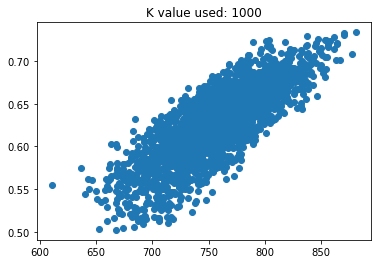

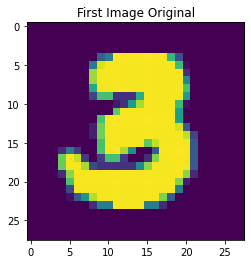

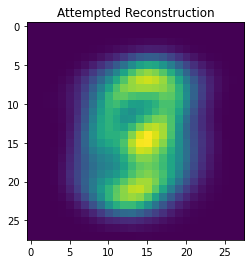

MSE loss for this input is:  0.0007670023763666347
train loss: 0.0009202919318340719 test loss: 0.0009290112066082656
[epoch, batch], [2,   250] loss: 0.000
mean actives 962.0 0.962 % | max 962 0.962 %
(128, 1000) shape of cosine sims


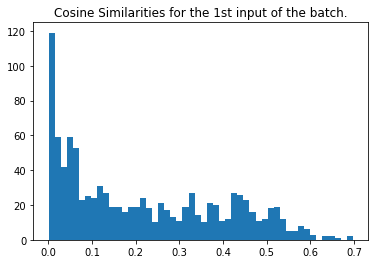

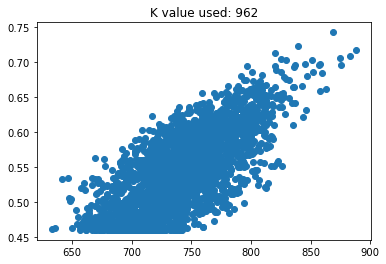

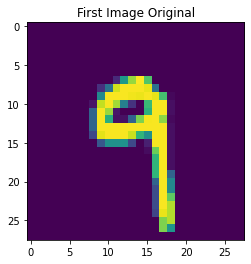

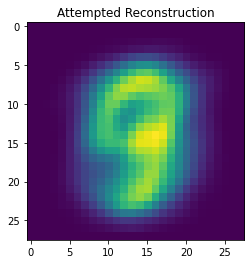

MSE loss for this input is:  0.0011650724526570768
train loss: 0.0007899439078755677 test loss: 0.0007504888344556093
[epoch, batch], [3,   250] loss: 0.000
mean actives 924.0 0.924 % | max 924 0.924 %
(128, 1000) shape of cosine sims


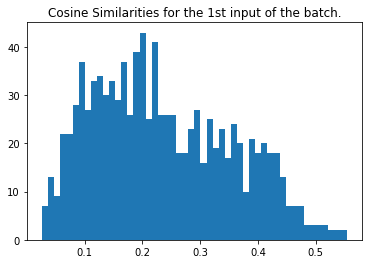

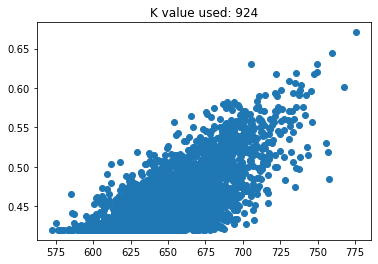

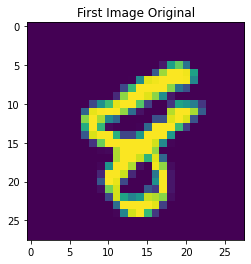

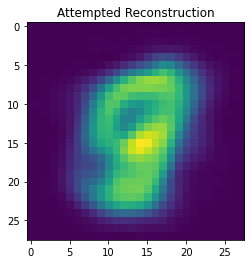

MSE loss for this input is:  0.0006504659445918336
train loss: 0.0006764156860299408 test loss: 0.00063820875948295
[epoch, batch], [4,   250] loss: 0.000
mean actives 886.0 0.886 % | max 886 0.886 %
(128, 1000) shape of cosine sims


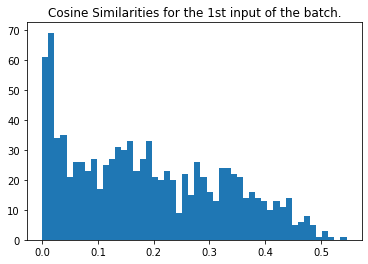

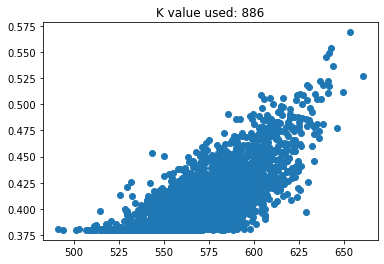

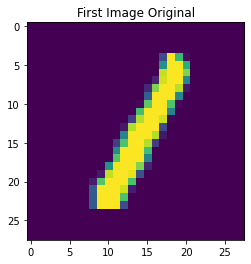

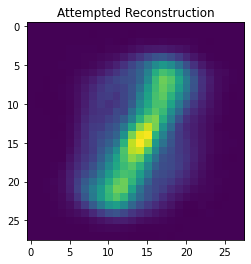

MSE loss for this input is:  0.001090520118572274
train loss: 0.0006124104838818312 test loss: 0.0005817913333885372
[epoch, batch], [5,   250] loss: 0.000
mean actives 848.0 0.848 % | max 848 0.848 %
(128, 1000) shape of cosine sims


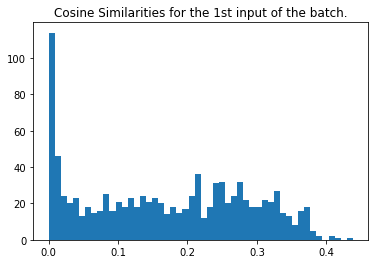

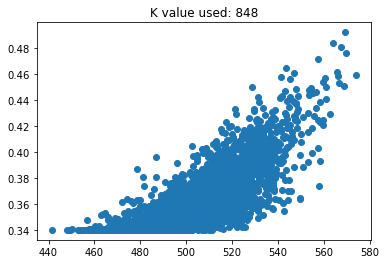

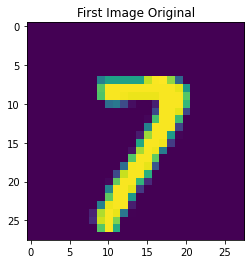

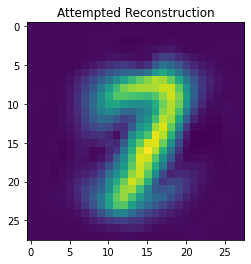

MSE loss for this input is:  0.0008507917578123054
train loss: 0.0005402641254477203 test loss: 0.0004921664949506521
[epoch, batch], [6,   250] loss: 0.000
mean actives 810.0 0.81 % | max 810 0.81 %
(128, 1000) shape of cosine sims


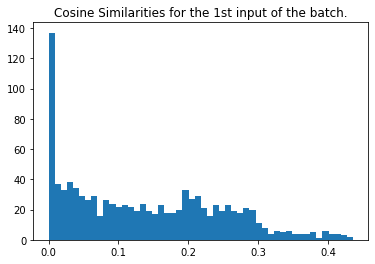

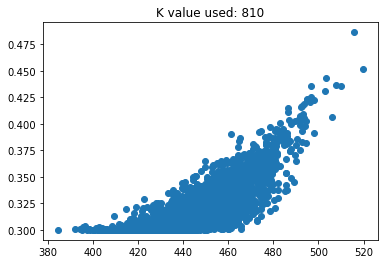

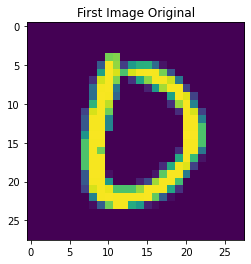

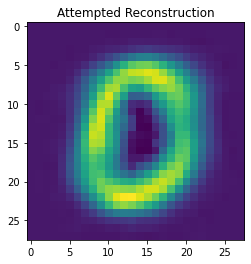

MSE loss for this input is:  0.001274808176926204
train loss: 0.0004796842986252159 test loss: 0.00042209235834889114
[epoch, batch], [7,   250] loss: 0.000
mean actives 772.0 0.772 % | max 772 0.772 %
(128, 1000) shape of cosine sims


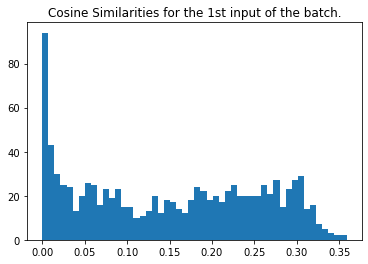

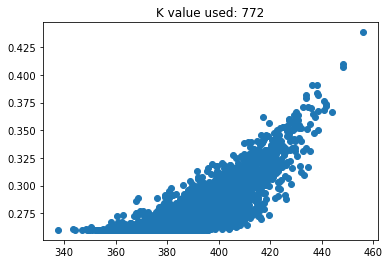

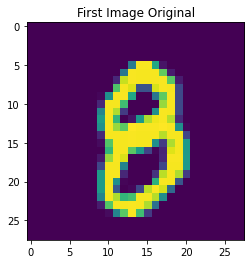

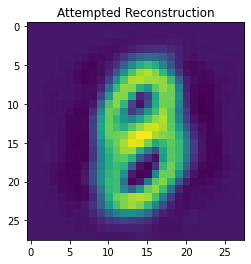

MSE loss for this input is:  0.0008579126882309816
train loss: 0.00042095573735423386 test loss: 0.00037348680780269206
[epoch, batch], [8,   250] loss: 0.000
mean actives 734.0 0.734 % | max 734 0.734 %
(128, 1000) shape of cosine sims


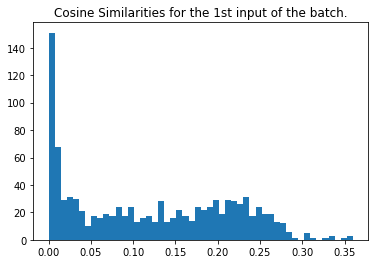

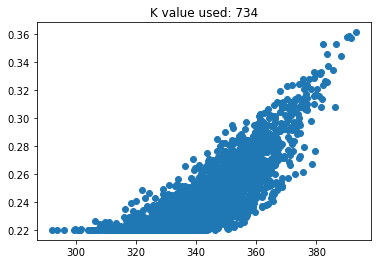

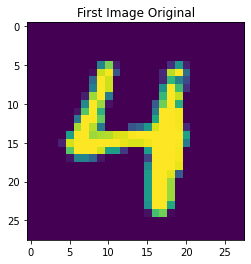

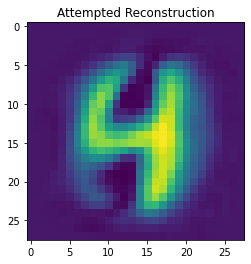

MSE loss for this input is:  0.001080646274649367
train loss: 0.00039244021172635257 test loss: 0.0003243418759666383
[epoch, batch], [9,   250] loss: 0.000
mean actives 696.0 0.696 % | max 696 0.696 %
(128, 1000) shape of cosine sims


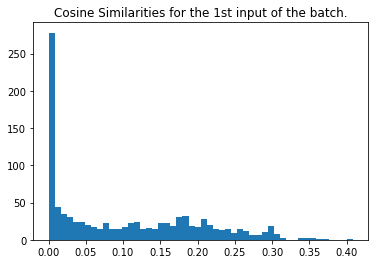

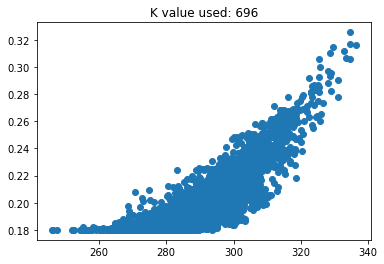

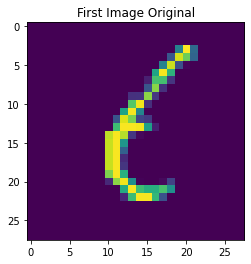

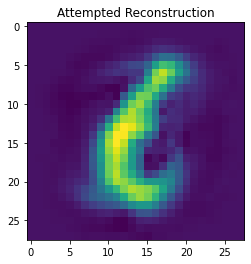

MSE loss for this input is:  0.0014529763435830875
train loss: 0.000311062642140314 test loss: 0.0002815821208059788
[epoch, batch], [10,   250] loss: 0.000
mean actives 659.0 0.659 % | max 659 0.659 %
(128, 1000) shape of cosine sims


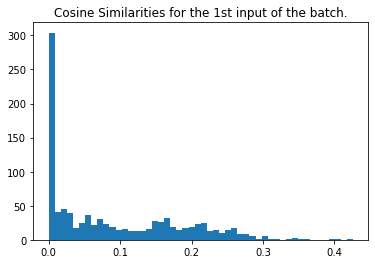

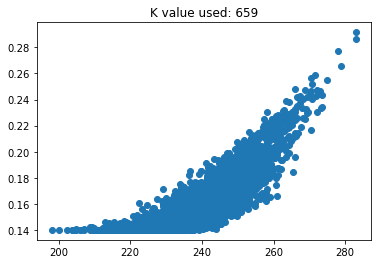

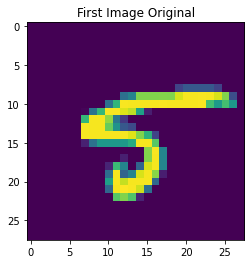

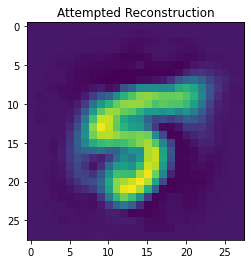

MSE loss for this input is:  0.0016468521587702694
train loss: 0.0002594810794107616 test loss: 0.0002208135847467929
[epoch, batch], [11,   250] loss: 0.000
mean actives 621.0 0.621 % | max 621 0.621 %
(128, 1000) shape of cosine sims


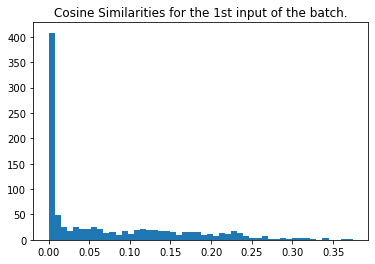

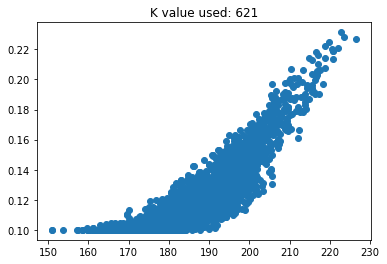

MSE loss for this input is:  0.001416040014247505
train loss: 0.00022137216001283377 test loss: 0.0001738964201649651
[epoch, batch], [12,   250] loss: 0.000
mean actives 583.0 0.583 % | max 583 0.583 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0017947501369885036
train loss: 0.00014286556688603014 test loss: 0.00012005113967461511
[epoch, batch], [13,   250] loss: 0.000
mean actives 545.0 0.545 % | max 545 0.545 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0013240756733076914
train loss: 8.460097160423175e-05 test loss: 6.779022078262642e-05
[epoch, batch], [14,   250] loss: 0.000
mean actives 507.0 0.507 % | max 507 0.507 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0016563320342375307
train loss: 5.549806883209385e-05 test loss: 5.475162834045477e-05
[epoch, batch], [15,   250] loss: 0.000
mean actives 469.0 0.469 % | max 469 0.469 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.001861468565707304
train loss: 4.6615354222012684e-05 test loss: 5.700119072571397e-05
[epoch, batch], [16,   250] loss: 0.000
mean actives 431.0 0.431 % | max 431 0.431 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0013173868765636366
train loss: 4.99096822750289e-05 test loss: 4.855551014770754e-05
[epoch, batch], [17,   250] loss: 0.000
mean actives 393.0 0.393 % | max 393 0.393 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0013388840823757406
train loss: 5.50377371837385e-05 test loss: 5.987526674289256e-05
[epoch, batch], [18,   250] loss: 0.000
mean actives 356.0 0.356 % | max 356 0.356 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0014230505544312146
train loss: 7.123208342818543e-05 test loss: 7.489891140721738e-05
[epoch, batch], [19,   250] loss: 0.000
mean actives 318.0 0.318 % | max 318 0.318 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0018914621703478756
train loss: 7.272748916875571e-05 test loss: 7.7544515079353e-05
[epoch, batch], [20,   250] loss: 0.000
mean actives 280.0 0.28 % | max 280 0.28 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0017393001792382222
train loss: 7.42278789402917e-05 test loss: 7.564700354123488e-05
[epoch, batch], [21,   250] loss: 0.000
mean actives 242.0 0.242 % | max 242 0.242 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0017754096461802113
train loss: 7.385192293440923e-05 test loss: 6.515051063615829e-05
[epoch, batch], [22,   250] loss: 0.000
mean actives 204.0 0.204 % | max 204 0.204 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0011507474190118362
train loss: 6.237243360374123e-05 test loss: 6.187959661474451e-05
[epoch, batch], [23,   250] loss: 0.000
mean actives 166.0 0.166 % | max 166 0.166 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0020081741469247
train loss: 6.627944821957499e-05 test loss: 6.92766479915008e-05
[epoch, batch], [24,   250] loss: 0.000
mean actives 128.0 0.128 % | max 128 0.128 %
(128, 1000) shape of cosine sims


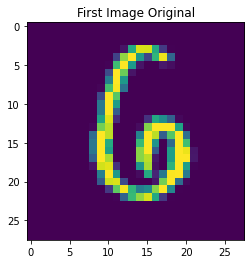

MSE loss for this input is:  0.0015225449995118745
train loss: 6.550001126015559e-05 test loss: 6.898982246639207e-05
[epoch, batch], [25,   250] loss: 0.000
mean actives 90.0 0.09 % | max 90 0.09 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0017029522937171313
train loss: 7.765063492115587e-05 test loss: 8.197165152523667e-05
[epoch, batch], [26,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0016919964430283528
train loss: 0.00011609770444920287 test loss: 0.00010824803757714108
[epoch, batch], [27,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0016832091674512746
train loss: 0.00011464179988251999 test loss: 0.00011458225344540551
[epoch, batch], [28,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0020926026057223883
train loss: 0.00011477006773930043 test loss: 0.00011160528083564714
[epoch, batch], [29,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0015988249559791721
train loss: 0.0001188706373795867 test loss: 0.0001155319987447001
[epoch, batch], [30,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0014552887605161083
train loss: 0.00011489495955174789 test loss: 0.00012156572483945638
[epoch, batch], [31,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.001372828015259334
train loss: 0.00011929162428714335 test loss: 0.00013119724462740123
[epoch, batch], [32,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.001568826637705978
train loss: 0.00011196770356036723 test loss: 0.00012734289339277893
[epoch, batch], [33,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.00149353669614208
train loss: 0.00011427362187532708 test loss: 0.00012960756430402398
[epoch, batch], [34,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0008100990434082187
train loss: 0.00010675610974431038 test loss: 0.00012527653598226607
[epoch, batch], [35,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0014023669824308278
train loss: 0.00010722748993430287 test loss: 0.00013201835099607706
[epoch, batch], [36,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0015820235926277783
train loss: 0.00010987775749526918 test loss: 0.00012014616368105635
[epoch, batch], [37,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


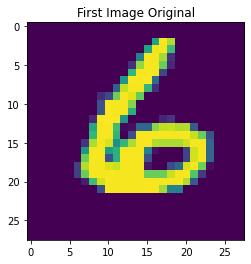

MSE loss for this input is:  0.0015744007363611338
train loss: 0.00010696422395994887 test loss: 0.00012492401583585888
[epoch, batch], [38,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0017317361673530266
train loss: 0.00010657736856956035 test loss: 0.0001112684840336442
[epoch, batch], [39,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0009933881917778328
train loss: 0.00010273521183989942 test loss: 0.00010929570271400735
[epoch, batch], [40,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0007967584747440961
train loss: 0.00010228170140180737 test loss: 0.00010520526120672002
Finished Training


Latents and Labels dimensions: (60000, 1000) (60000,)
Latents and Labels dimensions: (10000, 1000) (10000,)
Logistic regression accuracy: Train= 0.886 | Test= 0.894


[545. 140.  55.  37.  23.   8.  17.  10.   7.  10.   4.   8.   6.   4.
   4.   2.   2.   0.   2.   1.   2.   1.   2.   0.   0.   0.   1.   1.
   1.   2.   0.   1.   1.   1.   0.   0.   4.   1.   0.   0.   0.   0.
   0.   1.   0.   1.   1.   2.   0.   0.   1.   0.   0.   1.   2.   1.
   0.   0.   1.   1.   1.   1.   0.   1.   1.   0.   0.   0.   1.   1.
   1.   0.   1.   1.   0.   0.   0.   2.   0.   0.   0.   0.   0.   0.
   1.   0.   0.   2.   0.   0.   1.   1.   0.   1.   1.   1.   1.   0.
   0.   1.   0.   2.   0.   3.   2.   0.   1.   1.   1.   0.   0.   2.
   1.   0.   2.   0.   0.   1.   0.   0.   1.   1.   0.   0.   1.   1.
   0.   2.   1.   0.   2.   0.   1.   0.   2.   2.   0.   1.   0.   1.
   3.   1.   0.   1.   0.   1.   1.   0.   1.   1.   0.   2.   0.   2.
   0.   2.   1.   2.   1.   2.   0.   0.   0.   0.   0.   0.   0.   0.
   1.   1.   0.   0.   2.   1.   0.   1.   1.   0.   2.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.   0.   0.
   0. 

Neuron addresses should be 1000x784!!! (1000, 784) (1000, 784)
Euclidian distance


,0,1,2,3,4,5,6,7,8,9
0,0.000000,0.098789,0.067038,0.080000,0.110415,0.084669,0.085990,0.081761,0.253111,0.094874
1,0.098789,0.000000,0.080739,0.060707,0.030961,0.052073,0.055047,0.029044,0.252418,0.047492
2,0.067038,0.080739,0.000000,0.056000,0.088090,0.065653,0.071699,0.069447,0.243314,0.087726
3,0.080000,0.060707,0.056000,0.000000,0.063646,0.059492,0.053440,0.057444,0.248376,0.081248
4,0.110415,0.030961,0.088090,0.063646,0.000000,0.051649,0.049695,0.033873,0.245993,0.053817
5,0.084669,0.052073,0.065653,0.059492,0.051649,0.000000,0.059231,0.044787,0.214330,0.073326
6,0.085990,0.055047,0.071699,0.053440,0.049695,0.059231,0.000000,0.059828,0.260349,0.080452
7,0.081761,0.029044,0.069447,0.057444,0.033873,0.044787,0.059828,0.000000,0.238367,0.038395
8,0.253111,0.252418,0.243314,0.248376,0.245993,0.214330,0.260349,0.238367,0.000000,0.268261
9,0.094874,0.047492,0.087726,0.081248,0.053817,0.073326,0.080452,0.038395,0.268261,0.000000


cosine similarity


,0,1,2,3,4,5,6,7,8,9
0,1.000000,0.356799,0.495760,0.429250,0.393022,0.471484,0.451609,0.441671,0.333438,0.346892
1,0.356799,1.000000,0.504490,0.641682,0.855536,0.720323,0.699758,0.833968,0.368461,0.727062
2,0.495760,0.504490,1.000000,0.625196,0.542272,0.612460,0.567440,0.553210,0.379093,0.432108
3,0.429250,0.641682,0.625196,1.000000,0.683044,0.660314,0.689538,0.645007,0.368103,0.495464
4,0.393022,0.855536,0.542272,0.683044,1.000000,0.757946,0.765281,0.840112,0.413173,0.738012
5,0.471484,0.720323,0.612460,0.660314,0.757946,1.000000,0.685283,0.751545,0.490549,0.590445
6,0.451609,0.699758,0.567440,0.689538,0.765281,0.685283,1.000000,0.661664,0.346178,0.542934
7,0.441671,0.833968,0.553210,0.645007,0.840112,0.751545,0.661664,1.000000,0.406719,0.769574
8,0.333438,0.368461,0.379093,0.368103,0.413173,0.490549,0.346178,0.406719,1.000000,0.307905
9,0.346892,0.727062,0.432108,0.495464,0.738012,0.590445,0.542934,0.769574,0.307905,1.000000


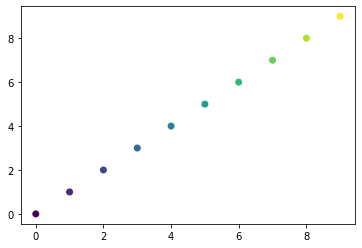

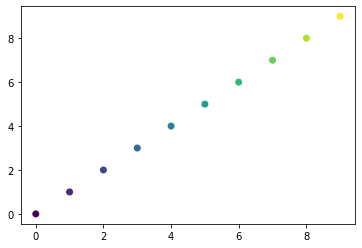

Giving some random plots from the most active neurons


length of net parameters 2
[epoch, batch], [1,   250] loss: 0.000
mean actives 1000.0 1.0 % | max 1000 1.0 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0008044167592817424
train loss: 0.0009263544343411922 test loss: 0.0009199004271067679
[epoch, batch], [2,   250] loss: 0.000
mean actives 962.0 0.962 % | max 962 0.962 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0011656132279610147
train loss: 0.0007725241011939943 test loss: 0.0007851258851587772
[epoch, batch], [3,   250] loss: 0.000
mean actives 924.0 0.924 % | max 924 0.924 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0006785838275539631
train loss: 0.0007103847456164658 test loss: 0.0006527398945763707
[epoch, batch], [4,   250] loss: 0.000
mean actives 886.0 0.886 % | max 886 0.886 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0008946521853914067
train loss: 0.0005980035639367998 test loss: 0.0005510448245331645
[epoch, batch], [5,   250] loss: 0.000
mean actives 848.0 0.848 % | max 848 0.848 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0008205705303318646
train loss: 0.0005170129588805139 test loss: 0.0004744574544019997
[epoch, batch], [6,   250] loss: 0.000
mean actives 810.0 0.81 % | max 810 0.81 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0012527745293111217
train loss: 0.00047569075832143426 test loss: 0.00041356333531439304
[epoch, batch], [7,   250] loss: 0.000
mean actives 772.0 0.772 % | max 772 0.772 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0004369147426011611
train loss: 0.000423862918978557 test loss: 0.00036375917261466384
[epoch, batch], [8,   250] loss: 0.000
mean actives 734.0 0.734 % | max 734 0.734 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0008510977638011076
train loss: 0.00034892011899501085 test loss: 0.0003118971362709999
[epoch, batch], [9,   250] loss: 0.000
mean actives 696.0 0.696 % | max 696 0.696 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0009093462508551929
train loss: 0.0003191865107510239 test loss: 0.0002786117547657341
[epoch, batch], [10,   250] loss: 0.000
mean actives 659.0 0.659 % | max 659 0.659 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.000354266174289645
train loss: 0.0002585138427093625 test loss: 0.00022564938990399241
[epoch, batch], [11,   250] loss: 0.000
mean actives 621.0 0.621 % | max 621 0.621 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.001224388805579166
train loss: 0.00020596694957930595 test loss: 0.0001790043752407655
[epoch, batch], [12,   250] loss: 0.000
mean actives 583.0 0.583 % | max 583 0.583 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0007563540521933108
train loss: 0.0001419222098775208 test loss: 0.00012778036762028933
[epoch, batch], [13,   250] loss: 0.000
mean actives 545.0 0.545 % | max 545 0.545 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0015413332350400029
train loss: 8.212011744035408e-05 test loss: 7.266072498168796e-05
[epoch, batch], [14,   250] loss: 0.000
mean actives 506.671875 0.506671875 % | max 507 0.507 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.001594224146434239
train loss: 5.096653330838308e-05 test loss: 4.8275596782332286e-05
[epoch, batch], [15,   250] loss: 0.000
mean actives 469.0 0.469 % | max 469 0.469 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0015723554759609457
train loss: 4.900792191619985e-05 test loss: 4.862194327870384e-05
[epoch, batch], [16,   250] loss: 0.000
mean actives 431.0 0.431 % | max 431 0.431 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0013940875627556626
train loss: 6.035219848854467e-05 test loss: 4.6434885007329285e-05
[epoch, batch], [17,   250] loss: 0.000
mean actives 393.0 0.393 % | max 393 0.393 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0011931014608363717
train loss: 5.956710811005905e-05 test loss: 6.367654714267701e-05
[epoch, batch], [18,   250] loss: 0.000
mean actives 356.0 0.356 % | max 356 0.356 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.001692789549730262
train loss: 6.754406786058098e-05 test loss: 7.551593444077298e-05
[epoch, batch], [19,   250] loss: 0.000
mean actives 318.0 0.318 % | max 318 0.318 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.001354026399096664
train loss: 7.005127554293722e-05 test loss: 7.072373409755528e-05
[epoch, batch], [20,   250] loss: 0.000
mean actives 280.0 0.28 % | max 280 0.28 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0007007268010353556
train loss: 7.508081034757197e-05 test loss: 7.138761429814622e-05
[epoch, batch], [21,   250] loss: 0.000
mean actives 242.0 0.242 % | max 242 0.242 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0015785362647504223
train loss: 7.008740067249164e-05 test loss: 6.998466415097937e-05
[epoch, batch], [22,   250] loss: 0.000
mean actives 204.0 0.204 % | max 204 0.204 %
(128, 1000) shape of cosine sims


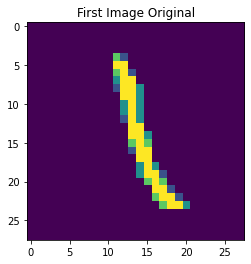

MSE loss for this input is:  0.001711505712295065
train loss: 6.363756256178021e-05 test loss: 6.803117139497772e-05
[epoch, batch], [23,   250] loss: 0.000
mean actives 166.0 0.166 % | max 166 0.166 %
(128, 1000) shape of cosine sims


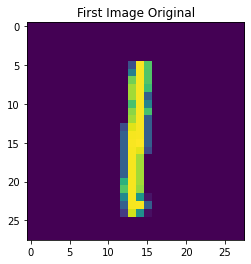

MSE loss for this input is:  0.0020378178783825467
train loss: 5.772530130343512e-05 test loss: 6.146397208794951e-05
[epoch, batch], [24,   250] loss: 0.000
mean actives 128.0 0.128 % | max 128 0.128 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0012145851339612687
train loss: 6.7636210587807e-05 test loss: 6.785755249438807e-05
[epoch, batch], [25,   250] loss: 0.000
mean actives 90.0 0.09 % | max 90 0.09 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0014369370681898935
train loss: 8.156519470503554e-05 test loss: 8.182647434296086e-05
[epoch, batch], [26,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0019366488772995618
train loss: 0.00011072600318584591 test loss: 0.00010573979670880362
[epoch, batch], [27,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.001460857841433311
train loss: 0.00011002073006238788 test loss: 0.00011179472494404763
[epoch, batch], [28,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.001142536499062363
train loss: 0.00012122155749239028 test loss: 0.00011064388672821224
[epoch, batch], [29,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.00142769956467103
train loss: 0.00010791877139126882 test loss: 0.00011380956857465208
[epoch, batch], [30,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0012727004989069334
train loss: 0.00012246920960024 test loss: 0.00012095715646864846
[epoch, batch], [31,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0016920981662614004
train loss: 0.0001075008767656982 test loss: 0.00012262021482456475
[epoch, batch], [32,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.000534437330705779
train loss: 0.0001160895117209293 test loss: 0.00014161817671265453
[epoch, batch], [33,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0015862971848371078
train loss: 0.00011825129331555218 test loss: 0.00012578850146383047
[epoch, batch], [34,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0014358032114651737
train loss: 0.00010709591151680797 test loss: 0.00013080675853416324
[epoch, batch], [35,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0014899359369764523
train loss: 0.00010883853974519297 test loss: 0.0001216636155731976
[epoch, batch], [36,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0017786682868490414
train loss: 0.0001090961741283536 test loss: 0.00011916441144421697
[epoch, batch], [37,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0016151745708621278
train loss: 0.00010371761163696647 test loss: 0.00011356751201674342
[epoch, batch], [38,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0009345114231109619
train loss: 0.00010596658830763772 test loss: 0.00010432320414111018
[epoch, batch], [39,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0008566624351910182
train loss: 0.00010492806904949248 test loss: 0.00010118634236278012
[epoch, batch], [40,   250] loss: 0.000
mean actives 53.0 0.053 % | max 53 0.053 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0011196522688379092
train loss: 9.896817209664732e-05 test loss: 0.00010376095451647416
Finished Training


Latents and Labels dimensions: (60000, 1000) (60000,)
Latents and Labels dimensions: (10000, 1000) (10000,)
Logistic regression accuracy: Train= 0.885 | Test= 0.892


[502. 173.  60.  37.  25.  23.   9.  10.   6.   6.   7.   3.   5.   3.
   1.   3.   3.   1.   2.   2.   3.   1.   1.   1.   1.   2.   2.   0.
   0.   0.   0.   1.   1.   0.   1.   0.   1.   1.   1.   0.   0.   0.
   0.   0.   0.   1.   1.   0.   2.   2.   2.   0.   0.   0.   1.   0.
   0.   1.   0.   0.   1.   2.   1.   1.   1.   1.   0.   0.   0.   0.
   0.   1.   1.   0.   0.   2.   0.   0.   2.   1.   1.   0.   0.   0.
   0.   0.   0.   0.   1.   0.   0.   0.   0.   1.   0.   0.   2.   0.
   0.   2.   0.   0.   0.   1.   1.   1.   1.   1.   2.   1.   1.   0.
   0.   1.   1.   0.   1.   1.   2.   0.   0.   1.   2.   0.   0.   0.
   1.   2.   0.   2.   0.   2.   0.   1.   2.   2.   1.   1.   0.   1.
   0.   0.   0.   1.   2.   0.   1.   0.   1.   1.   0.   1.   1.   1.
   1.   0.   0.   2.   2.   0.   1.   0.   0.   2.   1.   2.   1.   1.
   0.   0.   0.   0.   0.   1.   0.   1.   0.   0.   0.   0.   0.   1.
   0.   2.   0.   3.   0.   1.   0.   1.   0.   0.   1.   2.   0.   1.
   0. 

Neuron addresses should be 1000x784!!! (1000, 784) (1000, 784)
Euclidian distance


,0,1,2,3,4,5,6,7,8,9
0,0.000000,0.095566,0.065900,0.077232,0.112096,0.076173,0.091618,0.073159,0.508767,0.097094
1,0.095566,0.000000,0.074273,0.057958,0.033882,0.048496,0.047856,0.027684,0.549533,0.043040
2,0.065900,0.074273,0.000000,0.059176,0.089856,0.064842,0.067911,0.060076,0.521343,0.083732
3,0.077232,0.057958,0.059176,0.000000,0.070552,0.060356,0.057393,0.056797,0.527107,0.071194
4,0.112096,0.033882,0.089856,0.070552,0.000000,0.050604,0.044515,0.037604,0.563745,0.062219
5,0.076173,0.048496,0.064842,0.060356,0.050604,0.000000,0.051977,0.043816,0.499134,0.074112
6,0.091618,0.047856,0.067911,0.057393,0.044515,0.051977,0.000000,0.053657,0.556117,0.078318
7,0.073159,0.027684,0.060076,0.056797,0.037604,0.043816,0.053657,0.000000,0.525358,0.039775
8,0.508767,0.549533,0.521343,0.527107,0.563745,0.499134,0.556117,0.525358,0.000000,0.554541
9,0.097094,0.043040,0.083732,0.071194,0.062219,0.074112,0.078318,0.039775,0.554541,0.000000


cosine similarity


,0,1,2,3,4,5,6,7,8,9
0,1.000000,0.383384,0.501579,0.411727,0.419983,0.534431,0.470657,0.476041,0.219831,0.332406
1,0.383384,1.000000,0.523533,0.628754,0.848824,0.734943,0.752320,0.831882,0.146667,0.743488
2,0.501579,0.523533,1.000000,0.549875,0.544548,0.606412,0.614405,0.570501,0.186267,0.425501
3,0.411727,0.628754,0.549875,1.000000,0.651699,0.633335,0.677129,0.591503,0.169496,0.509272
4,0.419983,0.848824,0.544548,0.651699,1.000000,0.771438,0.804328,0.832287,0.162670,0.705175
5,0.534431,0.734943,0.606412,0.633335,0.771438,1.000000,0.738199,0.745260,0.269449,0.575793
6,0.470657,0.752320,0.614405,0.677129,0.804328,0.738199,1.000000,0.706682,0.154190,0.575910
7,0.476041,0.831882,0.570501,0.591503,0.832287,0.745260,0.706682,1.000000,0.185050,0.739786
8,0.219831,0.146667,0.186267,0.169496,0.162670,0.269449,0.154190,0.185050,1.000000,0.120621
9,0.332406,0.743488,0.425501,0.509272,0.705175,0.575793,0.575910,0.739786,0.120621,1.000000


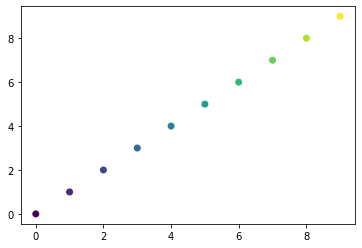

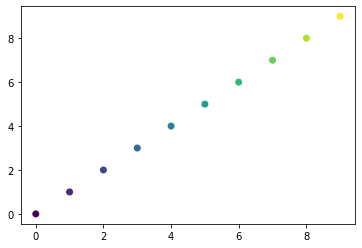

Giving some random plots from the most active neurons


==================== K= 63 ===================
length of net parameters 2
[epoch, batch], [1,   250] loss: 0.000
mean actives 1000.0 1.0 % | max 1000 1.0 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0014079690587763883
train loss: 0.0009411010541953146 test loss: 0.0009219319326803088
[epoch, batch], [2,   250] loss: 0.000
mean actives 962.0 0.962 % | max 962 0.962 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0008120786930833544
train loss: 0.0007725238683633506 test loss: 0.0007510528666898608
[epoch, batch], [3,   250] loss: 0.000
mean actives 925.0 0.925 % | max 925 0.925 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0009836593300712351
train loss: 0.0006938106380403042 test loss: 0.0006167337414808571
[epoch, batch], [4,   250] loss: 0.000
mean actives 887.0 0.887 % | max 887 0.887 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0006187769907469652
train loss: 0.0006133440765552223 test loss: 0.0005627577775157988
[epoch, batch], [5,   250] loss: 0.000
mean actives 850.0 0.85 % | max 850 0.85 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0005828133423109444
train loss: 0.0005315955495461822 test loss: 0.0005006155697628856
[epoch, batch], [6,   250] loss: 0.000
mean actives 812.0 0.812 % | max 812 0.812 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0008513480424880981
train loss: 0.0004855514853261411 test loss: 0.0004382406477816403
[epoch, batch], [7,   250] loss: 0.000
mean actives 775.0 0.775 % | max 775 0.775 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0008121540351789825
train loss: 0.00041720803710632026 test loss: 0.0003684429684653878
[epoch, batch], [8,   250] loss: 0.000
mean actives 737.0 0.737 % | max 737 0.737 %
(128, 1000) shape of cosine sims


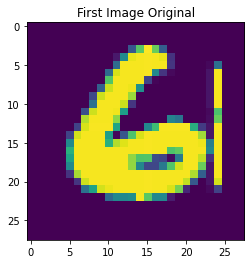

MSE loss for this input is:  0.001069264296366244
train loss: 0.00036529990029521286 test loss: 0.00033193331910297275
[epoch, batch], [9,   250] loss: 0.000
mean actives 700.0 0.7 % | max 700 0.7 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.001417437682346422
train loss: 0.0003171138814650476 test loss: 0.00027797927032224834
[epoch, batch], [10,   250] loss: 0.000
mean actives 662.0 0.662 % | max 662 0.662 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0016926672993874063
train loss: 0.0002583022869657725 test loss: 0.00024436620878987014
[epoch, batch], [11,   250] loss: 0.000
mean actives 625.0 0.625 % | max 625 0.625 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0016546960996121777
train loss: 0.00020610347564797848 test loss: 0.00017889092850964516
[epoch, batch], [12,   250] loss: 0.000
mean actives 587.0 0.587 % | max 587 0.587 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0014834375101692822
train loss: 0.00015315657947212458 test loss: 0.00013144260447006673
[epoch, batch], [13,   250] loss: 0.000
mean actives 550.0 0.55 % | max 550 0.55 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0013802670398536995
train loss: 8.667648216942325e-05 test loss: 7.179284875746816e-05
[epoch, batch], [14,   250] loss: 0.000
mean actives 511.890625 0.511890625 % | max 512 0.512 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0012089185112593125
train loss: 5.706770753022283e-05 test loss: 4.695807001553476e-05
[epoch, batch], [15,   250] loss: 0.000
mean actives 475.0 0.475 % | max 475 0.475 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0017340397652314634
train loss: 4.9512564146425575e-05 test loss: 5.277622403809801e-05
[epoch, batch], [16,   250] loss: 0.000
mean actives 437.0 0.437 % | max 437 0.437 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0019218223739643485
train loss: 5.14154125994537e-05 test loss: 5.114240411785431e-05
[epoch, batch], [17,   250] loss: 0.000
mean actives 400.0 0.4 % | max 400 0.4 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0013996160456112453
train loss: 5.583705205935985e-05 test loss: 5.619463627226651e-05
[epoch, batch], [18,   250] loss: 0.000
mean actives 362.0 0.362 % | max 362 0.362 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0015033775446366292
train loss: 6.635791942244396e-05 test loss: 6.878317799419165e-05
[epoch, batch], [19,   250] loss: 0.000
mean actives 325.0 0.325 % | max 325 0.325 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0020254628390681986
train loss: 7.145696872612461e-05 test loss: 7.112266030162573e-05
[epoch, batch], [20,   250] loss: 0.000
mean actives 287.0 0.287 % | max 287 0.287 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.001992298024041312
train loss: 7.206923328340054e-05 test loss: 7.325477054109797e-05
[epoch, batch], [21,   250] loss: 0.000
mean actives 250.0 0.25 % | max 250 0.25 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.001805801476751055
train loss: 6.696917989756912e-05 test loss: 7.075117900967598e-05
[epoch, batch], [22,   250] loss: 0.000
mean actives 212.0 0.212 % | max 212 0.212 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0022512611990072287
train loss: 6.40250655123964e-05 test loss: 6.370887422235683e-05
[epoch, batch], [23,   250] loss: 0.000
mean actives 175.0 0.175 % | max 175 0.175 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0017622499441613956
train loss: 6.461334851337597e-05 test loss: 6.59624784020707e-05
[epoch, batch], [24,   250] loss: 0.000
mean actives 137.0 0.137 % | max 137 0.137 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.00100770965218544
train loss: 6.25170796411112e-05 test loss: 7.192203338490799e-05
[epoch, batch], [25,   250] loss: 0.000
mean actives 100.0 0.1 % | max 100 0.1 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0018270751651452513
train loss: 7.813002594048157e-05 test loss: 8.250668179243803e-05
[epoch, batch], [26,   250] loss: 0.000
mean actives 63.0 0.063 % | max 63 0.063 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0018502957358652232
train loss: 9.988289093598723e-05 test loss: 9.710099402582273e-05
[epoch, batch], [27,   250] loss: 0.000
mean actives 63.0 0.063 % | max 63 0.063 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0013384650252303298
train loss: 9.300543752033263e-05 test loss: 9.409792255610228e-05
[epoch, batch], [28,   250] loss: 0.000
mean actives 63.0 0.063 % | max 63 0.063 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0007576776706442541
train loss: 9.591164416633546e-05 test loss: 0.00010211753397015855
[epoch, batch], [29,   250] loss: 0.000
mean actives 63.0 0.063 % | max 63 0.063 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0015700979500400778
train loss: 0.00010433753050165251 test loss: 0.0001041401264956221
[epoch, batch], [30,   250] loss: 0.000
mean actives 63.0 0.063 % | max 63 0.063 %
(128, 1000) shape of cosine sims


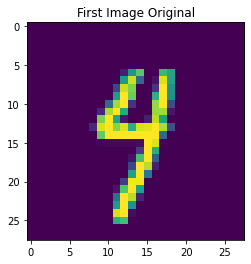

MSE loss for this input is:  0.0014024531962920207
train loss: 9.566851804265752e-05 test loss: 0.0001114192491513677
[epoch, batch], [31,   250] loss: 0.000
mean actives 63.0 0.063 % | max 63 0.063 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0013232377110695352
train loss: 9.828259499045089e-05 test loss: 0.00011283127969363704
[epoch, batch], [32,   250] loss: 0.000
mean actives 63.0 0.063 % | max 63 0.063 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.001495472022465297
train loss: 0.00010129853762919083 test loss: 0.00010458529141033068
[epoch, batch], [33,   250] loss: 0.000
mean actives 63.0 0.063 % | max 63 0.063 %
(128, 1000) shape of cosine sims


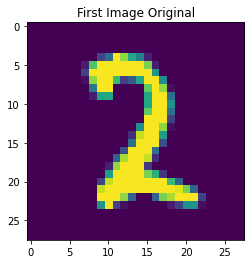

MSE loss for this input is:  0.0012886594144665465
train loss: 0.00010276185639668256 test loss: 0.00010644051508279517
[epoch, batch], [34,   250] loss: 0.000
mean actives 63.0 0.063 % | max 63 0.063 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0016068020949558336
train loss: 9.832698560785502e-05 test loss: 0.00011358953634044155
[epoch, batch], [35,   250] loss: 0.000
mean actives 63.0 0.063 % | max 63 0.063 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0013070466871164283
train loss: 0.0001046757897711359 test loss: 0.00011150663340231404
[epoch, batch], [36,   250] loss: 0.000
mean actives 63.0 0.063 % | max 63 0.063 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.001351572573184967
train loss: 9.292460890719667e-05 test loss: 0.00011651926615741104
[epoch, batch], [37,   250] loss: 0.000
mean actives 63.0 0.063 % | max 63 0.063 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.001802036804812295
train loss: 0.0001008924373309128 test loss: 0.00010257421672577038
[epoch, batch], [38,   250] loss: 0.000
mean actives 63.0 0.063 % | max 63 0.063 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0017325709364852126
train loss: 9.088336082641035e-05 test loss: 9.886533371172845e-05
[epoch, batch], [39,   250] loss: 0.000
mean actives 63.0 0.063 % | max 63 0.063 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0013745889371755173
train loss: 8.655794954393059e-05 test loss: 8.721712219994515e-05
[epoch, batch], [40,   250] loss: 0.000
mean actives 63.0 0.063 % | max 63 0.063 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.001307624487244353
train loss: 7.803033804520965e-05 test loss: 8.487908780807629e-05
Finished Training


Latents and Labels dimensions: (60000, 1000) (60000,)
Latents and Labels dimensions: (10000, 1000) (10000,)
Logistic regression accuracy: Train= 0.891 | Test= 0.896


[535. 115.  44.  44.  18.  20.  16.   9.   8.   7.  12.   3.   4.   3.
   8.   2.   5.   2.   3.   0.   1.   3.   3.   3.   2.   3.   1.   0.
   4.   1.   1.   0.   0.   0.   1.   0.   0.   0.   0.   1.   1.   1.
   0.   1.   0.   0.   0.   1.   1.   1.   2.   1.   0.   0.   1.   0.
   0.   2.   0.   0.   2.   2.   0.   0.   0.   1.   1.   1.   0.   1.
   1.   0.   1.   0.   2.   0.   0.   0.   2.   0.   2.   1.   1.   2.
   0.   0.   0.   1.   0.   1.   0.   0.   1.   2.   1.   0.   2.   0.
   0.   0.   2.   0.   0.   1.   1.   1.   0.   0.   2.   0.   1.   1.
   0.   1.   0.   0.   0.   0.   1.   1.   2.   0.   2.   1.   1.   0.
   0.   0.   0.   3.   0.   0.   1.   1.   0.   2.   2.   2.   1.   1.
   3.   0.   0.   2.   2.   3.   1.   0.   0.   1.   1.   1.   0.   1.
   2.   2.   0.   1.   0.   1.   2.   0.   0.   1.   0.   1.   1.   3.
   0.   0.   0.   1.   1.   0.   1.   0.   1.   0.   1.   0.   2.   1.
   0.   0.   1.   2.   1.   1.   0.   0.   0.   0.   0.   1.   1.   0.
   0. 

Neuron addresses should be 1000x784!!! (1000, 784) (1000, 784)
Euclidian distance


,0,1,2,3,4,5,6,7,8,9
0,0.000000,0.099101,0.072335,0.067621,0.117763,0.077239,0.096042,0.077517,1.019757,0.076485
1,0.099101,0.000000,0.070751,0.059425,0.039197,0.068208,0.052769,0.034230,1.075425,0.041700
2,0.072335,0.070751,0.000000,0.050676,0.087199,0.072966,0.078161,0.069116,1.045075,0.067650
3,0.067621,0.059425,0.050676,0.000000,0.076884,0.064170,0.066521,0.059032,1.033838,0.057451
4,0.117763,0.039197,0.087199,0.076884,0.000000,0.062807,0.045087,0.033874,1.116436,0.058919
5,0.077239,0.068208,0.072966,0.064170,0.062807,0.000000,0.059080,0.047332,1.053657,0.066185
6,0.096042,0.052769,0.078161,0.066521,0.045087,0.059080,0.000000,0.056754,1.094001,0.058037
7,0.077517,0.034230,0.069116,0.059032,0.033874,0.047332,0.056754,0.000000,1.065894,0.040565
8,1.019757,1.075425,1.045075,1.033838,1.116436,1.053657,1.094001,1.065894,0.000000,1.054944
9,0.076485,0.041700,0.067650,0.057451,0.058919,0.066185,0.058037,0.040565,1.054944,0.000000


cosine similarity


,0,1,2,3,4,5,6,7,8,9
0,1.000000,0.393948,0.447277,0.462989,0.447850,0.541438,0.474354,0.503235,0.075709,0.431417
1,0.393948,1.000000,0.609768,0.669265,0.850540,0.671000,0.761939,0.828218,0.043283,0.777364
2,0.447277,0.609768,1.000000,0.648601,0.627684,0.599264,0.606775,0.596782,0.053563,0.554978
3,0.462989,0.669265,0.648601,1.000000,0.676824,0.643431,0.665498,0.649907,0.067952,0.611178
4,0.447850,0.850540,0.627684,0.676824,1.000000,0.753336,0.829522,0.874032,0.033530,0.764748
5,0.541438,0.671000,0.599264,0.643431,0.753336,1.000000,0.733998,0.763175,0.078048,0.642545
6,0.474354,0.761939,0.606775,0.665498,0.829522,0.733998,1.000000,0.736454,0.033586,0.716667
7,0.503235,0.828218,0.596782,0.649907,0.874032,0.763175,0.736454,1.000000,0.047424,0.769280
8,0.075709,0.043283,0.053563,0.067952,0.033530,0.078048,0.033586,0.047424,1.000000,0.040693
9,0.431417,0.777364,0.554978,0.611178,0.764748,0.642545,0.716667,0.769280,0.040693,1.000000


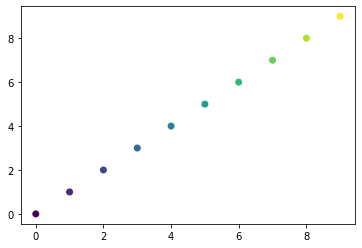

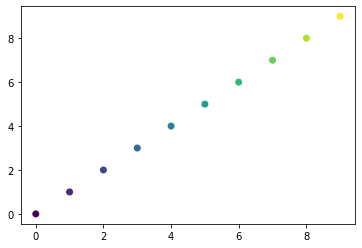

Giving some random plots from the most active neurons


length of net parameters 2
[epoch, batch], [1,   250] loss: 0.000
mean actives 1000.0 1.0 % | max 1000 1.0 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0010441620739138856
train loss: 0.0009050163207575679 test loss: 0.0009034323738887906
[epoch, batch], [2,   250] loss: 0.000
mean actives 962.0 0.962 % | max 962 0.962 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0007299820379335053
train loss: 0.00077008455991745 test loss: 0.0007353514665737748
[epoch, batch], [3,   250] loss: 0.000
mean actives 925.0 0.925 % | max 925 0.925 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0006783439644745418
train loss: 0.0006704119732603431 test loss: 0.0006311883917078376
[epoch, batch], [4,   250] loss: 0.000
mean actives 887.0 0.887 % | max 887 0.887 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0009975043334523026
train loss: 0.0005947379395365715 test loss: 0.0005663085030391812
[epoch, batch], [5,   250] loss: 0.000
mean actives 850.0 0.85 % | max 850 0.85 %
(128, 1000) shape of cosine sims


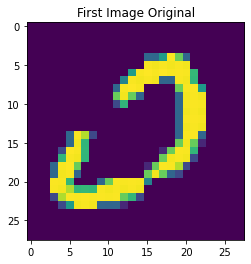

MSE loss for this input is:  0.0013738460078531382
train loss: 0.0005716306040994823 test loss: 0.0004893715376965702
[epoch, batch], [6,   250] loss: 0.000
mean actives 812.0 0.812 % | max 812 0.812 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0010600052013689158
train loss: 0.0004909147974103689 test loss: 0.00043770152842625976
[epoch, batch], [7,   250] loss: 0.000
mean actives 775.0 0.775 % | max 775 0.775 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.001106823889576659
train loss: 0.00042864843271672726 test loss: 0.00041093581239692867
[epoch, batch], [8,   250] loss: 0.000
mean actives 737.0 0.737 % | max 737 0.737 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0011727436616712687
train loss: 0.00038340885657817125 test loss: 0.00032670522341504693
[epoch, batch], [9,   250] loss: 0.000
mean actives 700.0 0.7 % | max 700 0.7 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.001370425431095824
train loss: 0.0003132387064397335 test loss: 0.0002901034022215754
[epoch, batch], [10,   250] loss: 0.000
mean actives 662.0 0.662 % | max 662 0.662 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0011723971336471792
train loss: 0.0002536606916692108 test loss: 0.00022050882398616523
[epoch, batch], [11,   250] loss: 0.000
mean actives 625.0 0.625 % | max 625 0.625 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0011948214045592717
train loss: 0.00020776827295776457 test loss: 0.00016834666894283146
[epoch, batch], [12,   250] loss: 0.000
mean actives 587.0 0.587 % | max 587 0.587 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.001663791585941704
train loss: 0.00014651220408268273 test loss: 0.00012013554805889726
[epoch, batch], [13,   250] loss: 0.000
mean actives 550.0 0.55 % | max 550 0.55 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0014606960573974922
train loss: 8.214491390390322e-05 test loss: 7.38351300242357e-05
[epoch, batch], [14,   250] loss: 0.000
mean actives 512.0 0.512 % | max 512 0.512 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0014513455787483528
train loss: 5.221585524850525e-05 test loss: 5.1993374654557556e-05
[epoch, batch], [15,   250] loss: 0.000
mean actives 475.0 0.475 % | max 475 0.475 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0016688851981746908
train loss: 4.850032928516157e-05 test loss: 4.58470567537006e-05
[epoch, batch], [16,   250] loss: 0.000
mean actives 437.0 0.437 % | max 437 0.437 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0015523258824737705
train loss: 4.845225703320466e-05 test loss: 5.025729115004651e-05
[epoch, batch], [17,   250] loss: 0.000
mean actives 400.0 0.4 % | max 400 0.4 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0014579235290994449
train loss: 5.694168430636637e-05 test loss: 5.90632225794252e-05
[epoch, batch], [18,   250] loss: 0.000
mean actives 362.0 0.362 % | max 362 0.362 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0018279388242838333
train loss: 6.881664012325928e-05 test loss: 7.105051190592349e-05
[epoch, batch], [19,   250] loss: 0.000
mean actives 325.0 0.325 % | max 325 0.325 %
(128, 1000) shape of cosine sims


MSE loss for this input is:  0.0016474778554877456
train loss: 7.204774738056585e-05 test loss: 7.449907570844516e-05


ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/Users/trentonbricken/anaconda3/lib/python3.7/site-packages/IPython/core/interactiveshell.py", line 3343, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-2-41f35fe22695>", line 80, in <module>
    losses, net, inhib_neuron_dict = train_net(params, trainloader, testloader, verbose=True)
  File "/Users/trentonbricken/Foundational-SDM/utils.py", line 234, in train_net
    optimizer.step()
  File "/Users/trentonbricken/anaconda3/lib/python3.7/site-packages/torch/autograd/grad_mode.py", line 15, in decorate_context
    return func(*args, **kwargs)
  File "/Users/trentonbricken/anaconda3/lib/python3.7/site-packages/torch/optim/adam.py", line 99, in step
    exp_avg.mul_(beta1).add_(grad, alpha=1 - beta1)
KeyboardInterrupt

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/Users/trentonbricken/anaconda3/lib/python3.7/site-packages/IPython/core/inte

TypeError: object of type 'NoneType' has no len()

In [1]:
params = dict(print_every = 250, # how many minibatches. works within an epoch. 

            # Training Data/Details
            reconstruction = True, # Classification or Reconstruction Objective
            recon_classification = True, # train classifier on recon latent space too
            img_dim = 28,
            input_size = 784,
            nneurons = [1000], # number of neurons. 
            latent_input = 50, # if there is a latent layer first in the network. 
            classification_output_size = 10,
            epochs_to_train_for = 40,
            lr=0.001,
            all_positive_weights = True,
            numpy_init = False, 
            Frey_paper_rep_WT =False, # Sparse k-Autoencoder. uses weight transpose for the decoder. 

            # Norms
            l2_norm = False, 
            l2_loss_weight = 0.1,
            l1_norm = False,
            l1_loss_weight = 0.01,
            gradient_clip = 1000,

            # Top-K operation
            use_top_k = True,
            k_function = "Linear",  
            k_transition_epochs_to_train_for = 25,
            k_min = None,
            top_k_gaba_excite=True, # excitation to increase number of active neurons. Scalar addition.
            max_top_k_excite = 0.5, # starting excitation that then linearly decreases.
              
            # GABA switch
            use_inhib_neuron = False, 
            inhib_bias_term = False, 
            use_gaba_switch = True,
            gaba_switch_epoch = 3, # if switch_unique is false. 
            gaba_switch_unique = False, # each neuron needs to be active a certain number of times for the switch to happen for it. 
            gaba_switch_n_act = 10, # number of times each neuron must be active if switch_unique is true. 
            
            # Interneuron learning top-k
            gaba_unique_efferent_weights = False, # have unique weights for each of the connections with the neurons. 
            gaba_excite_coefficient = 1.0, # assuming switch is binary and excitatory gaba isnt weaker
            clamp_inhib = True,
            inhib_ceiling = 0.9,
            inhib_baseline = 0.0,
            inhib_loss_weight = 0.0, # 0.38 it flips.
            
            # Network deviations from MLP
            norm_addresses = True, # L2 norm of neuron addresses and inputs.
            learn_addresses = True,
            norm_values = True, # also means no betas. for the output weights. 
            first_layer_rep = False, # learn represenations via an additional first layer
            train_first_layer = True, # allow this first layer to be learnt rather than Echo State. 
            )

params = SimpleNamespace(**params)

if params.reconstruction: 
    params.output_size = params.input_size
else: 
    params.output_size = params.classification_output_size

assert params.use_top_k + params.use_inhib_neuron < 2, "Cant have both gaba switch and top k active!"

niters = 2
k_range = np.linspace(1, 200,20).astype(int)
print("Total number of training runs=", len(k_range)*niters)
k_results = {kv:[] for kv in k_range} # will store all of the results here. 

for k in k_range:
    print('==================== K=',k,'===================')
    params.k_min = k
    
    for i in range(niters):
    
        dirr = 'experiments/ReconstructionLoss-Top-K-Test-K='+str(k)+'Iter='+str(i)+'Aug25/'
        if not os.path.exists(dirr):
            os.mkdir(dirr)

        losses, net, inhib_neuron_dict = train_net(params, trainloader, testloader, verbose=True)

        analyze_training(testloader, net, params, additional_embeddings=False,
                         save_outputs=True, dirr=dirr)
        
        if params.reconstruction: 
            k_results[k].append(losses['test_log_reg'])
        else: 
            k_results[k].append(losses['eval_accuracies'][-1]) #, net)

In [6]:
np.linspace(1, 80, 12).astype(int)

array([ 1,  8, 15, 22, 29, 36, 44, 51, 58, 65, 72, 80])

In [3]:
k_results

{1: [86.73, 87.96, 87.32],
 8: [95.07, 95.54, 95.28],
 15: [97.08, 97.16, 97.14],
 22: [97.42, 97.67, 97.41],
 29: [97.64, 97.82, 97.56],
 36: [97.79, 97.75, 97.59],
 44: [97.58, 97.9, 97.8],
 51: [97.93, 97.94, 97.93],
 58: [98.12, 97.84, 97.7],
 65: [97.89, 97.76, 97.91],
 72: [97.82, 97.92, 97.63],
 80: [98.03, 97.79, 97.7]}

In [6]:
import pickle

pickle.dump(k_results, open('experiments/k_results_TopK1-80.pickle', 'wb') )

In [5]:
for ke, va in k_results.items():
    plt.scatter(np.repeat(ke,3), va)
plt.axvline(25)
plt.axvline(40)

2 62.77
11 94.51
21 96.47
30 97.33
40 97.21
50 97.62


In [47]:
x, y = [], []
for key, val in k_results.items():
    print(key, val[-1])
    x.append(key)
    y.append(val[-1])
plt.plot(x,y)

3 70.75
4 69.99
5 76.96
6 84.42
7 86.58
8 87.7
9 91.77
10 93.27
11 94.6
12 95.33
13 95.35
15 96.04


# FFN

In [16]:
params=dict(print_every = 125, # how many minibatches. works within an epoch. 

            # Training Data/Details
            input_size = 784,
            nneurons = [1000, 250], # number of neurons. 
            output_size = 10,
            epochs_to_train_for = 400,
            lr=0.001,
            ffn_use_bias = False,
            global_threshold = False,
            all_positive_weights=False, # need either bias or global threshold to be turned on here!!
            norm_inputs=False,
            
            #Norms 
            l2_norm = False, 
            l2_loss_weight = 0.1,
            l1_norm = False,
            l1_loss_weight = 0.0001,
            gradient_clip = 0.01,
)

params = SimpleNamespace(**params)

losses, net = train_FFN(params, trainloader, testloader)

length of net parameters 4
[epoch, batch], [1,   125] loss: 0.464
mean actives 658.11328125 0.65811328125 % | max 771 0.771 %
(256, 1000) shape of cosine sims


mean actives 178.109375 0.7124375 % | max 204 0.816 %
eval percentage correct 0.921875
train loss: 0.17262636125087738 test loss: 0.2619154453277588
[epoch, batch], [2,   125] loss: 0.116
mean actives 441.625 0.441625 % | max 567 0.567 %
(256, 1000) shape of cosine sims


mean actives 163.9765625 0.65590625 % | max 198 0.792 %
eval percentage correct 0.9765625
train loss: 0.10774093121290207 test loss: 0.11019229143857956
[epoch, batch], [3,   125] loss: 0.066
mean actives 381.31640625 0.38131640625 % | max 511 0.511 %
(256, 1000) shape of cosine sims


mean actives 159.30078125 0.637203125 % | max 199 0.796 %
eval percentage correct 0.984375
train loss: 0.08302126824855804 test loss: 0.05719202011823654
[epoch, batch], [4,   125] loss: 0.045
mean actives 337.8203125 0.3378203125 % | max 444 0.444 %
(256, 1000) shape of cosine sims


mean actives 153.515625 0.6140625 % | max 186 0.744 %
eval percentage correct 0.9765625
train loss: 0.027894334867596626 test loss: 0.06010923162102699
[epoch, batch], [5,   125] loss: 0.032
mean actives 312.96484375 0.31296484375 % | max 414 0.414 %
(256, 1000) shape of cosine sims


mean actives 149.046875 0.5961875 % | max 180 0.72 %
eval percentage correct 0.984375
train loss: 0.04054214432835579 test loss: 0.02979905903339386
[epoch, batch], [6,   125] loss: 0.023
mean actives 284.51953125 0.28451953125 % | max 392 0.392 %
(256, 1000) shape of cosine sims


mean actives 145.4375 0.58175 % | max 178 0.712 %
eval percentage correct 0.9921875
train loss: 0.010237712413072586 test loss: 0.02746935561299324
[epoch, batch], [7,   125] loss: 0.017
mean actives 273.1328125 0.2731328125 % | max 372 0.372 %
(256, 1000) shape of cosine sims


mean actives 144.01953125 0.576078125 % | max 182 0.728 %
eval percentage correct 0.984375
train loss: 0.005739432293921709 test loss: 0.08179499208927155
[epoch, batch], [8,   125] loss: 0.015
mean actives 257.59765625 0.25759765625 % | max 357 0.357 %
(256, 1000) shape of cosine sims


mean actives 144.17578125 0.576703125 % | max 181 0.724 %
eval percentage correct 0.9765625
train loss: 0.010164088569581509 test loss: 0.06264235079288483
[epoch, batch], [9,   125] loss: 0.012
mean actives 237.59765625 0.23759765625 % | max 328 0.328 %
(256, 1000) shape of cosine sims


mean actives 142.7421875 0.57096875 % | max 172 0.688 %
eval percentage correct 0.98046875
train loss: 0.018816420808434486 test loss: 0.07452274858951569
[epoch, batch], [10,   125] loss: 0.012
mean actives 217.43359375 0.21743359375 % | max 321 0.321 %
(256, 1000) shape of cosine sims


mean actives 135.43359375 0.541734375 % | max 180 0.72 %
eval percentage correct 0.98828125
train loss: 0.024585243314504623 test loss: 0.05697888880968094
[epoch, batch], [11,   125] loss: 0.010
mean actives 225.87890625 0.22587890625 % | max 322 0.322 %
(256, 1000) shape of cosine sims


mean actives 141.6484375 0.56659375 % | max 175 0.7 %
eval percentage correct 0.984375
train loss: 0.027632977813482285 test loss: 0.06016485020518303
[epoch, batch], [12,   125] loss: 0.008
mean actives 214.9765625 0.2149765625 % | max 325 0.325 %
(256, 1000) shape of cosine sims


mean actives 136.43359375 0.545734375 % | max 171 0.684 %
eval percentage correct 0.98046875
train loss: 0.05309241637587547 test loss: 0.09504584968090057
[epoch, batch], [13,   125] loss: 0.007
mean actives 207.94140625 0.20794140625 % | max 291 0.291 %
(256, 1000) shape of cosine sims


mean actives 141.12109375 0.564484375 % | max 180 0.72 %
eval percentage correct 0.984375
train loss: 0.008200060576200485 test loss: 0.08913744240999222
[epoch, batch], [14,   125] loss: 0.007
mean actives 198.1875 0.1981875 % | max 308 0.308 %
(256, 1000) shape of cosine sims


mean actives 137.703125 0.5508125 % | max 179 0.716 %
eval percentage correct 0.97265625
train loss: 5.738012259826064e-05 test loss: 0.24167943000793457
[epoch, batch], [15,   125] loss: 0.006
mean actives 203.35546875 0.20335546875 % | max 281 0.281 %
(256, 1000) shape of cosine sims


mean actives 138.6171875 0.55446875 % | max 176 0.704 %
eval percentage correct 0.9765625
train loss: 0.0010524606332182884 test loss: 0.1707749217748642
[epoch, batch], [16,   125] loss: 0.005
mean actives 190.57421875 0.19057421875 % | max 277 0.277 %
(256, 1000) shape of cosine sims


mean actives 134.296875 0.5371875 % | max 166 0.664 %
eval percentage correct 0.9921875
train loss: 0.00015232023724820465 test loss: 0.12900832295417786
[epoch, batch], [17,   125] loss: 0.005
mean actives 186.26171875 0.18626171875 % | max 266 0.266 %
(256, 1000) shape of cosine sims


mean actives 134.51171875 0.538046875 % | max 174 0.696 %
eval percentage correct 0.98828125
train loss: 0.00024469965137541294 test loss: 0.07846924662590027
[epoch, batch], [18,   125] loss: 0.004
mean actives 185.96484375 0.18596484375 % | max 285 0.285 %
(256, 1000) shape of cosine sims


mean actives 136.265625 0.5450625 % | max 183 0.732 %
eval percentage correct 0.984375
train loss: 0.0003500595048535615 test loss: 0.1232263445854187
[epoch, batch], [19,   125] loss: 0.004
mean actives 180.58984375 0.18058984375 % | max 254 0.254 %
(256, 1000) shape of cosine sims


mean actives 132.265625 0.5290625 % | max 165 0.66 %
eval percentage correct 0.98828125
train loss: 1.7858557839645073e-05 test loss: 0.0780702456831932
[epoch, batch], [20,   125] loss: 0.005
mean actives 174.6328125 0.1746328125 % | max 263 0.263 %
(256, 1000) shape of cosine sims


mean actives 132.609375 0.5304375 % | max 169 0.676 %
eval percentage correct 0.98046875
train loss: 0.0005833120085299015 test loss: 0.20708543062210083
[epoch, batch], [21,   125] loss: 0.004
mean actives 167.25390625 0.16725390625 % | max 255 0.255 %
(256, 1000) shape of cosine sims


mean actives 130.84765625 0.523390625 % | max 167 0.668 %
eval percentage correct 0.99609375
train loss: 5.817203054903075e-05 test loss: 0.05096117779612541
[epoch, batch], [22,   125] loss: 0.005
mean actives 176.11328125 0.17611328125 % | max 254 0.254 %
(256, 1000) shape of cosine sims


mean actives 132.640625 0.5305625 % | max 161 0.644 %
eval percentage correct 0.9765625
train loss: 0.0005088748293928802 test loss: 0.09371813386678696
[epoch, batch], [23,   125] loss: 0.003
mean actives 169.0546875 0.1690546875 % | max 258 0.258 %
(256, 1000) shape of cosine sims


mean actives 132.60546875 0.530421875 % | max 166 0.664 %
eval percentage correct 0.98828125
train loss: 0.005787709262222052 test loss: 0.15573523938655853
[epoch, batch], [24,   125] loss: 0.004
mean actives 163.40234375 0.16340234375 % | max 258 0.258 %
(256, 1000) shape of cosine sims


mean actives 130.95703125 0.523828125 % | max 163 0.652 %
eval percentage correct 0.97265625
train loss: 2.9876995540689677e-05 test loss: 0.0990062952041626
[epoch, batch], [25,   125] loss: 0.004
mean actives 167.21484375 0.16721484375 % | max 266 0.266 %
(256, 1000) shape of cosine sims


mean actives 130.5859375 0.52234375 % | max 164 0.656 %
eval percentage correct 0.984375
train loss: 4.880078563473944e-07 test loss: 0.05771343782544136
[epoch, batch], [26,   125] loss: 0.004
mean actives 167.1953125 0.1671953125 % | max 256 0.256 %
(256, 1000) shape of cosine sims


mean actives 131.4765625 0.52590625 % | max 173 0.692 %
eval percentage correct 0.98046875
train loss: 0.018016617745161057 test loss: 0.16166982054710388
[epoch, batch], [27,   125] loss: 0.002
mean actives 159.78515625 0.15978515625 % | max 241 0.241 %
(256, 1000) shape of cosine sims


mean actives 131.23828125 0.524953125 % | max 171 0.684 %
eval percentage correct 0.9921875
train loss: 9.462276466365438e-06 test loss: 0.11818735301494598
[epoch, batch], [28,   125] loss: 0.003
mean actives 159.78125 0.15978125 % | max 258 0.258 %
(256, 1000) shape of cosine sims


mean actives 128.95703125 0.515828125 % | max 174 0.696 %
eval percentage correct 0.96875
train loss: 2.591800148366019e-05 test loss: 0.18925610184669495
[epoch, batch], [29,   125] loss: 0.005
mean actives 154.5 0.1545 % | max 229 0.229 %
(256, 1000) shape of cosine sims


mean actives 126.73046875 0.506921875 % | max 153 0.612 %
eval percentage correct 0.9921875
train loss: 9.393945947522298e-05 test loss: 0.061014238744974136
[epoch, batch], [30,   125] loss: 0.004
mean actives 158.375 0.158375 % | max 244 0.244 %
(256, 1000) shape of cosine sims


mean actives 128.19921875 0.512796875 % | max 161 0.644 %
eval percentage correct 0.9765625
train loss: 1.0157993528991938e-05 test loss: 0.31518077850341797
[epoch, batch], [31,   125] loss: 0.004
mean actives 153.78515625 0.15378515625 % | max 232 0.232 %
(256, 1000) shape of cosine sims


mean actives 128.0546875 0.51221875 % | max 158 0.632 %
eval percentage correct 0.9921875
train loss: 3.66542735719122e-06 test loss: 0.11357106268405914
[epoch, batch], [32,   125] loss: 0.004
mean actives 152.74609375 0.15274609375 % | max 232 0.232 %
(256, 1000) shape of cosine sims


mean actives 126.84765625 0.507390625 % | max 161 0.644 %
eval percentage correct 0.98828125
train loss: 0.002533066552132368 test loss: 0.30347633361816406
[epoch, batch], [33,   125] loss: 0.004
mean actives 148.1953125 0.1481953125 % | max 240 0.24 %
(256, 1000) shape of cosine sims


mean actives 126.76171875 0.507046875 % | max 167 0.668 %
eval percentage correct 0.9921875
train loss: 4.656611984898973e-09 test loss: 0.020324215292930603
[epoch, batch], [34,   125] loss: 0.005
mean actives 144.7265625 0.1447265625 % | max 238 0.238 %
(256, 1000) shape of cosine sims


mean actives 125.078125 0.5003125 % | max 153 0.612 %
eval percentage correct 0.96484375
train loss: 2.8285530788707547e-06 test loss: 0.35550656914711
[epoch, batch], [35,   125] loss: 0.002
mean actives 149.83984375 0.14983984375 % | max 230 0.23 %
(256, 1000) shape of cosine sims


mean actives 125.0234375 0.50009375 % | max 155 0.62 %
eval percentage correct 0.99609375
train loss: 2.0116378607326624e-07 test loss: 0.04829231649637222
[epoch, batch], [36,   125] loss: 0.002
mean actives 145.53515625 0.14553515625 % | max 225 0.225 %
(256, 1000) shape of cosine sims


mean actives 124.1171875 0.49646875 % | max 158 0.632 %
eval percentage correct 0.98828125
train loss: 0.008385415188968182 test loss: 0.13477234542369843
[epoch, batch], [37,   125] loss: 0.003
mean actives 144.4375 0.1444375 % | max 234 0.234 %
(256, 1000) shape of cosine sims


mean actives 124.1484375 0.49659375 % | max 158 0.632 %
eval percentage correct 0.9921875
train loss: 0.0005675547872669995 test loss: 0.16421262919902802
[epoch, batch], [38,   125] loss: 0.004
mean actives 140.890625 0.140890625 % | max 217 0.217 %
(256, 1000) shape of cosine sims


mean actives 122.578125 0.4903125 % | max 151 0.604 %
eval percentage correct 0.98046875
train loss: 1.2632549442059826e-06 test loss: 0.22948035597801208
[epoch, batch], [39,   125] loss: 0.004
mean actives 141.40625 0.14140625 % | max 212 0.212 %
(256, 1000) shape of cosine sims


mean actives 123.9296875 0.49571875 % | max 149 0.596 %
eval percentage correct 0.96875
train loss: 3.0282173611340113e-05 test loss: 0.3362448811531067
[epoch, batch], [40,   125] loss: 0.005
mean actives 138.359375 0.138359375 % | max 239 0.239 %
(256, 1000) shape of cosine sims


mean actives 119.0078125 0.47603125 % | max 151 0.604 %
eval percentage correct 0.99609375
train loss: 0.00853292178362608 test loss: 0.008779089897871017
[epoch, batch], [41,   125] loss: 0.002
mean actives 140.28125 0.14028125 % | max 228 0.228 %
(256, 1000) shape of cosine sims


mean actives 122.7734375 0.49109375 % | max 154 0.616 %
eval percentage correct 0.9921875
train loss: 7.357400022556249e-08 test loss: 0.0719674825668335
[epoch, batch], [42,   125] loss: 0.006
mean actives 139.953125 0.139953125 % | max 227 0.227 %
(256, 1000) shape of cosine sims


mean actives 120.7734375 0.48309375 % | max 150 0.6 %
eval percentage correct 0.9765625
train loss: 2.1886018330974366e-08 test loss: 0.3019135594367981
[epoch, batch], [43,   125] loss: 0.004
mean actives 138.81640625 0.13881640625 % | max 236 0.236 %
(256, 1000) shape of cosine sims


mean actives 121.34765625 0.485390625 % | max 149 0.596 %
eval percentage correct 0.9765625
train loss: 2.2071768057685404e-07 test loss: 0.35764074325561523
[epoch, batch], [44,   125] loss: 0.004
mean actives 137.75390625 0.13775390625 % | max 204 0.204 %
(256, 1000) shape of cosine sims


mean actives 119.91796875 0.479671875 % | max 153 0.612 %
eval percentage correct 0.98828125
train loss: 0.032443173229694366 test loss: 0.1910109519958496
[epoch, batch], [45,   125] loss: 0.004
mean actives 138.90625 0.13890625 % | max 203 0.203 %
(256, 1000) shape of cosine sims


mean actives 118.75390625 0.475015625 % | max 147 0.588 %
eval percentage correct 0.9765625
train loss: 3.659978631276317e-07 test loss: 0.4070848226547241
[epoch, batch], [46,   125] loss: 0.003
mean actives 138.39453125 0.13839453125 % | max 211 0.211 %
(256, 1000) shape of cosine sims


mean actives 119.9140625 0.47965625 % | max 151 0.604 %
eval percentage correct 0.98046875
train loss: 0.0019072236027568579 test loss: 0.25239133834838867
[epoch, batch], [47,   125] loss: 0.003
mean actives 137.61328125 0.13761328125 % | max 200 0.2 %
(256, 1000) shape of cosine sims


mean actives 118.74609375 0.474984375 % | max 150 0.6 %
eval percentage correct 0.9765625
train loss: 6.0535931822869316e-09 test loss: 0.23996073007583618
[epoch, batch], [48,   125] loss: 0.006
mean actives 136.203125 0.136203125 % | max 210 0.21 %
(256, 1000) shape of cosine sims


mean actives 118.4140625 0.47365625 % | max 144 0.576 %
eval percentage correct 0.98046875
train loss: 0.006810625549405813 test loss: 0.2543398141860962
[epoch, batch], [49,   125] loss: 0.004
mean actives 134.609375 0.134609375 % | max 207 0.207 %
(256, 1000) shape of cosine sims


mean actives 118.84765625 0.475390625 % | max 151 0.604 %
eval percentage correct 0.984375
train loss: 0.0004481484356801957 test loss: 0.12257115542888641
[epoch, batch], [50,   125] loss: 0.003
mean actives 133.1953125 0.1331953125 % | max 208 0.208 %
(256, 1000) shape of cosine sims


mean actives 118.7109375 0.47484375 % | max 152 0.608 %
eval percentage correct 0.96875
train loss: 0.0009451938094571233 test loss: 0.5821411609649658
[epoch, batch], [51,   125] loss: 0.003
mean actives 131.28125 0.13128125 % | max 209 0.209 %
(256, 1000) shape of cosine sims


mean actives 118.65234375 0.474609375 % | max 151 0.604 %
eval percentage correct 0.98828125
train loss: 1.7695114706839377e-08 test loss: 0.12189456820487976
[epoch, batch], [52,   125] loss: 0.002
mean actives 132.40234375 0.13240234375 % | max 209 0.209 %
(256, 1000) shape of cosine sims


mean actives 117.7578125 0.47103125 % | max 149 0.596 %
eval percentage correct 0.98828125
train loss: 4.190950253502024e-09 test loss: 0.07559572160243988
[epoch, batch], [53,   125] loss: 0.002
mean actives 133.54296875 0.13354296875 % | max 219 0.219 %
(256, 1000) shape of cosine sims


mean actives 117.54296875 0.470171875 % | max 146 0.584 %
eval percentage correct 0.99609375
train loss: 8.172927482519299e-05 test loss: 0.050979916006326675
[epoch, batch], [54,   125] loss: 0.005
mean actives 132.03515625 0.13203515625 % | max 252 0.252 %
(256, 1000) shape of cosine sims


mean actives 116.59765625 0.466390625 % | max 142 0.568 %
eval percentage correct 0.98046875
train loss: 1.0849780096577888e-07 test loss: 0.24965426325798035
[epoch, batch], [55,   125] loss: 0.004
mean actives 125.55078125 0.12555078125 % | max 202 0.202 %
(256, 1000) shape of cosine sims


mean actives 114.6171875 0.45846875 % | max 145 0.58 %
eval percentage correct 0.96875
train loss: 0.0024034425150603056 test loss: 0.31753697991371155
[epoch, batch], [56,   125] loss: 0.005
mean actives 125.3203125 0.1253203125 % | max 200 0.2 %
(256, 1000) shape of cosine sims


mean actives 114.49609375 0.457984375 % | max 144 0.576 %
eval percentage correct 0.99609375
train loss: 0.00012822776625398546 test loss: 0.02512488327920437
[epoch, batch], [57,   125] loss: 0.006
mean actives 129.01171875 0.12901171875 % | max 201 0.201 %
(256, 1000) shape of cosine sims


mean actives 114.4921875 0.45796875 % | max 140 0.56 %
eval percentage correct 0.98046875
train loss: 3.026681554274546e-07 test loss: 0.389494925737381
[epoch, batch], [58,   125] loss: 0.003
mean actives 132.83203125 0.13283203125 % | max 197 0.197 %
(256, 1000) shape of cosine sims


mean actives 112.609375 0.4504375 % | max 139 0.556 %
eval percentage correct 0.984375
train loss: 1.4668256653749268e-07 test loss: 0.26487651467323303
[epoch, batch], [59,   125] loss: 0.003
mean actives 125.52734375 0.12552734375 % | max 207 0.207 %
(256, 1000) shape of cosine sims


mean actives 113.30078125 0.453203125 % | max 143 0.572 %
eval percentage correct 0.984375
train loss: 0.0001029743580147624 test loss: 0.2581290602684021
[epoch, batch], [60,   125] loss: 0.002
mean actives 125.60546875 0.12560546875 % | max 193 0.193 %
(256, 1000) shape of cosine sims


mean actives 112.97265625 0.451890625 % | max 142 0.568 %
eval percentage correct 0.97265625
train loss: 1.3969837509009153e-09 test loss: 0.38467463850975037
[epoch, batch], [61,   125] loss: 0.004
mean actives 123.13671875 0.12313671875 % | max 193 0.193 %
(256, 1000) shape of cosine sims


mean actives 113.3203125 0.45328125 % | max 141 0.564 %
eval percentage correct 0.96875
train loss: 4.7261761437766836e-07 test loss: 0.4177006781101227
[epoch, batch], [62,   125] loss: 0.003
mean actives 125.15234375 0.12515234375 % | max 188 0.188 %
(256, 1000) shape of cosine sims


mean actives 111.546875 0.4461875 % | max 144 0.576 %
eval percentage correct 0.984375
train loss: 3.4224626688228454e-07 test loss: 0.22706040740013123
[epoch, batch], [63,   125] loss: 0.004
mean actives 122.71484375 0.12271484375 % | max 183 0.183 %
(256, 1000) shape of cosine sims


mean actives 113.40234375 0.453609375 % | max 137 0.548 %
eval percentage correct 0.96875
train loss: 8.335257462022128e-08 test loss: 0.5626274347305298
[epoch, batch], [64,   125] loss: 0.002
mean actives 130.27734375 0.13027734375 % | max 203 0.203 %
(256, 1000) shape of cosine sims


mean actives 112.55859375 0.450234375 % | max 136 0.544 %
eval percentage correct 0.9765625
train loss: 0.02130933851003647 test loss: 0.30095869302749634
[epoch, batch], [65,   125] loss: 0.003
mean actives 123.390625 0.123390625 % | max 207 0.207 %
(256, 1000) shape of cosine sims


mean actives 111.41015625 0.445640625 % | max 140 0.56 %
eval percentage correct 0.984375
train loss: 0.0001122477842727676 test loss: 0.1948765218257904
[epoch, batch], [66,   125] loss: 0.003
mean actives 121.63671875 0.12163671875 % | max 196 0.196 %
(256, 1000) shape of cosine sims


mean actives 110.6953125 0.44278125 % | max 135 0.54 %
eval percentage correct 0.9765625
train loss: 0.029302194714546204 test loss: 0.37535232305526733
[epoch, batch], [67,   125] loss: 0.005
mean actives 125.2890625 0.1252890625 % | max 186 0.186 %
(256, 1000) shape of cosine sims


mean actives 111.5234375 0.44609375 % | max 142 0.568 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.2911350727081299
[epoch, batch], [68,   125] loss: 0.003
mean actives 123.0234375 0.1230234375 % | max 204 0.204 %
(256, 1000) shape of cosine sims


mean actives 111.56640625 0.446265625 % | max 135 0.54 %
eval percentage correct 0.984375
train loss: 0.0010073143057525158 test loss: 0.14855925738811493
[epoch, batch], [69,   125] loss: 0.005
mean actives 123.84375 0.12384375 % | max 208 0.208 %
(256, 1000) shape of cosine sims


mean actives 110.74609375 0.442984375 % | max 137 0.548 %
eval percentage correct 0.98046875
train loss: 1.0430687780171866e-07 test loss: 0.26207613945007324
[epoch, batch], [70,   125] loss: 0.002
mean actives 130.9140625 0.1309140625 % | max 198 0.198 %
(256, 1000) shape of cosine sims


mean actives 110.57421875 0.442296875 % | max 141 0.564 %
eval percentage correct 0.98828125
train loss: 4.566147254081443e-06 test loss: 0.07169189304113388
[epoch, batch], [71,   125] loss: 0.001
mean actives 124.50390625 0.12450390625 % | max 195 0.195 %
(256, 1000) shape of cosine sims


mean actives 109.8203125 0.43928125 % | max 135 0.54 %
eval percentage correct 0.98828125
train loss: 7.72990063069301e-08 test loss: 0.08922607451677322
[epoch, batch], [72,   125] loss: 0.003
mean actives 122.06640625 0.12206640625 % | max 194 0.194 %
(256, 1000) shape of cosine sims


mean actives 110.30859375 0.441234375 % | max 135 0.54 %
eval percentage correct 0.98828125
train loss: 0.00045486356248147786 test loss: 0.25346070528030396
[epoch, batch], [73,   125] loss: 0.003
mean actives 119.83203125 0.11983203125 % | max 188 0.188 %
(256, 1000) shape of cosine sims


mean actives 110.19140625 0.440765625 % | max 140 0.56 %
eval percentage correct 0.96875
train loss: 1.016412738863437e-06 test loss: 0.37505054473876953
[epoch, batch], [74,   125] loss: 0.004
mean actives 121.94140625 0.12194140625 % | max 193 0.193 %
(256, 1000) shape of cosine sims


mean actives 109.015625 0.4360625 % | max 137 0.548 %
eval percentage correct 0.98046875
train loss: 0.00640536705031991 test loss: 0.21473127603530884
[epoch, batch], [75,   125] loss: 0.003
mean actives 119.9140625 0.1199140625 % | max 193 0.193 %
(256, 1000) shape of cosine sims


mean actives 110.03125 0.440125 % | max 140 0.56 %
eval percentage correct 0.98828125
train loss: 2.3472373413824243e-06 test loss: 0.29080647230148315
[epoch, batch], [76,   125] loss: 0.003
mean actives 121.78125 0.12178125 % | max 188 0.188 %
(256, 1000) shape of cosine sims


mean actives 108.890625 0.4355625 % | max 138 0.552 %
eval percentage correct 0.98828125
train loss: 1.11975487016025e-06 test loss: 0.11752122640609741
[epoch, batch], [77,   125] loss: 0.005
mean actives 118.43359375 0.11843359375 % | max 176 0.176 %
(256, 1000) shape of cosine sims


mean actives 108.8203125 0.43528125 % | max 139 0.556 %
eval percentage correct 0.98828125
train loss: 9.313224635931761e-10 test loss: 0.18050694465637207
[epoch, batch], [78,   125] loss: 0.002
mean actives 120.8984375 0.1208984375 % | max 183 0.183 %
(256, 1000) shape of cosine sims


mean actives 109.75390625 0.439015625 % | max 136 0.544 %
eval percentage correct 0.98046875
train loss: 0.021800754591822624 test loss: 0.5699416399002075
[epoch, batch], [79,   125] loss: 0.005
mean actives 121.30078125 0.12130078125 % | max 203 0.203 %
(256, 1000) shape of cosine sims


mean actives 109.82421875 0.439296875 % | max 137 0.548 %
eval percentage correct 0.984375
train loss: 4.6566125955216364e-10 test loss: 0.18725800514221191
[epoch, batch], [80,   125] loss: 0.001
mean actives 119.08984375 0.11908984375 % | max 187 0.187 %
(256, 1000) shape of cosine sims


mean actives 107.82421875 0.431296875 % | max 137 0.548 %
eval percentage correct 0.98828125
train loss: 5.075674991417145e-08 test loss: 0.36105620861053467
[epoch, batch], [81,   125] loss: 0.005
mean actives 123.1328125 0.1231328125 % | max 182 0.182 %
(256, 1000) shape of cosine sims


mean actives 108.9765625 0.43590625 % | max 137 0.548 %
eval percentage correct 1.0
train loss: 0.01658720336854458 test loss: 4.786674617207609e-05
[epoch, batch], [82,   125] loss: 0.005
mean actives 120.74609375 0.12074609375 % | max 182 0.182 %
(256, 1000) shape of cosine sims


mean actives 107.44140625 0.429765625 % | max 130 0.52 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.08206511288881302
[epoch, batch], [83,   125] loss: 0.004
mean actives 118.21484375 0.11821484375 % | max 177 0.177 %
(256, 1000) shape of cosine sims


mean actives 108.8125 0.43525 % | max 134 0.536 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.19845671951770782
[epoch, batch], [84,   125] loss: 0.003
mean actives 119.484375 0.119484375 % | max 219 0.219 %
(256, 1000) shape of cosine sims


mean actives 106.5390625 0.42615625 % | max 131 0.524 %
eval percentage correct 0.97265625
train loss: 0.008711087517440319 test loss: 0.3612147867679596
[epoch, batch], [85,   125] loss: 0.002
mean actives 120.88671875 0.12088671875 % | max 189 0.189 %
(256, 1000) shape of cosine sims


mean actives 107.5546875 0.43021875 % | max 137 0.548 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.159279003739357
[epoch, batch], [86,   125] loss: 0.004
mean actives 124.7578125 0.1247578125 % | max 188 0.188 %
(256, 1000) shape of cosine sims


mean actives 108.40234375 0.433609375 % | max 134 0.536 %
eval percentage correct 0.984375
train loss: 0.0015222904039546847 test loss: 1.1222872734069824
[epoch, batch], [87,   125] loss: 0.005
mean actives 115.87890625 0.11587890625 % | max 187 0.187 %
(256, 1000) shape of cosine sims


mean actives 105.7109375 0.42284375 % | max 135 0.54 %
eval percentage correct 0.98046875
train loss: 4.656611540809763e-09 test loss: 0.2702420949935913
[epoch, batch], [88,   125] loss: 0.002
mean actives 119.76171875 0.11976171875 % | max 187 0.187 %
(256, 1000) shape of cosine sims


mean actives 106.2890625 0.42515625 % | max 136 0.544 %
eval percentage correct 0.98828125
train loss: 4.516896368045309e-08 test loss: 0.1936340034008026
[epoch, batch], [89,   125] loss: 0.004
mean actives 115.33984375 0.11533984375 % | max 196 0.196 %
(256, 1000) shape of cosine sims


mean actives 103.515625 0.4140625 % | max 128 0.512 %
eval percentage correct 0.97265625
train loss: 0.000831758021377027 test loss: 0.4905850291252136
[epoch, batch], [90,   125] loss: 0.003
mean actives 118.31640625 0.11831640625 % | max 206 0.206 %
(256, 1000) shape of cosine sims


mean actives 105.10546875 0.420421875 % | max 129 0.516 %
eval percentage correct 0.9765625
train loss: 0.0 test loss: 0.3354056179523468
[epoch, batch], [91,   125] loss: 0.003
mean actives 118.76953125 0.11876953125 % | max 182 0.182 %
(256, 1000) shape of cosine sims


mean actives 106.265625 0.4250625 % | max 133 0.532 %
eval percentage correct 0.9609375
train loss: 0.0 test loss: 0.42325565218925476
[epoch, batch], [92,   125] loss: 0.004
mean actives 119.15625 0.11915625 % | max 188 0.188 %
(256, 1000) shape of cosine sims


mean actives 106.08203125 0.424328125 % | max 130 0.52 %
eval percentage correct 0.9765625
train loss: 0.004483890254050493 test loss: 0.7032144069671631
[epoch, batch], [93,   125] loss: 0.003
mean actives 116.5859375 0.1165859375 % | max 183 0.183 %
(256, 1000) shape of cosine sims


mean actives 104.04296875 0.416171875 % | max 130 0.52 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.1979638934135437
[epoch, batch], [94,   125] loss: 0.003
mean actives 117.203125 0.117203125 % | max 175 0.175 %
(256, 1000) shape of cosine sims


mean actives 103.9765625 0.41590625 % | max 131 0.524 %
eval percentage correct 0.98046875
train loss: 9.313215088013749e-09 test loss: 0.3585352897644043
[epoch, batch], [95,   125] loss: 0.002
mean actives 118.14453125 0.11814453125 % | max 176 0.176 %
(256, 1000) shape of cosine sims


mean actives 104.8671875 0.41946875 % | max 130 0.52 %
eval percentage correct 0.9765625
train loss: 1.5133778674680798e-07 test loss: 0.6359350681304932
[epoch, batch], [96,   125] loss: 0.002
mean actives 121.30078125 0.12130078125 % | max 184 0.184 %
(256, 1000) shape of cosine sims


mean actives 104.703125 0.4188125 % | max 135 0.54 %
eval percentage correct 0.984375
train loss: 2.7939670577126208e-09 test loss: 0.4591635465621948
[epoch, batch], [97,   125] loss: 0.003
mean actives 118.828125 0.118828125 % | max 185 0.185 %
(256, 1000) shape of cosine sims


mean actives 103.34375 0.413375 % | max 132 0.528 %
eval percentage correct 0.98828125
train loss: 4.423773702910694e-08 test loss: 0.10229318588972092
[epoch, batch], [98,   125] loss: 0.003
mean actives 120.3046875 0.1203046875 % | max 208 0.208 %
(256, 1000) shape of cosine sims


mean actives 102.98046875 0.411921875 % | max 131 0.524 %
eval percentage correct 0.9765625
train loss: 9.313224635931761e-10 test loss: 0.6702260375022888
[epoch, batch], [99,   125] loss: 0.005
mean actives 118.37109375 0.11837109375 % | max 178 0.178 %
(256, 1000) shape of cosine sims


mean actives 102.91796875 0.411671875 % | max 128 0.512 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.5352255702018738
[epoch, batch], [100,   125] loss: 0.005
mean actives 111.75390625 0.11175390625 % | max 183 0.183 %
(256, 1000) shape of cosine sims


mean actives 102.21484375 0.408859375 % | max 128 0.512 %
eval percentage correct 0.99609375
train loss: 3.7252894102834944e-09 test loss: 0.09606476873159409
[epoch, batch], [101,   125] loss: 0.001
mean actives 114.02734375 0.11402734375 % | max 181 0.181 %
(256, 1000) shape of cosine sims


mean actives 101.9765625 0.40790625 % | max 124 0.496 %
eval percentage correct 0.9765625
train loss: 5.122270607671453e-09 test loss: 0.4177592098712921
[epoch, batch], [102,   125] loss: 0.001
mean actives 116.24609375 0.11624609375 % | max 188 0.188 %
(256, 1000) shape of cosine sims


mean actives 102.51953125 0.410078125 % | max 127 0.508 %
eval percentage correct 0.9765625
train loss: 0.0006031348020769656 test loss: 0.8104812502861023
[epoch, batch], [103,   125] loss: 0.004
mean actives 114.8515625 0.1148515625 % | max 216 0.216 %
(256, 1000) shape of cosine sims


mean actives 103.9609375 0.41584375 % | max 129 0.516 %
eval percentage correct 0.98828125
train loss: 0.02787032723426819 test loss: 0.13611087203025818
[epoch, batch], [104,   125] loss: 0.005
mean actives 114.328125 0.114328125 % | max 179 0.179 %
(256, 1000) shape of cosine sims


mean actives 102.46875 0.409875 % | max 128 0.512 %
eval percentage correct 0.9765625
train loss: 0.0 test loss: 0.7584787011146545
[epoch, batch], [105,   125] loss: 0.001
mean actives 113.93359375 0.11393359375 % | max 182 0.182 %
(256, 1000) shape of cosine sims


mean actives 102.14453125 0.408578125 % | max 130 0.52 %
eval percentage correct 0.9765625
train loss: 4.6566125955216364e-10 test loss: 0.5448386669158936
[epoch, batch], [106,   125] loss: 0.002
mean actives 116.453125 0.116453125 % | max 188 0.188 %
(256, 1000) shape of cosine sims


mean actives 100.765625 0.4030625 % | max 123 0.492 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.4775068163871765
[epoch, batch], [107,   125] loss: 0.003
mean actives 116.1328125 0.1161328125 % | max 183 0.183 %
(256, 1000) shape of cosine sims


mean actives 101.7109375 0.40684375 % | max 128 0.512 %
eval percentage correct 0.9765625
train loss: 3.259628122975755e-09 test loss: 0.5417935848236084
[epoch, batch], [108,   125] loss: 0.004
mean actives 115.44921875 0.11544921875 % | max 182 0.182 %
(256, 1000) shape of cosine sims


mean actives 102.83203125 0.411328125 % | max 124 0.496 %
eval percentage correct 0.9765625
train loss: 1.3410814858616504e-07 test loss: 0.2243359088897705
[epoch, batch], [109,   125] loss: 0.004
mean actives 114.05859375 0.11405859375 % | max 181 0.181 %
(256, 1000) shape of cosine sims


mean actives 100.640625 0.4025625 % | max 127 0.508 %
eval percentage correct 0.9765625
train loss: 0.0 test loss: 0.23942339420318604
[epoch, batch], [110,   125] loss: 0.004
mean actives 114.65234375 0.11465234375 % | max 177 0.177 %
(256, 1000) shape of cosine sims


mean actives 101.24609375 0.404984375 % | max 126 0.504 %
eval percentage correct 0.98828125
train loss: 7.291575343515433e-07 test loss: 0.19136829674243927
[epoch, batch], [111,   125] loss: 0.001
mean actives 112.87109375 0.11287109375 % | max 182 0.182 %
(256, 1000) shape of cosine sims


mean actives 98.75 0.395 % | max 127 0.508 %
eval percentage correct 0.9921875
train loss: 3.02329976875626e-06 test loss: 0.2944100797176361
[epoch, batch], [112,   125] loss: 0.003
mean actives 113.796875 0.113796875 % | max 182 0.182 %
(256, 1000) shape of cosine sims


mean actives 97.9765625 0.39190625 % | max 123 0.492 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.3058311641216278
[epoch, batch], [113,   125] loss: 0.002
mean actives 115.515625 0.115515625 % | max 202 0.202 %
(256, 1000) shape of cosine sims


mean actives 99.21875 0.396875 % | max 124 0.496 %
eval percentage correct 0.97265625
train loss: 2.7939670577126208e-09 test loss: 0.38429200649261475
[epoch, batch], [114,   125] loss: 0.002
mean actives 115.9375 0.1159375 % | max 181 0.181 %
(256, 1000) shape of cosine sims


mean actives 98.7265625 0.39490625 % | max 128 0.512 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.020787714049220085
[epoch, batch], [115,   125] loss: 0.003
mean actives 113.26171875 0.11326171875 % | max 175 0.175 %
(256, 1000) shape of cosine sims


mean actives 97.0390625 0.38815625 % | max 126 0.504 %
eval percentage correct 0.984375
train loss: 9.313224635931761e-10 test loss: 0.478528767824173
[epoch, batch], [116,   125] loss: 0.003
mean actives 114.765625 0.114765625 % | max 188 0.188 %
(256, 1000) shape of cosine sims


mean actives 99.57421875 0.398296875 % | max 126 0.504 %
eval percentage correct 0.98046875
train loss: 2.2351713369062054e-08 test loss: 0.45097512006759644
[epoch, batch], [117,   125] loss: 0.007
mean actives 107.7421875 0.1077421875 % | max 166 0.166 %
(256, 1000) shape of cosine sims


mean actives 97.0 0.388 % | max 121 0.484 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.13635395467281342
[epoch, batch], [118,   125] loss: 0.003
mean actives 109.70703125 0.10970703125 % | max 182 0.182 %
(256, 1000) shape of cosine sims


mean actives 97.89453125 0.391578125 % | max 126 0.504 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.11200925707817078
[epoch, batch], [119,   125] loss: 0.001
mean actives 110.4296875 0.1104296875 % | max 167 0.167 %
(256, 1000) shape of cosine sims


mean actives 97.984375 0.3919375 % | max 124 0.496 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.35189521312713623
[epoch, batch], [120,   125] loss: 0.001
mean actives 107.68359375 0.10768359375 % | max 177 0.177 %
(256, 1000) shape of cosine sims


mean actives 96.72265625 0.386890625 % | max 124 0.496 %
eval percentage correct 0.99609375
train loss: 3.259628122975755e-09 test loss: 0.19505241513252258
[epoch, batch], [121,   125] loss: 0.005
mean actives 110.7109375 0.1107109375 % | max 177 0.177 %
(256, 1000) shape of cosine sims


mean actives 97.35546875 0.389421875 % | max 124 0.496 %
eval percentage correct 0.98046875
train loss: 1.8626449271863521e-09 test loss: 0.3945257067680359
[epoch, batch], [122,   125] loss: 0.002
mean actives 108.8984375 0.1088984375 % | max 174 0.174 %
(256, 1000) shape of cosine sims


mean actives 98.375 0.3935 % | max 123 0.492 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.3317500948905945
[epoch, batch], [123,   125] loss: 0.003
mean actives 106.99609375 0.10699609375 % | max 173 0.173 %
(256, 1000) shape of cosine sims


mean actives 95.50390625 0.382015625 % | max 123 0.492 %
eval percentage correct 0.9765625
train loss: 0.0 test loss: 0.3911098539829254
[epoch, batch], [124,   125] loss: 0.002
mean actives 110.61328125 0.11061328125 % | max 186 0.186 %
(256, 1000) shape of cosine sims


mean actives 98.26171875 0.393046875 % | max 122 0.488 %
eval percentage correct 0.98828125
train loss: 7.4843119364231825e-06 test loss: 0.2789229154586792
[epoch, batch], [125,   125] loss: 0.003
mean actives 110.57421875 0.11057421875 % | max 197 0.197 %
(256, 1000) shape of cosine sims


mean actives 96.04296875 0.384171875 % | max 120 0.48 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.028854357078671455
[epoch, batch], [126,   125] loss: 0.003
mean actives 108.1796875 0.1081796875 % | max 170 0.17 %
(256, 1000) shape of cosine sims


mean actives 97.5625 0.39025 % | max 124 0.496 %
eval percentage correct 0.9765625
train loss: 0.0022247040178626776 test loss: 0.4507915675640106
[epoch, batch], [127,   125] loss: 0.004
mean actives 110.15234375 0.11015234375 % | max 187 0.187 %
(256, 1000) shape of cosine sims


mean actives 98.3046875 0.39321875 % | max 121 0.484 %
eval percentage correct 0.9921875
train loss: 2.7641342512652045e-06 test loss: 0.09741251915693283
[epoch, batch], [128,   125] loss: 0.001
mean actives 109.5625 0.1095625 % | max 181 0.181 %
(256, 1000) shape of cosine sims


mean actives 98.08984375 0.392359375 % | max 120 0.48 %
eval percentage correct 0.98046875
train loss: 6.146680675556127e-08 test loss: 0.4874395728111267
[epoch, batch], [129,   125] loss: 0.009
mean actives 108.04296875 0.10804296875 % | max 181 0.181 %
(256, 1000) shape of cosine sims


mean actives 96.90234375 0.387609375 % | max 121 0.484 %
eval percentage correct 0.98828125
train loss: 4.6566125955216364e-10 test loss: 0.05235665291547775
[epoch, batch], [130,   125] loss: 0.000
mean actives 109.93359375 0.10993359375 % | max 184 0.184 %
(256, 1000) shape of cosine sims


mean actives 97.203125 0.3888125 % | max 124 0.496 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.20459449291229248
[epoch, batch], [131,   125] loss: 0.003
mean actives 110.65625 0.11065625 % | max 172 0.172 %
(256, 1000) shape of cosine sims


mean actives 96.43359375 0.385734375 % | max 121 0.484 %
eval percentage correct 0.984375
train loss: 4.6566125955216364e-10 test loss: 0.2624923288822174
[epoch, batch], [132,   125] loss: 0.001
mean actives 110.62890625 0.11062890625 % | max 174 0.174 %
(256, 1000) shape of cosine sims


mean actives 96.51171875 0.386046875 % | max 118 0.472 %
eval percentage correct 0.98046875
train loss: 0.01199819054454565 test loss: 0.4057549238204956
[epoch, batch], [133,   125] loss: 0.004
mean actives 112.04296875 0.11204296875 % | max 177 0.177 %
(256, 1000) shape of cosine sims


mean actives 94.625 0.3785 % | max 115 0.46 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.27567288279533386
[epoch, batch], [134,   125] loss: 0.003
mean actives 110.80078125 0.11080078125 % | max 175 0.175 %
(256, 1000) shape of cosine sims


mean actives 95.72265625 0.382890625 % | max 119 0.476 %
eval percentage correct 0.9921875
train loss: 1.647754652367439e-05 test loss: 0.3105405569076538
[epoch, batch], [135,   125] loss: 0.004
mean actives 110.20703125 0.11020703125 % | max 173 0.173 %
(256, 1000) shape of cosine sims


mean actives 94.4140625 0.37765625 % | max 120 0.48 %
eval percentage correct 0.98046875
train loss: 1.8200744307250716e-05 test loss: 0.270378440618515
[epoch, batch], [136,   125] loss: 0.003
mean actives 110.546875 0.110546875 % | max 179 0.179 %
(256, 1000) shape of cosine sims


mean actives 95.30078125 0.381203125 % | max 120 0.48 %
eval percentage correct 0.9765625
train loss: 0.0 test loss: 0.5696181058883667
[epoch, batch], [137,   125] loss: 0.002
mean actives 108.703125 0.108703125 % | max 169 0.169 %
(256, 1000) shape of cosine sims


mean actives 95.46875 0.381875 % | max 116 0.464 %
eval percentage correct 0.9765625
train loss: 8.38189428975511e-09 test loss: 0.6200469732284546
[epoch, batch], [138,   125] loss: 0.010
mean actives 109.27734375 0.10927734375 % | max 186 0.186 %
(256, 1000) shape of cosine sims


mean actives 92.63671875 0.370546875 % | max 115 0.46 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.2986500859260559
[epoch, batch], [139,   125] loss: 0.004
mean actives 106.21484375 0.10621484375 % | max 167 0.167 %
(256, 1000) shape of cosine sims


mean actives 92.33984375 0.369359375 % | max 121 0.484 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.44128456711769104
[epoch, batch], [140,   125] loss: 0.002
mean actives 108.0234375 0.1080234375 % | max 191 0.191 %
(256, 1000) shape of cosine sims


mean actives 92.88671875 0.371546875 % | max 116 0.464 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.3357119560241699
[epoch, batch], [141,   125] loss: 0.001
mean actives 110.453125 0.110453125 % | max 176 0.176 %
(256, 1000) shape of cosine sims


mean actives 92.66796875 0.370671875 % | max 124 0.496 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.5515089631080627
[epoch, batch], [142,   125] loss: 0.006
mean actives 114.08984375 0.11408984375 % | max 172 0.172 %
(256, 1000) shape of cosine sims


mean actives 92.32421875 0.369296875 % | max 115 0.46 %
eval percentage correct 0.984375
train loss: 2.2173153411131352e-06 test loss: 0.1458931267261505
[epoch, batch], [143,   125] loss: 0.002
mean actives 110.3671875 0.1103671875 % | max 202 0.202 %
(256, 1000) shape of cosine sims


mean actives 93.49609375 0.373984375 % | max 116 0.464 %
eval percentage correct 1.0
train loss: 4.972945930603601e-07 test loss: 0.0008862217655405402
[epoch, batch], [144,   125] loss: 0.002
mean actives 107.140625 0.107140625 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 93.1015625 0.37240625 % | max 126 0.504 %
eval percentage correct 0.984375
train loss: 2.5770507363631623e-06 test loss: 0.22897320985794067
[epoch, batch], [145,   125] loss: 0.002
mean actives 109.78125 0.10978125 % | max 182 0.182 %
(256, 1000) shape of cosine sims


mean actives 93.47265625 0.373890625 % | max 121 0.484 %
eval percentage correct 0.9765625
train loss: 1.5366792283089126e-08 test loss: 0.7541716694831848
[epoch, batch], [146,   125] loss: 0.001
mean actives 110.10546875 0.11010546875 % | max 174 0.174 %
(256, 1000) shape of cosine sims


mean actives 93.0703125 0.37228125 % | max 116 0.464 %
eval percentage correct 0.9765625
train loss: 0.0 test loss: 0.4495076537132263
[epoch, batch], [147,   125] loss: 0.002
mean actives 108.47265625 0.10847265625 % | max 174 0.174 %
(256, 1000) shape of cosine sims


mean actives 92.921875 0.3716875 % | max 115 0.46 %
eval percentage correct 0.98046875
train loss: 6.705464983269849e-08 test loss: 0.6994400024414062
[epoch, batch], [148,   125] loss: 0.004
mean actives 104.62890625 0.10462890625 % | max 178 0.178 %
(256, 1000) shape of cosine sims


mean actives 92.92578125 0.371703125 % | max 116 0.464 %
eval percentage correct 0.984375
train loss: 4.6566125955216364e-10 test loss: 0.28693732619285583
[epoch, batch], [149,   125] loss: 0.003
mean actives 106.265625 0.106265625 % | max 193 0.193 %
(256, 1000) shape of cosine sims


mean actives 91.87890625 0.367515625 % | max 117 0.468 %
eval percentage correct 0.9921875
train loss: 1.3969836398786128e-09 test loss: 0.041622377932071686
[epoch, batch], [150,   125] loss: 0.006
mean actives 105.36328125 0.10536328125 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 92.06640625 0.368265625 % | max 116 0.464 %
eval percentage correct 0.984375
train loss: 1.3969836398786128e-09 test loss: 0.6375787854194641
[epoch, batch], [151,   125] loss: 0.003
mean actives 107.95703125 0.10795703125 % | max 174 0.174 %
(256, 1000) shape of cosine sims


mean actives 91.89453125 0.367578125 % | max 113 0.452 %
eval percentage correct 0.97265625
train loss: 0.0 test loss: 0.6985340118408203
[epoch, batch], [152,   125] loss: 0.002
mean actives 108.79296875 0.10879296875 % | max 170 0.17 %
(256, 1000) shape of cosine sims


mean actives 91.18359375 0.364734375 % | max 110 0.44 %
eval percentage correct 0.96875
train loss: 0.0 test loss: 0.6936420798301697
[epoch, batch], [153,   125] loss: 0.003
mean actives 107.953125 0.107953125 % | max 180 0.18 %
(256, 1000) shape of cosine sims


mean actives 89.59375 0.358375 % | max 113 0.452 %
eval percentage correct 0.9765625
train loss: 9.45280973496665e-08 test loss: 0.6981830596923828
[epoch, batch], [154,   125] loss: 0.002
mean actives 108.109375 0.108109375 % | max 181 0.181 %
(256, 1000) shape of cosine sims


mean actives 90.42578125 0.361703125 % | max 112 0.448 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.4320218861103058
[epoch, batch], [155,   125] loss: 0.001
mean actives 108.66796875 0.10866796875 % | max 183 0.183 %
(256, 1000) shape of cosine sims


mean actives 90.75 0.363 % | max 113 0.452 %
eval percentage correct 0.98828125
train loss: 2.793966835668016e-09 test loss: 0.3759418725967407
[epoch, batch], [156,   125] loss: 0.008
mean actives 106.953125 0.106953125 % | max 165 0.165 %
(256, 1000) shape of cosine sims


mean actives 90.34765625 0.361390625 % | max 115 0.46 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.44326773285865784
[epoch, batch], [157,   125] loss: 0.004
mean actives 112.421875 0.112421875 % | max 181 0.181 %
(256, 1000) shape of cosine sims


mean actives 90.43359375 0.361734375 % | max 113 0.452 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.6628978252410889
[epoch, batch], [158,   125] loss: 0.004
mean actives 108.390625 0.108390625 % | max 178 0.178 %
(256, 1000) shape of cosine sims


mean actives 92.14453125 0.368578125 % | max 117 0.468 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.2020145207643509
[epoch, batch], [159,   125] loss: 0.002
mean actives 107.90234375 0.10790234375 % | max 163 0.163 %
(256, 1000) shape of cosine sims


mean actives 92.03515625 0.368140625 % | max 116 0.464 %
eval percentage correct 0.97265625
train loss: 0.0 test loss: 0.7507660388946533
[epoch, batch], [160,   125] loss: 0.002
mean actives 106.33203125 0.10633203125 % | max 161 0.161 %
(256, 1000) shape of cosine sims


mean actives 91.91796875 0.367671875 % | max 118 0.472 %
eval percentage correct 0.98046875
train loss: 9.313224635931761e-10 test loss: 0.6991187334060669
[epoch, batch], [161,   125] loss: 0.007
mean actives 108.55859375 0.10855859375 % | max 166 0.166 %
(256, 1000) shape of cosine sims


mean actives 91.109375 0.3644375 % | max 113 0.452 %
eval percentage correct 0.9921875
train loss: 8.38189428975511e-09 test loss: 0.2041601538658142
[epoch, batch], [162,   125] loss: 0.001
mean actives 109.171875 0.109171875 % | max 185 0.185 %
(256, 1000) shape of cosine sims


mean actives 89.90625 0.359625 % | max 113 0.452 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.48305800557136536
[epoch, batch], [163,   125] loss: 0.004
mean actives 111.3515625 0.1113515625 % | max 187 0.187 %
(256, 1000) shape of cosine sims


mean actives 90.01171875 0.360046875 % | max 118 0.472 %
eval percentage correct 0.98046875
train loss: 0.010505743324756622 test loss: 0.29299601912498474
[epoch, batch], [164,   125] loss: 0.002
mean actives 107.40234375 0.10740234375 % | max 170 0.17 %
(256, 1000) shape of cosine sims


mean actives 89.10546875 0.356421875 % | max 113 0.452 %
eval percentage correct 0.9765625
train loss: 4.581838481954037e-07 test loss: 0.4377310574054718
[epoch, batch], [165,   125] loss: 0.001
mean actives 107.484375 0.107484375 % | max 174 0.174 %
(256, 1000) shape of cosine sims


mean actives 89.18359375 0.356734375 % | max 112 0.448 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.16319014132022858
[epoch, batch], [166,   125] loss: 0.001
mean actives 104.2421875 0.1042421875 % | max 160 0.16 %
(256, 1000) shape of cosine sims


mean actives 90.8203125 0.36328125 % | max 115 0.46 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.08058050274848938
[epoch, batch], [167,   125] loss: 0.004
mean actives 108.2265625 0.1082265625 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 90.80859375 0.363234375 % | max 116 0.464 %
eval percentage correct 0.9609375
train loss: 0.0 test loss: 1.0706286430358887
[epoch, batch], [168,   125] loss: 0.001
mean actives 107.703125 0.107703125 % | max 164 0.164 %
(256, 1000) shape of cosine sims


mean actives 88.9296875 0.35571875 % | max 114 0.456 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.18892474472522736
[epoch, batch], [169,   125] loss: 0.003
mean actives 105.16796875 0.10516796875 % | max 180 0.18 %
(256, 1000) shape of cosine sims


mean actives 89.96484375 0.359859375 % | max 111 0.444 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.17003576457500458
[epoch, batch], [170,   125] loss: 0.002
mean actives 106.1015625 0.1061015625 % | max 170 0.17 %
(256, 1000) shape of cosine sims


mean actives 89.49609375 0.357984375 % | max 111 0.444 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 1.0228757858276367
[epoch, batch], [171,   125] loss: 0.002
mean actives 106.91796875 0.10691796875 % | max 172 0.172 %
(256, 1000) shape of cosine sims


mean actives 89.02734375 0.356109375 % | max 108 0.432 %
eval percentage correct 0.99609375
train loss: 0.029538000002503395 test loss: 0.01560260634869337
[epoch, batch], [172,   125] loss: 0.004
mean actives 110.078125 0.110078125 % | max 187 0.187 %
(256, 1000) shape of cosine sims


mean actives 89.51171875 0.358046875 % | max 109 0.436 %
eval percentage correct 0.9921875
train loss: 0.005928552709519863 test loss: 0.3781001567840576
[epoch, batch], [173,   125] loss: 0.003
mean actives 106.3984375 0.1063984375 % | max 166 0.166 %
(256, 1000) shape of cosine sims


mean actives 89.87109375 0.359484375 % | max 112 0.448 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.29845333099365234
[epoch, batch], [174,   125] loss: 0.003
mean actives 107.49609375 0.10749609375 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 89.671875 0.3586875 % | max 113 0.452 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.29671013355255127
[epoch, batch], [175,   125] loss: 0.001
mean actives 106.75 0.10675 % | max 165 0.165 %
(256, 1000) shape of cosine sims


mean actives 88.421875 0.3536875 % | max 111 0.444 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.4549616873264313
[epoch, batch], [176,   125] loss: 0.003
mean actives 105.1640625 0.1051640625 % | max 173 0.173 %
(256, 1000) shape of cosine sims


mean actives 88.390625 0.3535625 % | max 114 0.456 %
eval percentage correct 0.97265625
train loss: 0.0 test loss: 0.926141619682312
[epoch, batch], [177,   125] loss: 0.004
mean actives 106.51171875 0.10651171875 % | max 184 0.184 %
(256, 1000) shape of cosine sims


mean actives 88.46875 0.353875 % | max 113 0.452 %
eval percentage correct 0.96875
train loss: 9.313224635931761e-10 test loss: 1.236780047416687
[epoch, batch], [178,   125] loss: 0.001
mean actives 106.453125 0.106453125 % | max 173 0.173 %
(256, 1000) shape of cosine sims


mean actives 88.2109375 0.35284375 % | max 113 0.452 %
eval percentage correct 1.0
train loss: 0.0 test loss: 9.23712650546804e-06
[epoch, batch], [179,   125] loss: 0.002
mean actives 106.20703125 0.10620703125 % | max 170 0.17 %
(256, 1000) shape of cosine sims


mean actives 87.98828125 0.351953125 % | max 109 0.436 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.06233617663383484
[epoch, batch], [180,   125] loss: 0.003
mean actives 104.26171875 0.10426171875 % | max 163 0.163 %
(256, 1000) shape of cosine sims


mean actives 86.02734375 0.344109375 % | max 107 0.428 %
eval percentage correct 0.9765625
train loss: 0.0 test loss: 0.5121415853500366
[epoch, batch], [181,   125] loss: 0.002
mean actives 105.4453125 0.1054453125 % | max 182 0.182 %
(256, 1000) shape of cosine sims


mean actives 87.46875 0.349875 % | max 107 0.428 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.28586167097091675
[epoch, batch], [182,   125] loss: 0.003
mean actives 103.29296875 0.10329296875 % | max 163 0.163 %
(256, 1000) shape of cosine sims


mean actives 86.34375 0.345375 % | max 107 0.428 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.3085562288761139
[epoch, batch], [183,   125] loss: 0.003
mean actives 107.93359375 0.10793359375 % | max 177 0.177 %
(256, 1000) shape of cosine sims


mean actives 86.3203125 0.34528125 % | max 105 0.42 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.17102189362049103
[epoch, batch], [184,   125] loss: 0.002
mean actives 105.37109375 0.10537109375 % | max 187 0.187 %
(256, 1000) shape of cosine sims


mean actives 87.0078125 0.34803125 % | max 107 0.428 %
eval percentage correct 0.9765625
train loss: 3.209018905181438e-05 test loss: 0.7837427258491516
[epoch, batch], [185,   125] loss: 0.005
mean actives 106.50390625 0.10650390625 % | max 168 0.168 %
(256, 1000) shape of cosine sims


mean actives 86.796875 0.3471875 % | max 107 0.428 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.3306071162223816
[epoch, batch], [186,   125] loss: 0.001
mean actives 106.8203125 0.1068203125 % | max 175 0.175 %
(256, 1000) shape of cosine sims


mean actives 85.6796875 0.34271875 % | max 105 0.42 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.25397205352783203
[epoch, batch], [187,   125] loss: 0.001
mean actives 105.98828125 0.10598828125 % | max 179 0.179 %
(256, 1000) shape of cosine sims


mean actives 87.30078125 0.349203125 % | max 105 0.42 %
eval percentage correct 0.97265625
train loss: 0.0 test loss: 1.1925898790359497
[epoch, batch], [188,   125] loss: 0.004
mean actives 107.62890625 0.10762890625 % | max 174 0.174 %
(256, 1000) shape of cosine sims


mean actives 87.33203125 0.349328125 % | max 107 0.428 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.30948638916015625
[epoch, batch], [189,   125] loss: 0.003
mean actives 110.80859375 0.11080859375 % | max 178 0.178 %
(256, 1000) shape of cosine sims


mean actives 87.74609375 0.350984375 % | max 108 0.432 %
eval percentage correct 0.9921875
train loss: 4.6566125955216364e-10 test loss: 0.10775235295295715
[epoch, batch], [190,   125] loss: 0.002
mean actives 110.8046875 0.1108046875 % | max 177 0.177 %
(256, 1000) shape of cosine sims


mean actives 87.5 0.35 % | max 108 0.432 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.7094144225120544
[epoch, batch], [191,   125] loss: 0.000
mean actives 109.48046875 0.10948046875 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 86.296875 0.3451875 % | max 106 0.424 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.7261310815811157
[epoch, batch], [192,   125] loss: 0.003
mean actives 107.51953125 0.10751953125 % | max 183 0.183 %
(256, 1000) shape of cosine sims


mean actives 85.97265625 0.343890625 % | max 110 0.44 %
eval percentage correct 0.98046875
train loss: 3.1782419682713225e-06 test loss: 0.5842971801757812
[epoch, batch], [193,   125] loss: 0.003
mean actives 108.45703125 0.10845703125 % | max 165 0.165 %
(256, 1000) shape of cosine sims


mean actives 87.40625 0.349625 % | max 111 0.444 %
eval percentage correct 0.98046875
train loss: 0.04059043154120445 test loss: 0.4074552655220032
[epoch, batch], [194,   125] loss: 0.002
mean actives 107.421875 0.107421875 % | max 186 0.186 %
(256, 1000) shape of cosine sims


mean actives 86.92578125 0.347703125 % | max 108 0.432 %
eval percentage correct 0.9921875
train loss: 0.007804276421666145 test loss: 0.3931705951690674
[epoch, batch], [195,   125] loss: 0.001
mean actives 102.83203125 0.10283203125 % | max 162 0.162 %
(256, 1000) shape of cosine sims


mean actives 86.25 0.345 % | max 110 0.44 %
eval percentage correct 0.98828125
train loss: 4.6566125955216364e-10 test loss: 0.47730833292007446
[epoch, batch], [196,   125] loss: 0.001
mean actives 104.11328125 0.10411328125 % | max 186 0.186 %
(256, 1000) shape of cosine sims


mean actives 85.37109375 0.341484375 % | max 108 0.432 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.25320306420326233
[epoch, batch], [197,   125] loss: 0.001
mean actives 105.375 0.105375 % | max 189 0.189 %
(256, 1000) shape of cosine sims


mean actives 85.54296875 0.342171875 % | max 107 0.428 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.026826895773410797
[epoch, batch], [198,   125] loss: 0.004
mean actives 102.98046875 0.10298046875 % | max 156 0.156 %
(256, 1000) shape of cosine sims


mean actives 85.875 0.3435 % | max 108 0.432 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.09392169862985611
[epoch, batch], [199,   125] loss: 0.004
mean actives 102.30078125 0.10230078125 % | max 175 0.175 %
(256, 1000) shape of cosine sims


mean actives 85.34375 0.341375 % | max 108 0.432 %
eval percentage correct 0.9921875
train loss: 0.001272372086532414 test loss: 0.4566443860530853
[epoch, batch], [200,   125] loss: 0.001
mean actives 101.00390625 0.10100390625 % | max 157 0.157 %
(256, 1000) shape of cosine sims


mean actives 86.14453125 0.344578125 % | max 109 0.436 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.4889620542526245
[epoch, batch], [201,   125] loss: 0.001
mean actives 103.94921875 0.10394921875 % | max 167 0.167 %
(256, 1000) shape of cosine sims


mean actives 85.9140625 0.34365625 % | max 110 0.44 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.5121971964836121
[epoch, batch], [202,   125] loss: 0.006
mean actives 105.125 0.105125 % | max 164 0.164 %
(256, 1000) shape of cosine sims


mean actives 84.9765625 0.33990625 % | max 105 0.42 %
eval percentage correct 0.9921875
train loss: 3.026786643545165e-08 test loss: 0.15487778186798096
[epoch, batch], [203,   125] loss: 0.005
mean actives 108.33203125 0.10833203125 % | max 181 0.181 %
(256, 1000) shape of cosine sims


mean actives 85.05078125 0.340203125 % | max 108 0.432 %
eval percentage correct 0.96875
train loss: 0.0 test loss: 0.9188324213027954
[epoch, batch], [204,   125] loss: 0.004
mean actives 107.25390625 0.10725390625 % | max 177 0.177 %
(256, 1000) shape of cosine sims


mean actives 84.26953125 0.337078125 % | max 102 0.408 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.7959392070770264
[epoch, batch], [205,   125] loss: 0.001
mean actives 107.9921875 0.1079921875 % | max 162 0.162 %
(256, 1000) shape of cosine sims


mean actives 84.8671875 0.33946875 % | max 109 0.436 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.3389238715171814
[epoch, batch], [206,   125] loss: 0.001
mean actives 107.078125 0.107078125 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 85.10546875 0.340421875 % | max 104 0.416 %
eval percentage correct 1.0
train loss: 0.0 test loss: 0.00010447327076690271
[epoch, batch], [207,   125] loss: 0.004
mean actives 108.765625 0.108765625 % | max 165 0.165 %
(256, 1000) shape of cosine sims


mean actives 84.92578125 0.339703125 % | max 102 0.408 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.21260112524032593
[epoch, batch], [208,   125] loss: 0.002
mean actives 106.1171875 0.1061171875 % | max 182 0.182 %
(256, 1000) shape of cosine sims


mean actives 84.22265625 0.336890625 % | max 104 0.416 %
eval percentage correct 0.9765625
train loss: 0.0 test loss: 0.607892632484436
[epoch, batch], [209,   125] loss: 0.001
mean actives 109.5390625 0.1095390625 % | max 166 0.166 %
(256, 1000) shape of cosine sims


mean actives 84.0625 0.33625 % | max 106 0.424 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 1.4207240343093872
[epoch, batch], [210,   125] loss: 0.002
mean actives 106.109375 0.106109375 % | max 168 0.168 %
(256, 1000) shape of cosine sims


mean actives 84.109375 0.3364375 % | max 102 0.408 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.10330206155776978
[epoch, batch], [211,   125] loss: 0.001
mean actives 106.91796875 0.10691796875 % | max 177 0.177 %
(256, 1000) shape of cosine sims


mean actives 83.67578125 0.334703125 % | max 105 0.42 %
eval percentage correct 0.984375
train loss: 4.6566125955216364e-10 test loss: 0.6363444328308105
[epoch, batch], [212,   125] loss: 0.002
mean actives 108.4140625 0.1084140625 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 83.72265625 0.334890625 % | max 106 0.424 %
eval percentage correct 0.984375
train loss: 0.037880584597587585 test loss: 1.0131213665008545
[epoch, batch], [213,   125] loss: 0.004
mean actives 106.9609375 0.1069609375 % | max 169 0.169 %
(256, 1000) shape of cosine sims


mean actives 83.98828125 0.335953125 % | max 107 0.428 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.1257128268480301
[epoch, batch], [214,   125] loss: 0.007
mean actives 107.9765625 0.1079765625 % | max 166 0.166 %
(256, 1000) shape of cosine sims


mean actives 82.640625 0.3305625 % | max 105 0.42 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.052318450063467026
[epoch, batch], [215,   125] loss: 0.004
mean actives 105.6796875 0.1056796875 % | max 196 0.196 %
(256, 1000) shape of cosine sims


mean actives 83.2265625 0.33290625 % | max 103 0.412 %
eval percentage correct 0.97265625
train loss: 2.181551644753199e-05 test loss: 0.7106003165245056
[epoch, batch], [216,   125] loss: 0.003
mean actives 106.25 0.10625 % | max 172 0.172 %
(256, 1000) shape of cosine sims


mean actives 83.8515625 0.33540625 % | max 103 0.412 %
eval percentage correct 0.984375
train loss: 0.0007692129584029317 test loss: 0.20496316254138947
[epoch, batch], [217,   125] loss: 0.001
mean actives 104.66796875 0.10466796875 % | max 168 0.168 %
(256, 1000) shape of cosine sims


mean actives 83.42578125 0.333703125 % | max 100 0.4 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.31263697147369385
[epoch, batch], [218,   125] loss: 0.002
mean actives 104.39453125 0.10439453125 % | max 164 0.164 %
(256, 1000) shape of cosine sims


mean actives 83.39453125 0.333578125 % | max 106 0.424 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.44564342498779297
[epoch, batch], [219,   125] loss: 0.003
mean actives 106.01171875 0.10601171875 % | max 170 0.17 %
(256, 1000) shape of cosine sims


mean actives 83.76953125 0.335078125 % | max 107 0.428 %
eval percentage correct 0.97265625
train loss: 4.6566125955216364e-10 test loss: 1.4942965507507324
[epoch, batch], [220,   125] loss: 0.004
mean actives 108.09765625 0.10809765625 % | max 184 0.184 %
(256, 1000) shape of cosine sims


mean actives 83.16015625 0.332640625 % | max 104 0.416 %
eval percentage correct 0.9921875
train loss: 0.07154233753681183 test loss: 0.4136255383491516
[epoch, batch], [221,   125] loss: 0.002
mean actives 107.53125 0.10753125 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 83.28515625 0.333140625 % | max 107 0.428 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.12380118668079376
[epoch, batch], [222,   125] loss: 0.001
mean actives 107.515625 0.107515625 % | max 175 0.175 %
(256, 1000) shape of cosine sims


mean actives 83.8515625 0.33540625 % | max 100 0.4 %
eval percentage correct 0.99609375
train loss: 0.000783336057793349 test loss: 0.0865039974451065
[epoch, batch], [223,   125] loss: 0.002
mean actives 106.10546875 0.10610546875 % | max 172 0.172 %
(256, 1000) shape of cosine sims


mean actives 83.1015625 0.33240625 % | max 100 0.4 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.49092021584510803
[epoch, batch], [224,   125] loss: 0.001
mean actives 103.953125 0.103953125 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 82.68359375 0.330734375 % | max 103 0.412 %
eval percentage correct 0.97265625
train loss: 0.0002420728123979643 test loss: 0.9810400009155273
[epoch, batch], [225,   125] loss: 0.007
mean actives 105.7578125 0.1057578125 % | max 182 0.182 %
(256, 1000) shape of cosine sims


mean actives 83.16796875 0.332671875 % | max 103 0.412 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.555648684501648
[epoch, batch], [226,   125] loss: 0.001
mean actives 105.84375 0.10584375 % | max 178 0.178 %
(256, 1000) shape of cosine sims


mean actives 83.0390625 0.33215625 % | max 101 0.404 %
eval percentage correct 0.97265625
train loss: 0.0 test loss: 0.8060294389724731
[epoch, batch], [227,   125] loss: 0.006
mean actives 105.66796875 0.10566796875 % | max 167 0.167 %
(256, 1000) shape of cosine sims


mean actives 83.85546875 0.335421875 % | max 103 0.412 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.5120186805725098
[epoch, batch], [228,   125] loss: 0.003
mean actives 100.2578125 0.1002578125 % | max 176 0.176 %
(256, 1000) shape of cosine sims


mean actives 83.59765625 0.334390625 % | max 102 0.408 %
eval percentage correct 0.97265625
train loss: 0.0 test loss: 1.3419243097305298
[epoch, batch], [229,   125] loss: 0.001
mean actives 106.54296875 0.10654296875 % | max 189 0.189 %
(256, 1000) shape of cosine sims


mean actives 83.609375 0.3344375 % | max 101 0.404 %
eval percentage correct 0.98828125
train loss: 6.938291363667304e-08 test loss: 0.5511051416397095
[epoch, batch], [230,   125] loss: 0.002
mean actives 105.625 0.105625 % | max 188 0.188 %
(256, 1000) shape of cosine sims


mean actives 83.47265625 0.333890625 % | max 104 0.416 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.2884553074836731
[epoch, batch], [231,   125] loss: 0.003
mean actives 103.84375 0.10384375 % | max 178 0.178 %
(256, 1000) shape of cosine sims


mean actives 83.203125 0.3328125 % | max 101 0.404 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.4377237558364868
[epoch, batch], [232,   125] loss: 0.002
mean actives 103.05078125 0.10305078125 % | max 194 0.194 %
(256, 1000) shape of cosine sims


mean actives 83.55078125 0.334203125 % | max 108 0.432 %
eval percentage correct 0.98828125
train loss: 5.4660795285599306e-05 test loss: 0.3273271322250366
[epoch, batch], [233,   125] loss: 0.004
mean actives 105.56640625 0.10556640625 % | max 179 0.179 %
(256, 1000) shape of cosine sims


mean actives 83.09375 0.332375 % | max 105 0.42 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.6003999710083008
[epoch, batch], [234,   125] loss: 0.003
mean actives 104.55859375 0.10455859375 % | max 179 0.179 %
(256, 1000) shape of cosine sims


mean actives 82.859375 0.3314375 % | max 106 0.424 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.21935506165027618
[epoch, batch], [235,   125] loss: 0.001
mean actives 106.6875 0.1066875 % | max 192 0.192 %
(256, 1000) shape of cosine sims


mean actives 83.15234375 0.332609375 % | max 107 0.428 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.786349892616272
[epoch, batch], [236,   125] loss: 0.001
mean actives 108.7265625 0.1087265625 % | max 170 0.17 %
(256, 1000) shape of cosine sims


mean actives 82.21875 0.328875 % | max 104 0.416 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.2267674058675766
[epoch, batch], [237,   125] loss: 0.001
mean actives 105.1875 0.1051875 % | max 174 0.174 %
(256, 1000) shape of cosine sims


mean actives 81.65625 0.326625 % | max 103 0.412 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.06834998726844788
[epoch, batch], [238,   125] loss: 0.006
mean actives 105.99609375 0.10599609375 % | max 176 0.176 %
(256, 1000) shape of cosine sims


mean actives 82.4296875 0.32971875 % | max 100 0.4 %
eval percentage correct 0.98046875
train loss: 2.3283057704048815e-09 test loss: 0.6286320090293884
[epoch, batch], [239,   125] loss: 0.013
mean actives 107.59765625 0.10759765625 % | max 177 0.177 %
(256, 1000) shape of cosine sims


mean actives 81.13671875 0.324546875 % | max 102 0.408 %
eval percentage correct 0.9765625
train loss: 0.0 test loss: 1.2393704652786255
[epoch, batch], [240,   125] loss: 0.000
mean actives 106.4765625 0.1064765625 % | max 180 0.18 %
(256, 1000) shape of cosine sims


mean actives 80.75390625 0.323015625 % | max 99 0.396 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.792972207069397
[epoch, batch], [241,   125] loss: 0.000
mean actives 106.86328125 0.10686328125 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 80.88671875 0.323546875 % | max 98 0.392 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.45733213424682617
[epoch, batch], [242,   125] loss: 0.000
mean actives 105.1015625 0.1051015625 % | max 184 0.184 %
(256, 1000) shape of cosine sims


mean actives 80.7734375 0.32309375 % | max 104 0.416 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.4607952833175659
[epoch, batch], [243,   125] loss: 0.001
mean actives 103.8359375 0.1038359375 % | max 175 0.175 %
(256, 1000) shape of cosine sims


mean actives 81.43359375 0.325734375 % | max 99 0.396 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.23896849155426025
[epoch, batch], [244,   125] loss: 0.001
mean actives 102.80078125 0.10280078125 % | max 174 0.174 %
(256, 1000) shape of cosine sims


mean actives 81.65625 0.326625 % | max 101 0.404 %
eval percentage correct 0.98046875
train loss: 0.030766241252422333 test loss: 0.8210926055908203
[epoch, batch], [245,   125] loss: 0.003
mean actives 101.30078125 0.10130078125 % | max 179 0.179 %
(256, 1000) shape of cosine sims


mean actives 81.671875 0.3266875 % | max 104 0.416 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.6257044076919556
[epoch, batch], [246,   125] loss: 0.004
mean actives 99.765625 0.099765625 % | max 148 0.148 %
(256, 1000) shape of cosine sims


mean actives 80.609375 0.3224375 % | max 99 0.396 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.7106998562812805
[epoch, batch], [247,   125] loss: 0.001
mean actives 105.53125 0.10553125 % | max 174 0.174 %
(256, 1000) shape of cosine sims


mean actives 79.57421875 0.318296875 % | max 100 0.4 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.3890700936317444
[epoch, batch], [248,   125] loss: 0.005
mean actives 102.79296875 0.10279296875 % | max 176 0.176 %
(256, 1000) shape of cosine sims


mean actives 80.25390625 0.321015625 % | max 97 0.388 %
eval percentage correct 0.9765625
train loss: 0.0 test loss: 1.0883369445800781
[epoch, batch], [249,   125] loss: 0.005
mean actives 107.62890625 0.10762890625 % | max 166 0.166 %
(256, 1000) shape of cosine sims


mean actives 78.7421875 0.31496875 % | max 105 0.42 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.8352013826370239
[epoch, batch], [250,   125] loss: 0.003
mean actives 107.4296875 0.1074296875 % | max 169 0.169 %
(256, 1000) shape of cosine sims


mean actives 79.54296875 0.318171875 % | max 103 0.412 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.6053099036216736
[epoch, batch], [251,   125] loss: 0.000
mean actives 105.47265625 0.10547265625 % | max 169 0.169 %
(256, 1000) shape of cosine sims


mean actives 80.15234375 0.320609375 % | max 99 0.396 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.18675309419631958
[epoch, batch], [252,   125] loss: 0.000
mean actives 104.12109375 0.10412109375 % | max 164 0.164 %
(256, 1000) shape of cosine sims


mean actives 79.578125 0.3183125 % | max 99 0.396 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.7973084449768066
[epoch, batch], [253,   125] loss: 0.001
mean actives 106.984375 0.106984375 % | max 184 0.184 %
(256, 1000) shape of cosine sims


mean actives 79.64453125 0.318578125 % | max 103 0.412 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.44779884815216064
[epoch, batch], [254,   125] loss: 0.001
mean actives 102.83984375 0.10283984375 % | max 179 0.179 %
(256, 1000) shape of cosine sims


mean actives 79.37890625 0.317515625 % | max 103 0.412 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.7382405996322632
[epoch, batch], [255,   125] loss: 0.002
mean actives 106.890625 0.106890625 % | max 178 0.178 %
(256, 1000) shape of cosine sims


mean actives 79.3671875 0.31746875 % | max 102 0.408 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 1.9699825048446655
[epoch, batch], [256,   125] loss: 0.002
mean actives 106.43359375 0.10643359375 % | max 161 0.161 %
(256, 1000) shape of cosine sims


mean actives 78.90234375 0.315609375 % | max 99 0.396 %
eval percentage correct 0.96484375
train loss: 0.0 test loss: 2.2403948307037354
[epoch, batch], [257,   125] loss: 0.001
mean actives 107.26171875 0.10726171875 % | max 168 0.168 %
(256, 1000) shape of cosine sims


mean actives 79.66015625 0.318640625 % | max 99 0.396 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.1485893428325653
[epoch, batch], [258,   125] loss: 0.005
mean actives 105.58203125 0.10558203125 % | max 164 0.164 %
(256, 1000) shape of cosine sims


mean actives 80.125 0.3205 % | max 99 0.396 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.6123917102813721
[epoch, batch], [259,   125] loss: 0.003
mean actives 101.890625 0.101890625 % | max 159 0.159 %
(256, 1000) shape of cosine sims


mean actives 80.0078125 0.32003125 % | max 96 0.384 %
eval percentage correct 0.97265625
train loss: 0.0 test loss: 0.7640801668167114
[epoch, batch], [260,   125] loss: 0.001
mean actives 102.83203125 0.10283203125 % | max 200 0.2 %
(256, 1000) shape of cosine sims


mean actives 79.12890625 0.316515625 % | max 99 0.396 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.43283846974372864
[epoch, batch], [261,   125] loss: 0.003
mean actives 110.484375 0.110484375 % | max 173 0.173 %
(256, 1000) shape of cosine sims


mean actives 78.08984375 0.312359375 % | max 99 0.396 %
eval percentage correct 0.984375
train loss: 7.04947581198212e-07 test loss: 0.5107784867286682
[epoch, batch], [262,   125] loss: 0.003
mean actives 106.01953125 0.10601953125 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 78.31640625 0.313265625 % | max 94 0.376 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.21274426579475403
[epoch, batch], [263,   125] loss: 0.001
mean actives 103.9140625 0.1039140625 % | max 176 0.176 %
(256, 1000) shape of cosine sims


mean actives 76.890625 0.3075625 % | max 96 0.384 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.5815179944038391
[epoch, batch], [264,   125] loss: 0.003
mean actives 107.453125 0.107453125 % | max 166 0.166 %
(256, 1000) shape of cosine sims


mean actives 77.78515625 0.311140625 % | max 100 0.4 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.2715693712234497
[epoch, batch], [265,   125] loss: 0.004
mean actives 105.8125 0.1058125 % | max 168 0.168 %
(256, 1000) shape of cosine sims


mean actives 77.33984375 0.309359375 % | max 96 0.384 %
eval percentage correct 0.9765625
train loss: 0.0 test loss: 1.0894291400909424
[epoch, batch], [266,   125] loss: 0.001
mean actives 103.09765625 0.10309765625 % | max 173 0.173 %
(256, 1000) shape of cosine sims


mean actives 76.85546875 0.307421875 % | max 96 0.384 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.33910518884658813
[epoch, batch], [267,   125] loss: 0.002
mean actives 108.66015625 0.10866015625 % | max 174 0.174 %
(256, 1000) shape of cosine sims


mean actives 77.0 0.308 % | max 97 0.388 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.22788101434707642
[epoch, batch], [268,   125] loss: 0.003
mean actives 105.52734375 0.10552734375 % | max 157 0.157 %
(256, 1000) shape of cosine sims


mean actives 77.5234375 0.31009375 % | max 98 0.392 %
eval percentage correct 0.96484375
train loss: 3.856564944726415e-06 test loss: 1.7441177368164062
[epoch, batch], [269,   125] loss: 0.002
mean actives 106.2890625 0.1062890625 % | max 175 0.175 %
(256, 1000) shape of cosine sims


mean actives 78.484375 0.3139375 % | max 100 0.4 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.6713760495185852
[epoch, batch], [270,   125] loss: 0.002
mean actives 107.04296875 0.10704296875 % | max 170 0.17 %
(256, 1000) shape of cosine sims


mean actives 77.07421875 0.308296875 % | max 99 0.396 %
eval percentage correct 0.9609375
train loss: 0.0 test loss: 2.134838819503784
[epoch, batch], [271,   125] loss: 0.002
mean actives 105.84765625 0.10584765625 % | max 177 0.177 %
(256, 1000) shape of cosine sims


mean actives 76.8515625 0.30740625 % | max 95 0.38 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 1.6121184825897217
[epoch, batch], [272,   125] loss: 0.002
mean actives 102.76953125 0.10276953125 % | max 167 0.167 %
(256, 1000) shape of cosine sims


mean actives 77.265625 0.3090625 % | max 95 0.38 %
eval percentage correct 0.9609375
train loss: 6.519252693237831e-09 test loss: 1.2719204425811768
[epoch, batch], [273,   125] loss: 0.001
mean actives 105.8359375 0.1058359375 % | max 172 0.172 %
(256, 1000) shape of cosine sims


mean actives 77.8828125 0.31153125 % | max 98 0.392 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.011784869246184826
[epoch, batch], [274,   125] loss: 0.002
mean actives 101.8671875 0.1018671875 % | max 169 0.169 %
(256, 1000) shape of cosine sims


mean actives 77.47265625 0.309890625 % | max 95 0.38 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.5000673532485962
[epoch, batch], [275,   125] loss: 0.001
mean actives 104.6015625 0.1046015625 % | max 184 0.184 %
(256, 1000) shape of cosine sims


mean actives 77.390625 0.3095625 % | max 99 0.396 %
eval percentage correct 0.98828125
train loss: 1.9557724328933546e-08 test loss: 0.5320641398429871
[epoch, batch], [276,   125] loss: 0.000
mean actives 103.95703125 0.10395703125 % | max 178 0.178 %
(256, 1000) shape of cosine sims


mean actives 78.35546875 0.313421875 % | max 97 0.388 %
eval percentage correct 0.9765625
train loss: 0.0 test loss: 1.0535157918930054
[epoch, batch], [277,   125] loss: 0.003
mean actives 99.3671875 0.0993671875 % | max 155 0.155 %
(256, 1000) shape of cosine sims


mean actives 78.234375 0.3129375 % | max 94 0.376 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.8944326639175415
[epoch, batch], [278,   125] loss: 0.002
mean actives 107.15234375 0.10715234375 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 77.0703125 0.30828125 % | max 97 0.388 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.8189176321029663
[epoch, batch], [279,   125] loss: 0.002
mean actives 109.44140625 0.10944140625 % | max 177 0.177 %
(256, 1000) shape of cosine sims


mean actives 76.5390625 0.30615625 % | max 92 0.368 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.12020659446716309
[epoch, batch], [280,   125] loss: 0.000
mean actives 105.08203125 0.10508203125 % | max 179 0.179 %
(256, 1000) shape of cosine sims


mean actives 75.96875 0.303875 % | max 98 0.392 %
eval percentage correct 0.9921875
train loss: 2.06466211238876e-06 test loss: 0.9589419960975647
[epoch, batch], [281,   125] loss: 0.004
mean actives 105.62109375 0.10562109375 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 77.36328125 0.309453125 % | max 95 0.38 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.3635803759098053
[epoch, batch], [282,   125] loss: 0.001
mean actives 105.3359375 0.1053359375 % | max 180 0.18 %
(256, 1000) shape of cosine sims


mean actives 77.0 0.308 % | max 96 0.384 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.5774678587913513
[epoch, batch], [283,   125] loss: 0.002
mean actives 104.0703125 0.1040703125 % | max 170 0.17 %
(256, 1000) shape of cosine sims


mean actives 76.203125 0.3048125 % | max 103 0.412 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.4867197871208191
[epoch, batch], [284,   125] loss: 0.003
mean actives 104.1171875 0.1041171875 % | max 164 0.164 %
(256, 1000) shape of cosine sims


mean actives 77.265625 0.3090625 % | max 94 0.376 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 1.2962188720703125
[epoch, batch], [285,   125] loss: 0.003
mean actives 105.91015625 0.10591015625 % | max 172 0.172 %
(256, 1000) shape of cosine sims


mean actives 75.94140625 0.303765625 % | max 100 0.4 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.059068500995635986
[epoch, batch], [286,   125] loss: 0.004
mean actives 104.4765625 0.1044765625 % | max 174 0.174 %
(256, 1000) shape of cosine sims


mean actives 75.98046875 0.303921875 % | max 91 0.364 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.2774212956428528
[epoch, batch], [287,   125] loss: 0.001
mean actives 101.41796875 0.10141796875 % | max 173 0.173 %
(256, 1000) shape of cosine sims


mean actives 77.69921875 0.310796875 % | max 98 0.392 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 1.364963173866272
[epoch, batch], [288,   125] loss: 0.003
mean actives 102.96484375 0.10296484375 % | max 173 0.173 %
(256, 1000) shape of cosine sims


mean actives 75.84765625 0.303390625 % | max 96 0.384 %
eval percentage correct 0.97265625
train loss: 0.006284849252551794 test loss: 0.6970556378364563
[epoch, batch], [289,   125] loss: 0.003
mean actives 103.45703125 0.10345703125 % | max 165 0.165 %
(256, 1000) shape of cosine sims


mean actives 76.015625 0.3040625 % | max 93 0.372 %
eval percentage correct 0.9765625
train loss: 2.9009621016484743e-07 test loss: 0.8674637675285339
[epoch, batch], [290,   125] loss: 0.001
mean actives 102.70703125 0.10270703125 % | max 185 0.185 %
(256, 1000) shape of cosine sims


mean actives 76.30859375 0.305234375 % | max 98 0.392 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.23868373036384583
[epoch, batch], [291,   125] loss: 0.003
mean actives 102.29296875 0.10229296875 % | max 168 0.168 %
(256, 1000) shape of cosine sims


mean actives 75.70703125 0.302828125 % | max 92 0.368 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.39154690504074097
[epoch, batch], [292,   125] loss: 0.002
mean actives 102.71875 0.10271875 % | max 169 0.169 %
(256, 1000) shape of cosine sims


mean actives 76.58984375 0.306359375 % | max 96 0.384 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.11553126573562622
[epoch, batch], [293,   125] loss: 0.003
mean actives 101.84765625 0.10184765625 % | max 169 0.169 %
(256, 1000) shape of cosine sims


mean actives 75.28515625 0.301140625 % | max 96 0.384 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.727782666683197
[epoch, batch], [294,   125] loss: 0.001
mean actives 101.77734375 0.10177734375 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 76.07421875 0.304296875 % | max 95 0.38 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.7777644991874695
[epoch, batch], [295,   125] loss: 0.000
mean actives 103.38671875 0.10338671875 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 75.98046875 0.303921875 % | max 95 0.38 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.1733454465866089
[epoch, batch], [296,   125] loss: 0.000
mean actives 101.4921875 0.1014921875 % | max 158 0.158 %
(256, 1000) shape of cosine sims


mean actives 76.1953125 0.30478125 % | max 97 0.388 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.7256773710250854
[epoch, batch], [297,   125] loss: 0.000
mean actives 102.28515625 0.10228515625 % | max 167 0.167 %
(256, 1000) shape of cosine sims


mean actives 76.56640625 0.306265625 % | max 95 0.38 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 1.1404132843017578
[epoch, batch], [298,   125] loss: 0.000
mean actives 103.82421875 0.10382421875 % | max 182 0.182 %
(256, 1000) shape of cosine sims


mean actives 75.453125 0.3018125 % | max 98 0.392 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.27456504106521606
[epoch, batch], [299,   125] loss: 0.000
mean actives 101.5625 0.1015625 % | max 173 0.173 %
(256, 1000) shape of cosine sims


mean actives 75.95703125 0.303828125 % | max 101 0.404 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.40209662914276123
[epoch, batch], [300,   125] loss: 0.000
mean actives 102.2578125 0.1022578125 % | max 160 0.16 %
(256, 1000) shape of cosine sims


mean actives 76.3671875 0.30546875 % | max 101 0.404 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.5711422562599182
[epoch, batch], [301,   125] loss: 0.000
mean actives 105.37890625 0.10537890625 % | max 174 0.174 %
(256, 1000) shape of cosine sims


mean actives 75.01953125 0.300078125 % | max 99 0.396 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.37977221608161926
[epoch, batch], [302,   125] loss: 0.000
mean actives 99.0625 0.0990625 % | max 168 0.168 %
(256, 1000) shape of cosine sims


mean actives 76.58203125 0.306328125 % | max 102 0.408 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.5897737741470337
[epoch, batch], [303,   125] loss: 0.000
mean actives 102.00390625 0.10200390625 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 75.3046875 0.30121875 % | max 91 0.364 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.012991211377084255
[epoch, batch], [304,   125] loss: 0.000
mean actives 101.21484375 0.10121484375 % | max 174 0.174 %
(256, 1000) shape of cosine sims


mean actives 76.18359375 0.304734375 % | max 95 0.38 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.539103627204895
[epoch, batch], [305,   125] loss: 0.000
mean actives 100.34375 0.10034375 % | max 162 0.162 %
(256, 1000) shape of cosine sims


mean actives 76.3515625 0.30540625 % | max 94 0.376 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.9573606252670288
[epoch, batch], [306,   125] loss: 0.000
mean actives 102.16796875 0.10216796875 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 76.15625 0.304625 % | max 94 0.376 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.872006893157959
[epoch, batch], [307,   125] loss: 0.000
mean actives 102.1171875 0.1021171875 % | max 174 0.174 %
(256, 1000) shape of cosine sims


mean actives 76.44921875 0.305796875 % | max 96 0.384 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.07216044515371323
[epoch, batch], [308,   125] loss: 0.000
mean actives 101.953125 0.101953125 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 75.859375 0.3034375 % | max 91 0.364 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.47810080647468567
[epoch, batch], [309,   125] loss: 0.000
mean actives 103.4921875 0.1034921875 % | max 160 0.16 %
(256, 1000) shape of cosine sims


mean actives 76.140625 0.3045625 % | max 95 0.38 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.2865108549594879
[epoch, batch], [310,   125] loss: 0.000
mean actives 103.3359375 0.1033359375 % | max 163 0.163 %
(256, 1000) shape of cosine sims


mean actives 76.140625 0.3045625 % | max 92 0.368 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.1949668675661087
[epoch, batch], [311,   125] loss: 0.000
mean actives 103.00390625 0.10300390625 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 75.66015625 0.302640625 % | max 94 0.376 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.2362840473651886
[epoch, batch], [312,   125] loss: 0.000
mean actives 102.33984375 0.10233984375 % | max 175 0.175 %
(256, 1000) shape of cosine sims


mean actives 76.4453125 0.30578125 % | max 93 0.372 %
eval percentage correct 0.97265625
train loss: 4.6566125955216364e-10 test loss: 1.0884296894073486
[epoch, batch], [313,   125] loss: 0.000
mean actives 100.109375 0.100109375 % | max 169 0.169 %
(256, 1000) shape of cosine sims


mean actives 75.984375 0.3039375 % | max 90 0.36 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 1.4819953441619873
[epoch, batch], [314,   125] loss: 0.000
mean actives 103.63671875 0.10363671875 % | max 175 0.175 %
(256, 1000) shape of cosine sims


mean actives 76.390625 0.3055625 % | max 97 0.388 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.981781005859375
[epoch, batch], [315,   125] loss: 0.000
mean actives 102.51953125 0.10251953125 % | max 173 0.173 %
(256, 1000) shape of cosine sims


mean actives 76.0234375 0.30409375 % | max 93 0.372 %
eval percentage correct 1.0
train loss: 0.0 test loss: 1.975301302081789e-06
[epoch, batch], [316,   125] loss: 0.000
mean actives 101.4765625 0.1014765625 % | max 161 0.161 %
(256, 1000) shape of cosine sims


mean actives 76.5546875 0.30621875 % | max 93 0.372 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.4904741644859314
[epoch, batch], [317,   125] loss: 0.000
mean actives 100.0546875 0.1000546875 % | max 173 0.173 %
(256, 1000) shape of cosine sims


mean actives 75.60546875 0.302421875 % | max 98 0.392 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.386141836643219
[epoch, batch], [318,   125] loss: 0.000
mean actives 103.203125 0.103203125 % | max 173 0.173 %
(256, 1000) shape of cosine sims


mean actives 75.6796875 0.30271875 % | max 93 0.372 %
eval percentage correct 0.96875
train loss: 0.0 test loss: 0.9592522382736206
[epoch, batch], [319,   125] loss: 0.000
mean actives 101.51171875 0.10151171875 % | max 165 0.165 %
(256, 1000) shape of cosine sims


mean actives 75.48828125 0.301953125 % | max 96 0.384 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.5496202707290649
[epoch, batch], [320,   125] loss: 0.000
mean actives 102.9375 0.1029375 % | max 167 0.167 %
(256, 1000) shape of cosine sims


mean actives 75.91015625 0.303640625 % | max 97 0.388 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.26216644048690796
[epoch, batch], [321,   125] loss: 0.000
mean actives 104.55078125 0.10455078125 % | max 168 0.168 %
(256, 1000) shape of cosine sims


mean actives 76.25390625 0.305015625 % | max 95 0.38 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.2921711504459381
[epoch, batch], [322,   125] loss: 0.000
mean actives 104.43359375 0.10443359375 % | max 170 0.17 %
(256, 1000) shape of cosine sims


mean actives 76.0546875 0.30421875 % | max 94 0.376 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.03898780792951584
[epoch, batch], [323,   125] loss: 0.000
mean actives 102.4296875 0.1024296875 % | max 166 0.166 %
(256, 1000) shape of cosine sims


mean actives 76.53515625 0.306140625 % | max 96 0.384 %
eval percentage correct 1.0
train loss: 0.0 test loss: 8.225004421547055e-05
[epoch, batch], [324,   125] loss: 0.000
mean actives 104.93359375 0.10493359375 % | max 170 0.17 %
(256, 1000) shape of cosine sims


mean actives 76.61328125 0.306453125 % | max 94 0.376 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.36090272665023804
[epoch, batch], [325,   125] loss: 0.000
mean actives 103.15234375 0.10315234375 % | max 166 0.166 %
(256, 1000) shape of cosine sims


mean actives 76.1796875 0.30471875 % | max 102 0.408 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.14210325479507446
[epoch, batch], [326,   125] loss: 0.000
mean actives 102.84375 0.10284375 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 75.28515625 0.301140625 % | max 92 0.368 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.07255072146654129
[epoch, batch], [327,   125] loss: 0.000
mean actives 102.33984375 0.10233984375 % | max 163 0.163 %
(256, 1000) shape of cosine sims


mean actives 76.046875 0.3041875 % | max 94 0.376 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.4536634087562561
[epoch, batch], [328,   125] loss: 0.000
mean actives 103.01171875 0.10301171875 % | max 162 0.162 %
(256, 1000) shape of cosine sims


mean actives 76.0859375 0.30434375 % | max 92 0.368 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 1.279825210571289
[epoch, batch], [329,   125] loss: 0.000
mean actives 100.94921875 0.10094921875 % | max 180 0.18 %
(256, 1000) shape of cosine sims


mean actives 76.59765625 0.306390625 % | max 91 0.364 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.26272499561309814
[epoch, batch], [330,   125] loss: 0.000
mean actives 101.33203125 0.10133203125 % | max 181 0.181 %
(256, 1000) shape of cosine sims


mean actives 76.015625 0.3040625 % | max 91 0.364 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.2758413851261139
[epoch, batch], [331,   125] loss: 0.000
mean actives 101.62109375 0.10162109375 % | max 154 0.154 %
(256, 1000) shape of cosine sims


mean actives 75.65234375 0.302609375 % | max 99 0.396 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.4507500231266022
[epoch, batch], [332,   125] loss: 0.000
mean actives 103.0859375 0.1030859375 % | max 168 0.168 %
(256, 1000) shape of cosine sims


mean actives 76.28515625 0.305140625 % | max 97 0.388 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.20652160048484802
[epoch, batch], [333,   125] loss: 0.000
mean actives 104.9140625 0.1049140625 % | max 166 0.166 %
(256, 1000) shape of cosine sims


mean actives 76.16796875 0.304671875 % | max 94 0.376 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.5535025596618652
[epoch, batch], [334,   125] loss: 0.000
mean actives 103.6796875 0.1036796875 % | max 169 0.169 %
(256, 1000) shape of cosine sims


mean actives 76.36328125 0.305453125 % | max 96 0.384 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.7277215719223022
[epoch, batch], [335,   125] loss: 0.000
mean actives 102.01171875 0.10201171875 % | max 176 0.176 %
(256, 1000) shape of cosine sims


mean actives 76.1484375 0.30459375 % | max 98 0.392 %
eval percentage correct 0.97265625
train loss: 0.0 test loss: 1.0933151245117188
[epoch, batch], [336,   125] loss: 0.000
mean actives 102.9140625 0.1029140625 % | max 162 0.162 %
(256, 1000) shape of cosine sims


mean actives 75.9375 0.30375 % | max 95 0.38 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.3222934603691101
[epoch, batch], [337,   125] loss: 0.000
mean actives 101.6796875 0.1016796875 % | max 169 0.169 %
(256, 1000) shape of cosine sims


mean actives 76.6953125 0.30678125 % | max 93 0.372 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.40624964237213135
[epoch, batch], [338,   125] loss: 0.000
mean actives 100.69921875 0.10069921875 % | max 167 0.167 %
(256, 1000) shape of cosine sims


mean actives 76.35546875 0.305421875 % | max 94 0.376 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 1.4648253917694092
[epoch, batch], [339,   125] loss: 0.000
mean actives 106.1015625 0.1061015625 % | max 176 0.176 %
(256, 1000) shape of cosine sims


mean actives 75.85546875 0.303421875 % | max 99 0.396 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.1700093150138855
[epoch, batch], [340,   125] loss: 0.000
mean actives 103.05859375 0.10305859375 % | max 165 0.165 %
(256, 1000) shape of cosine sims


mean actives 76.0078125 0.30403125 % | max 95 0.38 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.6863307952880859
[epoch, batch], [341,   125] loss: 0.000
mean actives 102.69921875 0.10269921875 % | max 166 0.166 %
(256, 1000) shape of cosine sims


mean actives 75.359375 0.3014375 % | max 90 0.36 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 1.3049849271774292
[epoch, batch], [342,   125] loss: 0.000
mean actives 104.234375 0.104234375 % | max 166 0.166 %
(256, 1000) shape of cosine sims


mean actives 75.3828125 0.30153125 % | max 95 0.38 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.5586868524551392
[epoch, batch], [343,   125] loss: 0.000
mean actives 102.44140625 0.10244140625 % | max 169 0.169 %
(256, 1000) shape of cosine sims


mean actives 76.02734375 0.304109375 % | max 92 0.368 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.8621351718902588
[epoch, batch], [344,   125] loss: 0.000
mean actives 102.74609375 0.10274609375 % | max 168 0.168 %
(256, 1000) shape of cosine sims


mean actives 76.26171875 0.305046875 % | max 96 0.384 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.2568524479866028
[epoch, batch], [345,   125] loss: 0.000
mean actives 103.5 0.1035 % | max 175 0.175 %
(256, 1000) shape of cosine sims


mean actives 76.20703125 0.304828125 % | max 93 0.372 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.10687671601772308
[epoch, batch], [346,   125] loss: 0.000
mean actives 100.44140625 0.10044140625 % | max 172 0.172 %
(256, 1000) shape of cosine sims


mean actives 76.20703125 0.304828125 % | max 91 0.364 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.483742892742157
[epoch, batch], [347,   125] loss: 0.000
mean actives 102.34765625 0.10234765625 % | max 182 0.182 %
(256, 1000) shape of cosine sims


mean actives 75.73828125 0.302953125 % | max 93 0.372 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.5637853145599365
[epoch, batch], [348,   125] loss: 0.000
mean actives 102.25390625 0.10225390625 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 75.9921875 0.30396875 % | max 95 0.38 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.4876682758331299
[epoch, batch], [349,   125] loss: 0.000
mean actives 101.7578125 0.1017578125 % | max 184 0.184 %
(256, 1000) shape of cosine sims


mean actives 75.52734375 0.302109375 % | max 95 0.38 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.49825137853622437
[epoch, batch], [350,   125] loss: 0.000
mean actives 101.9140625 0.1019140625 % | max 155 0.155 %
(256, 1000) shape of cosine sims


mean actives 75.85546875 0.303421875 % | max 93 0.372 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.45736998319625854
[epoch, batch], [351,   125] loss: 0.000
mean actives 106.62890625 0.10662890625 % | max 178 0.178 %
(256, 1000) shape of cosine sims


mean actives 74.9453125 0.29978125 % | max 93 0.372 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.12023530900478363
[epoch, batch], [352,   125] loss: 0.000
mean actives 102.08203125 0.10208203125 % | max 164 0.164 %
(256, 1000) shape of cosine sims


mean actives 75.80078125 0.303203125 % | max 90 0.36 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.23032338917255402
[epoch, batch], [353,   125] loss: 0.000
mean actives 102.91796875 0.10291796875 % | max 169 0.169 %
(256, 1000) shape of cosine sims


mean actives 76.1953125 0.30478125 % | max 94 0.376 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.17701396346092224
[epoch, batch], [354,   125] loss: 0.000
mean actives 101.671875 0.101671875 % | max 206 0.206 %
(256, 1000) shape of cosine sims


mean actives 76.453125 0.3058125 % | max 93 0.372 %
eval percentage correct 0.9765625
train loss: 0.0 test loss: 1.9357935190200806
[epoch, batch], [355,   125] loss: 0.000
mean actives 103.33984375 0.10333984375 % | max 180 0.18 %
(256, 1000) shape of cosine sims


mean actives 76.13671875 0.304546875 % | max 92 0.368 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.5568962097167969
[epoch, batch], [356,   125] loss: 0.000
mean actives 101.5234375 0.1015234375 % | max 177 0.177 %
(256, 1000) shape of cosine sims


mean actives 76.38671875 0.305546875 % | max 93 0.372 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.8932719230651855
[epoch, batch], [357,   125] loss: 0.000
mean actives 103.2734375 0.1032734375 % | max 161 0.161 %
(256, 1000) shape of cosine sims


mean actives 75.7734375 0.30309375 % | max 94 0.376 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.52045077085495
[epoch, batch], [358,   125] loss: 0.000
mean actives 100.421875 0.100421875 % | max 161 0.161 %
(256, 1000) shape of cosine sims


mean actives 75.50390625 0.302015625 % | max 97 0.388 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.6376655101776123
[epoch, batch], [359,   125] loss: 0.000
mean actives 103.13671875 0.10313671875 % | max 161 0.161 %
(256, 1000) shape of cosine sims


mean actives 75.9140625 0.30365625 % | max 98 0.392 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 1.2801086902618408
[epoch, batch], [360,   125] loss: 0.000
mean actives 103.90234375 0.10390234375 % | max 170 0.17 %
(256, 1000) shape of cosine sims


mean actives 75.03515625 0.300140625 % | max 94 0.376 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.767600417137146
[epoch, batch], [361,   125] loss: 0.000
mean actives 100.515625 0.100515625 % | max 184 0.184 %
(256, 1000) shape of cosine sims


mean actives 75.65234375 0.302609375 % | max 92 0.368 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.034652598202228546
[epoch, batch], [362,   125] loss: 0.000
mean actives 104.83984375 0.10483984375 % | max 168 0.168 %
(256, 1000) shape of cosine sims


mean actives 76.078125 0.3043125 % | max 98 0.392 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 1.0132179260253906
[epoch, batch], [363,   125] loss: 0.000
mean actives 102.6953125 0.1026953125 % | max 168 0.168 %
(256, 1000) shape of cosine sims


mean actives 75.828125 0.3033125 % | max 96 0.384 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.23766718804836273
[epoch, batch], [364,   125] loss: 0.000
mean actives 101.91015625 0.10191015625 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 75.51953125 0.302078125 % | max 91 0.364 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.5038293600082397
[epoch, batch], [365,   125] loss: 0.000
mean actives 103.7890625 0.1037890625 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 75.46484375 0.301859375 % | max 95 0.38 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.18366555869579315
[epoch, batch], [366,   125] loss: 0.000
mean actives 104.25 0.10425 % | max 173 0.173 %
(256, 1000) shape of cosine sims


mean actives 76.51953125 0.306078125 % | max 100 0.4 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.6633126735687256
[epoch, batch], [367,   125] loss: 0.000
mean actives 101.81640625 0.10181640625 % | max 168 0.168 %
(256, 1000) shape of cosine sims


mean actives 75.90234375 0.303609375 % | max 95 0.38 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.5569103956222534
[epoch, batch], [368,   125] loss: 0.000
mean actives 104.6015625 0.1046015625 % | max 166 0.166 %
(256, 1000) shape of cosine sims


mean actives 76.734375 0.3069375 % | max 95 0.38 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.15268968045711517
[epoch, batch], [369,   125] loss: 0.000
mean actives 101.18359375 0.10118359375 % | max 166 0.166 %
(256, 1000) shape of cosine sims


mean actives 75.51171875 0.302046875 % | max 92 0.368 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.4170703589916229
[epoch, batch], [370,   125] loss: 0.000
mean actives 101.76953125 0.10176953125 % | max 183 0.183 %
(256, 1000) shape of cosine sims


mean actives 75.5546875 0.30221875 % | max 94 0.376 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.7253211736679077
[epoch, batch], [371,   125] loss: 0.000
mean actives 103.21875 0.10321875 % | max 161 0.161 %
(256, 1000) shape of cosine sims


mean actives 75.78515625 0.303140625 % | max 90 0.36 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.2397848665714264
[epoch, batch], [372,   125] loss: 0.000
mean actives 104.62890625 0.10462890625 % | max 177 0.177 %
(256, 1000) shape of cosine sims


mean actives 75.82421875 0.303296875 % | max 94 0.376 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 1.0601897239685059
[epoch, batch], [373,   125] loss: 0.000
mean actives 102.33203125 0.10233203125 % | max 172 0.172 %
(256, 1000) shape of cosine sims


mean actives 75.796875 0.3031875 % | max 91 0.364 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.2818141281604767
[epoch, batch], [374,   125] loss: 0.000
mean actives 103.15625 0.10315625 % | max 168 0.168 %
(256, 1000) shape of cosine sims


mean actives 76.28125 0.305125 % | max 97 0.388 %
eval percentage correct 0.99609375
train loss: 0.0 test loss: 0.24164199829101562
[epoch, batch], [375,   125] loss: 0.000
mean actives 102.5078125 0.1025078125 % | max 165 0.165 %
(256, 1000) shape of cosine sims


mean actives 75.58984375 0.302359375 % | max 94 0.376 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.44913214445114136
[epoch, batch], [376,   125] loss: 0.000
mean actives 101.171875 0.101171875 % | max 163 0.163 %
(256, 1000) shape of cosine sims


mean actives 75.5 0.302 % | max 93 0.372 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.877509593963623
[epoch, batch], [377,   125] loss: 0.000
mean actives 102.19921875 0.10219921875 % | max 177 0.177 %
(256, 1000) shape of cosine sims


mean actives 75.3984375 0.30159375 % | max 97 0.388 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.21517658233642578
[epoch, batch], [378,   125] loss: 0.000
mean actives 100.109375 0.100109375 % | max 160 0.16 %
(256, 1000) shape of cosine sims


mean actives 75.97265625 0.303890625 % | max 95 0.38 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 1.0650064945220947
[epoch, batch], [379,   125] loss: 0.000
mean actives 99.6953125 0.0996953125 % | max 162 0.162 %
(256, 1000) shape of cosine sims


mean actives 76.15234375 0.304609375 % | max 93 0.372 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.5448065996170044
[epoch, batch], [380,   125] loss: 0.000
mean actives 100.9765625 0.1009765625 % | max 201 0.201 %
(256, 1000) shape of cosine sims


mean actives 76.14453125 0.304578125 % | max 94 0.376 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.9782703518867493
[epoch, batch], [381,   125] loss: 0.000
mean actives 101.8203125 0.1018203125 % | max 177 0.177 %
(256, 1000) shape of cosine sims


mean actives 76.71484375 0.306859375 % | max 98 0.392 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.48901131749153137
[epoch, batch], [382,   125] loss: 0.000
mean actives 101.8984375 0.1018984375 % | max 165 0.165 %
(256, 1000) shape of cosine sims


mean actives 76.0703125 0.30428125 % | max 99 0.396 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.38438111543655396
[epoch, batch], [383,   125] loss: 0.000
mean actives 101.67578125 0.10167578125 % | max 173 0.173 %
(256, 1000) shape of cosine sims


mean actives 76.68359375 0.306734375 % | max 92 0.368 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.5017924308776855
[epoch, batch], [384,   125] loss: 0.000
mean actives 104.0234375 0.1040234375 % | max 170 0.17 %
(256, 1000) shape of cosine sims


mean actives 75.9921875 0.30396875 % | max 98 0.392 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.42193174362182617
[epoch, batch], [385,   125] loss: 0.000
mean actives 103.39453125 0.10339453125 % | max 168 0.168 %
(256, 1000) shape of cosine sims


mean actives 76.46484375 0.305859375 % | max 92 0.368 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.038228172808885574
[epoch, batch], [386,   125] loss: 0.000
mean actives 104.59765625 0.10459765625 % | max 181 0.181 %
(256, 1000) shape of cosine sims


mean actives 76.484375 0.3059375 % | max 95 0.38 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 0.9858383536338806
[epoch, batch], [387,   125] loss: 0.000
mean actives 101.5625 0.1015625 % | max 160 0.16 %
(256, 1000) shape of cosine sims


mean actives 76.76953125 0.307078125 % | max 94 0.376 %
eval percentage correct 0.97265625
train loss: 0.0 test loss: 1.245055079460144
[epoch, batch], [388,   125] loss: 0.000
mean actives 100.22265625 0.10022265625 % | max 162 0.162 %
(256, 1000) shape of cosine sims


mean actives 76.0 0.304 % | max 98 0.392 %
eval percentage correct 0.98046875
train loss: 0.0 test loss: 1.1616367101669312
[epoch, batch], [389,   125] loss: 0.000
mean actives 100.46484375 0.10046484375 % | max 164 0.164 %
(256, 1000) shape of cosine sims


mean actives 76.34765625 0.305390625 % | max 98 0.392 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.3952653408050537
[epoch, batch], [390,   125] loss: 0.000
mean actives 102.98828125 0.10298828125 % | max 168 0.168 %
(256, 1000) shape of cosine sims


mean actives 75.20703125 0.300828125 % | max 96 0.384 %
eval percentage correct 0.9765625
train loss: 0.0 test loss: 1.4642927646636963
[epoch, batch], [391,   125] loss: 0.000
mean actives 103.8671875 0.1038671875 % | max 169 0.169 %
(256, 1000) shape of cosine sims


mean actives 75.85546875 0.303421875 % | max 99 0.396 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 1.65638267993927
[epoch, batch], [392,   125] loss: 0.000
mean actives 102.65625 0.10265625 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 76.01171875 0.304046875 % | max 93 0.372 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.19680970907211304
[epoch, batch], [393,   125] loss: 0.000
mean actives 100.4140625 0.1004140625 % | max 184 0.184 %
(256, 1000) shape of cosine sims


mean actives 76.3125 0.30525 % | max 93 0.372 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 0.4158056974411011
[epoch, batch], [394,   125] loss: 0.000
mean actives 101.546875 0.101546875 % | max 166 0.166 %
(256, 1000) shape of cosine sims


mean actives 75.09375 0.300375 % | max 96 0.384 %
eval percentage correct 0.98828125
train loss: 0.0 test loss: 1.1612541675567627
[epoch, batch], [395,   125] loss: 0.000
mean actives 100.2109375 0.1002109375 % | max 188 0.188 %
(256, 1000) shape of cosine sims


mean actives 76.36328125 0.305453125 % | max 95 0.38 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.3460461497306824
[epoch, batch], [396,   125] loss: 0.000
mean actives 104.7578125 0.1047578125 % | max 187 0.187 %
(256, 1000) shape of cosine sims


mean actives 75.76171875 0.303046875 % | max 96 0.384 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.6907967329025269
[epoch, batch], [397,   125] loss: 0.000
mean actives 102.98046875 0.10298046875 % | max 163 0.163 %
(256, 1000) shape of cosine sims


mean actives 76.296875 0.3051875 % | max 97 0.388 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.743577241897583
[epoch, batch], [398,   125] loss: 0.000
mean actives 103.83984375 0.10383984375 % | max 171 0.171 %
(256, 1000) shape of cosine sims


mean actives 75.73046875 0.302921875 % | max 94 0.376 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.2702966332435608
[epoch, batch], [399,   125] loss: 0.000
mean actives 103.984375 0.103984375 % | max 176 0.176 %
(256, 1000) shape of cosine sims


mean actives 76.1875 0.30475 % | max 91 0.364 %
eval percentage correct 0.984375
train loss: 0.0 test loss: 0.6158157587051392
[epoch, batch], [400,   125] loss: 0.000
mean actives 101.109375 0.101109375 % | max 201 0.201 %
(256, 1000) shape of cosine sims


mean actives 75.71484375 0.302859375 % | max 93 0.372 %
eval percentage correct 0.9921875
train loss: 0.0 test loss: 0.567330002784729
Finished Training


Accuracy of the network on the 10000 test images: 98 %


[266.  54.  49.  29.  29.  20.  29.  21.  14.  19.  30.   4.  18.  14.
  14.  17.   9.   9.  14.   8.  16.   8.  11.  11.   4.  10.   5.   9.
   7.   8.  12.   6.  13.   5.   9.  10.  11.  12.   9.   1.   4.   5.
   5.   6.   5.   6.   6.   5.   4.   4.   6.   2.   3.   3.   7.   2.
   3.   0.   1.   4.   3.   2.   3.   4.   4.   5.   2.   4.   2.   2.
   4.   1.   2.   2.   0.   2.   1.   0.   4.   0.   2.   2.   1.   0.
   3.   0.   3.   0.   0.   2.   1.   0.   0.   0.   0.   0.   1.   1.
   0.   0.   1.   0.   1.   0.   0.   1.   0.   1.   0.   1.   0.   0.
   1.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   1.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.   0.   0.
   0.   0.   0.   1.   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   1.
   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.
   0. 

Euclidian distance


,0,1,2,3,4,5,6,7,8,9
0,0.000000,1.929117,2.012589,2.860834,2.448310,1.858335,2.853925,2.106517,3.181929,3.249667
1,1.929117,0.000000,2.301991,2.669214,2.761805,2.504645,2.781601,2.545611,3.290985,2.894660
2,2.012589,2.301991,0.000000,3.579411,3.307246,3.465547,2.896364,3.688836,4.140227,3.880656
3,2.860834,2.669214,3.579411,0.000000,4.746284,3.203094,4.585491,3.741281,4.568319,4.529324
4,2.448310,2.761805,3.307246,4.746284,0.000000,3.285621,3.463766,3.519214,4.839243,3.654447
5,1.858335,2.504645,3.465547,3.203094,3.285621,0.000000,3.947968,3.280916,3.630056,3.841734
6,2.853925,2.781601,2.896364,4.585491,3.463766,3.947968,0.000000,3.953575,4.907810,4.448311
7,2.106517,2.545611,3.688836,3.741281,3.519214,3.280916,3.953575,0.000000,4.719403,3.038543
8,3.181929,3.290985,4.140227,4.568319,4.839243,3.630056,4.907810,4.719403,0.000000,4.600098
9,3.249667,2.894660,3.880656,4.529324,3.654447,3.841734,4.448311,3.038543,4.600098,0.000000


cosine similarity


,0,1,2,3,4,5,6,7,8,9
0,1.000000,0.371824,0.437026,0.277952,0.360364,0.498638,0.367398,0.459718,0.326389,0.279311
1,0.371824,1.000000,0.442912,0.416859,0.371481,0.404675,0.449739,0.421459,0.375148,0.436291
2,0.437026,0.442912,1.000000,0.275708,0.307974,0.246627,0.463053,0.227821,0.259183,0.287107
3,0.277952,0.416859,0.275708,1.000000,0.084509,0.361198,0.202814,0.278335,0.235186,0.222800
4,0.360364,0.371481,0.307974,0.084509,1.000000,0.322560,0.382221,0.299513,0.167720,0.356926
5,0.498638,0.404675,0.246627,0.361198,0.322560,1.000000,0.273193,0.323402,0.360173,0.303133
6,0.367398,0.449739,0.463053,0.202814,0.382221,0.273193,1.000000,0.294025,0.229447,0.285667
7,0.459718,0.421459,0.227821,0.278335,0.299513,0.323402,0.294025,1.000000,0.188433,0.466309
8,0.326389,0.375148,0.259183,0.235186,0.167720,0.360173,0.229447,0.188433,1.000000,0.285963
9,0.279311,0.436291,0.287107,0.222800,0.356926,0.303133,0.285667,0.466309,0.285963,1.000000


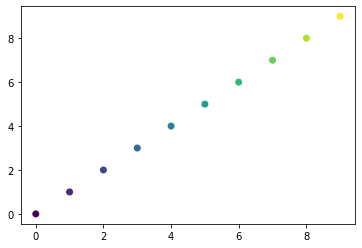

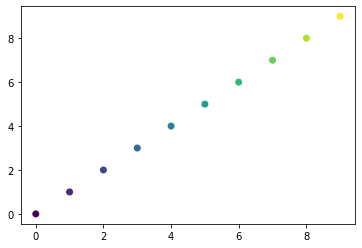

Giving some random plots from the most active neurons


ValueError: cannot reshape array of size 1000 into shape (28,28)

<Figure size 432x288 with 0 Axes>

In [18]:
analyze_training(testloader, net, params, FFN=True)

# MISC. Plotting of digits

In [77]:
def imshow(img):
    img = img / 2 + 0.5     # unnormalize
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.show()

# get some random training images
dataiter = iter(trainloader)
images, labels = dataiter.next()

# show images
imshow(torchvision.utils.make_grid(images))
# print labels
print(' '.join('%5s' % labels[j] for j in range(4)))

tensor(1) tensor(4) tensor(4) tensor(4)


In [78]:
images.shape

torch.Size([64, 1, 28, 28])

In [ ]:
class_correct = list(0. for i in range(10))
class_total = list(0. for i in range(10))
with torch.no_grad():
    for data in testloader:
        images, labels = data
        outputs = net( images.view(images.shape[0], -1) )
        _, predicted = torch.max(outputs, 1)
        c = (predicted == labels).squeeze()
        for i in range(4):
            label = labels[i]
            class_correct[label] += c[i].item()
            class_total[label] += 1


for i in range(10):
    print('Accuracy of %5s : %2d %%' % (
        i, 100 * class_correct[i] / class_total[i]))